In [1]:
%matplotlib widget
%matplotlib inline
import sys
from sys import platform
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.ticker import ScalarFormatter
import numpy as np
import seaborn as sns
import scipy
from IPython.display import display, Math
from tqdm import tqdm

from astropy.io import fits, ascii
from astropy.table import Table
from astropy.modeling import functional_models, fitting
from astropy.timeseries import LombScargle

import stingray.events as ev
import stingray.lightcurve as lc
from stingray import io
import stingray.powerspectrum as powspec 
import stingray.crossspectrum as crossspec
import stingray.gti as sting_gti
import stingray.pulse.pulsar as plsr
from stingray import stats


sns.set_context('talk')
# sns.set_style("whitegrid")
sns.set_palette("colorblind")

sys.path.insert(1, '/Users/sean/scripts/helpers')

from stingray_plus import *

n_pdot = 2000
pdot_stop = 5e-6
pdot_start = 1e-12
pdot_grid = np.concatenate((np.logspace(np.log10(pdot_start), np.log10(pdot_stop), num=int(n_pdot/2)), \
                          -np.logspace(np.log10(pdot_start), np.log10(pdot_stop), num=int(n_pdot/2))))



/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:21: UserWarning: Using standard scipy fft
  warnings.warn("Using standard scipy fft")


# NuSTAR 80601502001

## Setup

In [2]:
OBSID = '80601502001'

if platform=='linux' or platform=='linux2':
    print('Working on SRL server')
    root_dir = '/disk/lif2/spike/Circinus_ULX5/'
elif platform=='darwin':
    print('Working on Macbook')
    root_dir = '/Volumes/Samsung_1TB/AstroData/Circinus_ULX5/nustar/nustar_80601502001/'



Working on Macbook


## Plot lightcurve

80601502001


[0.24999911]


[0.24999939]


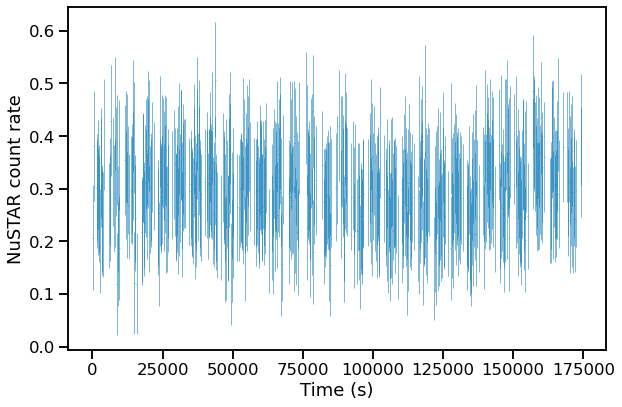

In [13]:
plt.ion()
buff = False
lc_buff_size = 0
bkg_bin = 16
print(OBSID)

### Setup
products_dir = root_dir + OBSID + '_products/'
plot_dir = root_dir + 'figures/'
plt.ion()

# events = extract_events(products_dir + 'nu' + OBSID + 'A01_cl_barycorr.evt', \
#             products_dir + 'nu' + OBSID + 'B01_cl_barycorr.evt')

# print(events[0].time)
# print(events[0].gti[0][0])
# print(events[1].gti[0][0])

# curve_A = bkg_subtract(nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_sr.lc', buff = buff, buffersize = lc_buff_size), \
#                        nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_bk.lc', buff = buff, buffersize = lc_buff_size), bkg_bin=bkg_bin)
# curve_B = bkg_subtract(nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_sr.lc', buff = buff, buffersize = lc_buff_size),\
#                        nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_bk.lc', buff = buff, buffersize = lc_buff_size), bkg_bin=bkg_bin)

curve_A = nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_sr.lc', buff = buff, buffersize = lc_buff_size, rebin=False)
bkg_curve_A = nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_bk.lc', buff = buff, buffersize = lc_buff_size, rebin=False)

area_ratio_A = curve_A.calc_area()/bkg_curve_A.calc_area()
print(area_ratio_A)

curve_B = nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_sr.lc', buff = buff, buffersize = lc_buff_size, rebin=False)
bkg_curve_B = nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_bk.lc', buff = buff, buffersize = lc_buff_size, rebin=False)

area_ratio_B = curve_B.calc_area()/bkg_curve_B.calc_area()
print(area_ratio_B)

src_curve = sum_lc(curve_A, curve_B)
bkg_curve = sum_lc(bkg_curve_A, bkg_curve_B)

# curve_10s = curve_total.rebin(dt_new=10)

centroid_A = curve_A.centroid
centroid_B = curve_B.centroid
extraction_radius = curve_A.radius
#     print(centroid_A)
#     print(centroid_B)
#     print(extraction_radius)

rebin_dt = 200
rebinned_time = np.array([np.mean(x) for x in np.array_split(src_curve.time, int(len(src_curve.time)*src_curve.dt/rebin_dt))])
rebinned_countrate = np.array([np.mean(x) for x in np.array_split(src_curve.countrate, int(len(src_curve.countrate)*src_curve.dt/rebin_dt))])
rebinned_err = np.array([np.sqrt(np.sum(np.square(x)))/len(x) for x in np.array_split(src_curve.countrate_err, int(len(src_curve.countrate_err)*src_curve.dt/rebin_dt))])
## Plot the lightcurve
plt.figure(figsize = (9,6))
plt.errorbar(rebinned_time-src_curve.tstart, rebinned_countrate-(area_ratio_A*np.mean(bkg_curve.countrate)), xerr=rebin_dt/2, yerr=rebinned_err, fmt='none', lw = 0.5)
plt.xlabel('Time (s)')
plt.ylabel('NuSTAR count rate')
plt.tight_layout()
plt.savefig(plot_dir + 'bkg_sub_lightcurve_' + str(rebin_dt) + 's.pdf')
# plt.close()



## CPDS and PASTA analysis

In [ ]:
bin_time = 1/64
split_time = 128
keV_min = 6
keV_max = 30
PI_min = int(eV_to_PI(keV_min * 1000))
PI_max = int(eV_to_PI(keV_max * 1000))


# ### Create CPDS
# curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
# curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

# averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'frac')

# ### Plot CPDS
# f_res = 0.01
# averaged_cross_log = averaged_cross.rebin_log(f=f_res)
# averaged_cross_log_err = averaged_cross.df*np.power(1.+f_res, range(len(averaged_cross_log.freq)))/2.

# plt.figure(figsize=(9,6))
# plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power*averaged_cross_log.freq, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err*averaged_cross_log.freq, fmt='none', color='black', lw=0.5)
# plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
#          np.concatenate([averaged_cross_log.power*averaged_cross_log.freq, [(averaged_cross_log.power*averaged_cross_log.freq)[-1]]]), where='post', color='black', lw=0.5)
# plt.xscale('log')
# plt.ylim(bottom=1e-3)
# plt.yscale('log')
# plt.xlabel('Frequency (Hz)')
# plt.ylabel(r'$\mathrm{\nu P_{\nu}\ (rms/mean)^{2}}$')
# plt.tight_layout()
# # plt.show()
# plt.savefig(plot_dir + 'CPDS_nuPnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV.pdf')
# plt.close()

# plt.figure(figsize=(9,6))
# plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err, fmt='none', color='black', lw=0.5)
# plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
#          np.concatenate([averaged_cross_log.power, [averaged_cross_log.power[-1]]]), where='post', color='black', lw=0.5)
# plt.xscale('log')
# plt.ylim(bottom=1e-3)
# plt.yscale('log')
# plt.xlabel('Frequency (Hz)')
# plt.ylabel(r'$\mathrm{Power\ (rms/mean)^{2}/Hz}$')
# plt.tight_layout()
# # plt.show()
# plt.savefig(plot_dir + 'CPDS_Pnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV.pdf')
# plt.close()

events = extract_events(products_dir + 'nu' + OBSID + 'A01_cl_barycorr.evt', \
            products_dir + 'nu' + OBSID + 'B01_cl_barycorr.evt')

t_0_A = events[0].time
gti_0_A = events[0].gti

t_0_B = events[1].time
gti_0_B = events[1].gti

tstart = gti_0_A[0][0]

for pdot in pdot_grid:
    print(pdot)
    events[0].time = t_0_A + 0.5*np.square(t_0_A-tstart)*pdot
    events[0].gti = gti_0_A + 0.5*np.square(gti_0_A-tstart)*pdot

    events[1].time = t_0_B + 0.5*np.square(t_0_B-tstart)*pdot
    events[1].gti = gti_0_B + 0.5*np.square(gti_0_B-tstart)*pdot

    curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
    curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

    averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'leahy', silent=True)

    signal_mask = stats.pds_probability(averaged_cross.power, ntrial=len(averaged_cross.freq), n_summed_spectra=averaged_cross.m, n_rebin=1) < 0.05

    if np.sum(signal_mask):
        print('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot))
        with open(root_dir + 'candidate_signals_' + str(keV_min)+'_'+str(keV_max) + 'keV.txt','a') as file:
            file.write('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot) + '\n')
    
### Fit one zero-centered Lorentzian
# popt, pcov, chisq0, chisq = model_continuum_noise_zero_center(averaged_cross, plot=True, plot_dir=plot_dir, f_res=f_res)

# del_chisq = chisq - chisq0
# print(del_chisq/chisq0)

1e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/utils.py:119: UserWarning: SIMON says: Errorbars on cross spectra are not thoroughly tested. Please report any inconsistencies.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.5553085--344069116.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.5553085--344070012.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.3521835--344073449.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.2584335--344075928.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site

1.0155602075514177e-12


834it [00:04, 196.34it/s]
834it [00:04, 194.37it/s]


1.031362535161883e-12


834it [00:04, 179.74it/s]
834it [00:04, 172.62it/s]


1.0474107502697583e-12


834it [00:04, 193.14it/s]
834it [00:04, 181.30it/s]


1.0637086789355462e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.6959335--344201285.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.6959335--344201541.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.6959335--344201669.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.6959335--344203077.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.6959335--344203589.6803085s
  warnings.warn(
834it [00:04, 174.61it/s]
834it [00:04, 179.90it/s]


1.0802602067540276e-12


834it [00:04, 184.94it/s]
834it [00:04, 203.99it/s]


1.0970692797806624e-12


834it [00:04, 176.73it/s]
834it [00:03, 223.29it/s]


1.1141399054723338e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.1334335--344212619.1178085s
  warnings.warn(
834it [00:04, 174.67it/s]
834it [00:04, 185.43it/s]


1.131476153642805e-12


834it [00:03, 222.64it/s]
834it [00:04, 203.42it/s]


1.1490821574329668e-12


834it [00:05, 158.98it/s]
834it [00:03, 225.54it/s]


1.1669621142962596e-12


834it [00:03, 226.18it/s]
834it [00:03, 227.12it/s]


1.1851202869993506e-12


834it [00:03, 228.26it/s]
834it [00:03, 226.44it/s]


1.2035610046384564e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.3521835--344218941.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.3521835--344221885.3365585s
  warnings.warn(
834it [00:03, 216.38it/s]
834it [00:03, 229.23it/s]


1.2222886636714286e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.7271835--344194975.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.7271835--344195103.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.7271835--344197663.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.7271835--344198431.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.7271835--344198559.7115585s
  warnings.warn(
834it [00:03, 234.93it/s]
834it [00:03, 225.42it/s]


1.241307728965901e-12


834it [00:03, 241.24it/s]
834it [00:03, 225.05it/s]


1.2606227348637947e-12


834it [00:03, 243.95it/s]
834it [00:03, 226.11it/s]


1.2802382862623112e-12


834it [00:03, 247.12it/s]
834it [00:03, 225.78it/s]


1.3001590597118295e-12


834it [00:03, 242.30it/s]
834it [00:03, 226.41it/s]


1.3203898045308017e-12


834it [00:03, 241.93it/s]
834it [00:03, 222.76it/s]


1.3409353439380825e-12


834it [00:03, 240.46it/s]
834it [00:05, 158.69it/s]


1.3618005762027907e-12


834it [00:03, 238.28it/s]
834it [00:03, 226.96it/s]


1.3829904758121464e-12


834it [00:03, 239.03it/s]
834it [00:03, 228.01it/s]


1.4045100946574233e-12


834it [00:03, 231.46it/s]
834it [00:03, 229.57it/s]


1.4263645632383542e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.4459335--344237068.4303085s
  warnings.warn(
834it [00:03, 239.37it/s]
834it [00:03, 247.83it/s]


1.4485590918863362e-12


834it [00:03, 246.91it/s]
834it [00:03, 248.87it/s]


1.4710989720065809e-12


834it [00:03, 246.85it/s]
834it [00:03, 249.38it/s]


1.4939895773396868e-12


834it [00:03, 249.23it/s]
834it [00:03, 248.08it/s]


1.5172363652427472e-12


834it [00:03, 246.68it/s]
834it [00:04, 171.84it/s]


1.5408448779904893e-12


834it [00:03, 224.53it/s]
834it [00:04, 208.45it/s]


1.5648207440965602e-12


834it [00:03, 209.02it/s]
834it [00:03, 228.24it/s]


1.5891696796554733e-12


834it [00:04, 205.54it/s]
834it [00:04, 177.10it/s]


1.6138974897053324e-12


834it [00:03, 220.89it/s]
834it [00:03, 233.13it/s]


1.6390100696118595e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.2896835--344183512.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.2896835--344184280.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.2896835--344185176.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.2896835--344185944.2740585s
  warnings.warn(
834it [00:03, 232.09it/s]
834it [00:04, 170.98it/s]


1.6645134064738906e-12


834it [00:04, 185.75it/s]
834it [00:04, 190.75it/s]


1.6904135805507417e-12


834it [00:03, 225.41it/s]
834it [00:03, 221.18it/s]


1.7167167667118536e-12


834it [00:04, 207.84it/s]
834it [00:03, 212.81it/s]


1.7434292359088887e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.7428085--344189888.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.7428085--344190784.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.7428085--344191808.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.7428085--344192704.7271835s
  warnings.warn(
834it [00:04, 190.09it/s]
834it [00:04, 188.62it/s]


1.770557356670848e-12


834it [00:03, 228.53it/s]
834it [00:03, 210.94it/s]


1.7981075966223361e-12


834it [00:04, 198.07it/s]
834it [00:04, 179.42it/s]


1.826086524025568e-12


834it [00:03, 233.22it/s]
834it [00:04, 198.61it/s]


1.854500809346253e-12


834it [00:03, 235.10it/s]
834it [00:04, 202.12it/s]


1.8833572268439607e-12


834it [00:03, 216.05it/s]
834it [00:03, 208.52it/s]


1.912662656187115e-12


834it [00:03, 246.89it/s]
834it [00:03, 217.85it/s]


1.9424240840932325e-12


834it [00:03, 241.93it/s]
834it [00:03, 226.05it/s]


1.972648605994604e-12


834it [00:03, 229.71it/s]
834it [00:03, 230.95it/s]


2.003343427729895e-12


834it [00:03, 238.45it/s]
834it [00:03, 236.93it/s]


2.034515867262149e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.9146835--344206986.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.9146835--344210314.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.7584335--344231648.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.7584335--344231904.7428085s
  warnings.warn(
834it [00:03, 247.24it/s]
834it [00:03, 237.64it/s]


2.066173356423401e-12


834it [00:03, 243.24it/s]
834it [00:03, 240.04it/s]


2.098323442686567e-12


467it [00:01, 234.82it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.8678085--344171786.8521835s
  warnings.warn(
834it [00:03, 242.76it/s]
507it [00:02, 244.85it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.8678085--344175370.8521835s
  warnings.warn(
834it [00:03, 241.30it/s]


2.1309737909647756e-12


834it [00:03, 240.67it/s]
834it [00:03, 234.72it/s]


2.164132185438828e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.8521835--344171786.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.8521835--344175370.8365585s
  warnings.warn(
456it [00:01, 246.04it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.8834335--344171786.8678085s
  warnings.warn(
834it [00:03, 247.64it/s]
499it [00:02, 225.23it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.8834335--344175370.8678085s
  warnings.warn(
834it [00:03, 235.49it/s]


2.197806531412959e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.0553085--344162656.0396835s
  warnings.warn(
834it [00:03, 248.90it/s]
834it [00:03, 233.94it/s]


2.232004857199616e-12


834it [00:03, 243.83it/s]
834it [00:03, 237.18it/s]


2.266735316033414e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.9615585--344145672.9459335s
  warnings.warn(
834it [00:03, 244.03it/s]
834it [00:04, 195.77it/s]


2.3020061880150225e-12


834it [00:03, 224.07it/s]
834it [00:03, 213.16it/s]


2.337825882085194e-12


834it [00:03, 241.84it/s]
834it [00:03, 216.35it/s]


2.374202938029516e-12


834it [00:03, 229.38it/s]
834it [00:03, 229.42it/s]


2.411146028514451e-12


834it [00:03, 221.68it/s]
834it [00:04, 202.60it/s]


2.4486639611549123e-12


834it [00:03, 231.25it/s]
834it [00:03, 234.32it/s]


2.48676568061417e-12


834it [00:03, 228.04it/s]
834it [00:03, 222.05it/s]


2.525460270736269e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.4615585--344237068.4459335s
  warnings.warn(
834it [00:03, 215.91it/s]
834it [00:04, 168.11it/s]


2.5647569567117955e-12


834it [00:03, 223.12it/s]
834it [00:03, 210.81it/s]


2.6046651072771736e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.3053085--344177817.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.3053085--344180249.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.1490585--344212619.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.3678085--344218941.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.3678085--344221885.3521835s
  warnings.warn(
834it [00:04, 180.11it/s]
834it [00:05, 160.47it/s]


2.6451942369483424e-12


834it [00:03, 224.46it/s]
834it [00:03, 227.81it/s]


2.6863540082890837e-12


834it [00:03, 215.39it/s]
834it [00:03, 230.19it/s]


2.728154234214645e-12


834it [00:03, 229.73it/s]
834it [00:05, 159.83it/s]


2.770604880331315e-12


834it [00:03, 222.46it/s]
834it [00:04, 178.77it/s]


2.8137160673122416e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.7115585--344201285.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.7115585--344201541.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.7115585--344201669.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.7115585--344203077.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.7115585--344203589.6959335s
  warnings.warn(
834it [00:06, 130.90it/s]
834it [00:04, 175.23it/s]


2.8574980733103907e-12


834it [00:04, 170.59it/s]
834it [00:05, 139.41it/s]


2.9019613364088767e-12


834it [00:04, 166.83it/s]
834it [00:04, 169.37it/s]


2.9471164571096004e-12


834it [00:06, 121.80it/s]
834it [00:05, 156.14it/s]


2.992974200860425e-12


834it [00:05, 155.69it/s]
834it [00:05, 165.19it/s]


3.0395455006218643e-12


834it [00:05, 166.14it/s]
834it [00:04, 167.30it/s]


3.0868414594735184e-12


834it [00:04, 170.47it/s]
834it [00:05, 159.52it/s]


3.134873353261248e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.7428085--344194975.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.7428085--344195103.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.7428085--344197663.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.7428085--344198431.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.7428085--344198559.7271835s
  warnings.warn(
834it [00:04, 175.75it/s]
834it [00:05, 156.60it/s]


3.183652633285415e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.5553085--344132250.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.5553085--344134682.5396835s
  warnings.warn(
834it [00:04, 171.13it/s]
834it [00:05, 139.41it/s]


3.2331909290309537e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.7740585--344231648.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.7740585--344231904.7584335s
  warnings.warn(
834it [00:04, 178.32it/s]
834it [00:05, 166.42it/s]


3.28350005094005e-12


834it [00:04, 190.98it/s]
834it [00:05, 166.45it/s]


3.334591993227768e-12


834it [00:04, 176.83it/s]
834it [00:05, 166.76it/s]


3.3864789367417017e-12


834it [00:04, 173.46it/s]
834it [00:05, 160.46it/s]


3.439173251865907e-12


834it [00:04, 179.36it/s]
834it [00:04, 168.20it/s]


3.492687501470239e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.8365585--344126567.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.8365585--344128615.8209335s
  warnings.warn(
834it [00:04, 178.28it/s]
834it [00:05, 155.38it/s]


3.547034443905359e-12


834it [00:04, 199.93it/s]
834it [00:04, 173.06it/s]


3.602227036044554e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.4771835--344237068.4615585s
  warnings.warn(
834it [00:04, 190.13it/s]
834it [00:05, 162.85it/s]


3.65827843637275e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.9303085--344206986.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.9303085--344210314.9146835s
  warnings.warn(
834it [00:05, 151.68it/s]
834it [00:04, 172.19it/s]


3.715202008123587e-12


834it [00:04, 177.86it/s]
834it [00:04, 171.26it/s]


3.773011322465449e-12


834it [00:04, 187.93it/s]
834it [00:04, 177.69it/s]


3.831720161736861e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.7584335--344189888.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.7584335--344190784.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.7584335--344191808.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.7584335--344192704.7428085s
  warnings.warn(
834it [00:04, 200.94it/s]
834it [00:04, 193.14it/s]


3.891342522732454e-12


834it [00:04, 178.30it/s]
834it [00:04, 169.94it/s]


3.951892620039829e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.3834335--344218941.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.3834335--344221885.3678085s
  warnings.warn(
834it [00:04, 180.96it/s]
834it [00:04, 174.55it/s]


4.013384889428581e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.3053085--344183512.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.3053085--344184280.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.3053085--344185176.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.3053085--344185944.2896835s
  warnings.warn(
834it [00:04, 176.70it/s]
834it [00:04, 186.82it/s]


4.0758339912918136e-12


834it [00:04, 200.71it/s]
834it [00:04, 177.46it/s]


4.139254814141455e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.1646835--344212619.1490585s
  warnings.warn(
834it [00:04, 191.00it/s]
834it [00:05, 161.96it/s]


4.203662478157701e-12


834it [00:04, 193.16it/s]
834it [00:04, 186.01it/s]


4.269072338793942e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.6646835--344150456.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.6646835--344151352.6490585s
  warnings.warn(
834it [00:04, 181.68it/s]
834it [00:05, 160.64it/s]


4.33549999043761e-12


834it [00:04, 168.26it/s]
834it [00:04, 185.94it/s]


4.4029612701279886e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.7896835--344231648.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.7896835--344231904.7740585s
  warnings.warn(
834it [00:05, 152.88it/s]
834it [00:06, 128.77it/s]


4.471472261332052e-12


834it [00:04, 167.34it/s]
834it [00:04, 170.44it/s]


4.541049297778787e-12


834it [00:04, 168.44it/s]
834it [00:05, 166.71it/s]


4.6117089673534634e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.7271835--344201285.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.7271835--344201541.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.7271835--344201669.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.7271835--344203077.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.7271835--344203589.7115585s
  warnings.warn(
834it [00:04, 197.21it/s]
834it [00:05, 162.53it/s]


4.6834681160522174e-12


834it [00:04, 177.20it/s]
834it [00:05, 165.99it/s]


4.756343851998457e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.4928085--344237068.4771835s
  warnings.warn(
834it [00:05, 140.21it/s]
834it [00:04, 190.58it/s]


4.830353549521463e-12


834it [00:05, 157.68it/s]
834it [00:05, 165.66it/s]


4.9055148532987645e-12


834it [00:05, 164.06it/s]
834it [00:05, 158.53it/s]


4.9818456825626564e-12


834it [00:04, 172.33it/s]
834it [00:04, 179.05it/s]


5.059364235372466e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.7584335--344194975.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.7584335--344195103.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.7584335--344197663.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.7584335--344198431.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.7584335--344198559.7428085s
  warnings.warn(
475it [00:02, 172.41it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarni

5.138088992953102e-12


834it [00:04, 186.13it/s]
834it [00:04, 188.00it/s]


5.218038724101108e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.3209335--344177817.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.3209335--344180249.3053085s
  warnings.warn(
834it [00:04, 185.72it/s]
834it [00:04, 178.83it/s]


5.2992324896594774e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.9459335--344206986.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.9459335--344210314.9303085s
  warnings.warn(
834it [00:04, 184.01it/s]
834it [00:04, 181.89it/s]


5.381689647061795e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.3990585--344218941.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.3990585--344221885.3834335s
  warnings.warn(
834it [00:04, 186.22it/s]
834it [00:04, 180.13it/s]


5.465429854947416e-12


834it [00:04, 193.54it/s]
834it [00:04, 177.62it/s]


5.5504730778481125e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.8053085--344231648.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.8053085--344231904.7896835s
  warnings.warn(
834it [00:04, 187.12it/s]
834it [00:06, 136.54it/s]


5.636839590948009e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.1803085--344212619.1646835s
  warnings.warn(
834it [00:05, 149.51it/s]
834it [00:05, 164.11it/s]


5.724549984917208e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.0709335--344162656.0553085s
  warnings.warn(
834it [00:06, 131.43it/s]
834it [00:05, 140.26it/s]


5.8136251708210094e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.5084335--344237068.4928085s
  warnings.warn(
834it [00:04, 185.02it/s]
834it [00:04, 184.29it/s]


5.904086385105131e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.2740585--344138701.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.2740585--344139981.2584335s
  warnings.warn(
834it [00:04, 174.43it/s]
834it [00:04, 178.77it/s]


5.995955194658866e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.7740585--344189888.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.7740585--344190784.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.7740585--344191808.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.7740585--344192704.7584335s
  warnings.warn(
834it [00:05, 164.13it/s]
834it [00:05, 150.82it/s]


6.089253501956785e-12


834it [00:05, 155.36it/s]
834it [00:05, 166.03it/s]


6.18400355028043e-12


834it [00:04, 170.58it/s]
834it [00:04, 167.56it/s]


6.280227929021523e-12


834it [00:04, 179.89it/s]
834it [00:04, 173.51it/s]


6.377949579067309e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.3209335--344183512.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.3209335--344184280.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.3209335--344185176.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.3209335--344185944.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.7428085--344201285.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.4771917982701e-12


834it [00:05, 146.43it/s]
834it [00:05, 164.28it/s]


6.5779782470015244e-12


834it [00:04, 174.23it/s]
834it [00:05, 157.46it/s]


6.680332953793607e-12


834it [00:04, 175.48it/s]
834it [00:05, 146.20it/s]


6.784280321067211e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.4146835--344218941.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.4146835--344221885.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.8209335--344231648.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.8209335--344231904.8053085s
  warnings.warn(
834it [00:07, 118.32it/s]
834it [00:05, 156.71it/s]


6.889845130950015e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.9615585--344206986.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.9615585--344210314.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.5240585--344237068.5084335s
  warnings.warn(
834it [00:04, 175.42it/s]
834it [00:04, 180.07it/s]


6.997052551184752e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.7740585--344194975.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.7740585--344195103.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.7740585--344197663.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.7740585--344198431.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.7740585--344198559.7584335s
  warnings.warn(
834it [00:04, 176.96it/s]
834it [00:04, 176.84it/s]


7.105928141129363e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.1178085--344121478.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.1178085--344121606.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.1959335--344212619.1803085s
  warnings.warn(
834it [00:04, 205.57it/s]
834it [00:05, 142.45it/s]


7.216497857850826e-12


834it [00:04, 186.18it/s]
834it [00:04, 188.87it/s]


7.328788062313346e-12


834it [00:04, 185.74it/s]
834it [00:04, 186.01it/s]


7.442825525663325e-12


834it [00:04, 191.76it/s]
834it [00:04, 196.79it/s]


7.558637435611637e-12


834it [00:04, 203.42it/s]
834it [00:04, 188.86it/s]


7.676251402915702e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.9771835--344145672.9615585s
  warnings.warn(
834it [00:04, 190.50it/s]
834it [00:04, 193.01it/s]


7.795695467961931e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.3365585--344177817.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.3365585--344180249.3209335s
  warnings.warn(
834it [00:04, 185.10it/s]
834it [00:05, 144.15it/s]


7.916998107451066e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.8365585--344231648.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.8365585--344231904.8209335s
  warnings.warn(
465it [00:02, 172.57it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.9146835--344171786.8990585s
  warnings.warn(
834it [00:04, 172.11it/s]
499it [00:02, 204.02it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.9146835--344175370.8990585s
  warnings.warn(
834it [00:04, 188.61it/s]


8.040188241187219e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.7896835--344189888.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.7896835--344190784.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.7896835--344191808.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.7896835--344192704.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.5396835--344237068.5240585s
  warnings.warn(
834it [00:04, 183.41it/s]
834it [00:04, 184.35it/s]


8.16529523897256e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.6490585--344116945.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.7584335--344201285.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.7584335--344201541.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.7584335--344201669.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.7584335--344203077.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.292348927609612e-12


834it [00:05, 152.51it/s]
834it [00:05, 159.43it/s]


8.421379598011994e-12


834it [00:04, 179.39it/s]
834it [00:04, 184.54it/s]


8.55241801242637e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.9771835--344206986.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.9771835--344210314.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.2115585--344212619.1959335s
  warnings.warn(
834it [00:04, 192.79it/s]
834it [00:04, 189.86it/s]


8.685495411766208e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.3365585--344183512.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.3365585--344184280.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.3365585--344185176.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.3365585--344185944.3209335s
  warnings.warn(
834it [00:04, 197.33it/s]
834it [00:04, 190.16it/s]


8.820643523060214e-12


834it [00:04, 193.34it/s]
834it [00:04, 169.78it/s]


8.957894567016099e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.6803085--344150456.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.6803085--344151352.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.7896835--344194975.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.7896835--344195103.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.7896835--344197663.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.097281265702624e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.8521835--344231648.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.8521835--344231904.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.5553085--344237068.5396835s
  warnings.warn(
834it [00:04, 198.87it/s]
834it [00:04, 191.90it/s]


9.238836850350582e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.0865585--344162656.0709335s
  warnings.warn(
834it [00:04, 188.86it/s]
834it [00:04, 190.84it/s]


9.382595069275723e-12


834it [00:04, 207.17it/s]
834it [00:04, 190.50it/s]


9.528590195924601e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.4459335--344218941.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.4459335--344221885.4303085s
  warnings.warn(
834it [00:04, 184.81it/s]
834it [00:04, 202.45it/s]


9.676857037045593e-12


834it [00:04, 186.22it/s]
834it [00:04, 184.86it/s]


9.82743094098746e-12


834it [00:04, 184.87it/s]
834it [00:04, 195.06it/s]


9.98034780612645e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.6803085--344109474.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.6803085--344109858.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.7740585--344201285.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.7740585--344201541.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.7740585--344201669.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0135644089425156e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.8053085--344189888.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.8053085--344190784.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.8053085--344191808.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.8053085--344192704.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.9928085--344206986.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0293356815123912e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.3521835--344177817.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.3521835--344180249.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.8678085--344231648.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.8678085--344231904.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.5709335--344237068.5553085s
  warnings.warn(
834it [00:03, 213.84it/s]
834it [00:04, 194.19it/s]


1.0453523583568083e-11


834it [00:04, 195.13it/s]
834it [00:04, 188.02it/s]


1.0616182580172042e-11


834it [00:04, 193.96it/s]
834it [00:04, 204.82it/s]


1.078137258452331e-11


459it [00:02, 210.81it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.9303085--344171786.9146835s
  warnings.warn(
834it [00:03, 209.76it/s]
493it [00:02, 186.89it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.9303085--344175370.9146835s
  warnings.warn(
834it [00:04, 199.31it/s]


1.0949132979627658e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.5709335--344132250.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.5709335--344134682.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.3521835--344183512.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.3521835--344184280.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.3521835--344185176.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1119503761298738e-11


834it [00:04, 189.82it/s]
834it [00:04, 194.96it/s]


1.1292525547693363e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.5865585--344237068.5709335s
  warnings.warn(
834it [00:04, 170.29it/s]
834it [00:04, 189.94it/s]


1.1468239588995159e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.8834335--344231648.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.8834335--344231904.8678085s
  warnings.warn(
834it [00:04, 174.59it/s]
834it [00:04, 182.86it/s]


1.1646687777249358e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.7896835--344201285.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.7896835--344201541.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.7896835--344201669.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.7896835--344203077.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.7896835--344203589.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1827912656349918e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206859.0084335--344206986.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210187.0084335--344210314.9928085s
  warnings.warn(
834it [00:04, 202.58it/s]
834it [00:04, 184.35it/s]


1.2011957432182812e-11


834it [00:06, 136.91it/s]
834it [00:04, 185.54it/s]


1.2198865982926372e-11


834it [00:04, 189.80it/s]
834it [00:04, 189.19it/s]


1.2388682869512688e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.2896835--344138701.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.2896835--344139981.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.8209335--344189888.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.8209335--344190784.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.8209335--344191808.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2581453346250998e-11


834it [00:04, 193.19it/s]
834it [00:04, 199.06it/s]


1.2777223371617195e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.8521835--344126567.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.8521835--344128615.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.1021835--344162656.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.8209335--344194975.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.8209335--344195103.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2976039619210386e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.3678085--344177817.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.3678085--344180249.3521835s
  warnings.warn(
834it [00:05, 151.08it/s]
834it [00:04, 171.57it/s]


1.3177949488880719e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.9928085--344145672.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.2584335--344212619.2428085s
  warnings.warn(
834it [00:04, 191.12it/s]
834it [00:04, 192.89it/s]


1.3383001118029858e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.3678085--344183512.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.3678085--344184280.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.3678085--344185176.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.3678085--344185944.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.8053085--344201285.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3591243393087259e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.6959335--344150456.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.6959335--344151352.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.4928085--344218941.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.4928085--344221885.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.6178085--344237068.6021835s
  warnings.warn(
834it [00:04, 191.22it/s]
834it [00:04, 206.83it/s]


1.3802725961165588e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.9146835--344231648.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.9146835--344231904.8990585s
  warnings.warn(
468it [00:02, 191.61it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.9459335--344171786.9303085s
  warnings.warn(
834it [00:04, 197.95it/s]
504it [00:02, 191.84it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.9459335--344175370.9303085s
  warnings.warn(
834it [00:04, 195.23it/s]


1.4017499241896667e-11


834it [00:04, 193.11it/s]
834it [00:04, 186.28it/s]


1.4235614439452479e-11


834it [00:04, 198.15it/s]
834it [00:04, 197.04it/s]


1.4457123554752319e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.8365585--344189888.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.8365585--344190784.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.8365585--344191808.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.8365585--344192704.8209335s
  warnings.warn(
834it [00:04, 193.11it/s]
834it [00:04, 183.81it/s]


1.4682079397860814e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.8365585--344194975.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.8365585--344195103.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.8365585--344197663.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.8365585--344198431.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.8365585--344198559.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4910535600577924e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206859.0396835--344206987.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210187.0396835--344210315.0240585s
  warnings.warn(
834it [00:04, 200.48it/s]
834it [00:04, 189.72it/s]


1.5142546629225783e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.8209335--344201285.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.8209335--344201541.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.8209335--344201669.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.8209335--344203077.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.8209335--344203589.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5378167797633557e-11


834it [00:06, 133.32it/s]
834it [00:05, 163.24it/s]


1.5617455280325265e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.3834335--344177817.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.3834335--344180249.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.3834335--344183512.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.3834335--344184280.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.3834335--344185176.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5860466125912174e-11


834it [00:04, 185.02it/s]
834it [00:05, 166.45it/s]


1.61072582706936e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.2896835--344212619.2740585s
  warnings.warn(
834it [00:04, 192.52it/s]
834it [00:04, 189.08it/s]


1.635789055246995e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.1178085--344162656.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.5240585--344218941.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.5240585--344221885.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.9459335--344231648.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.9459335--344231904.9303085s
  warnings.warn(
834it [00:04, 179.89it/s]
834it [00:04, 198.16it/s]


1.6612422724569756e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.8521835--344189888.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.8521835--344190784.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.8521835--344191808.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.8521835--344192704.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.8521835--344194975.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.687091547009602e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.6646835--344237068.6490585s
  warnings.warn(
834it [00:04, 184.00it/s]
834it [00:05, 158.55it/s]


1.713343041639314e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.8365585--344201285.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.8365585--344201541.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.8365585--344201669.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.8365585--344203077.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.8365585--344203589.8209335s
  warnings.warn(
834it [00:04, 198.73it/s]
834it [00:04, 185.76it/s]


1.740003014973999e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.9615585--344231648.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.9615585--344231904.9459335s
  warnings.warn(
834it [00:04, 190.77it/s]
834it [00:04, 189.77it/s]


1.7670778230270945e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.3053085--344212619.2896835s
  warnings.warn(
834it [00:04, 198.17it/s]
834it [00:04, 184.94it/s]


1.7945739207129107e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.3990585--344177817.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.3990585--344180249.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.3990585--344183512.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.3990585--344184280.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.3990585--344185176.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8224978633855654e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.7115585--344150456.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.7115585--344151352.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206859.0709335--344206987.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210187.0709335--344210315.0553085s
  warnings.warn(
834it [00:04, 206.77it/s]
834it [00:04, 188.77it/s]


1.85085630840186e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.1334335--344121478.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.1334335--344121606.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.5865585--344132250.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.5865585--344134682.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.0084335--344145672.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8796560167084516e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.3053085--344138701.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.3053085--344139981.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.8678085--344189888.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.8678085--344190784.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.8678085--344191808.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.908903854453706e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.3209335--344212619.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.5553085--344218941.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.5553085--344221885.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.6959335--344237068.6803085s
  warnings.warn(
834it [00:03, 223.15it/s]
834it [00:03, 230.55it/s]


1.9386067946247153e-11


478it [00:01, 238.33it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.9771835--344171786.9615585s
  warnings.warn(
834it [00:03, 244.24it/s]
485it [00:02, 238.21it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.9771835--344175370.9615585s
  warnings.warn(
834it [00:03, 234.95it/s]


1.9687719187096645e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.1334335--344162656.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.9928085--344231648.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.9928085--344231904.9771835s
  warnings.warn(
834it [00:03, 244.06it/s]
834it [00:03, 225.87it/s]


1.999406418386198e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206859.0865585--344206987.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210187.0865585--344210315.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.7115585--344237068.6959335s
  warnings.warn(
834it [00:04, 190.57it/s]
834it [00:04, 196.38it/s]


2.0305175972359242e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.4146835--344183512.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.4146835--344184280.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.4146835--344185176.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.4146835--344185944.3990585s
  warnings.warn(
834it [00:04, 167.43it/s]
834it [00:03, 226.92it/s]


2.062112872485721e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.4146835--344177817.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.4146835--344180249.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.8834335--344189888.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.8834335--344190784.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.8834335--344191808.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0941997767760578e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231521.0084335--344231648.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231777.0084335--344231904.9928085s
  warnings.warn(
834it [00:04, 177.74it/s]
834it [00:06, 138.41it/s]


2.126785959956826e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.7271835--344237068.7115585s
  warnings.warn(
834it [00:04, 190.82it/s]
834it [00:04, 203.88it/s]


2.1598791909112043e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206859.1021835--344206987.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210187.1021835--344210315.0865585s
  warnings.warn(
834it [00:05, 163.63it/s]
834it [00:04, 168.90it/s]


2.193487359407771e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.5865585--344218941.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.5865585--344221885.5709335s
  warnings.warn(
834it [00:04, 169.05it/s]
834it [00:04, 183.64it/s]


2.2276184779815763e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.8678085--344126567.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.8678085--344128615.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.8834335--344201285.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.8834335--344201541.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.8834335--344201669.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2622806838443432e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.6646835--344116945.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.4303085--344183512.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.4303085--344184280.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.4303085--344185176.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.4303085--344185944.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2974822408245337e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.7271835--344150456.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.7271835--344151352.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.8990585--344189888.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.8990585--344190784.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.8990585--344191808.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.33323154133746e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.1490585--344162656.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.4303085--344177817.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.4303085--344180249.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.6021835--344218941.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.6021835--344221885.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.3695371083861948e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.3678085--344212619.3521835s
  warnings.warn(
834it [00:04, 191.92it/s]
834it [00:03, 222.41it/s]


2.4064075975934705e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.0240585--344145673.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.8990585--344201285.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.8990585--344201541.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.8990585--344201669.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.8990585--344203077.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.4438517992653333e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.9146835--344194975.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.9146835--344195103.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.9146835--344197663.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.9146835--344198431.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.9146835--344198559.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.481878640486818e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.9146835--344189888.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.9146835--344190784.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.9146835--344191808.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.9146835--344192704.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206859.1334335--344206987.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.5204971872502234e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.3209335--344138701.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.3209335--344139981.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.4459335--344183512.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.4459335--344184280.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.4459335--344185176.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.559716646616612e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231521.0709335--344231649.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231777.0709335--344231905.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.7896835--344237068.7740585s
  warnings.warn(
834it [00:04, 179.38it/s]
834it [00:04, 173.31it/s]


2.5995463689107853e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.4459335--344177817.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.4459335--344180249.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.9146835--344201285.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.9146835--344201541.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.9146835--344201669.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.6399958499505823e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.6021835--344132250.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.6021835--344134682.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.9303085--344194975.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.9303085--344195103.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.9303085--344197663.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.681074733310695e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.1646835--344162656.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.3990585--344212619.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231521.0865585--344231649.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231777.0865585--344231905.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.8053085--344237068.7896835s
  warnings.warn(
834it [00:04, 179.13it/s]
834it [00:04, 192.00it/s]


2.7227928126218826e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.4615585--344183512.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.4615585--344184280.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.4615585--344185176.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.4615585--344185944.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.9303085--344189888.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.7651600339057878e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.7428085--344150456.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.7428085--344151352.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.9303085--344201285.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.9303085--344201541.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.9303085--344201669.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.8081864979462587e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206859.1646835--344206987.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210187.1646835--344210315.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.4146835--344212619.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231521.1021835--344231649.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231777.1021835--344231905.0865585s
  warnings.warn(
465it [00:02, 167.14it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarni

2.8518824626973913e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.4615585--344177817.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.4615585--344180249.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.9459335--344194975.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.9459335--344195103.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.9459335--344197663.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.8962583457292114e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.6959335--344109474.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.6959335--344109858.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.6646835--344218941.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.6646835--344221885.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.8365585--344237068.8209335s
  warnings.warn(
834it [00:04, 179.72it/s]
834it [00:05, 164.72it/s]


2.9413247267112955e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.0396835--344145673.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.9459335--344189888.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.9459335--344190784.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.9459335--344191808.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.9459335--344192704.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.987092349935041e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.1490585--344121478.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.1490585--344121606.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.4771835--344183512.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.4771835--344184280.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.4771835--344185176.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.0335721268752946e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.1803085--344162656.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.9615585--344194975.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.9615585--344195103.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.9615585--344197663.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.9615585--344198431.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.0807751387916697e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.4771835--344177817.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.4771835--344180249.4615585s
  warnings.warn(
834it [00:04, 207.77it/s]
834it [00:04, 200.97it/s]


3.128712639370529e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.8834335--344126567.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.8834335--344128615.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.9615585--344189888.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.9615585--344190784.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.9615585--344191808.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.1773960574078786e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.3365585--344138701.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.3365585--344139981.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.6959335--344218941.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.6959335--344221885.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231521.1490585--344231649.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.226836999534215e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.7584335--344150456.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.7584335--344151352.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.4928085--344183512.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.4928085--344184280.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.4928085--344185176.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.2770472529815614e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.9771835--344201285.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.9771835--344201541.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.9771835--344201669.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.9771835--344203077.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.9771835--344203589.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.328038788393771e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.9771835--344189888.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.9771835--344190784.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.9771835--344191808.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.9771835--344192704.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.7115585--344218941.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.3798237626803475e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.1959335--344162656.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.4928085--344177817.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.4928085--344180249.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231521.1803085--344231649.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231777.1803085--344231905.1646835s
  warnings.warn(
468it [00:03, 179.37it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarni

3.4324145219148675e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.6178085--344132250.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.6178085--344134682.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.5084335--344183512.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.5084335--344184280.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.5084335--344185176.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.485823604278377e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.0553085--344145673.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.9928085--344201285.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.9928085--344201541.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.9928085--344201669.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.9928085--344203077.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.54006374304858e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.9928085--344189888.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.9928085--344190784.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.9928085--344191808.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.9928085--344192704.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.4928085--344212619.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.595147869635679e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.5084335--344177817.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.5084335--344180249.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.0084335--344194975.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194976.0084335--344195103.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197536.0084335--344197663.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.651089116665248e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201158.0084335--344201285.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201414.0084335--344201541.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201542.0084335--344201669.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202950.0084335--344203077.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203462.0084335--344203589.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.707900821109297e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.6803085--344116945.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.7740585--344150456.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.7740585--344151352.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.5240585--344183512.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.5240585--344184280.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.7655965274658304e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.2115585--344162656.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.0084335--344189888.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190657.0084335--344190784.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191681.0084335--344191808.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192577.0084335--344192704.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.824189990988112e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.3521835--344138701.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.3521835--344139981.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.0240585--344194976.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194976.0240585--344195104.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197536.0240585--344197664.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.8836951809639417e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.5240585--344177817.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.5240585--344180249.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.5240585--344212619.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.7740585--344218941.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.7740585--344221885.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.944126284046197e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.5396835--344183512.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.5396835--344184280.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.5396835--344185176.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.5396835--344185944.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206859.2740585--344206987.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.005497707634958e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.0240585--344189889.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190657.0240585--344190785.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191681.0240585--344191809.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192577.0240585--344192705.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.0396835--344194976.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.067824083312487e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.8990585--344126567.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.8990585--344128615.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.0709335--344145673.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.2271835--344162656.2115585s
  warnings.warn(
834it [00:03, 239.98it/s]
834it [00:03, 226.31it/s]


4.1311202703315014e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.1646835--344121478.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.1646835--344121606.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.7896835--344150456.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.7896835--344151352.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.5396835--344177817.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.195401359157729e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.6334335--344132250.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.6334335--344134682.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.0396835--344189889.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190657.0396835--344190785.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191681.0396835--344191809.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.2606826750677403e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206859.3053085--344206987.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210187.3053085--344210315.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.8209335--344218941.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.8209335--344221885.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231521.2896835--344231649.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.3269797818025244e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201158.0709335--344201286.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201414.0709335--344201542.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201542.0709335--344201670.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202950.0709335--344203078.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203462.0709335--344203590.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.3943084852781784e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.5553085--344177817.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.5553085--344180249.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.5709335--344183512.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.5709335--344184280.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.5709335--344185176.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.4626848373540627e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.3678085--344138701.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.3678085--344139981.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.2428085--344162656.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.5865585--344212619.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231521.3209335--344231649.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.532125139659857e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201158.0865585--344201286.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201414.0865585--344201542.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201542.0865585--344201670.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202950.0865585--344203078.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203462.0865585--344203590.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.602645947481982e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.0865585--344145673.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.8053085--344150456.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.8053085--344151352.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.5865585--344183512.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.5865585--344184280.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.674264073710512e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.5709335--344177817.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.5709335--344180249.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.8678085--344218941.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.8678085--344221885.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231521.3521835--344231649.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.746996592847583e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.1021835--344194976.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194976.1021835--344195104.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197536.1021835--344197664.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198304.1021835--344198432.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198432.1021835--344198560.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.8208608450781644e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.7115585--344109474.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.7115585--344109858.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.2584335--344162656.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.6021835--344183512.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.6021835--344184280.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.895874440404104e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.5865585--344177817.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.5865585--344180249.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201158.1178085--344201286.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201414.1178085--344201542.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201542.1178085--344201670.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.972055262842473e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.6490585--344132250.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.6490585--344134682.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.1178085--344194976.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194976.1178085--344195104.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197536.1178085--344197664.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.049421474689442e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.9146835--344126567.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.9146835--344128615.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.8209335--344150456.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.8209335--344151352.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.6178085--344183512.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.1279915208501955e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.3834335--344138701.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.3834335--344139981.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.1021835--344145673.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.2740585--344162656.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.6021835--344177817.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.207784133236556e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.6959335--344116945.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201158.1490585--344201286.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201414.1490585--344201542.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201542.1490585--344201670.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202950.1490585--344203078.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.288818335232697e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.1803085--344121478.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.1803085--344121606.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.6334335--344183512.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.6334335--344184280.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.6334335--344185176.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.371113446230662e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.1490585--344194976.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194976.1490585--344195104.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197536.1490585--344197664.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198304.1490585--344198432.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198432.1490585--344198560.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.454689086236244e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.6178085--344177817.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.6178085--344180249.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.1334335--344189889.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190657.1334335--344190785.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191681.1334335--344191809.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.539565180546533e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.8365585--344150456.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.8365585--344151352.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.2896835--344162656.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.6490585--344183512.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.6490585--344184280.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.625761964500467e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201158.1803085--344201286.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201414.1803085--344201542.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201542.1803085--344201670.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202950.1803085--344203078.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203462.1803085--344203590.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.7132999883029663e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.6646835--344132250.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.6646835--344134682.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.1178085--344145673.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.6334335--344177817.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.6334335--344180249.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.802200121924497e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.3990585--344138701.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.3990585--344139981.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.6646835--344183512.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.6646835--344184280.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.6646835--344185176.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.892483560076504e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.3053085--344162656.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.6490585--344177817.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.6490585--344180249.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.1646835--344189889.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190657.1646835--344190785.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.984171827264636e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.9303085--344126567.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.9303085--344128615.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.8521835--344150456.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.8521835--344151352.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.6803085--344183512.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.07728678292022e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.1803085--344189889.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190657.1803085--344190785.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191681.1803085--344191809.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192577.1803085--344192705.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206859.4771835--344206987.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.171850626611972e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.3209335--344162656.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.6646835--344177817.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.6646835--344180249.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.2115585--344194976.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194976.2115585--344195104.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.267885903338402e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.1334335--344145673.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.6959335--344183512.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.6959335--344184280.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.6959335--344185176.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.6959335--344185944.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.365415508902954e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.4146835--344138701.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.4146835--344139981.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.2271835--344194976.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194976.2271835--344195104.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197536.2271835--344197664.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.464462695372523e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.8053085--344085682.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.1959335--344121478.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.1959335--344121606.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.6803085--344132250.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.6803085--344134682.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.565051076620917e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.3365585--344162656.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.2115585--344189889.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190657.2115585--344190785.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191681.2115585--344191809.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192577.2115585--344192705.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.667204633958824e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.7271835--344109474.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.7271835--344109858.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.7115585--344116945.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.6959335--344177817.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.6959335--344180249.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.770947721850999e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.1490585--344145673.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.7271835--344183512.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.7271835--344184280.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.7271835--344185176.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.7271835--344185944.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.876305073722827e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.9459335--344126567.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.9459335--344128615.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.3521835--344162656.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.2740585--344194976.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194976.2740585--344195104.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.983301807856822e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.8834335--344150456.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.8834335--344151352.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.7115585--344177817.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.7115585--344180249.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.7428085--344183512.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.091963433381293e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.4303085--344138701.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.4303085--344139981.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.2896835--344194976.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194976.2896835--344195104.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197536.2896835--344197664.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.202315856351771e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.7271835--344177817.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.7271835--344180249.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.7584335--344183512.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.7584335--344184280.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.7584335--344185176.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.314385385927503e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.6959335--344132250.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.6959335--344134682.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.1646835--344145673.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.3678085--344162656.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.2740585--344189889.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.428198740643591e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.8990585--344150456.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.8990585--344151352.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.7428085--344177817.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.7428085--344180249.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.7740585--344183512.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.543783054781185e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.2896835--344189889.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190657.2896835--344190785.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191681.2896835--344191809.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192577.2896835--344192705.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201158.3521835--344201286.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.661165884836481e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.2115585--344121478.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.2115585--344121606.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.4459335--344138701.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.4459335--344139981.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.3834335--344162656.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.780375216090377e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.9615585--344126567.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.9615585--344128615.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.7584335--344177817.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.7584335--344180249.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.3053085--344189889.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.901439469280683e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.1803085--344145673.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.9146835--344150456.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.9146835--344151352.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.8053085--344183512.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.8053085--344184280.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.024387507377654e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.7115585--344132250.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.7115585--344134682.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.3990585--344162656.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.7740585--344177817.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.7740585--344180249.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.149248642465488e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.7271835--344116945.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.8209335--344183512.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.8209335--344184280.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.8209335--344185176.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.8209335--344185944.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.27605264273036e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.4146835--344162656.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.7896835--344177817.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.7896835--344180249.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.3834335--344194976.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194976.3834335--344195104.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.404829739557739e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.4615585--344138701.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.4615585--344139981.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.1959335--344145673.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.9303085--344150456.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.9303085--344151352.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.535610634739585e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.7428085--344109474.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.7428085--344109858.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.8053085--344177817.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.8053085--344180249.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206859.7115585--344206987.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.668426507794258e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.4303085--344162656.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.8521835--344183512.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.8521835--344184280.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.8521835--344185176.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.8521835--344185944.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.803309023399748e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.2271835--344121478.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.2271835--344121606.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.9771835--344126567.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.9771835--344128615.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.7271835--344132250.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.940290338943116e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.4771835--344138701.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.4771835--344139981.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.2115585--344145673.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201158.4771835--344201286.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201414.4771835--344201542.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.079403112187044e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.4459335--344162656.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.8365585--344177817.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.8365585--344180249.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.8834335--344183512.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.8834335--344184280.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.220680509055663e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.9615585--344150456.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.9615585--344151352.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171659.3365585--344171787.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175243.3365585--344175371.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.8521835--344177817.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.36415621154192e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.4615585--344162656.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.8990585--344183512.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.8990585--344184280.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.8990585--344185176.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.8990585--344185944.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.50986442573741e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.7428085--344116945.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.7428085--344132250.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.7428085--344134682.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.2271835--344145673.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171659.3521835--344171787.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.657839889987767e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.9928085--344126567.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.9928085--344128615.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.4928085--344138701.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.4928085--344139981.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.4459335--344189889.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.808117883174339e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.9771835--344150456.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.9771835--344151352.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.4771835--344162656.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.8834335--344177817.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.8834335--344180249.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.960734233125344e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.2428085--344121478.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.2428085--344121606.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.2428085--344145673.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.9459335--344183512.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.9459335--344184280.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0115725325157287e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.4928085--344162656.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.8990585--344177817.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.8990585--344180249.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.4771835--344189889.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190657.4771835--344190785.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.027312811074991e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.5084335--344138701.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.5084335--344139981.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.9928085--344150456.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.9928085--344151352.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171659.3990585--344171787.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0432980116355483e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.7584335--344109474.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.7584335--344109858.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.7584335--344132250.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.7584335--344134682.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.5084335--344162656.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0595319452345788e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.0084335--344126567.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.0084335--344128615.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.2584335--344145673.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171659.4146835--344171787.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175243.4146835--344175371.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0760184822097907e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.0084335--344150456.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.0084335--344151352.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.5240585--344162656.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.9459335--344177817.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.9459335--344180249.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0927615531221365e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.7584335--344116945.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.5240585--344138701.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.5240585--344139981.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183385.0084335--344183512.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184153.0084335--344184280.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1097651496929312e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.2584335--344121478.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.2584335--344121606.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.7740585--344132250.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.7740585--344134682.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.2740585--344145673.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1270333257554833e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.9771835--344177817.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.9771835--344180249.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194848.6334335--344194976.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194976.6334335--344195104.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197536.6334335--344197664.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.144570198221608e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.5553085--344162656.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183385.0396835--344183513.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184153.0396835--344184281.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185049.0396835--344185177.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185817.0396835--344185945.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1623799480631036e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.0240585--344126568.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.0240585--344128616.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.5396835--344138701.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.5396835--344139981.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.2896835--344145673.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1804668213085716e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.5709335--344162656.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171659.4771835--344171787.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175243.4771835--344175371.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177690.0084335--344177817.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180122.0084335--344180249.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1988351300557004e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.7896835--344132250.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.7896835--344134682.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.0553085--344150457.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.0553085--344151353.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189761.6178085--344189889.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.217489253499303e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.2740585--344121478.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.2740585--344121606.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.5553085--344138701.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.5553085--344139981.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.3053085--344145673.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2364336389753727e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.7740585--344109474.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.7740585--344109858.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.7740585--344116945.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177690.0396835--344177818.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180122.0396835--344180250.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2556728030213844e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.0396835--344126568.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.0396835--344128616.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.0709335--344150457.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.0709335--344151353.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.6021835--344162656.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2752113324530728e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.8053085--344132250.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.8053085--344134682.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.3209335--344145673.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171659.5240585--344171787.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175243.5240585--344175371.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2950538854579626e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.5709335--344138701.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.5709335--344139981.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.0865585--344150457.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.0865585--344151353.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.6178085--344162656.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.315205192705964e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171659.5553085--344171787.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175243.5553085--344175371.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177690.0865585--344177818.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180122.0865585--344180250.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183385.1490585--344183513.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.335670058477171e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.2896835--344121478.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.2896835--344121606.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.0553085--344126568.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.0553085--344128616.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.8209335--344132250.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3564533618072957e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.5865585--344138701.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.5865585--344139981.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.1021835--344150457.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.1021835--344151353.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.6490585--344162656.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3775600576508356e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.3521835--344145673.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177690.1178085--344177818.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180122.1178085--344180250.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183385.1959335--344183513.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184153.1959335--344184281.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3989951780624258e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.7896835--344116945.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.1178085--344150457.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.1178085--344151353.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.6646835--344162656.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177690.1334335--344177818.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4207638333965155e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.7896835--344109474.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.7896835--344109858.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.8365585--344132250.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.8365585--344134682.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.6021835--344138701.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4428712135257192e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.3053085--344121478.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.3053085--344121606.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.0709335--344126568.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.0709335--344128616.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.3678085--344145673.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4653225890781452e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.6959335--344162656.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171659.6334335--344171787.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175243.6334335--344175371.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177690.1803085--344177818.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180122.1803085--344180250.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.488123312693982e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.8521835--344132250.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.8521835--344134682.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.6178085--344138701.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.6178085--344139981.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.3834335--344145673.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.51127882030161e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.7115585--344162656.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177690.2115585--344177818.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180122.2115585--344180250.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183385.2896835--344183513.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184153.2896835--344184281.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.534794632413565e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.8053085--344116945.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.0865585--344126568.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.0865585--344128616.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.6334335--344138701.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.6334335--344139981.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5586763554427283e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.3209335--344121478.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.3209335--344121606.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.3990585--344145673.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177690.2271835--344177818.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180122.2271835--344180250.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5829296830389045e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.8678085--344132250.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.8678085--344134682.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.1803085--344150457.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.1803085--344151353.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.7428085--344162656.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6075603974462963e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.8053085--344109474.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.8053085--344109858.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.6490585--344138701.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.6490585--344139981.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.4146835--344145673.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6325743708820005e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.1021835--344126568.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.1021835--344128616.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.1959335--344150457.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.1959335--344151353.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.7740585--344162656.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6579775669360496e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.8209335--344085682.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.8834335--344132250.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.8834335--344134682.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.4303085--344145673.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177690.2896835--344177818.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.683776041993176e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.8209335--344116945.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.3365585--344121478.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.3365585--344121606.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.6646835--344138701.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.6646835--344139981.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7099759466767015e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.1178085--344126568.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.1178085--344128616.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.4459335--344145673.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.2271835--344150457.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.2271835--344151353.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.736583527314923e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.8990585--344132250.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.8990585--344134682.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.6803085--344138701.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.6803085--344139981.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.8209335--344162656.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7636051274303164e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.4615585--344145673.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.2428085--344150457.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.2428085--344151353.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171659.7896835--344171787.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175243.7896835--344175371.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7910471892518841e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.3521835--344121478.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.3521835--344121606.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.6959335--344138701.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.6959335--344139981.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.8365585--344162656.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8189162552510269e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.8209335--344109474.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.8209335--344109858.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.8365585--344116945.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.1334335--344126568.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.1334335--344128616.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.847218969701388e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.2740585--344150457.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.2740585--344151353.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.8678085--344162656.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171659.8365585--344171787.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175243.8365585--344175371.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8759620802628577e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.9303085--344132250.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.9303085--344134682.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.7115585--344138701.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.7115585--344139981.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.4928085--344145673.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.905152439590345e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.3678085--344121478.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.3678085--344121606.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.1490585--344126568.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.1490585--344128616.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.2896835--344150457.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.9347970069674606e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.7271835--344138701.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.7271835--344139981.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.5084335--344145673.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.8990585--344162656.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171659.8834335--344171787.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.9649028499657363e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.8521835--344116945.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.9459335--344132250.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.9459335--344134682.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.3053085--344150457.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.3053085--344151353.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.9954771461295834e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.8365585--344109474.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.8365585--344109858.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.1646835--344126568.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.1646835--344128616.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.7428085--344138701.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0265271846874707e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.3834335--344121478.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.3834335--344121606.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.9615585--344132250.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.9615585--344134682.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.5396835--344145673.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0580603682898063e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.7584335--344138701.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.7584335--344139981.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.3365585--344150457.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.3365585--344151353.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.9615585--344162656.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.090084214773743e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.1803085--344126568.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.1803085--344128616.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.5553085--344145673.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.3521835--344150457.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.3521835--344151353.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.122606358955573e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.8678085--344116945.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.9771835--344132250.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.9771835--344134682.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.7740585--344138701.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.7740585--344139981.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.1556345544508812e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.3990585--344121478.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.3990585--344121606.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.5709335--344145673.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.3678085--344150457.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.3678085--344151353.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.1891766755231538e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.8521835--344109474.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.8521835--344109858.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.1959335--344126568.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.1959335--344128616.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.9928085--344132250.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2232407189610168e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.3990585--344150457.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.3990585--344151353.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162529.0240585--344162657.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177690.6334335--344177818.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180122.6334335--344180250.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2578348059848227e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.8834335--344116945.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.4146835--344121478.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.4146835--344121606.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.0084335--344132250.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.0084335--344134682.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2929671841827616e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.2115585--344126568.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.2115585--344128616.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.4146835--344150457.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.4146835--344151353.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162529.0553085--344162657.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.3286462294772353e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.8209335--344138701.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.8209335--344139981.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.6178085--344145673.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.4303085--344150457.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.4303085--344151353.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.364880448121737e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.8678085--344109474.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.8678085--344109858.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.4303085--344121478.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.4303085--344121606.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.2271835--344126568.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.4016784787288013e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.8990585--344116945.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.8365585--344138701.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.8365585--344139981.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.4615585--344150457.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.4615585--344151353.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.4390490943296046e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.0396835--344132251.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.0396835--344134683.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.8521835--344138701.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.8521835--344139981.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.6490585--344145673.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.477001204465471e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.4459335--344121478.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.4459335--344121606.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.2428085--344126568.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.2428085--344128616.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.6646835--344145673.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.5155438573120757e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.0553085--344132251.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.0553085--344134683.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.8678085--344138701.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.8678085--344139981.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.6803085--344145673.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.5546862418365455e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.8834335--344109474.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.8834335--344109858.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.9146835--344116945.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.2584335--344126568.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.2584335--344128616.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.5944376899882735e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.4615585--344121478.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.4615585--344121606.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.0709335--344132251.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.0709335--344134683.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.8834335--344138701.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.6348076789237226e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.2740585--344126568.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.2740585--344128616.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.8990585--344138701.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.8990585--344139981.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.7115585--344145673.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.6758058332658564e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.8365585--344085682.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.0865585--344132251.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.0865585--344134683.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.7271835--344145673.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162529.2271835--344162657.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.7174419273987674e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.9303085--344116945.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.4771835--344121478.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.4771835--344121606.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.1021835--344132251.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.1021835--344134683.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.7597258877980167e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.8990585--344109474.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.8990585--344109858.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.2896835--344126568.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.2896835--344128616.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.9303085--344138701.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.802667795397186e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.1178085--344132251.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.1178085--344134683.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.7584335--344145673.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150329.5865585--344150457.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151225.5865585--344151353.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.8462778879912406e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.9459335--344116945.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.4928085--344121478.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.4928085--344121606.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.3053085--344126568.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.3053085--344128616.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.8905665626774075e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.1334335--344132251.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.1334335--344134683.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.9615585--344138701.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.9615585--344139981.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.7896835--344145673.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.935544378333856e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.9146835--344109474.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.9146835--344109858.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.5084335--344121478.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.5084335--344121606.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.3209335--344126568.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.9812220581371406e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.9615585--344116945.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.1490585--344132251.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.1490585--344134683.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.9771835--344138701.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.9771835--344139981.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.027610492118619e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.3365585--344126568.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.3365585--344128616.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.1646835--344132251.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.1646835--344134683.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.9928085--344138701.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.0747207397608354e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.5240585--344121478.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.5240585--344121606.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138574.0084335--344138701.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139854.0084335--344139981.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.8365585--344145673.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.122564032634175e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.9303085--344109474.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.9303085--344109858.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.9771835--344116945.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.3521835--344126568.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.3521835--344128616.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.171151777074568e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.5396835--344121478.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.5396835--344121606.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138574.0240585--344138702.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139854.0240585--344139982.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.8678085--344145673.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.220495556902896e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.2740585--344075928.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.2740585--344076440.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.3678085--344126568.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.3678085--344128616.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.1959335--344132251.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.2706071361867237e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.9928085--344116945.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.5553085--344121478.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.5553085--344121606.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.2115585--344132251.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.2115585--344134683.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.3214984620449503e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.9459335--344109474.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.9459335--344109858.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.3834335--344126568.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.3834335--344128616.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.9146835--344145673.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.3731816674960846e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.3990585--344126568.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.3990585--344128616.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.2271835--344132251.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.2271835--344134683.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138574.0709335--344138702.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.4256690743509756e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.0084335--344116945.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.5709335--344121478.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.5709335--344121606.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.2428085--344132251.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.2428085--344134683.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.4789731961503496e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.4146835--344126568.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.4146835--344128616.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.2584335--344132251.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.2584335--344134683.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138574.1021835--344138702.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.533106741148283e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.9615585--344109474.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.9615585--344109858.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.5865585--344121478.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.5865585--344121606.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138574.1178085--344138702.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.5880826153418634e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.0240585--344116946.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.4303085--344126568.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.4303085--344128616.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.2740585--344132251.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.2740585--344134683.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.6439139255482167e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.6021835--344121478.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.6021835--344121606.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.2896835--344132251.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.2896835--344134683.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145545.9928085--344145673.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.7006139825292635e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.8521835--344085682.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.9771835--344109474.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.9771835--344109858.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.0396835--344116946.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.4459335--344126568.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.758196304165113e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.6178085--344121478.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.6178085--344121606.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.4615585--344126568.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.4615585--344128616.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.3053085--344132251.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.8166746186768934e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.3209335--344132251.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.3209335--344134683.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138574.1803085--344138702.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139854.1803085--344139982.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145546.0553085--344145674.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.876062867899734e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.9928085--344109474.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.9928085--344109858.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.0553085--344116946.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.6334335--344121478.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.6334335--344121606.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.9363752106066135e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.4928085--344126568.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.4928085--344128616.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138574.2115585--344138702.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139854.2115585--344139982.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145546.0865585--344145674.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.997626025883908e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.0709335--344116946.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.6490585--344121478.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.6490585--344121606.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.3521835--344132251.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.3521835--344134683.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.0598299165596276e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.0084335--344109474.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.0084335--344109858.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.5084335--344126568.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.5084335--344128616.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.3678085--344132251.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.1230017126847505e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.6646835--344121478.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.6646835--344121606.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.5240585--344126568.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.5240585--344128616.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.3834335--344132251.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.1871564750689933e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.0865585--344116946.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.6803085--344121478.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.6803085--344121606.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.3990585--344132251.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.3990585--344134683.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.25230949887133e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.0240585--344109475.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.0240585--344109859.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.5396835--344126568.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.5396835--344128616.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.4146835--344132251.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.318476317246633e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.1021835--344116946.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.6959335--344121478.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.6959335--344121606.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.5553085--344126568.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.5553085--344128616.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.385672705048891e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.4303085--344132251.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.4303085--344134683.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138574.3209335--344138702.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139854.3209335--344139982.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145546.2115585--344145674.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.453914682592058e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.0396835--344109475.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.0396835--344109859.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.1178085--344116946.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.7115585--344121478.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.7115585--344121606.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.523218519469497e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.7271835--344121478.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.7271835--344121606.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.5865585--344126568.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.5865585--344128616.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.4615585--344132251.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.593600738432859e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.1334335--344116946.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.6021835--344126568.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.6021835--344128616.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.4771835--344132251.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.4771835--344134683.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.665078119331239e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.0553085--344109475.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.0553085--344109859.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.7428085--344121478.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.7428085--344121606.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.4928085--344132251.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.73766770311161e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.8678085--344085682.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.1490585--344116946.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.6178085--344126568.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.6178085--344128616.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.5084335--344132251.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.811386795881696e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.0709335--344109475.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.0709335--344109859.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.7584335--344121478.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.7584335--344121606.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.6334335--344126568.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.886252973035766e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.1646835--344116946.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.7740585--344121478.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.7740585--344121606.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.6490585--344126568.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.6490585--344128616.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.962284083444955e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.6646835--344126568.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.6646835--344128616.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.5553085--344132251.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.5553085--344134683.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138574.4615585--344138702.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.039498253712455e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.0865585--344109475.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.0865585--344109859.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.1803085--344116946.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.7896835--344121478.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.7896835--344121606.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.117913892495228e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.8053085--344121478.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.8053085--344121606.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.5865585--344132251.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.5865585--344134683.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138574.4928085--344138702.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.197549694892759e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.1021835--344109475.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.1021835--344109859.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.1959335--344116946.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.6959335--344126568.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.6959335--344128616.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.278424646904099e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.2115585--344116946.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.8209335--344121478.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.8209335--344121606.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.7115585--344126568.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.7115585--344128616.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.360558029954468e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.8365585--344121478.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.8365585--344121606.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.7271835--344126568.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.7271835--344128616.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.6334335--344132251.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.443969425491979e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.1178085--344109475.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.1178085--344109859.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.2271835--344116946.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.8521835--344121478.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.8521835--344121606.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.528678719656229e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.3678085--344073449.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.7584335--344126568.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.7584335--344128616.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.6646835--344132251.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.6646835--344134683.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.614706108019187e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.1334335--344109475.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.1334335--344109859.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.2428085--344116946.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.8678085--344121478.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.8678085--344121606.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.702072100400202e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.8834335--344121478.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.8834335--344121606.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.7896835--344126568.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.7896835--344128616.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.7115585--344132251.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.790797525755577e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.8834335--344085682.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.1490585--344109475.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.1490585--344109859.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.2584335--344116946.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.8990585--344121478.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.880903537144595e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.2740585--344116946.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.8209335--344126568.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.8209335--344128616.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.7428085--344132251.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.7428085--344134683.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.972411616772431e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.1646835--344109475.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.1646835--344109859.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.9146835--344121478.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.9146835--344121606.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.8365585--344126568.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.065343581111909e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.2896835--344116946.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.9303085--344121478.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.9303085--344121606.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.8521835--344126568.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.8521835--344128616.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.159721586104695e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.1803085--344109475.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.1803085--344109859.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.3053085--344116946.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.9459335--344121478.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.9459335--344121606.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.255568132443432e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.9615585--344121478.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.9615585--344121606.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.8834335--344126568.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.8834335--344128616.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.8209335--344132251.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.352906070936312e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.1959335--344109475.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.1959335--344109859.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.3209335--344116946.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.9771835--344121478.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.9771835--344121606.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.451758607954744e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.3365585--344116946.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.9146835--344126568.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.9146835--344128616.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.8521835--344132251.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134555.8521835--344134683.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.552149310966193e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.2115585--344109475.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.2115585--344109859.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.9928085--344121478.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.9928085--344121606.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.9303085--344126568.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.654102114152705e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.3521835--344116946.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.0084335--344121478.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.0084335--344121606.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.9459335--344126568.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.9459335--344128616.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.757641324117249e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.8990585--344085682.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.2271835--344109475.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.2271835--344109859.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.3678085--344116946.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.0240585--344121479.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.862791625678579e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.0396835--344121479.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.0396835--344121607.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126440.9771835--344126568.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128488.9771835--344128616.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132123.9459335--344132251.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.969578087756298e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.2428085--344109475.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.2428085--344109859.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.3834335--344116946.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.0553085--344121479.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.0553085--344121607.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.0780261693476e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.2584335--344109475.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.2584335--344109859.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.3990585--344116946.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.0709335--344121479.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.0709335--344121607.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.188161725597015e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.4146835--344116946.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.0865585--344121479.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.0865585--344121607.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126441.0396835--344126569.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128489.0396835--344128617.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.300011013960492e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.2740585--344109475.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.2740585--344109859.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.4303085--344116946.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.1021835--344121479.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.1021835--344121607.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.413600700465352e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.1178085--344121479.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.1178085--344121607.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126441.0709335--344126569.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128489.0709335--344128617.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132124.0553085--344132252.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.528957866067961e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.2896835--344109475.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.2896835--344109859.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.4459335--344116946.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.1334335--344121479.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.1334335--344121607.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.646110013109857e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.3053085--344109475.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.3053085--344109859.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.4615585--344116946.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.1490585--344121479.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.1490585--344121607.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.765085071874852e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.9146835--344085682.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.4771835--344116946.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.1646835--344121479.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.1646835--344121607.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126441.1334335--344126569.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.88591140724764e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.3209335--344109475.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.3209335--344109859.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.4928085--344116946.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.1803085--344121479.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.1803085--344121607.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.008617825476507e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.1959335--344121479.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.1959335--344121607.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126441.1803085--344126569.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128489.1803085--344128617.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132124.1803085--344132252.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.133233581040938e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.3365585--344109475.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.3365585--344109859.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.5084335--344116946.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.2115585--344121479.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.2115585--344121607.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.25978838362613e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.3521835--344109475.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.3521835--344109859.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.5240585--344116946.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.2271835--344121479.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.2271835--344121607.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.388312405206142e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.5396835--344116946.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.2428085--344121479.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.2428085--344121607.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126441.2428085--344126569.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128489.2428085--344128617.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.518836287237281e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.3678085--344109475.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.3678085--344109859.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.5553085--344116946.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.2740585--344121479.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.2740585--344121607.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.651391147963278e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.3834335--344109475.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.3834335--344109859.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.5709335--344116946.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.2896835--344121479.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.2896835--344121607.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.786008589834085e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.2896835--344075928.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.2896835--344076440.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.9303085--344085682.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.3990585--344109475.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.3990585--344109859.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.922720707040479e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.6021835--344116946.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.3209335--344121479.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.3209335--344121607.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126441.3209335--344126569.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128489.3209335--344128617.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.061560093165362e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.4146835--344109475.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.4146835--344109859.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.6178085--344116946.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.3365585--344121479.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.3365585--344121607.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.202559848954698e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.4303085--344109475.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.4303085--344109859.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.6334335--344116946.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.3678085--344121479.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.3678085--344121607.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.345753590208776e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.4459335--344109475.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.4459335--344109859.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.6490585--344116946.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.3834335--344121479.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.3834335--344121607.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.491175455796833e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.6646835--344116946.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.3990585--344121479.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.3990585--344121607.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126441.4303085--344126569.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128489.4303085--344128617.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.638860115795993e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.4615585--344109475.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.4615585--344109859.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.6803085--344116946.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.4146835--344121479.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.4146835--344121607.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.788842779756902e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.9459335--344085682.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.4771835--344109475.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.4771835--344109859.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.6959335--344116946.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.4459335--344121479.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.941159205098116e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.4928085--344109475.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.4928085--344109859.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.7115585--344116946.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.4615585--344121479.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.4615585--344121607.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.009584570563113e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.5084335--344109475.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.5084335--344109859.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.7271835--344116946.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.4771835--344121479.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.4771835--344121607.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0252939160217881e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.7428085--344116946.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.5084335--344121479.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.5084335--344121607.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126441.5553085--344126569.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128489.5553085--344128617.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0412477021562932e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.5240585--344109475.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.5240585--344109859.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.7584335--344116946.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.5240585--344121479.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.5240585--344121607.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0574497325142861e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.5396835--344109475.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.5396835--344109859.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.7740585--344116946.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.5553085--344121479.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.5553085--344121607.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0739038698273997e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.5553085--344109475.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.5553085--344109859.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.7896835--344116946.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.5709335--344121479.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.5709335--344121607.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0906140369321892e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.9615585--344085682.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.5709335--344109475.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.5709335--344109859.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.8053085--344116946.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.5865585--344121479.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1075842177053437e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.5865585--344109475.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.5865585--344109859.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.8365585--344116946.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.6178085--344121479.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.6178085--344121607.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1248184580135136e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.6021835--344109475.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.6021835--344109859.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.8521835--344116946.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.6334335--344121479.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.6334335--344121607.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1423208666778741e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.6178085--344109475.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.6178085--344109859.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.8678085--344116946.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.6646835--344121479.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.6646835--344121607.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.160095616453702e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.6334335--344109475.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.6334335--344109859.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.8834335--344116946.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.6959335--344121479.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.6959335--344121607.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1781469450252115e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.9771835--344085682.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.9146835--344116946.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.7115585--344121479.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.7115585--344121607.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126441.8053085--344126569.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1964791560158726e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.6490585--344109475.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.6490585--344109859.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.9303085--344116946.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.7428085--344121479.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.7428085--344121607.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2150966200144297e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.6646835--344109475.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.6646835--344109859.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.9459335--344116946.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.7584335--344121479.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.7584335--344121607.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2340037756168805e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.6803085--344109475.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.6803085--344109859.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.9615585--344116946.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.7896835--344121479.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.7896835--344121607.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2532051304847174e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.6959335--344109475.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.6959335--344109859.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116818.9928085--344116946.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.8209335--344121479.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.8209335--344121607.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2727052624195612e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.7271835--344109475.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.7271835--344109859.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.0084335--344116946.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.8365585--344121479.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.8365585--344121607.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2925088204545966e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.9928085--344085682.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.7428085--344109475.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.7428085--344109859.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.0240585--344116947.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.8678085--344121479.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3126205259629083e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.7584335--344109475.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.7584335--344109859.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.0553085--344116947.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.8990585--344121479.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.8990585--344121607.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3330451737831422e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.7740585--344109475.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.7740585--344109859.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.0709335--344116947.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.9303085--344121479.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.9303085--344121607.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3537876333626291e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.7896835--344109475.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.7896835--344109859.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.1021835--344116947.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.9615585--344121479.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.9615585--344121607.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3748528499183e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.8053085--344109475.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.8053085--344109859.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.1178085--344116947.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121351.9771835--344121479.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121479.9771835--344121607.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3962458456156869e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.0084335--344085682.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.8209335--344109475.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.8209335--344109859.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.1490585--344116947.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.0084335--344121479.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4179717207662718e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.3053085--344075928.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.3053085--344076440.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.8365585--344109475.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.8365585--344109859.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.1646835--344116947.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.440035655043442e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.3834335--344073449.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.8521835--344109475.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.8521835--344109859.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.1959335--344116947.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.0709335--344121480.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4624429087173598e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.8834335--344109475.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.8834335--344109859.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.2115585--344116947.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.1021835--344121480.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.1021835--344121608.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.485198823909107e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.0240585--344085683.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.8990585--344109475.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.8990585--344109859.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.2428085--344116947.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.1334335--344121480.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5083088258642542e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.9146835--344109475.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.9146835--344109859.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.2584335--344116947.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.1646835--344121480.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.1646835--344121608.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5317784242463435e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.9303085--344109475.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.9303085--344109859.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.2896835--344116947.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.1959335--344121480.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.1959335--344121608.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5556132144504002e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.9615585--344109475.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.9615585--344109859.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.3209335--344116947.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.2271835--344121480.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.2271835--344121608.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5798188789369768e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.9771835--344109475.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.9771835--344109859.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.3365585--344116947.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.2584335--344121480.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.2584335--344121608.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6044011885868908e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.0396835--344085683.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109347.9928085--344109475.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109731.9928085--344109859.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.3678085--344116947.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.3053085--344121480.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.629366004077044e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.0084335--344109475.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.0084335--344109859.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.3990585--344116947.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.3365585--344121480.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.3365585--344121608.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.654719277277714e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.0396835--344109476.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.0396835--344109860.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.4303085--344116947.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.3678085--344121480.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.3678085--344121608.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.680467052671487e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.0553085--344109476.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.0553085--344109860.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.4459335--344116947.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.3990585--344121480.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.3990585--344121608.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7066154687943817e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.0553085--344085683.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.0865585--344109476.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.0865585--344109860.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.4771835--344116947.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.4303085--344121480.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7331707596992824e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.1021835--344109476.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.1021835--344109860.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.5084335--344116947.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.4771835--344121480.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.4771835--344121608.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7601392564422518e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.1178085--344109476.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.1178085--344109860.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.5396835--344116947.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.5084335--344121480.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.5084335--344121608.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7875273885918986e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.0709335--344085683.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.1490585--344109476.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.1490585--344109860.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.5709335--344116947.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.5553085--344121480.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8153416857622397e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.1646835--344109476.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.1646835--344109860.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.6021835--344116947.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.5865585--344121480.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.5865585--344121608.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8435887791694408e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.1959335--344109476.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.1959335--344109860.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.6334335--344116947.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.6178085--344121480.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.6178085--344121608.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.872275403212782e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.2115585--344109476.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.2115585--344109860.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.6646835--344116947.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.6646835--344121480.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.6646835--344121608.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.9014083970801954e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.0865585--344085683.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.2428085--344109476.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.2428085--344109860.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.6959335--344116947.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.7115585--344121480.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.930994706378772e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.2584335--344109476.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.2584335--344109860.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.7271835--344116947.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.7428085--344121480.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.7428085--344121608.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.9610413847907224e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.2896835--344109476.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.2896835--344109860.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.7584335--344116947.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.7896835--344121480.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.7896835--344121608.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.991555595754986e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.3209335--344075928.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.3209335--344076440.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.1021835--344085683.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.3209335--344109476.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.3209335--344109860.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.022544614175129e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.3365585--344109476.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.3365585--344109860.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.8209335--344116947.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.8678085--344121480.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.8678085--344121608.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0540158281536962e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.3678085--344109476.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.3678085--344109860.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.8521835--344116947.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.9146835--344121480.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.9146835--344121608.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.085976740753665e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.3990585--344109476.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.3990585--344109860.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.8834335--344116947.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121352.9615585--344121480.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121480.9615585--344121608.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.1184349717872305e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.1178085--344085683.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.4146835--344109476.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.4146835--344109860.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.9303085--344116947.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.0084335--344121480.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.1513982596324307e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.4459335--344109476.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.4459335--344109860.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.9615585--344116947.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.0396835--344121481.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121481.0396835--344121609.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.1848744630780703e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.4771835--344109476.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.4771835--344109860.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116819.9928085--344116947.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.0865585--344121481.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121481.0865585--344121609.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2188715631973576e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.1334335--344085683.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.5084335--344109476.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.5084335--344109860.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.0396835--344116948.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.1334335--344121481.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2533976652506563e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.5396835--344109476.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.5396835--344109860.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.0709335--344116948.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.1803085--344121481.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121481.1803085--344121609.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2884610006178366e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.5553085--344109476.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.5553085--344109860.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.1021835--344116948.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.2271835--344121481.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121481.2271835--344121609.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.324069928760785e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.3990585--344073449.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.1490585--344085683.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.5865585--344109476.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.5865585--344109860.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.1490585--344116948.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.3602329392163114e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.6178085--344109476.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.6178085--344109860.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.1803085--344116948.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.3365585--344121481.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121481.3365585--344121609.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.39695865362022e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.1646835--344085683.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.6490585--344109476.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.6490585--344109860.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.2271835--344116948.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.3834335--344121481.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.4342558277627172e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.6803085--344109476.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.6803085--344109860.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.2740585--344116948.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.4303085--344121481.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121481.4303085--344121609.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.4721333536759535e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.7115585--344109476.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.7115585--344109860.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.3053085--344116948.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.4928085--344121481.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121481.4928085--344121609.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.510600261753944e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.1803085--344085683.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.7428085--344109476.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.7428085--344109860.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.3521835--344116948.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.5396835--344121481.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.5496657229054896e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.3365585--344075928.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.3365585--344076440.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.7740585--344109476.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.7740585--344109860.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.3990585--344116948.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.5893390507406345e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.8053085--344109476.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.8053085--344109860.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.4303085--344116948.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.6490585--344121481.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121481.6490585--344121609.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.62962970379115e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.1959335--344085683.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.8365585--344109476.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.8365585--344109860.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.4771835--344116948.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.6959335--344121481.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.6705472877655244e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.8834335--344109476.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.8834335--344109860.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.5240585--344116948.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.7584335--344121481.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121481.7584335--344121609.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.7121015578390317e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.2115585--344085683.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.9146835--344109476.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.9146835--344109860.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.5709335--344116948.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.8209335--344121481.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.754302420979542e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.9459335--344109476.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.9459335--344109860.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.6178085--344116948.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.8678085--344121481.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121481.8678085--344121609.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.797159938309356e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109348.9771835--344109476.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109732.9771835--344109860.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.6646835--344116948.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.9303085--344121481.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121481.9303085--344121609.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.840684327503972e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.2271835--344085683.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.0240585--344109477.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.0240585--344109861.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.7115585--344116948.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121353.9928085--344121481.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.8848859652279934e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.0553085--344109477.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.0553085--344109861.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.7584335--344116948.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121354.0553085--344121482.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121482.0553085--344121610.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.9297753896091135e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.2428085--344085683.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.0865585--344109477.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.0865585--344109861.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.8053085--344116948.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121354.1178085--344121482.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.975363302750479e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.1334335--344109477.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.1334335--344109861.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.8521835--344116948.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121354.1803085--344121482.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121482.1803085--344121610.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.021660573282161e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.2584335--344085683.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.1646835--344109477.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.1646835--344109861.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.8990585--344116948.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121354.2428085--344121482.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.0686782389523673e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.3521835--344075928.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.3521835--344076440.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.2115585--344109477.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.2115585--344109861.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116820.9459335--344116948.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.116427509258985e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.5709335--344069116.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.5709335--344070012.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.2740585--344085683.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.2428085--344109477.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.2428085--344109861.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.1649197681220157e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.2896835--344109477.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.2896835--344109861.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.0553085--344116949.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121354.4303085--344121482.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121482.4303085--344121610.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.2141665765975794e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.4146835--344073449.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.2896835--344085683.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.3365585--344109477.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.3365585--344109861.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.1178085--344116949.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.264179675634281e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.3678085--344109477.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.3678085--344109861.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.1646835--344116949.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121354.5709335--344121482.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121482.5709335--344121610.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.3149709888722698e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.3053085--344085683.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.4146835--344109477.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.4146835--344109861.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.2271835--344116949.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121354.6334335--344121482.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.3665526254860647e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.4615585--344109477.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.4615585--344109861.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.2740585--344116949.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121354.7115585--344121482.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121482.7115585--344121610.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.4189368830713985e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.3209335--344085683.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.4928085--344109477.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.4928085--344109861.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.3365585--344116949.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121354.7896835--344121482.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.4721362505771868e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.5396835--344109477.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.5396835--344109861.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.3834335--344116949.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121354.8521835--344121482.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121482.8521835--344121610.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.5261634112829834e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.3365585--344085683.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.5865585--344109477.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.5865585--344109861.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.4459335--344116949.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121354.9303085--344121482.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.5810312458227768e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.6334335--344109477.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.6334335--344109861.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.5084335--344116949.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121355.0084335--344121482.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121483.0084335--344121610.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.6367528352558914e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.3678085--344075928.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.3678085--344076440.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.3521835--344085683.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.6803085--344109477.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.6803085--344109861.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.6933414641856798e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.7271835--344109477.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.7271835--344109861.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.6334335--344116949.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121355.1646835--344121483.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121483.1646835--344121611.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.7508106239266814e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.3678085--344085683.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.7740585--344109477.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.7740585--344109861.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.6959335--344116949.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121355.2428085--344121483.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.809174015721044e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.8209335--344109477.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.8209335--344109861.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.7584335--344116949.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121355.3209335--344121483.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121483.3209335--344121611.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.8684455540051465e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.3834335--344085683.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.8678085--344109477.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.8678085--344109861.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.8209335--344116949.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121355.3990585--344121483.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.928639369726826e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.3990585--344085683.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.9146835--344109477.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.9146835--344109861.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.8834335--344116949.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121355.4771835--344121483.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.9897698137144626e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109349.9771835--344109477.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109733.9771835--344109861.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116821.9459335--344116949.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121355.5709335--344121483.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121483.5709335--344121611.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.051851460098241e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.4303085--344073449.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.4146835--344085683.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.0240585--344109478.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.0240585--344109862.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.0240585--344116950.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.114899109784885e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.0709335--344109478.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.0709335--344109862.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.0865585--344116950.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121355.7428085--344121483.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121483.7428085--344121611.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.178927793986298e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.3834335--344075928.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.3834335--344076440.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.4303085--344085683.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.1334335--344109478.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.1334335--344109862.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.243952777803114e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.4459335--344085683.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.1803085--344109478.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.1803085--344109862.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.2271835--344116950.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121355.9146835--344121483.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.309989563864164e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.2428085--344109478.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.2428085--344109862.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.2896835--344116950.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121356.0084335--344121483.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121484.0084335--344121611.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.377053896022335e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.4615585--344085683.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.2896835--344109478.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.2896835--344109862.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.3678085--344116950.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121356.1021835--344121484.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.445161763108203e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.4771835--344085683.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.3521835--344109478.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.3521835--344109862.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.4459335--344116950.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121356.1959335--344121484.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.5143294027417926e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.3990585--344109478.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.3990585--344109862.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.5240585--344116950.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121356.2896835--344121484.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121484.2896835--344121612.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.584573305203922e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.4928085--344085683.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.4615585--344109478.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.4615585--344109862.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.5865585--344116950.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121356.3834335--344121484.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.655910217367604e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.5084335--344085683.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.5240585--344109478.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.5240585--344109862.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.6646835--344116950.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121356.4771835--344121484.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.72835714669063e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.3990585--344075928.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.3990585--344076440.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.5240585--344085683.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.5865585--344109478.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.5865585--344109862.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.801931365270366e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.6490585--344109478.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.6490585--344109862.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.8365585--344116950.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121356.6803085--344121484.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121484.6803085--344121612.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.876650413961635e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.5396835--344085683.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.7115585--344109478.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.7115585--344109862.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.9146835--344116950.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121356.7740585--344121484.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.952532106558605e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.4459335--344073449.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.5553085--344085683.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.7740585--344109478.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.7740585--344109862.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116822.9928085--344116950.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.029594534041718e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.5709335--344085683.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.8365585--344109478.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.8365585--344109862.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116823.0709335--344116951.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121356.9928085--344121484.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.107856068890904e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.8990585--344109478.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.8990585--344109862.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116823.1646835--344116951.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121357.1021835--344121485.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121485.1021835--344121613.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.187335369465615e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.5865585--344085683.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109350.9615585--344109478.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109734.9615585--344109862.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116823.2428085--344116951.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121357.2115585--344121485.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.2680513844533326e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.4146835--344075928.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.4146835--344076440.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.6021835--344085683.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.0240585--344109479.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.0240585--344109863.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.35002335738696e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.6178085--344085683.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.1021835--344109479.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.1021835--344109863.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116823.4303085--344116951.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121357.4303085--344121485.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.433270831232834e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.6334335--344085683.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.1646835--344109479.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.1646835--344109863.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116823.5084335--344116951.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121357.5396835--344121485.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.517813653049904e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.2428085--344109479.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.2428085--344109863.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116823.6021835--344116951.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121357.6646835--344121485.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121485.6646835--344121613.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.6036719787214295e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.6490585--344085683.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.3053085--344109479.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.3053085--344109863.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116823.6959335--344116951.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121357.7740585--344121485.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.690866277760399e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.6646835--344085683.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.3834335--344109479.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.3834335--344109863.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116823.7896835--344116951.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121357.8990585--344121485.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.779417338189715e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.6803085--344085683.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.4615585--344109479.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.4615585--344109863.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116823.8834335--344116951.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121358.0084335--344121485.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.869346271498234e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.4615585--344073449.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.4303085--344075928.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.4303085--344076440.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.6959335--344085683.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.5240585--344109479.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.960674517673886e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.7115585--344085683.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.6021835--344109479.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.6021835--344109863.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116824.0865585--344116952.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121358.2584335--344121486.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.053423850315363e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.7271835--344085683.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.6803085--344109479.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.6803085--344109863.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116824.1803085--344116952.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121358.3834335--344121486.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.147616381822973e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.7428085--344085683.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.7584335--344109479.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.7584335--344109863.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116824.2896835--344116952.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121358.5240585--344121486.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.24327456867066e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.7584335--344085683.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.8365585--344109479.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.8365585--344109863.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116824.3834335--344116952.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121358.6490585--344121486.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.340421216759664e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109351.9146835--344109479.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109735.9146835--344109863.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116824.4928085--344116952.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121358.7896835--344121486.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121486.7896835--344121614.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.439079486855856e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.4459335--344075928.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.4459335--344076440.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.7740585--344085683.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.0084335--344109479.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.0084335--344109863.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.539272900111437e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.7896835--344085683.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.0865585--344109480.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.0865585--344109864.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116824.7115585--344116952.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121359.0553085--344121487.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.64102534367256e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.8053085--344085683.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.1646835--344109480.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.1646835--344109864.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116824.8209335--344116952.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121359.1959335--344121487.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.74436107637433e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.4771835--344073449.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.8209335--344085683.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.2584335--344109480.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.2584335--344109864.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116824.9303085--344116952.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.849304734524418e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.8521835--344085683.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.3365585--344109480.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.3365585--344109864.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116825.0396835--344116953.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121359.4771835--344121487.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.955881337776555e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.4615585--344075928.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.4615585--344076440.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.8678085--344085683.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.4303085--344109480.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.4303085--344109864.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.064116295095392e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.8834335--344085683.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.5240585--344109480.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.5240585--344109864.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116825.2740585--344116953.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121359.7740585--344121487.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.1740354108144575e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.8990585--344085683.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.6178085--344109480.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.6178085--344109864.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116825.3990585--344116953.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121359.9303085--344121487.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.2856648907879515e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.9146835--344085683.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.7115585--344109480.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.7115585--344109864.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116825.5240585--344116953.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121360.0865585--344121488.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.3990313486387195e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.9303085--344085683.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.8053085--344109480.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.8053085--344109864.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116825.6334335--344116953.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121360.2271835--344121488.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.514161812102985e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.4771835--344075928.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.4771835--344076440.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.9459335--344085683.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.8990585--344109480.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.8990585--344109864.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.631083729474244e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.4928085--344073449.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.9615585--344085683.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109352.9928085--344109480.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109736.9928085--344109864.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116825.8990585--344116953.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.749824976147142e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085555.9771835--344085683.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109353.0865585--344109481.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109737.0865585--344109865.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116826.0240585--344116954.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121360.7115585--344121488.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.870413861263185e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.0084335--344085683.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109353.1959335--344109481.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109737.1959335--344109865.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116826.1490585--344116954.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121360.8834335--344121488.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.992879134459996e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.4928085--344075928.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.4928085--344076440.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.0240585--344085684.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109353.2896835--344109481.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109737.2896835--344109865.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.11724999272559e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.0396835--344085684.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109353.3990585--344109481.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109737.3990585--344109865.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116826.4146835--344116954.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121361.2115585--344121489.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.243556087359178e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.0553085--344085684.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109353.4928085--344109481.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109737.4928085--344109865.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116826.5553085--344116954.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121361.3834335--344121489.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.37182753104024e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.0865585--344085684.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109353.6021835--344109481.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109737.6021835--344109865.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116826.6959335--344116954.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121361.5709335--344121489.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.502094905007935e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.5084335--344073449.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.1021835--344085684.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109353.7115585--344109481.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109737.7115585--344109865.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116826.8365585--344116954.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.634389266351709e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.5084335--344075928.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.5084335--344076440.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.1178085--344085684.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109353.8209335--344109481.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109737.8209335--344109865.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.76874215541591e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.1334335--344085684.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109353.9303085--344109481.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109737.9303085--344109865.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116827.1178085--344116955.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121362.1178085--344121490.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.90518560331905e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.1646835--344085684.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109354.0396835--344109482.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109738.0396835--344109866.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116827.2740585--344116955.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121362.2896835--344121490.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.043752139590591e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.1803085--344085684.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109354.1646835--344109482.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109738.1646835--344109866.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116827.4146835--344116955.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121362.4928085--344121490.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.184474799926238e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.5240585--344075928.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.5240585--344076440.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.2115585--344085684.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109354.2740585--344109482.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109738.2740585--344109866.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.327387134063894e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.5240585--344073449.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.2271835--344085684.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109354.3990585--344109482.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109738.3990585--344109866.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116827.7271835--344116955.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.472523213782351e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.2428085--344085684.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109354.5240585--344109482.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109738.5240585--344109866.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116827.8834335--344116955.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121363.0709335--344121491.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.619917641024427e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.2740585--344085684.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109354.6334335--344109482.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109738.6334335--344109866.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116828.0396835--344116956.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121363.2740585--344121491.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.769605556146352e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.5396835--344075928.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.5396835--344076440.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.2896835--344085684.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109354.7584335--344109482.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109738.7584335--344109866.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.921622646295474e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.3209335--344085684.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109354.8834335--344109482.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109738.8834335--344109866.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116828.3678085--344116956.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121363.6959335--344121491.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.00760051539187e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.3365585--344085684.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109355.0240585--344109483.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109739.0240585--344109867.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116828.5396835--344116956.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121363.8990585--344121491.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.023278988540285e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.5396835--344073449.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.5553085--344075928.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.5553085--344076440.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.3678085--344085684.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109355.1490585--344109483.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0392014219849788e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.3834335--344085684.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109355.2740585--344109483.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109739.2740585--344109867.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116828.8834335--344116956.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121364.3365585--344121492.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0553716117987958e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.4146835--344085684.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109355.4146835--344109483.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109739.4146835--344109867.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116829.0553085--344116957.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121364.5553085--344121492.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0717934131222615e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.4459335--344085684.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109355.5553085--344109483.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109739.5553085--344109867.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116829.2271835--344116957.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121364.7740585--344121492.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0884707410826885e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.5709335--344075928.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.5709335--344076440.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.4615585--344085684.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109355.6803085--344109483.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109739.6803085--344109867.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.105407571727583e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.4928085--344085684.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109355.8209335--344109483.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109739.8209335--344109867.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116829.6021835--344116957.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121365.2428085--344121493.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1226079429725752e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.5553085--344073449.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.5240585--344085684.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109355.9771835--344109483.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109739.9771835--344109867.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116829.7896835--344116957.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1400759555641009e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.5865585--344075928.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.5865585--344076440.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.5396835--344085684.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109356.1178085--344109484.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109740.1178085--344109868.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1578157740570594e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.5709335--344085684.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109356.2584335--344109484.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109740.2584335--344109868.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116830.1646835--344116958.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121365.9615585--344121493.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.175831627807695e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.6021835--344085684.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109356.4146835--344109484.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109740.4146835--344109868.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116830.3521835--344116958.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121366.2115585--344121494.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1941278119819066e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.5709335--344073449.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.6021835--344075928.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.6021835--344076440.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.6334335--344085684.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109356.5709335--344109484.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2127086885792678e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.6646835--344085684.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109356.7115585--344109484.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109740.7115585--344109868.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116830.7584335--344116958.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121366.7115585--344121494.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2315786874729714e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.6803085--344085684.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109356.8678085--344109484.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109740.8678085--344109868.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116830.9615585--344116958.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121366.9615585--344121494.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2507423074659562e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.6178085--344075928.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.6178085--344076440.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.7115585--344085684.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109357.0396835--344109485.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109741.0396835--344109869.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2702041173634682e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.7428085--344085684.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109357.1959335--344109485.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109741.1959335--344109869.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116831.3834335--344116959.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121367.4928085--344121495.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2899687570623118e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.5865585--344073449.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.7740585--344085684.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109357.3521835--344109485.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109741.3521835--344109869.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116831.5865585--344116959.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3100409386570484e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.6334335--344075928.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.6334335--344076440.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.8053085--344085684.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109357.5240585--344109485.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109741.5240585--344109869.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.330425447563409e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.8365585--344085684.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109357.6959335--344109485.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109741.6959335--344109869.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116832.0240585--344116960.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121368.3209335--344121496.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3511271436591835e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.6490585--344075928.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.6490585--344076440.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.8678085--344085684.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109357.8678085--344109485.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109741.8678085--344109869.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3721509624428774e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.6021835--344073449.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.8990585--344085684.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109358.0396835--344109486.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109742.0396835--344109870.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116832.4771835--344116960.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3935019162103691e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.9303085--344085684.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109358.2115585--344109486.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109742.2115585--344109870.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116832.7115585--344116960.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121369.1803085--344121497.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4151850952499036e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.6646835--344075928.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.6646835--344076440.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085556.9771835--344085684.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109358.3990585--344109486.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109742.3990585--344109870.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.437205669055668e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.0084335--344085684.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109358.5709335--344109486.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109742.5709335--344109870.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116833.1803085--344116961.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121369.7896835--344121497.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4595688875602515e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.6178085--344073449.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.6803085--344075928.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.6803085--344076440.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.0396835--344085685.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109358.7584335--344109486.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.482280082386284e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.0709335--344085685.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109358.9459335--344109486.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109742.9459335--344109870.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116833.6803085--344116961.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121370.3990585--344121498.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.50534466811755e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.1178085--344085685.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109359.1490585--344109487.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109743.1490585--344109871.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116833.9303085--344116961.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121370.7115585--344121498.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5287681435898827e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.6959335--344075928.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.6959335--344076440.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.1490585--344085685.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109359.3365585--344109487.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109743.3365585--344109871.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.55255609320214e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.6334335--344073449.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.1803085--344085685.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109359.5396835--344109487.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109743.5396835--344109871.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116834.4303085--344116962.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5767141882475837e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.7115585--344075928.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.7115585--344076440.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.2271835--344085685.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109359.7271835--344109487.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109743.7271835--344109871.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6012481882659844e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.2584335--344085685.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109359.9459335--344109487.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109743.9459335--344109871.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116834.9615585--344116962.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121372.0240585--344121500.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.626163942416738e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.7271835--344075928.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.7271835--344076440.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.2896835--344085685.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109360.1490585--344109488.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109744.1490585--344109872.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6514673908733776e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.6490585--344073449.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.3365585--344085685.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109360.3521835--344109488.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109744.3521835--344109872.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116835.5084335--344116963.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6771645662397694e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.7428085--344075928.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.7428085--344076440.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.3678085--344085685.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109360.5709335--344109488.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109744.5709335--344109872.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.703261594988347e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.4146835--344085685.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109360.7896835--344109488.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109744.7896835--344109872.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116836.0709335--344116964.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121373.4303085--344121501.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7297646989207282e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.6646835--344073449.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.7584335--344075928.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.7584335--344076440.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.4615585--344085685.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109361.0084335--344109488.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7566801966510538e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.4928085--344085685.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109361.2271835--344109489.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109745.2271835--344109873.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116836.6490585--344116964.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121374.1646835--344121502.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7840145051124132e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.7740585--344075928.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.7740585--344076440.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.5396835--344085685.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109361.4459335--344109489.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109745.4459335--344109873.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.811774141086706e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.6803085--344073449.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.5865585--344085685.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109361.6803085--344109489.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109745.6803085--344109873.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116837.2428085--344116965.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8399657227583108e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.7896835--344075928.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.7896835--344076440.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.6334335--344085685.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109361.9146835--344109489.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109745.9146835--344109873.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8685959712919242e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.6646835--344085685.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109362.1490585--344109490.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109746.1490585--344109874.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116837.8521835--344116965.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121375.6959335--344121503.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8976717124349738e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.6959335--344073449.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.8053085--344075928.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.8053085--344076440.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.7115585--344085685.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109362.3990585--344109490.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.9271998781449203e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.7584335--344085685.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109362.6334335--344109490.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109746.6334335--344109874.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116838.4928085--344116966.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121376.4928085--344121504.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.9571875082419262e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.5865585--344069116.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.5865585--344070012.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.8209335--344075928.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.8209335--344076440.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.8053085--344085685.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.9876417520872167e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.7115585--344073449.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.8521835--344085685.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109363.1490585--344109491.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109747.1490585--344109875.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116839.1490585--344116967.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0185698702875615e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.8365585--344075928.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.8365585--344076440.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.8990585--344085685.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109363.3990585--344109491.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109747.3990585--344109875.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0499792364262788e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.9459335--344085685.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109363.6646835--344109491.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109747.6646835--344109875.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116839.8209335--344116967.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121378.1803085--344121506.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0818773388211727e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.7271835--344073449.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.8521835--344075928.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.8521835--344076440.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085557.9928085--344085685.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109363.9303085--344109491.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.114271782309828e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.8678085--344075928.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.8678085--344076440.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.0553085--344085686.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109364.1959335--344109492.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109748.1959335--344109876.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.1471702900626793e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.1021835--344085686.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109364.4615585--344109492.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109748.4615585--344109876.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116840.8678085--344116968.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121379.5084335--344121507.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.1805807054242923e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.7428085--344073449.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.8834335--344075928.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.8834335--344076440.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.1490585--344085686.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109364.7428085--344109492.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2145109937833158e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.2115585--344085686.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109365.0240585--344109493.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109749.0240585--344109877.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116841.6021835--344116969.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121380.4303085--344121508.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2489692444714852e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.7584335--344073449.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.8990585--344075928.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.8990585--344076440.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.2584335--344085686.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109365.3053085--344109493.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2839636726922214e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.9146835--344075928.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.9146835--344076440.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.3053085--344085686.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109365.6021835--344109493.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109749.6021835--344109877.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.3195026214792155e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.3678085--344085686.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109365.8990585--344109493.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109749.8990585--344109877.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116842.7428085--344116970.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121381.8678085--344121509.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.3555945636854945e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.7740585--344073449.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.9303085--344075928.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.9303085--344076440.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.4146835--344085686.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109366.1959335--344109494.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.392248104003437e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.9459335--344075928.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.9459335--344076440.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.4771835--344085686.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109366.4928085--344109494.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109750.4928085--344109878.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.4294719810162212e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.7896835--344073449.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.5396835--344085686.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109366.8053085--344109494.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109750.8053085--344109878.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116843.9303085--344116971.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.4672750692811926e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.9615585--344075928.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.9615585--344076440.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.5865585--344085686.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109367.1178085--344109495.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109751.1178085--344109879.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.505666381445652e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.9771835--344075928.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.9771835--344076440.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.6490585--344085686.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109367.4303085--344109495.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109751.4303085--344109879.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.544655070395556e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.8053085--344073449.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.7115585--344085686.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109367.7584335--344109495.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109751.7584335--344109879.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116845.1803085--344116973.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.5842504314376837e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.9928085--344075928.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.9928085--344076440.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.7740585--344085686.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109368.0865585--344109496.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109752.0865585--344109880.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.6244619045157003e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.8209335--344073449.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.0084335--344075928.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.0084335--344076440.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.8365585--344085686.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109368.4146835--344109496.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.6652990764607593e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.0240585--344075929.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.0240585--344076441.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.8990585--344085686.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109368.7584335--344109496.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109752.7584335--344109880.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.7067716832770964e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.8365585--344073449.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085558.9615585--344085686.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109369.1021835--344109497.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109753.1021835--344109881.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116846.9303085--344116974.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.748889612463194e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.0396835--344075929.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.0396835--344076441.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.0240585--344085687.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109369.4459335--344109497.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109753.4459335--344109881.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.7916629053690635e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.8521835--344073449.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.0553085--344075929.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.0553085--344076441.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.1021835--344085687.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109369.8053085--344109497.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.8351017595902057e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.0709335--344075929.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.0709335--344076441.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.1646835--344085687.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109370.1646835--344109498.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109754.1646835--344109882.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.8792165313988248e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.8678085--344073449.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.0865585--344075929.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.0865585--344076441.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.2271835--344085687.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109370.5396835--344109498.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.92401773821287e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.3053085--344085687.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109370.8990585--344109498.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109754.8990585--344109882.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116849.2740585--344116977.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121390.1490585--344121518.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.9695160611034954e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.8834335--344073449.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.1021835--344075929.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.1021835--344076441.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.3678085--344085687.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109371.2740585--344109499.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.015722347341534e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.1178085--344075929.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.1178085--344076441.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.4459335--344085687.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109371.6646835--344109499.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109755.6646835--344109883.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.062647612983623e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.8990585--344073449.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.1334335--344075929.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.1334335--344076441.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.5084335--344085687.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109372.0553085--344109500.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.110303045498509e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.1490585--344075929.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.1490585--344076441.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.5865585--344085687.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104340.1646835--344104468.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109372.4459335--344109500.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.158700006434279e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.9146835--344073449.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.1646835--344075929.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.1646835--344076441.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.6646835--344085687.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104340.4615585--344104468.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.207850034127068e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.1803085--344075929.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.1803085--344076441.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.7428085--344085687.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104340.7584335--344104468.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109373.2584335--344109501.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.2577648464519144e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.9303085--344073449.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.8209335--344085687.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104341.0709335--344104469.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109373.6646835--344109501.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109757.6646835--344109885.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.3084563436164255e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.9459335--344073449.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.1959335--344075929.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.1959335--344076441.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.8990585--344085687.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104341.3678085--344104469.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.359936610997909e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.2115585--344075929.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.2115585--344076441.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085559.9771835--344085687.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104341.6803085--344104469.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109374.5240585--344109502.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.41221792202465e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.9615585--344073449.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.2271835--344075929.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.2271835--344076441.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085560.0553085--344085688.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104342.0084335--344104469.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.4653127411020286e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.2428085--344075929.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.2428085--344076441.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085560.1334335--344085688.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104342.3365585--344104470.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109375.3834335--344109503.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.519233726584148e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.9771835--344073449.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.2584335--344075929.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.2584335--344076441.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085560.2115585--344085688.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104342.6646835--344104470.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.5739937337917545e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.6021835--344069116.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.6021835--344070012.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.9928085--344073449.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.2740585--344075929.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.2740585--344076441.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.629605818077028e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.2896835--344075929.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.2896835--344076441.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085560.3834335--344085688.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104343.3365585--344104471.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109376.7584335--344109504.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.6860832379361474e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.0084335--344073449.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.3053085--344075929.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.3053085--344076441.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085560.4771835--344085688.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104343.6803085--344104471.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.743439458170244e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.0240585--344073450.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.3209335--344075929.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.3209335--344076441.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085560.5709335--344085688.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104344.0240585--344104472.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.8016881530955477e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.3365585--344075929.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.3365585--344076441.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085560.6490585--344085688.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104344.3834335--344104472.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109378.1803085--344109506.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.860843209803488e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.0396835--344073450.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.3521835--344075929.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.3521835--344076441.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085560.7428085--344085688.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104344.7428085--344104472.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.9209187314715205e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.0553085--344073450.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.3834335--344075929.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.3834335--344076441.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085560.8365585--344085688.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104345.1021835--344104473.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.981929040725467e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.3990585--344075929.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.3990585--344076441.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085560.9303085--344085688.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104345.4771835--344104473.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109379.6803085--344109507.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.043888683054182e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.0709335--344073450.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.4146835--344075929.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.4146835--344076441.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085561.0240585--344085689.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104345.8521835--344104473.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.106812430277334e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.0865585--344073450.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.4303085--344075929.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.4303085--344076441.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085561.1178085--344085689.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104346.2428085--344104474.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.1707152840672e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.4459335--344075929.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.4459335--344076441.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085561.2271835--344085689.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104346.6334335--344104474.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109381.2428085--344109509.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.2356124795251645e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.1021835--344073450.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.4615585--344075929.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.4615585--344076441.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085561.3209335--344085689.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104347.0240585--344104475.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.30151948881396e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.1178085--344073450.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.4771835--344075929.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.4771835--344076441.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085561.4303085--344085689.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104347.4303085--344104475.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.368452024846383e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.1334335--344073450.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.5084335--344075929.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.5084335--344076441.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085561.5240585--344085689.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104347.8365585--344104475.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.436426045031413e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.1490585--344073450.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.5240585--344075929.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.5240585--344076441.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085561.6334335--344085689.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104348.2584335--344104476.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.505457755078627e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.5396835--344075929.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.5396835--344076441.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085561.7428085--344085689.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104348.6803085--344104476.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109384.0084335--344109511.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.575563612861804e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.1646835--344073450.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.5553085--344075929.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.5553085--344076441.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085561.8521835--344085689.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104349.1021835--344104477.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.646760332342658e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.1803085--344073450.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.5865585--344075929.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.5865585--344076441.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085561.9615585--344085689.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104349.5396835--344104477.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.719064887555614e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.1959335--344073450.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.6021835--344075929.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.6021835--344076441.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085562.0709335--344085690.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104349.9771835--344104477.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.7924945166545974e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.2115585--344073450.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.6178085--344075929.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.6178085--344076441.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085562.1803085--344085690.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104350.4303085--344104478.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.867066726022775e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.6490585--344075929.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.6490585--344076441.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085562.2896835--344085690.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104350.8834335--344104478.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109387.0084335--344109514.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.9427992944462987e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.2271835--344073450.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.6646835--344075929.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.6646835--344076441.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085562.4146835--344085690.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104351.3365585--344104479.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.0197102773528946e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.2428085--344073450.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.6959335--344075929.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.6959335--344076441.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085562.5396835--344085690.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104351.8053085--344104479.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.097818011116501e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.2584335--344073450.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.7115585--344075929.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.7115585--344076441.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085562.6490585--344085690.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104352.2896835--344104480.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.17714111742884e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.2740585--344073450.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.7271835--344075929.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.7271835--344076441.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085562.7740585--344085690.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104352.7740585--344104480.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.2576985077390224e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.6178085--344069116.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.6178085--344070012.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.2896835--344073450.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.7584335--344075929.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.7584335--344076441.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.339509387762232e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.3053085--344073450.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.7740585--344075929.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.7740585--344076441.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085563.0240585--344085691.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104353.7584335--344104481.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.422593262058567e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.3209335--344073450.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.8053085--344075929.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.8053085--344076441.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085563.1490585--344085691.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104354.2584335--344104482.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.506969938683129e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.3365585--344073450.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.8365585--344075929.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.8365585--344076441.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085563.2896835--344085691.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104354.7740585--344104482.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.592659533908468e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.3521835--344073450.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.8521835--344075929.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.8521835--344076441.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085563.4146835--344085691.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104355.3053085--344104483.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.6796824770204993e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.3678085--344073450.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.8834335--344075929.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.8834335--344076441.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085563.5553085--344085691.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104355.8365585--344104483.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.7680595151891006e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.3834335--344073450.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.8990585--344075929.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.8990585--344076441.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085563.6803085--344085691.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104356.3678085--344104484.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.857811718414385e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.3990585--344073450.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.9303085--344075929.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.9303085--344076441.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085563.8209335--344085691.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104356.9146835--344104484.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.9489604845500524e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.4146835--344073450.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.9615585--344075929.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.9615585--344076441.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085563.9615585--344085691.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104357.4771835--344104485.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.041527544404847e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.4303085--344073450.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075801.9771835--344075929.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076313.9771835--344076441.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085564.1021835--344085692.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104358.0396835--344104486.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.135534966923405e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.4459335--344073450.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.0084335--344075929.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.0084335--344076441.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085564.2584335--344085692.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104358.6178085--344104486.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.231005164447728e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.4615585--344073450.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.0396835--344075930.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.0396835--344076442.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085564.3990585--344085692.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104359.1959335--344104487.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.327960898060503e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.4771835--344073450.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.0709335--344075930.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.0709335--344076442.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085564.5553085--344085692.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104359.7896835--344104487.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.426425283011594e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.4928085--344073450.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.0865585--344075930.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.0865585--344076442.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085564.6959335--344085692.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104360.3834335--344104488.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.526421794228947e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.5084335--344073450.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.1178085--344075930.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.1178085--344076442.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085564.8521835--344085692.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104360.9928085--344104488.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.627974271915245e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.5396835--344073450.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.1490585--344075930.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.1490585--344076442.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085565.0084335--344085692.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104361.6178085--344104489.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.731106927231717e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.5553085--344073450.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.1803085--344075930.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.1803085--344076442.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085565.1803085--344085693.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104362.2428085--344104490.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.835844348070242e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.6334335--344069116.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.6334335--344070012.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.5709335--344073450.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.2115585--344075930.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.2115585--344076442.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.942211504915416e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.5865585--344073450.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.2428085--344075930.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.2428085--344076442.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085565.4928085--344085693.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104363.5396835--344104491.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.050233756797754e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.6021835--344073450.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.2740585--344075930.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.2740585--344076442.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085565.6646835--344085693.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104364.1959335--344104492.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.159936857339554e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.6334335--344073450.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.3053085--344075930.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.3053085--344076442.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085565.8365585--344085693.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104364.8678085--344104492.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.271346960894818e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.6490585--344073450.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.3365585--344075930.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.3365585--344076442.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085566.0084335--344085693.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104365.5396835--344104493.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.384490628784727e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.6646835--344073450.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.3678085--344075930.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.3678085--344076442.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085566.1803085--344085694.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104366.2271835--344104494.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.499394835630133e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.6803085--344073450.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.3990585--344075930.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.3990585--344076442.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085566.3521835--344085694.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104366.9303085--344104494.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.616086975782584e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.7115585--344073450.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.4303085--344075930.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.4303085--344076442.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085566.5396835--344085694.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104367.6490585--344104495.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.734594869855426e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.7271835--344073450.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.4615585--344075930.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.4615585--344076442.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085566.7271835--344085694.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104368.3678085--344104496.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.854946771356508e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.7584335--344073450.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.4928085--344075930.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.4928085--344076442.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085566.8990585--344085694.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104369.1021835--344104497.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.97717137342417e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.7740585--344073450.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.5396835--344075930.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.5396835--344076442.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085567.1021835--344085695.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104369.8521835--344104497.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.101297815667895e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.7896835--344073450.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.5709335--344075930.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.5709335--344076442.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085567.2896835--344085695.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104370.6021835--344104498.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.227355691115552e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.8209335--344073450.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.6021835--344075930.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.6021835--344076442.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085567.4771835--344085695.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104371.3678085--344104499.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.355375053268665e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.8365585--344073450.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.6490585--344075930.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.6490585--344076442.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085567.6803085--344085695.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104372.1490585--344104500.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.48538642326748e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.6490585--344069116.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.6490585--344070012.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.8678085--344073450.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.6803085--344075930.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.6803085--344076442.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.617420797167522e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.8834335--344073450.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.7115585--344075930.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.7115585--344076442.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085568.0865585--344085696.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104373.7428085--344104501.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.751509653329371e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.9146835--344073450.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.7584335--344075930.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.7584335--344076442.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085568.2896835--344085696.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104374.5709335--344104502.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.887684959923431e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.9303085--344073450.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.7896835--344075930.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.7896835--344076442.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085568.4928085--344085696.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104375.3990585--344104503.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.025979182551471e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.9615585--344073450.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.8365585--344075930.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.8365585--344076442.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085568.7115585--344085696.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104376.2428085--344104504.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.166425291986749e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073322.9928085--344073450.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.8678085--344075930.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.8678085--344076442.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085568.9303085--344085696.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104377.1021835--344104505.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.309056772034647e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.0084335--344073450.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.9146835--344075930.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.9146835--344076442.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085569.1490585--344085697.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104377.9615585--344104505.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.453907627515456e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.0396835--344073451.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.9615585--344075930.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.9615585--344076442.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085569.3678085--344085697.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104378.8521835--344104506.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.601012392371548e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.0553085--344073451.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075802.9928085--344075930.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076314.9928085--344076442.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085569.6021835--344085697.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104379.7428085--344104507.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.750406137900602e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.0865585--344073451.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.0396835--344075931.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.0396835--344076443.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085569.8365585--344085697.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344092890.0553085--344093018.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.902124481116974e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.1178085--344073451.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.0865585--344075931.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.0865585--344076443.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085570.0709335--344085698.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344092890.4771835--344093018.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.005620359324315e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.1490585--344073451.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.1334335--344075931.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.1334335--344076443.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085570.3053085--344085698.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344092890.8990585--344093018.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0212680208333348e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.6646835--344069116.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.6646835--344070012.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.1646835--344073451.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.1646835--344075931.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.1646835--344076443.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0371591632031292e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.1959335--344073451.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.2115585--344075931.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.2115585--344076443.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085570.7896835--344085698.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344092891.7584335--344093019.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0532975750464268e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.2271835--344073451.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.2584335--344075931.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.2584335--344076443.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085571.0396835--344085699.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344092892.1959335--344093020.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0696871039275543e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.2584335--344073451.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.3053085--344075931.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.3053085--344076443.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085571.2896835--344085699.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344092892.6334335--344093020.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0863316572797441e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.2896835--344073451.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.3521835--344075931.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.3521835--344076443.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085571.5553085--344085699.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344092893.0865585--344093021.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1032352033366949e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.3209335--344073451.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.3990585--344075931.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.3990585--344076443.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085571.8053085--344085699.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344092893.5553085--344093021.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1204017720786467e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.3521835--344073451.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.4615585--344075931.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.4615585--344076443.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085572.0709335--344085700.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344092894.0240585--344093022.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1378354561931691e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.3834335--344073451.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.5084335--344075931.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.5084335--344076443.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085572.3365585--344085700.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344092894.4928085--344093022.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1555404120508992e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.4146835--344073451.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.5553085--344075931.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.5553085--344076443.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085572.6178085--344085700.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344092894.9771835--344093022.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1735208606964645e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.6803085--344069116.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.6803085--344070012.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.4459335--344073451.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.6021835--344075931.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.6021835--344076443.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1917810888548223e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.4771835--344073451.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.6646835--344075931.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.6646835--344076443.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085573.1803085--344085701.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104393.8834335--344104521.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2103254499532606e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.5084335--344073451.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.7115585--344075931.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.7115585--344076443.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085573.4615585--344085701.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104395.0084335--344104522.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2291583651592989e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.5396835--344073451.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.7584335--344075931.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.7584335--344076443.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085573.7584335--344085701.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104396.1646835--344104524.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2482843244347415e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.5709335--344073451.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.8209335--344075931.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.8209335--344076443.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085574.0396835--344085702.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104397.3209335--344104525.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2677078876061273e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.6178085--344073451.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.8678085--344075931.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.8678085--344076443.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085574.3521835--344085702.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104398.5084335--344104526.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2874336854518507e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.6490585--344073451.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.9303085--344075931.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.9303085--344076443.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085574.6490585--344085702.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104399.7115585--344104527.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3074664208061707e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.6803085--344073451.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075803.9928085--344075931.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076315.9928085--344076443.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085574.9615585--344085702.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104400.9303085--344104528.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.327810869680427e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.7115585--344073451.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.0396835--344075932.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.0396835--344076444.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085575.2740585--344085703.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104402.1803085--344104530.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3484718824016855e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.6959335--344069116.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.6959335--344070012.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.7584335--344073451.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.1021835--344075932.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.1021835--344076444.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3694543847691096e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.7896835--344073451.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.1646835--344075932.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.1646835--344076444.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085575.9146835--344085703.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104404.7115585--344104532.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3907633792283189e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.8365585--344073451.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.2271835--344075932.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.2271835--344076444.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085576.2428085--344085704.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104406.0084335--344104533.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4124039460640257e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.8678085--344073451.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.2896835--344075932.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.2896835--344076444.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085576.5865585--344085704.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104407.3365585--344104535.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4343812446112264e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.9146835--344073451.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.3521835--344075932.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.3521835--344076444.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085576.9146835--344085704.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104408.6803085--344104536.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.456700514485241e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.9459335--344073451.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.4146835--344075932.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.4146835--344076444.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085577.2584335--344085705.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104410.0396835--344104538.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4793670768308883e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073323.9928085--344073451.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.4771835--344075932.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.4771835--344076444.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085577.6178085--344085705.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104411.4146835--344104539.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.502386335591114e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.7115585--344069116.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.7115585--344070012.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.0240585--344073452.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.5396835--344075932.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.5396835--344076444.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.525763778795329e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.0709335--344073452.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.6178085--344075932.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.6178085--344076444.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085578.3209335--344085706.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104414.2428085--344104542.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.549504979867823e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.1178085--344073452.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.6803085--344075932.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.6803085--344076444.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085578.6959335--344085706.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104415.6959335--344104543.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.573615598956525e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.1646835--344073452.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.7428085--344075932.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.7428085--344076444.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104417.1646835--344104545.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109477.1178085--344109605.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5981013842824403e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.1959335--344073452.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.8209335--344075932.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.8209335--344076444.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104418.6646835--344104546.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109479.1490585--344109607.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6229681735100864e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.2428085--344073452.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.8834335--344075932.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.8834335--344076444.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104420.1803085--344104548.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109481.2115585--344109609.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.648221895139252e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.2896835--344073452.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075804.9615585--344075932.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076316.9615585--344076444.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104421.7115585--344104549.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109483.3053085--344109611.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6738685699184135e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.7271835--344069116.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.7271835--344070012.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.3365585--344073452.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.0396835--344075933.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.0396835--344076445.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6999143122801423e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.3834335--344073452.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.1021835--344075933.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.1021835--344076445.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104424.8678085--344104552.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109487.5865585--344109615.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.726365331798847e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.4303085--344073452.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.1803085--344075933.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.1803085--344076445.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104426.4771835--344104554.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109489.7740585--344109617.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7532279346712126e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.4771835--344073452.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.2584335--344075933.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.2584335--344076445.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104428.1178085--344104556.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109492.0084335--344109619.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.780508525219644e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.5240585--344073452.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.3365585--344075933.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.3365585--344076445.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104429.7896835--344104557.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109494.2584335--344109622.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.808213607419134e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.5709335--344073452.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.4146835--344075933.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.4146835--344076445.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104431.4771835--344104559.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109496.5553085--344109624.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8363497864478773e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.7428085--344069116.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.7428085--344070012.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.6334335--344073452.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.4928085--344075933.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.4928085--344076445.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8649237702620118e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.6803085--344073452.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.5865585--344075933.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.5865585--344076445.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104434.9303085--344104562.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109501.2584335--344109629.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.893942371194865e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.7271835--344073452.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.6646835--344075933.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.6646835--344076445.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104436.6959335--344104564.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109503.6646835--344109631.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.9234125075810854e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.7740585--344073452.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.7428085--344075933.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.7428085--344076445.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104438.4928085--344104566.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109506.1178085--344109634.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.953341205406044e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.8365585--344073452.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.8365585--344075933.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.8365585--344076445.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104440.3209335--344104568.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109508.5865585--344109636.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.9837355999809028e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.8834335--344073452.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075805.9146835--344075933.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076317.9146835--344076445.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104442.1803085--344104570.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109511.1178085--344109639.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0146029376437458e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.7584335--344069116.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.7584335--344070012.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.9459335--344073452.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075806.0084335--344075933.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076318.0084335--344076445.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0459505774871787e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073324.9928085--344073452.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075806.1021835--344075934.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076318.1021835--344076446.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104445.9771835--344104573.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109516.2740585--344109644.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0777859931128265e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.0553085--344073453.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075806.1803085--344075934.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076318.1803085--344076446.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104447.9146835--344104575.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109518.9146835--344109646.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.110116774413095e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.1178085--344073453.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075806.2740585--344075934.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076318.2740585--344076446.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104449.8834335--344104577.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109521.5865585--344109649.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.1429506293806952e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.1803085--344073453.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075806.3678085--344075934.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076318.3678085--344076446.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104451.8834335--344104579.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109524.3053085--344109652.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.1762953859463046e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.7740585--344069116.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.7740585--344070012.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.2271835--344073453.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075806.4615585--344075934.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076318.4615585--344076446.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2101589938448266e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.2896835--344073453.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075806.5709335--344075934.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076318.5709335--344076446.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104455.9771835--344104583.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109529.8834335--344109657.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2445495265106893e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.3521835--344073453.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075806.6646835--344075934.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076318.6646835--344076446.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104458.0865585--344104586.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109532.7271835--344109660.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2794751830026367e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.4146835--344073453.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075806.7584335--344075934.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076318.7584335--344076446.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104460.2115585--344104588.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109535.6334335--344109663.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.3149442899584685e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.4771835--344073453.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075806.8678085--344075934.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076318.8678085--344076446.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104462.3678085--344104590.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109538.5709335--344109666.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.3509653035801964e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.7896835--344069116.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.7896835--344070012.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.5396835--344073453.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075806.9615585--344075934.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076318.9615585--344076446.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.387546811650086e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.6021835--344073453.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075807.0709335--344075935.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076319.0709335--344076447.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104466.8053085--344104594.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109544.5865585--344109672.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.4246975355780924e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.6803085--344073453.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075807.1803085--344075935.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076319.1803085--344076447.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104469.0709335--344104597.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109547.6646835--344109675.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.4624263324811033e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.7428085--344073453.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075807.2896835--344075935.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076319.2896835--344076447.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104471.3678085--344104599.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109550.7896835--344109678.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.5007421972945913e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.8053085--344069116.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.8053085--344070012.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.8053085--344073453.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075807.3990585--344075935.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076319.3990585--344076447.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.5396542649170884e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.8834335--344073453.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075807.5084335--344075935.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076319.5084335--344076447.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082731.7740585--344082859.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104476.0865585--344104604.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.579171812388047e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073325.9459335--344073453.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075807.6178085--344075935.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076319.6178085--344076447.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082732.1490585--344082860.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104478.4928085--344104606.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.6193042610995766e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.0240585--344073454.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075807.7271835--344075935.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076319.7271835--344076447.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082732.5240585--344082860.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104480.9303085--344104608.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.660061179042605e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.8209335--344069116.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.8209335--344070012.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.1021835--344073454.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075807.8521835--344075935.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076319.8521835--344076447.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.701452283087982e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.1646835--344073454.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075807.9615585--344075935.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076319.9615585--344076447.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082733.2896835--344082861.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104485.9459335--344104613.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.7434874413030883e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.2428085--344073454.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075808.0865585--344075936.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076320.0865585--344076448.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082733.6803085--344082861.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104488.5084335--344104616.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.7861766753044723e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.3209335--344073454.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075808.2115585--344075936.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076320.2115585--344076448.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082734.0865585--344082862.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104491.1178085--344104619.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.829530162647135e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.8365585--344069116.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.8365585--344070012.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.3990585--344073454.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075808.3365585--344075936.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076320.3365585--344076448.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.873558239250927e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.4771835--344073454.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075808.4615585--344075936.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076320.4615585--344076448.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082734.8990585--344082862.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104496.4459335--344104624.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.918271401864764e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.5553085--344073454.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075808.5865585--344075936.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076320.5865585--344076448.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082735.3209335--344082863.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104499.1646835--344104627.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.9636803105691527e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.6334335--344073454.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075808.7115585--344075936.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076320.7115585--344076448.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082735.7428085--344082863.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104501.9459335--344104629.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.009795791317665e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.8521835--344069116.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.8521835--344070012.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.7115585--344073454.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075808.8521835--344075936.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076320.8521835--344076448.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.056628838517958e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.8053085--344073454.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075808.9771835--344075936.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076320.9771835--344076448.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082736.6178085--344082864.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104507.6021835--344104635.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.1041906176529525e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.8834335--344073454.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075809.1178085--344075937.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076321.1178085--344076449.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082737.0709335--344082865.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104510.5084335--344104638.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.1524924679428025e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.8678085--344069116.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.8678085--344070012.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073326.9771835--344073454.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075809.2584335--344075937.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076321.2584335--344076449.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.2015459050482803e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073327.0553085--344073455.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075809.3990585--344075937.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076321.3990585--344076449.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082737.9771835--344082865.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104516.4459335--344104644.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.25136262381623e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073327.1490585--344073455.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075809.5396835--344075937.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076321.5396835--344076449.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082738.4459335--344082866.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104519.4771835--344104647.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.3019545010677326e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.8834335--344069116.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.8834335--344070012.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073327.2428085--344073455.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075809.6803085--344075937.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076321.6803085--344076449.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.353333598429692e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073327.3365585--344073455.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075809.8209335--344075937.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076321.8209335--344076449.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082739.3990585--344082867.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104525.6959335--344104653.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.405512165210407e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073327.4303085--344073455.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075809.9771835--344075937.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076321.9771835--344076449.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082739.8990585--344082867.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104528.8834335--344104656.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.4585026413199663e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.8990585--344069116.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.8990585--344070012.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073327.5240585--344073455.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075810.1334335--344075938.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076322.1334335--344076450.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.512317660236039e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073327.6178085--344073455.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075810.2896835--344075938.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076322.2896835--344076450.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082740.8990585--344082868.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104535.3990585--344104663.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.566970052015829e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073327.7115585--344073455.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075810.4459335--344075938.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076322.4459335--344076450.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082741.4146835--344082869.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104538.7271835--344104666.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.622472846354894e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.9146835--344069116.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.9146835--344070012.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073327.8053085--344073455.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075810.6021835--344075938.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076322.6021835--344076450.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.678839275693559e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073327.9146835--344073455.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075810.7584335--344075938.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076322.7584335--344076450.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082742.4615585--344082870.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104545.5553085--344104673.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.7360827783716657e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073328.0084335--344073455.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075810.9146835--344075938.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076322.9146835--344076450.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082742.9928085--344082870.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104549.0396835--344104677.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.794217001832414e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.9303085--344069116.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.9303085--344070012.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073328.1178085--344073456.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075811.0865585--344075939.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076323.0865585--344076451.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.853255805876044e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073328.2271835--344073456.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075811.2584335--344075939.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076323.2584335--344076451.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082744.0865585--344082872.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104556.1959335--344104684.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.913213265964189e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073328.3365585--344073456.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075811.4303085--344075939.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076323.4303085--344076451.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082744.6490585--344082872.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104559.8521835--344104687.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.9741036765755614e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.9459335--344069116.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.9459335--344070012.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073328.4459335--344073456.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075811.6021835--344075939.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076323.6021835--344076451.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.035941554613938e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073328.5553085--344073456.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075811.7740585--344075939.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076323.7740585--344076451.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082745.8053085--344082873.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104567.3365585--344104695.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.0987416428691306e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073328.6646835--344073456.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075811.9615585--344075939.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076323.9615585--344076451.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082746.3990585--344082874.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104571.1646835--344104699.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.162518913531822e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.9615585--344069116.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.9615585--344070012.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073328.7740585--344073456.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075812.1334335--344075940.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076324.1334335--344076452.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.2272885717630875e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073328.8834335--344073456.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075812.3209335--344075940.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076324.3209335--344076452.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082747.6021835--344082875.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104579.0084335--344104706.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.2930660593194667e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.9771835--344069116.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.9771835--344070012.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073329.0084335--344073456.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075812.5084335--344075940.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076324.5084335--344076452.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.3598670582344333e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073329.1334335--344073457.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075812.6959335--344075940.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076324.6959335--344076452.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082748.8365585--344082876.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104587.0865585--344104715.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.4277074945571596e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073329.2428085--344073457.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075812.8990585--344075940.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076324.8990585--344076452.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082749.4771835--344082877.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104591.2271835--344104719.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.496603542149437e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.9928085--344069116.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.9928085--344070012.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073329.3678085--344073457.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075813.0865585--344075941.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076325.0865585--344076453.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.5665716265417317e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073329.4928085--344073457.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075813.2896835--344075941.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076325.2896835--344076453.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082750.7896835--344082878.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104599.6959335--344104727.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.637628428849146e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.0084335--344069116.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.0084335--344070012.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073329.6178085--344073457.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075813.4928085--344075941.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076325.4928085--344076453.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.709790889748404e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073329.7584335--344073457.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075813.6959335--344075941.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076325.6959335--344076453.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082752.1334335--344082880.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104608.4303085--344104736.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.783076213516676e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.0240585--344069117.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.0240585--344070013.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073329.8834335--344073457.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075813.9146835--344075941.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076325.9146835--344076453.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.857501872133255e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073330.0084335--344073457.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075814.1178085--344075942.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076326.1178085--344076454.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082753.5084335--344082881.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104617.4303085--344104745.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.933085609445058e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.0396835--344069117.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.0396835--344070013.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073330.1490585--344073458.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075814.3365585--344075942.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076326.3365585--344076454.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.009845445396946e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073330.2896835--344073458.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075814.5553085--344075942.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076326.5553085--344076454.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082754.9459335--344082882.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344104626.7271835--344104754.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.087799680327858e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073330.4303085--344073458.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075814.7740585--344075942.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076326.7740585--344076454.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082755.6646835--344082883.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344097750.5553085--344097878.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.166966899333807e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.0553085--344069117.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.0553085--344070013.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073330.5709335--344073458.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075815.0084335--344075942.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076327.0084335--344076454.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.247365976698757e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073330.7115585--344073458.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075815.2271835--344075943.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076327.2271835--344076455.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082757.1646835--344082885.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344097757.3365585--344097885.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.329016080394437e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.0709335--344069117.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.0709335--344070013.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073330.8521835--344073458.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075815.4615585--344075943.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076327.4615585--344076455.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.411936676650228e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073331.0084335--344073458.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075815.7115585--344075943.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076327.7115585--344076455.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082758.7115585--344082886.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344097764.3365585--344097892.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.496147534594048e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.0865585--344069117.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.0865585--344070013.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073331.1490585--344073459.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075815.9459335--344075943.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076327.9459335--344076455.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.581668730965555e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.1021835--344069117.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.1021835--344070013.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073331.3053085--344073459.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075816.1959335--344075944.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076328.1959335--344076456.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.66852065490265e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073331.4615585--344073459.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075816.4303085--344075944.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076328.4303085--344076456.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082761.1178085--344082889.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344094041.8834335--344094169.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.756724012802445e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.1178085--344069117.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.1178085--344070013.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073331.6178085--344073459.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075816.6959335--344075944.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076328.6959335--344076456.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.846299833257894e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073331.7740585--344073459.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075816.9459335--344075944.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076328.9459335--344076456.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082762.7896835--344082890.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344094046.7271835--344094174.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

5.937269472071217e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.1334335--344069117.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.1334335--344070013.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073331.9459335--344073459.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075817.2115585--344075945.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076329.2115585--344076457.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.029654617345355e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073332.1021835--344073460.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075817.4615585--344075945.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076329.4615585--344076457.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082764.5084335--344082892.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344094051.7271835--344094179.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.123477294654626e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.1490585--344069117.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.1490585--344070013.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073332.2740585--344073460.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075817.7428085--344075945.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076329.7428085--344076457.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.218759872295845e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073332.4459335--344073460.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075818.0084335--344075945.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076330.0084335--344076457.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082766.2740585--344082894.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344094056.8834335--344094184.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.31552506662121e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.1646835--344069117.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.1646835--344070013.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073332.6178085--344073460.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075818.2896835--344075946.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076330.2896835--344076458.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.413795947454031e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.1803085--344069117.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.1803085--344070013.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073332.7896835--344073460.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075818.5709335--344075946.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076330.5709335--344076458.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.513595943588871e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073332.9615585--344073460.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075818.8521835--344075946.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076330.8521835--344076458.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082769.0396835--344082897.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344088599.2896835--344088727.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.6149488483772e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.1959335--344069117.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.1959335--344070013.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073333.1490585--344073461.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075819.1334335--344075947.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076331.1334335--344076459.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.717878825399975e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073333.3365585--344073461.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075819.4303085--344075947.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076331.4303085--344076459.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082770.9615585--344082898.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344088602.4303085--344088730.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.822410414228487e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.2115585--344069117.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.2115585--344070013.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073333.5240585--344073461.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075819.7271835--344075947.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076331.7271835--344076459.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

6.928568536274851e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.2271835--344069117.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.2271835--344070013.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073333.7115585--344073461.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075820.0396835--344075948.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076332.0396835--344076460.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.036378500733525e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073333.8990585--344073461.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075820.3365585--344075948.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076332.3365585--344076460.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082773.9459335--344082901.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344088607.3521835--344088735.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.145866010615287e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.2428085--344069117.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.2428085--344070013.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073334.1021835--344073462.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075820.6490585--344075948.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076332.6490585--344076460.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.257057168875098e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.2584335--344069117.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.2584335--344070013.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073334.2896835--344073462.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075820.9771835--344075948.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076332.9771835--344076460.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.369978484635298e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073334.4928085--344073462.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075821.2896835--344075949.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076333.2896835--344076461.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082777.0709335--344082905.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344088612.4928085--344088740.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.484656879505722e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.2740585--344069117.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.2740585--344070013.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073334.6959335--344073462.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075821.6178085--344075949.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076333.6178085--344076461.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.601119694001993e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.2896835--344069117.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.2896835--344070013.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073334.9146835--344073462.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075821.9459335--344075949.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076333.9459335--344076461.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.719394694063849e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.3053085--344069117.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.3053085--344070013.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073335.1178085--344073463.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075822.2896835--344075950.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076334.2896835--344076462.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.839510077674812e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073335.3365585--344073463.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075822.6334335--344075950.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076334.6334335--344076462.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344080191.3209335--344080319.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082781.4771835--344082909.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

7.961494481584879e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.3209335--344069117.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.3209335--344070013.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073335.5553085--344073463.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075822.9771835--344075950.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076334.9771835--344076462.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.085376988137824e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.3365585--344069117.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.3365585--344070013.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073335.7740585--344073463.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075823.3365585--344075951.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076335.3365585--344076463.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.211187132204722e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.3521835--344069117.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.3521835--344070013.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073335.9928085--344073463.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075823.6959335--344075951.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076335.6959335--344076463.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.338954908225375e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073336.2271835--344073464.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075824.0553085--344075952.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076336.0553085--344076464.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344080194.7740585--344080322.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082786.1646835--344082914.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.468710777359293e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.3678085--344069117.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.3678085--344070013.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073336.4615585--344073464.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075824.4303085--344075952.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076336.4303085--344076464.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.600485674747932e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.3834335--344069117.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.3834335--344070013.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073336.6959335--344073464.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075824.8053085--344075952.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076336.8053085--344076464.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.734311016890024e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.3990585--344069117.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.3990585--344070013.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073336.9303085--344073464.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075825.1803085--344075953.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076337.1803085--344076465.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

8.870218709131485e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.4146835--344069117.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.4146835--344070013.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073337.1646835--344073465.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075825.5709335--344075953.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076337.5709335--344076465.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.008241153272059e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.4303085--344069117.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.4303085--344070013.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073337.4146835--344073465.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075825.9771835--344075953.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076337.9771835--344076465.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.148411255290213e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073337.6646835--344073465.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075826.3678085--344075954.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076338.3678085--344076466.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344080200.3834335--344080328.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344082793.7584335--344082921.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.290762433188275e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.4459335--344069117.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.4459335--344070013.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073337.9146835--344073465.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075826.7740585--344075954.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076338.7740585--344076466.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.435328624959619e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.4615585--344069117.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.4615585--344070013.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073338.1803085--344073466.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075827.1959335--344075955.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076339.1959335--344076467.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.582144296679843e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.4771835--344069117.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.4771835--344070013.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073338.4459335--344073466.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075827.6021835--344075955.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076339.6021835--344076467.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.731244450723835e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.4928085--344069117.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.4928085--344070013.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073338.7115585--344073466.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075828.0396835--344075956.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076340.0396835--344076468.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

9.8826646341107e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.5084335--344069117.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.5084335--344070013.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073338.9771835--344073466.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075828.4615585--344075956.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076340.4615585--344076468.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.003644094697852e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.5240585--344069117.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.5240585--344070013.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073339.2584335--344073467.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075828.8990585--344075956.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076340.8990585--344076468.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0192610051191075e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.5396835--344069117.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.5396835--344070013.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073339.5240585--344073467.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075829.3521835--344075957.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076341.3521835--344076469.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0351209179078296e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.5553085--344069117.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.5553085--344070013.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073339.8209335--344073467.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075829.8053085--344075957.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076341.8053085--344076469.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0512276142312914e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.5709335--344069117.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.5709335--344070013.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073340.1021835--344073468.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075830.2584335--344075958.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076342.2584335--344076470.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0675849340925144e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.5865585--344069117.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.5865585--344070013.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073340.3990585--344073468.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075830.7271835--344075958.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076342.7271835--344076470.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.0841967772457628e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.6021835--344069117.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.6021835--344070013.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073340.6959335--344073468.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075831.2115585--344075959.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076343.2115585--344076471.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1010671041262873e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.6178085--344069117.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.6178085--344070013.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073340.9928085--344073468.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075831.6803085--344075959.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076343.6803085--344076471.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1181999367945331e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.6334335--344069117.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.6334335--344070013.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073341.2896835--344073469.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075832.1803085--344075960.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076344.1803085--344076472.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1355993598950407e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.6490585--344069117.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.6490585--344070013.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073341.6021835--344073469.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075832.6646835--344075960.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076344.6646835--344076472.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.153269521630267e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.6646835--344069117.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.6646835--344070013.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073341.9146835--344073469.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075833.1803085--344075961.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076345.1803085--344076473.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1712146347495607e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.6803085--344069117.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.6803085--344070013.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073342.2428085--344073470.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075833.6803085--344075961.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076345.6803085--344076473.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.1894389775535217e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.6959335--344069117.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.6959335--344070013.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073342.5709335--344073470.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075834.2115585--344075962.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076346.2115585--344076474.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2079468949140032e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.7115585--344069117.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.7115585--344070013.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073342.8990585--344073470.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075834.7428085--344075962.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076346.7428085--344076474.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2267427993099581e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.7271835--344069117.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.7271835--344070013.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073343.2271835--344073471.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075835.2740585--344075963.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076347.2740585--344076475.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.245831171879431e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.7584335--344069117.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.7584335--344070013.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073343.5709335--344073471.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075835.8209335--344075963.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076347.8209335--344076475.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2652165634879035e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.7740585--344069117.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.7740585--344070013.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073343.9146835--344073471.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075836.3678085--344075964.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076348.3678085--344076476.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.2849035958132694e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.7896835--344069117.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.7896835--344070013.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073344.2740585--344073472.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075836.9303085--344075964.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076348.9303085--344076476.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3048969624476895e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.8053085--344069117.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.8053085--344070013.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073344.6178085--344073472.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075837.5084335--344075965.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076349.5084335--344076477.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3252014300165929e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.8365585--344069117.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.8365585--344070013.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073344.9928085--344073472.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075838.0865585--344075966.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076350.0865585--344076478.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3458218393150895e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.8521835--344069117.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.8521835--344070013.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073345.3521835--344073473.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075838.6646835--344075966.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076350.6646835--344076478.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.3667631064620658e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.8678085--344069117.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.8678085--344070013.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073345.7271835--344073473.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075839.2740585--344075967.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076351.2740585--344076479.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.388030224072236e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.8834335--344069117.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.8834335--344070013.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073346.1021835--344073474.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075839.8834335--344075967.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076351.8834335--344076479.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4096282624464438e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.9146835--344069117.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.9146835--344070013.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073346.4928085--344073474.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075840.4928085--344075968.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076352.4928085--344076480.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.431562370780458e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.9303085--344069117.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.9303085--344070013.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073346.8834335--344073474.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075841.1178085--344075969.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076353.1178085--344076481.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4538377783926044e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.9459335--344069117.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.9459335--344070013.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073347.2740585--344073475.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075841.7584335--344075969.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076353.7584335--344076481.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4764597959704886e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.9771835--344069117.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.9771835--344070013.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073347.6803085--344073475.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075842.3990585--344075970.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076354.3990585--344076482.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.4994338168371164e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068989.9928085--344069117.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069885.9928085--344070013.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073348.1021835--344073476.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075843.0553085--344075971.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076355.0553085--344076483.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5227653182367195e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.0240585--344069118.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.0240585--344070014.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073348.5084335--344073476.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075843.7271835--344075971.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076355.7271835--344076483.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5464598626405867e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.0396835--344069118.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.0396835--344070014.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073348.9303085--344073476.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075844.3990585--344075972.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076356.3990585--344076484.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5705230990732144e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.0709335--344069118.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.0709335--344070014.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073349.3678085--344073477.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075845.0865585--344075973.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076357.0865585--344076485.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.5949607644590929e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.0865585--344069118.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.0865585--344070014.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073349.8053085--344073477.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075845.7896835--344075973.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076357.7896835--344076485.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6197786849904442e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.1178085--344069118.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.1178085--344070014.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073350.2428085--344073478.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075846.4928085--344075974.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076358.4928085--344076486.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6449827775162613e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.1334335--344069118.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.1334335--344070014.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073350.6959335--344073478.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075847.2115585--344075975.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076359.2115585--344076487.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.6705790509529256e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.1646835--344069118.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.1646835--344070014.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073351.1490585--344073479.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075847.9459335--344075975.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076359.9459335--344076487.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.696573607716807e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.1803085--344069118.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.1803085--344070014.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073351.6178085--344073479.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075848.6803085--344075976.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076360.6803085--344076488.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.7229726451791418e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.2115585--344069118.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.2115585--344070014.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073352.0865585--344073480.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075849.4303085--344075977.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076361.4303085--344076489.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.749782457143548e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.2428085--344069118.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.2428085--344070014.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073352.5553085--344073480.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075850.1959335--344075978.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076362.1959335--344076490.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.777009435346535e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.2584335--344069118.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.2584335--344070014.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073353.0396835--344073481.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075850.9771835--344075978.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076362.9771835--344076490.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8046600709813585e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.2896835--344069118.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.2896835--344070014.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073353.5396835--344073481.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075851.7740585--344075979.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076235.7740585--344076363.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8327409562455885e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.3209335--344069118.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.3209335--344070014.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073354.0396835--344073482.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075852.5709335--344075980.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076236.5709335--344076364.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8612587859127576e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.3365585--344069118.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.3365585--344070014.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073354.5553085--344073482.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075853.3834335--344075981.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076237.3834335--344076365.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.8902203589284638e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.3678085--344069118.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.3678085--344070014.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073355.0709335--344073483.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075854.2115585--344075982.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076238.2115585--344076366.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.919632580031306e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.3990585--344069118.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.3990585--344070014.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073355.5865585--344073483.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075855.0553085--344075983.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076239.0553085--344076367.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.9495024613990606e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.4303085--344069118.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.4303085--344070014.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073356.1178085--344073484.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075855.8990585--344075983.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076239.8990585--344076367.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

1.979837124320434e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.4615585--344069118.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.4615585--344070014.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073356.6646835--344073484.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075856.7740585--344075984.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076240.7740585--344076368.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0106438008928662e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.4928085--344069118.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.4928085--344070014.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073357.2115585--344073485.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075857.6490585--344075985.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076241.6490585--344076369.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0419298357467347e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.5084335--344069118.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.5084335--344070014.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073357.7740585--344073485.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075858.5396835--344075986.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076242.5396835--344076370.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.0737026877963904e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.5396835--344069118.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.5396835--344070014.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073358.3365585--344073486.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075859.4459335--344075987.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076243.4459335--344076371.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.1059699320184395e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.5709335--344069118.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.5709335--344070014.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073358.9146835--344073486.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075860.3678085--344075988.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076244.3678085--344076372.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.138739261257696e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.6021835--344069118.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.6021835--344070014.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073359.4928085--344073487.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075861.3053085--344075989.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076245.3053085--344076373.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.172018488061236e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.6334335--344069118.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.6334335--344070014.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073360.0865585--344073488.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075862.2584335--344075990.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076246.2584335--344076374.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.20581554654099e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.6646835--344069118.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.6646835--344070014.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073360.6959335--344073488.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075863.2115585--344075991.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076247.2115585--344076375.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.240138494265312e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.7115585--344069118.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.7115585--344070014.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073361.3053085--344073489.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075864.1959335--344075992.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076248.1959335--344076376.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.2749955141800054e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.7428085--344069118.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.7428085--344070014.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073361.9303085--344073489.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075865.1959335--344075993.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076249.1959335--344076377.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.310394916559195e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.7740585--344069118.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.7740585--344070014.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073362.5553085--344073490.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075866.2115585--344075994.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076250.2115585--344076378.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.3463451409866017e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.8053085--344069118.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.8053085--344070014.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073363.1959335--344073491.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075867.2271835--344075995.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076251.2271835--344076379.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.3828547583676187e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.8365585--344069118.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.8365585--344070014.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073363.8521835--344073491.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075868.2740585--344075996.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076252.2740585--344076380.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.419932472972707e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.8834335--344069118.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.8834335--344070014.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073364.5084335--344073492.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075869.3365585--344075997.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076253.3365585--344076381.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.457587124512583e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.9146835--344069118.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.9146835--344070014.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073365.1803085--344073493.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075870.3990585--344075998.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076254.3990585--344076382.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.495827690245696e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.9459335--344069118.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.9459335--344070014.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073365.8678085--344073493.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075871.4928085--344075999.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076255.4928085--344076383.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.5346632871185e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068990.9928085--344069118.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069886.9928085--344070014.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073366.5553085--344073494.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075872.6021835--344076000.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076256.6021835--344076384.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.574103173939028e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.0240585--344069119.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.0240585--344070015.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073367.2584335--344073495.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075873.7271835--344076001.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076257.7271835--344076385.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.6141567535842825e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.0709335--344069119.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.0709335--344070015.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073367.9771835--344073495.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075874.8678085--344076002.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076258.8678085--344076386.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.6548335752419998e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.1021835--344069119.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.1021835--344070015.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073368.6959335--344073496.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075876.0396835--344076004.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076260.0396835--344076388.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.696143336687243e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.1490585--344069119.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.1490585--344070015.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073369.4459335--344073497.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075877.2115585--344076005.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076261.2115585--344076389.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.738095886594474e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.1803085--344069119.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.1803085--344070015.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073370.1959335--344073498.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075878.4146835--344076006.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076262.4146835--344076390.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.7807012268855733e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.2271835--344069119.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.2271835--344070015.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073370.9459335--344073498.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075879.6334335--344076007.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076263.6334335--344076391.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.8239695151144007e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.2584335--344069119.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.2584335--344070015.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073371.7271835--344073499.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075880.8678085--344076008.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076264.8678085--344076392.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.8679110668884632e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.3053085--344069119.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.3053085--344070015.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073372.5084335--344073500.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075882.1178085--344076010.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076266.1178085--344076394.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.9125363583282617e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.3521835--344069119.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.3521835--344070015.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073373.3053085--344073501.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075883.3990585--344076011.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076267.3990585--344076395.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

2.9578560285649056e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.3990585--344069119.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.3990585--344070015.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073374.1021835--344073502.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075884.6803085--344076012.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076268.6803085--344076396.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.003880882276594e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.4303085--344069119.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.4303085--344070015.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073374.9303085--344073502.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075885.9928085--344076013.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076269.9928085--344076397.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.05062189226456e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.4771835--344069119.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.4771835--344070015.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073375.7584335--344073503.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075887.3365585--344076015.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076271.3365585--344076399.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.0980902020690953e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.5240585--344069119.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.5240585--344070015.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073376.6021835--344073504.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075888.6803085--344076016.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076272.6803085--344076400.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.146297128626311e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.5709335--344069119.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.5709335--344070015.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073377.4771835--344073505.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075890.0709335--344076018.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076274.0709335--344076402.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.1952541649661727e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.6178085--344069119.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.6178085--344070015.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073378.3365585--344073506.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075891.4615585--344076019.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076275.4615585--344076403.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.244972982952585e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.6646835--344069119.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.6646835--344070015.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073379.2271835--344073507.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075892.8834335--344076020.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076276.8834335--344076404.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.295465436066077e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.7115585--344069119.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.7115585--344070015.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073380.1334335--344073508.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075894.3209335--344076022.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076278.3209335--344076406.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.3467435622297953e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.7584335--344069119.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.7584335--344070015.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073381.0396835--344073509.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075895.7896835--344076023.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076279.7896835--344076407.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.398819586679469e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.8209335--344069119.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.8209335--344070015.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073381.9771835--344073509.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075897.2740585--344076025.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076281.2740585--344076409.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.451705924878033e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.8678085--344069119.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.8678085--344070015.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073382.9146835--344073510.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075130.7740585--344075258.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075898.7740585--344076026.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.505415185475601e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.9146835--344069119.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.9146835--344070015.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073383.8678085--344073511.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075132.3209335--344075260.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075900.3209335--344076028.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.5599601733155e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068991.9615585--344069119.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069887.9615585--344070015.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073384.8521835--344073512.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075133.8678085--344075261.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075901.8678085--344076029.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.6153538924870704e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.0240585--344069120.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.0240585--344070016.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073385.8365585--344073513.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075135.4459335--344075263.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075903.4459335--344076031.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.6716095494260025e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.0709335--344069120.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.0709335--344070016.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073386.8365585--344073514.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075137.0553085--344075265.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075905.0553085--344076033.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.728740556062846e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.1334335--344069120.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.1334335--344070016.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073387.8521835--344073515.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075138.6959335--344075266.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075906.6959335--344076034.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.786760533020581e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.1803085--344069120.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.1803085--344070016.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073388.8990585--344073516.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075140.3521835--344075268.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075908.3521835--344076036.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.845683312861907e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.2428085--344069120.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.2428085--344070016.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073389.9459335--344073517.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075142.0240585--344075270.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075910.0240585--344076038.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.9055229433870695e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.3053085--344069120.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.3053085--344070016.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073391.0084335--344073518.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075143.7428085--344075271.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075911.7428085--344076039.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

3.966293690983004e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.3521835--344069120.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.3521835--344070016.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073392.1021835--344073520.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075145.4771835--344075273.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075913.4771835--344076041.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.028010044024587e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.4146835--344069120.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.4146835--344070016.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073393.1959335--344073521.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075147.2271835--344075275.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075915.2271835--344076043.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.090686716328813e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.4771835--344069120.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.4771835--344070016.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073394.3209335--344073522.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075149.0240585--344075277.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075917.0240585--344076045.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.154338650662726e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.5396835--344069120.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.5396835--344070016.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073395.4459335--344073523.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075150.8365585--344075278.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075918.8365585--344076046.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.218981022305915e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.6021835--344069120.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.6021835--344070016.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073396.6021835--344073524.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075152.6803085--344075280.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075920.6803085--344076048.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.284629242668496e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.6646835--344069120.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.6646835--344070016.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073397.7740585--344073525.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075154.5553085--344075282.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075922.5553085--344076050.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.3512989629653e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.7271835--344069120.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.7271835--344070016.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073398.9615585--344073526.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075156.4615585--344075284.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075924.4615585--344076052.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.4190060779473186e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.7896835--344069120.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.7896835--344070016.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073400.1646835--344073528.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075158.3990585--344075286.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075926.3990585--344076054.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.487766729691165e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.8521835--344069120.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.8521835--344070016.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073401.3990585--344073529.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075160.3521835--344075288.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075928.3521835--344076056.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.557597311447516e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.9303085--344069120.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.9303085--344070016.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073402.6490585--344073530.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075162.3521835--344075290.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075930.3521835--344076058.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.6285144715494325e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068992.9928085--344069120.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069888.9928085--344070016.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073403.9146835--344073531.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075164.3678085--344075292.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075932.3678085--344076060.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.700535117381492e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068993.0553085--344069121.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069889.0553085--344070017.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073405.1959335--344073533.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075166.4303085--344075294.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075934.4303085--344076062.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.7736764194106854e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068993.1334335--344069121.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069249.1334335--344069377.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069889.1334335--344070017.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073406.4928085--344073534.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075168.5084335--344075296.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.8479558152800345e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068993.1959335--344069121.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069249.1959335--344069377.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069889.1959335--344070017.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073407.8209335--344073535.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075170.6334335--344075298.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.923391013965904e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068993.2740585--344069121.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069249.2740585--344069377.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069889.2740585--344070017.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073409.1646835--344073537.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075172.7896835--344075300.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

4.9999999999999996e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068993.3521835--344069121.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069249.3521835--344069377.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069889.3521835--344070017.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073410.5396835--344073538.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075174.9771835--344075302.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.2428085--344138701.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.2428085--344139981.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.6334335--344150456.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.6334335--344151352.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.8209335--344171786.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0155602075514177e-12


834it [00:03, 243.90it/s]
834it [00:03, 241.53it/s]


-1.031362535161883e-12


834it [00:03, 239.26it/s]
834it [00:03, 244.58it/s]


-1.0474107502697583e-12


834it [00:03, 246.09it/s]
834it [00:03, 245.48it/s]


-1.0637086789355462e-12


834it [00:03, 244.12it/s]
834it [00:03, 243.82it/s]


-1.0802602067540276e-12


834it [00:03, 244.04it/s]
834it [00:03, 246.09it/s]


-1.0970692797806624e-12


834it [00:03, 244.61it/s]
834it [00:03, 236.20it/s]


-1.1141399054723338e-12


834it [00:03, 245.34it/s]
834it [00:03, 241.18it/s]


-1.131476153642805e-12


834it [00:03, 242.00it/s]
834it [00:03, 243.13it/s]


-1.1490821574329668e-12


834it [00:03, 241.49it/s]
834it [00:03, 240.93it/s]


-1.1669621142962596e-12


834it [00:03, 245.13it/s]
834it [00:03, 240.79it/s]


-1.1851202869993506e-12


834it [00:03, 245.58it/s]
834it [00:03, 242.36it/s]


-1.2035610046384564e-12


834it [00:03, 245.05it/s]
834it [00:03, 242.38it/s]


-1.2222886636714286e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.8678085--344206986.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.8678085--344210314.8521835s
  warnings.warn(
834it [00:03, 241.26it/s]
834it [00:03, 240.27it/s]


-1.241307728965901e-12


834it [00:03, 244.79it/s]
834it [00:03, 238.23it/s]


-1.2606227348637947e-12


834it [00:03, 245.07it/s]
834it [00:03, 242.63it/s]


-1.2802382862623112e-12


834it [00:03, 244.55it/s]
834it [00:03, 240.80it/s]


-1.3001590597118295e-12


834it [00:03, 244.68it/s]
834it [00:03, 242.93it/s]


-1.3203898045308017e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.0240585--344162656.0084335s
  warnings.warn(
834it [00:03, 214.11it/s]
834it [00:03, 235.01it/s]


-1.3409353439380825e-12


834it [00:03, 242.54it/s]
834it [00:03, 239.48it/s]


-1.3618005762027907e-12


834it [00:03, 244.21it/s]
834it [00:03, 236.02it/s]


-1.3829904758121464e-12


834it [00:03, 243.55it/s]
834it [00:03, 237.98it/s]


-1.4045100946574233e-12


834it [00:03, 244.17it/s]
834it [00:03, 236.02it/s]


-1.4263645632383542e-12


834it [00:03, 233.54it/s]
834it [00:03, 217.42it/s]


-1.4485590918863362e-12


834it [00:05, 158.59it/s]
834it [00:03, 233.20it/s]


-1.4710989720065809e-12


834it [00:03, 244.98it/s]
834it [00:03, 235.59it/s]


-1.4939895773396868e-12


834it [00:03, 245.04it/s]
834it [00:03, 234.15it/s]


-1.5172363652427472e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.6959335--344231648.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.6959335--344231904.6803085s
  warnings.warn(
834it [00:03, 239.83it/s]
834it [00:03, 230.90it/s]


-1.5408448779904893e-12


834it [00:03, 243.08it/s]
834it [00:03, 229.58it/s]


-1.5648207440965602e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.3053085--344218941.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.3053085--344221885.2896835s
  warnings.warn(
834it [00:03, 243.99it/s]
834it [00:03, 226.55it/s]


-1.5891696796554733e-12


834it [00:03, 244.98it/s]
834it [00:03, 223.22it/s]


-1.6138974897053324e-12


834it [00:03, 229.41it/s]
834it [00:03, 225.90it/s]


-1.6390100696118595e-12


834it [00:03, 237.53it/s]
834it [00:03, 225.74it/s]


-1.6645134064738906e-12


834it [00:03, 241.60it/s]
834it [00:03, 226.05it/s]


-1.6904135805507417e-12


834it [00:03, 241.75it/s]
834it [00:03, 225.60it/s]


-1.7167167667118536e-12


834it [00:03, 245.50it/s]
834it [00:03, 226.74it/s]


-1.7434292359088887e-12


834it [00:03, 244.51it/s]
834it [00:03, 225.74it/s]


-1.770557356670848e-12


834it [00:03, 243.73it/s]
834it [00:03, 224.61it/s]


-1.7981075966223361e-12


834it [00:03, 244.75it/s]
834it [00:03, 225.69it/s]


-1.826086524025568e-12


834it [00:03, 246.18it/s]
834it [00:03, 225.93it/s]


-1.854500809346253e-12


834it [00:03, 231.76it/s]
834it [00:03, 226.52it/s]


-1.8833572268439607e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.0865585--344212619.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.3834335--344237068.3678085s
  warnings.warn(
834it [00:03, 221.80it/s]
834it [00:03, 211.54it/s]


-1.912662656187115e-12


834it [00:03, 226.56it/s]
834it [00:03, 225.96it/s]


-1.9424240840932325e-12


834it [00:03, 245.52it/s]
834it [00:03, 226.37it/s]


-1.972648605994604e-12


834it [00:03, 245.09it/s]
834it [00:03, 224.47it/s]


-2.003343427729895e-12


834it [00:03, 241.57it/s]
834it [00:03, 226.16it/s]


-2.034515867262149e-12


834it [00:03, 241.69it/s]
834it [00:03, 225.02it/s]


-2.066173356423401e-12


834it [00:03, 217.45it/s]
834it [00:03, 225.57it/s]


-2.098323442686567e-12


834it [00:03, 243.83it/s]
834it [00:03, 225.36it/s]


-2.1309737909647756e-12


834it [00:03, 246.54it/s]
834it [00:03, 225.20it/s]


-2.164132185438828e-12


834it [00:03, 229.96it/s]
834it [00:03, 232.01it/s]


-2.197806531412959e-12


834it [00:03, 246.53it/s]
834it [00:03, 226.09it/s]


-2.232004857199616e-12


834it [00:03, 242.53it/s]
834it [00:03, 226.48it/s]


-2.266735316033414e-12


834it [00:03, 246.13it/s]
834it [00:03, 225.00it/s]


-2.3020061880150225e-12


834it [00:03, 244.60it/s]
834it [00:03, 226.19it/s]


-2.337825882085194e-12


834it [00:03, 241.91it/s]
834it [00:03, 224.81it/s]


-2.374202938029516e-12


834it [00:03, 244.60it/s]
834it [00:03, 225.96it/s]


-2.411146028514451e-12


834it [00:03, 244.55it/s]
834it [00:03, 225.88it/s]


-2.4486639611549123e-12


834it [00:03, 245.91it/s]
834it [00:03, 226.31it/s]


-2.48676568061417e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.6959335--344189888.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.6959335--344190784.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.6959335--344191808.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.6959335--344192704.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.6490585--344201285.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.525460270736269e-12


834it [00:03, 240.49it/s]
834it [00:03, 223.28it/s]


-2.5647569567117955e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.2584335--344177817.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.2584335--344180249.2428085s
  warnings.warn(
834it [00:03, 243.22it/s]
834it [00:03, 224.94it/s]


-2.6046651072771736e-12


834it [00:03, 243.51it/s]
834it [00:03, 226.39it/s]


-2.6451942369483424e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.6803085--344194975.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.6803085--344195103.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.6803085--344197663.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.6803085--344198431.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.6803085--344198559.6646835s
  warnings.warn(
834it [00:03, 243.15it/s]
834it [00:03, 226.39it/s]


-2.6863540082890837e-12


834it [00:03, 241.86it/s]
834it [00:03, 225.47it/s]


-2.728154234214645e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.6803085--344231648.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.6803085--344231904.6646835s
  warnings.warn(
834it [00:03, 242.56it/s]
834it [00:03, 226.22it/s]


-2.770604880331315e-12


834it [00:03, 243.58it/s]
834it [00:03, 225.75it/s]


-2.8137160673122416e-12


834it [00:03, 241.94it/s]
834it [00:03, 226.61it/s]


-2.8574980733103907e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.8521835--344206986.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.8521835--344210314.8365585s
  warnings.warn(
834it [00:03, 241.80it/s]
834it [00:03, 221.58it/s]


-2.9019613364088767e-12


834it [00:03, 242.78it/s]
834it [00:03, 225.82it/s]


-2.9471164571096004e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.2896835--344218941.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.2896835--344221885.2740585s
  warnings.warn(
834it [00:03, 241.99it/s]
834it [00:03, 226.25it/s]


-2.992974200860425e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.3678085--344237068.3521835s
  warnings.warn(
834it [00:03, 242.52it/s]
834it [00:03, 224.79it/s]


-3.0395455006218643e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.2428085--344183512.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.2428085--344184280.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.2428085--344185176.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.2428085--344185944.2271835s
  warnings.warn(
834it [00:04, 189.53it/s]
834it [00:03, 218.64it/s]


-3.0868414594735184e-12


834it [00:03, 239.59it/s]
834it [00:03, 224.94it/s]


-3.134873353261248e-12


834it [00:03, 238.43it/s]
834it [00:03, 226.14it/s]


-3.183652633285415e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.9303085--344145672.9146835s
  warnings.warn(
834it [00:03, 240.45it/s]
834it [00:03, 225.36it/s]


-3.2331909290309537e-12


834it [00:03, 240.50it/s]
834it [00:03, 225.70it/s]


-3.28350005094005e-12


834it [00:03, 229.52it/s]
834it [00:03, 229.60it/s]


-3.334591993227768e-12


834it [00:03, 241.12it/s]
834it [00:03, 226.36it/s]


-3.3864789367417017e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.0709335--344212619.0553085s
  warnings.warn(
834it [00:03, 243.48it/s]
834it [00:03, 226.22it/s]


-3.439173251865907e-12


834it [00:03, 242.58it/s]
834it [00:03, 225.62it/s]


-3.492687501470239e-12


834it [00:03, 243.06it/s]
834it [00:03, 225.55it/s]


-3.547034443905359e-12


834it [00:03, 241.38it/s]
834it [00:04, 205.62it/s]


-3.602227036044554e-12


834it [00:03, 239.93it/s]
834it [00:03, 225.32it/s]


-3.65827843637275e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.8053085--344171786.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.8053085--344175370.7896835s
  warnings.warn(
834it [00:03, 238.94it/s]
834it [00:03, 224.91it/s]


-3.715202008123587e-12


834it [00:03, 240.08it/s]
834it [00:03, 226.27it/s]


-3.773011322465449e-12


834it [00:03, 241.19it/s]
834it [00:03, 225.31it/s]


-3.831720161736861e-12


834it [00:03, 241.56it/s]
834it [00:03, 226.68it/s]


-3.891342522732454e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.6646835--344231648.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.6646835--344231904.6490585s
  warnings.warn(
834it [00:03, 241.00it/s]
834it [00:03, 225.94it/s]


-3.951892620039829e-12


834it [00:03, 240.49it/s]
834it [00:03, 225.99it/s]


-4.013384889428581e-12


834it [00:03, 239.00it/s]
834it [00:03, 224.80it/s]


-4.0758339912918136e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.3521835--344237068.3365585s
  warnings.warn(
834it [00:03, 243.01it/s]
834it [00:05, 143.36it/s]


-4.139254814141455e-12


834it [00:03, 239.18it/s]
834it [00:03, 223.44it/s]


-4.203662478157701e-12


834it [00:03, 239.86it/s]
834it [00:03, 226.14it/s]


-4.269072338793942e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.6334335--344201285.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.6334335--344201541.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.6334335--344201669.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.6334335--344203077.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.6334335--344203589.6178085s
  warnings.warn(
834it [00:03, 240.36it/s]
834it [00:03, 224.61it/s]


-4.33549999043761e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.2740585--344218941.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.2740585--344221885.2584335s
  warnings.warn(
834it [00:03, 234.24it/s]
834it [00:03, 226.30it/s]


-4.4029612701279886e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.0865585--344121478.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.0865585--344121606.0709335s
  warnings.warn(
834it [00:03, 236.24it/s]
834it [00:03, 225.00it/s]


-4.471472261332052e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.8365585--344206986.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.8365585--344210314.8209335s
  warnings.warn(
834it [00:03, 239.41it/s]
834it [00:03, 225.36it/s]


-4.541049297778787e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.5240585--344132250.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.5240585--344134682.5084335s
  warnings.warn(
834it [00:03, 239.93it/s]
834it [00:03, 225.70it/s]


-4.6117089673534634e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.6803085--344189888.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.6803085--344190784.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.6803085--344191808.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.6803085--344192704.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.6646835--344194975.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.6834681160522174e-12


834it [00:03, 235.54it/s]
834it [00:03, 225.28it/s]


-4.756343851998457e-12


834it [00:03, 239.05it/s]
834it [00:03, 225.39it/s]


-4.830353549521463e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162528.0084335--344162655.9928085s
  warnings.warn(
834it [00:03, 237.84it/s]
834it [00:03, 222.08it/s]


-4.9055148532987645e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.0553085--344212619.0396835s
  warnings.warn(
834it [00:03, 231.90it/s]
834it [00:03, 225.91it/s]


-4.9818456825626564e-12


834it [00:03, 237.12it/s]
834it [00:03, 213.99it/s]


-5.059364235372466e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.6178085--344150456.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.6178085--344151352.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.6490585--344231648.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.6490585--344231904.6334335s
  warnings.warn(
834it [00:03, 238.90it/s]
834it [00:03, 224.56it/s]


-5.138088992953102e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.2428085--344177817.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.2428085--344180249.2271835s
  warnings.warn(
834it [00:03, 239.56it/s]
834it [00:03, 226.64it/s]


-5.218038724101108e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.3365585--344237068.3209335s
  warnings.warn(
834it [00:03, 234.57it/s]
834it [00:03, 226.40it/s]


-5.2992324896594774e-12


834it [00:03, 236.80it/s]
834it [00:03, 225.12it/s]


-5.381689647061795e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.2271835--344183512.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.2271835--344184280.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.2271835--344185176.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.2271835--344185944.2115585s
  warnings.warn(
834it [00:03, 238.23it/s]
834it [00:03, 225.01it/s]


-5.465429854947416e-12


834it [00:03, 237.64it/s]
834it [00:03, 221.76it/s]


-5.5504730778481125e-12


834it [00:03, 212.89it/s]
834it [00:03, 212.64it/s]


-5.636839590948009e-12


834it [00:03, 231.19it/s]
834it [00:03, 225.69it/s]


-5.724549984917208e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.2584335--344218941.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.2584335--344221885.2428085s
  warnings.warn(
834it [00:03, 235.77it/s]
834it [00:03, 224.73it/s]


-5.8136251708210094e-12


834it [00:03, 237.50it/s]
834it [00:03, 224.93it/s]


-5.904086385105131e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.8053085--344126567.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.8053085--344128615.7896835s
  warnings.warn(
834it [00:03, 232.62it/s]
834it [00:03, 225.52it/s]


-5.995955194658866e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.6178085--344201285.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.6178085--344201541.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.6178085--344201669.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.6178085--344203077.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.6178085--344203589.6021835s
  warnings.warn(
834it [00:03, 236.92it/s]
834it [00:03, 224.28it/s]


-6.089253501956785e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.8209335--344206986.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.8209335--344210314.8053085s
  warnings.warn(
834it [00:03, 238.12it/s]
834it [00:03, 226.18it/s]


-6.18400355028043e-12


834it [00:03, 238.10it/s]
834it [00:03, 225.49it/s]


-6.280227929021523e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.6334335--344231648.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.6334335--344231904.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.3209335--344237068.3053085s
  warnings.warn(
834it [00:03, 229.89it/s]
834it [00:03, 225.94it/s]


-6.377949579067309e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.6178085--344116945.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.0396835--344212619.0240585s
  warnings.warn(
834it [00:03, 235.56it/s]
834it [00:03, 225.11it/s]


-6.4771917982701e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.7896835--344171786.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.7896835--344175370.7740585s
  warnings.warn(
834it [00:03, 236.84it/s]
834it [00:03, 226.73it/s]


-6.5779782470015244e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.6490585--344194975.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.6490585--344195103.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.6490585--344197663.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.6490585--344198431.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.6490585--344198559.6334335s
  warnings.warn(
834it [00:03, 234.69it/s]
834it [00:03, 226.18it/s]


-6.680332953793607e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.6646835--344189888.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.6646835--344190784.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.6646835--344191808.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.6646835--344192704.6490585s
  warnings.warn(
834it [00:03, 230.16it/s]
834it [00:03, 225.57it/s]


-6.784280321067211e-12


834it [00:03, 235.99it/s]
834it [00:03, 225.43it/s]


-6.889845130950015e-12


834it [00:03, 236.84it/s]
834it [00:03, 226.22it/s]


-6.997052551184752e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.2271835--344138701.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.2271835--344139981.2115585s
  warnings.warn(
834it [00:03, 233.78it/s]
834it [00:03, 225.45it/s]


-7.105928141129363e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.2428085--344218941.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.2428085--344221885.2271835s
  warnings.warn(
834it [00:03, 216.93it/s]
834it [00:03, 223.86it/s]


-7.216497857850826e-12


834it [00:03, 235.31it/s]
834it [00:03, 223.48it/s]


-7.328788062313346e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.3053085--344237068.2896835s
  warnings.warn(
834it [00:03, 235.79it/s]
834it [00:03, 225.95it/s]


-7.442825525663325e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.6178085--344231648.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.6178085--344231904.6021835s
  warnings.warn(
834it [00:03, 234.29it/s]
834it [00:03, 224.93it/s]


-7.558637435611637e-12


834it [00:03, 229.34it/s]
834it [00:03, 225.26it/s]


-7.676251402915702e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.2271835--344177817.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.2271835--344180249.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.2115585--344183512.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.2115585--344184280.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.2115585--344185176.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.795695467961931e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.6021835--344201285.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.6021835--344201541.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.6021835--344201669.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.6021835--344203077.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.6021835--344203589.5865585s
  warnings.warn(
834it [00:03, 220.74it/s]
834it [00:03, 225.91it/s]


-7.916998107451066e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.0240585--344212619.0084335s
  warnings.warn(
834it [00:03, 234.56it/s]
834it [00:03, 226.43it/s]


-8.040188241187219e-12


834it [00:03, 229.01it/s]
834it [00:03, 226.16it/s]


-8.16529523897256e-12


834it [00:03, 234.33it/s]
834it [00:03, 225.70it/s]


-8.292348927609612e-12


834it [00:03, 232.34it/s]
834it [00:03, 225.99it/s]


-8.421379598011994e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.9928085--344162655.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.6334335--344194975.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.6334335--344195103.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.6334335--344197663.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.6334335--344198431.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.55241801242637e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.9146835--344145672.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.2271835--344218941.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.2271835--344221885.2115585s
  warnings.warn(
834it [00:03, 228.93it/s]
834it [00:03, 225.27it/s]


-8.685495411766208e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.6021835--344231648.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.6021835--344231904.5865585s
  warnings.warn(
834it [00:03, 234.63it/s]
834it [00:03, 226.40it/s]


-8.820643523060214e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.6490585--344189888.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.6490585--344190784.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.6490585--344191808.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.6490585--344192704.6334335s
  warnings.warn(
834it [00:03, 235.76it/s]
834it [00:03, 226.57it/s]


-8.957894567016099e-12


834it [00:03, 233.62it/s]
834it [00:03, 224.84it/s]


-9.097281265702624e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.6490585--344109474.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.6490585--344109858.6334335s
  warnings.warn(
834it [00:03, 231.75it/s]
834it [00:03, 226.33it/s]


-9.238836850350582e-12


834it [00:03, 235.66it/s]
834it [00:03, 225.08it/s]


-9.382595069275723e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.7740585--344171786.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.7740585--344175370.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.7896835--344206986.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.7896835--344210314.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212491.0084335--344212618.9928085s
  warnings.warn(
834it [00:03, 235.78it/s]
834it [00:03, 226.28it/s]


-9.528590195924601e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.5865585--344201285.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.5865585--344201541.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.5865585--344201669.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.5865585--344203077.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.5865585--344203589.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.676857037045593e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.6021835--344150456.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.6021835--344151352.5865585s
  warnings.warn(
834it [00:03, 228.42it/s]
834it [00:03, 219.76it/s]


-9.82743094098746e-12


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.2115585--344218941.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.2115585--344221885.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.5865585--344231648.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.5865585--344231904.5709335s
  warnings.warn(
834it [00:03, 235.38it/s]
834it [00:03, 226.26it/s]


-9.98034780612645e-12


834it [00:03, 235.56it/s]
834it [00:03, 225.69it/s]


-1.0135644089425156e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.1959335--344183512.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.1959335--344184280.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.1959335--344185176.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.1959335--344185944.1803085s
  warnings.warn(
834it [00:03, 233.22it/s]
834it [00:03, 225.54it/s]


-1.0293356815123912e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.2115585--344177817.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.2115585--344180249.1959335s
  warnings.warn(
834it [00:03, 227.14it/s]
834it [00:03, 225.69it/s]


-1.0453523583568083e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.6178085--344194975.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.6178085--344195103.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.6178085--344197663.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.6178085--344198431.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.6178085--344198559.6021835s
  warnings.warn(
834it [00:03, 234.88it/s]
834it [00:03, 226.22it/s]


-1.0616182580172042e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.2584335--344237068.2428085s
  warnings.warn(
834it [00:03, 235.93it/s]
834it [00:03, 225.08it/s]


-1.078137258452331e-11


834it [00:03, 233.33it/s]
834it [00:04, 204.45it/s]


-1.0949132979627658e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.6334335--344189888.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.6334335--344190784.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.6334335--344191808.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.6334335--344192704.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.7740585--344206986.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1119503761298738e-11


834it [00:03, 233.67it/s]
834it [00:03, 226.93it/s]


-1.1292525547693363e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.5709335--344201285.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.5709335--344201541.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.5709335--344201669.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.5709335--344203077.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.5709335--344203589.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1468239588995159e-11


834it [00:03, 233.58it/s]
834it [00:03, 225.76it/s]


-1.1646687777249358e-11


834it [00:03, 218.67it/s]
834it [00:03, 229.59it/s]


-1.1827912656349918e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.9771835--344162655.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.2428085--344237068.2271835s
  warnings.warn(
834it [00:03, 233.85it/s]
834it [00:03, 225.70it/s]


-1.2011957432182812e-11


834it [00:03, 235.11it/s]
834it [00:03, 226.49it/s]


-1.2198865982926372e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.5084335--344132250.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.5084335--344134682.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.5553085--344231648.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.5553085--344231904.5396835s
  warnings.warn(
834it [00:03, 234.27it/s]
834it [00:03, 225.85it/s]


-1.2388682869512688e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.7584335--344171786.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.7584335--344175370.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.1803085--344183512.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.1803085--344184280.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.1803085--344185176.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2581453346250998e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.7584335--344206986.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.7584335--344210314.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.1803085--344218941.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.1803085--344221885.1646835s
  warnings.warn(
834it [00:03, 234.74it/s]
834it [00:03, 225.52it/s]


-1.2777223371617195e-11


834it [00:03, 233.60it/s]
834it [00:03, 225.80it/s]


-1.2976039619210386e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.1959335--344177817.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.1959335--344180249.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.6178085--344189888.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.6178085--344190784.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.6178085--344191808.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3177949488880719e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.5553085--344201285.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.5553085--344201541.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.5553085--344201669.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.5553085--344203077.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.5553085--344203589.5396835s
  warnings.warn(
834it [00:03, 226.22it/s]
834it [00:03, 227.08it/s]


-1.3383001118029858e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.2115585--344138701.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.2115585--344139981.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.5396835--344231648.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.5396835--344231904.5240585s
  warnings.warn(
834it [00:03, 234.39it/s]
834it [00:03, 225.32it/s]


-1.3591243393087259e-11


834it [00:03, 234.96it/s]
834it [00:03, 226.18it/s]


-1.3802725961165588e-11


834it [00:03, 233.98it/s]
834it [00:03, 226.10it/s]


-1.4017499241896667e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.8990585--344145672.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.1646835--344218941.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.1646835--344221885.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.2115585--344237068.1959335s
  warnings.warn(
834it [00:03, 225.72it/s]
834it [00:03, 225.92it/s]


-1.4235614439452479e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.5865585--344194975.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.5865585--344195103.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.5865585--344197663.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.5865585--344198431.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.5865585--344198559.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.4457123554752319e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.5865585--344150456.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.5865585--344151352.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.5240585--344231648.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.5240585--344231904.5084335s
  warnings.warn(
834it [00:03, 236.07it/s]
834it [00:03, 226.24it/s]


-1.4682079397860814e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.1646835--344183512.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.1646835--344184280.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.1646835--344185176.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.1646835--344185944.1490585s
  warnings.warn(
834it [00:03, 233.87it/s]
834it [00:03, 225.87it/s]


-1.4910535600577924e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.5396835--344201285.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.5396835--344201541.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.5396835--344201669.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.5396835--344203077.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.5396835--344203589.5240585s
  warnings.warn(
834it [00:03, 227.00it/s]
834it [00:03, 226.60it/s]


-1.5142546629225783e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.7896835--344126567.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.7896835--344128615.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.7428085--344171786.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.7428085--344175370.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.6021835--344189888.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.5378167797633557e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.9615585--344162655.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.1803085--344177817.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.1803085--344180249.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212490.9459335--344212618.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.1490585--344218941.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.5617455280325265e-11


834it [00:03, 232.38it/s]
834it [00:03, 224.05it/s]


-1.5860466125912174e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.0709335--344121478.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.0709335--344121606.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.7271835--344206986.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.7271835--344210314.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.5084335--344231648.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.61072582706936e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.5709335--344194975.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.5709335--344195103.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.5709335--344197663.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.5709335--344198431.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.5709335--344198559.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.635789055246995e-11


834it [00:03, 234.73it/s]
834it [00:03, 225.84it/s]


-1.6612422724569756e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.5240585--344201285.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.5240585--344201541.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.5240585--344201669.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.5240585--344203077.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.5240585--344203589.5084335s
  warnings.warn(
834it [00:03, 224.05it/s]
834it [00:03, 224.59it/s]


-1.687091547009602e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212490.9303085--344212618.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.1334335--344218941.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.1334335--344221885.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.4928085--344231648.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.4928085--344231904.4771835s
  warnings.warn(
834it [00:03, 226.97it/s]
834it [00:03, 224.73it/s]


-1.713343041639314e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.1490585--344183512.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.1490585--344184280.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.1490585--344185176.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.1490585--344185944.1334335s
  warnings.warn(
834it [00:03, 232.46it/s]
834it [00:03, 225.85it/s]


-1.740003014973999e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.5865585--344189888.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.5865585--344190784.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.5865585--344191808.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.5865585--344192704.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.7115585--344206986.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7670778230270945e-11


834it [00:03, 230.87it/s]
834it [00:03, 214.46it/s]


-1.7945739207129107e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.1646835--344177817.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.1646835--344180249.1490585s
  warnings.warn(
834it [00:03, 227.11it/s]
834it [00:03, 225.30it/s]


-1.8224978633855654e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.7271835--344171786.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.7271835--344175370.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.5553085--344194975.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.5553085--344195103.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.5553085--344197663.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.85085630840186e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.5084335--344201285.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.5084335--344201541.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.5084335--344201669.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.5084335--344203077.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.5084335--344203589.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.8796560167084516e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.9459335--344162655.9303085s
  warnings.warn(
834it [00:03, 234.21it/s]
834it [00:03, 225.17it/s]


-1.908903854453706e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.5709335--344150456.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.5709335--344151352.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.6959335--344206986.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.6959335--344210314.6803085s
  warnings.warn(
834it [00:03, 222.99it/s]
834it [00:03, 225.64it/s]


-1.9386067946247153e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.8834335--344145672.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.1334335--344183512.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.1334335--344184280.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.1334335--344185176.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.1334335--344185944.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.9687719187096645e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.1021835--344218941.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.1021835--344221885.0865585s
  warnings.warn(
834it [00:03, 235.49it/s]
834it [00:03, 225.31it/s]


-1.999406418386198e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.4928085--344132250.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.4928085--344134682.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.1959335--344138701.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.1959335--344139981.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.5396835--344194975.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.0305175972359242e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.4928085--344201285.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.4928085--344201541.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.4928085--344201669.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.4928085--344203077.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.4928085--344203589.4771835s
  warnings.warn(
834it [00:03, 227.82it/s]
834it [00:03, 226.92it/s]


-2.062112872485721e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.1490585--344177817.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.1490585--344180249.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.6803085--344206986.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.6803085--344210314.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.4459335--344231648.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.0941997767760578e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.6021835--344116945.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.7115585--344171786.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.7115585--344175370.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.0865585--344218941.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.0865585--344221885.0709335s
  warnings.warn(
834it [00:03, 232.70it/s]
834it [00:03, 226.16it/s]


-2.126785959956826e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212490.8834335--344212618.8678085s
  warnings.warn(
834it [00:03, 233.58it/s]
834it [00:03, 224.20it/s]


-2.1598791909112043e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.5553085--344189888.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.5553085--344190784.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.5553085--344191808.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.5553085--344192704.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.4303085--344231648.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.193487359407771e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.1178085--344183512.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.1178085--344184280.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.1178085--344185176.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.1178085--344185944.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.5240585--344194975.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2276184779815763e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.6646835--344206986.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.6646835--344210314.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.0709335--344218941.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.0709335--344221885.0553085s
  warnings.warn(
834it [00:03, 233.36it/s]
834it [00:03, 226.10it/s]


-2.2622806838443432e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.9303085--344162655.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.0865585--344237068.0709335s
  warnings.warn(
834it [00:03, 233.60it/s]
834it [00:03, 224.82it/s]


-2.2974822408245337e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212490.8678085--344212618.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.4146835--344231648.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.4146835--344231904.3990585s
  warnings.warn(
834it [00:03, 231.41it/s]
834it [00:03, 226.33it/s]


-2.33323154133746e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.1334335--344177817.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.1334335--344180249.1178085s
  warnings.warn(
834it [00:03, 234.06it/s]
834it [00:03, 224.05it/s]


-2.3695371083861948e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.5553085--344150456.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.5553085--344151352.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.5396835--344189888.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.5396835--344190784.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.5396835--344191808.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.4064075975934705e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.6959335--344171786.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.6959335--344175370.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.1021835--344183512.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.1021835--344184280.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.1021835--344185176.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.4438517992653333e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.7740585--344126567.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.7740585--344128615.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212490.8521835--344212618.8365585s
  warnings.warn(
834it [00:03, 230.08it/s]
834it [00:03, 226.12it/s]


-2.481878640486818e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.8678085--344145672.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236940.0553085--344237068.0396835s
  warnings.warn(
834it [00:03, 227.19it/s]
834it [00:03, 219.38it/s]


-2.5204971872502234e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218813.0396835--344218941.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221757.0396835--344221885.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.3834335--344231648.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.3834335--344231904.3678085s
  warnings.warn(
834it [00:04, 186.48it/s]
834it [00:03, 223.39it/s]


-2.559716646616612e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.1178085--344177817.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.1178085--344180249.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.5240585--344189888.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.5240585--344190784.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.5240585--344191808.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.5995463689107853e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.9146835--344162655.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.4928085--344194975.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.4928085--344195103.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.4928085--344197663.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.4928085--344198431.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.6399958499505823e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.1803085--344138701.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.1803085--344139981.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.0865585--344183512.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.0865585--344184280.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.0865585--344185176.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.681074733310695e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.6803085--344171786.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.6803085--344175370.6646835s
  warnings.warn(
834it [00:03, 232.46it/s]
834it [00:03, 223.42it/s]


-2.7227928126218826e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.0553085--344121478.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.0553085--344121606.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.4303085--344201285.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.4303085--344201541.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.4303085--344201669.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.7651600339057878e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.4771835--344132250.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.4771835--344134682.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.4771835--344194975.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.4771835--344195103.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.4771835--344197663.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.8081864979462587e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.6334335--344109474.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.6334335--344109858.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.5084335--344189888.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.5084335--344190784.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.5084335--344191808.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.8518824626973913e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.5396835--344150456.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.5396835--344151352.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.1021835--344177817.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.1021835--344180249.0865585s
  warnings.warn(
834it [00:03, 232.95it/s]
834it [00:03, 225.06it/s]


-2.8962583457292114e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.0709335--344183512.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.0709335--344184280.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.0709335--344185176.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.0709335--344185944.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.4146835--344201285.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.9413247267112955e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.8990585--344162655.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218812.9928085--344218940.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221756.9928085--344221884.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236939.9928085--344237067.9771835s
  warnings.warn(
834it [00:03, 224.92it/s]
834it [00:03, 226.00it/s]


-2.987092349935041e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.6646835--344171786.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.6646835--344175370.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.4928085--344189888.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.4928085--344190784.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.4928085--344191808.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.0335721268752946e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.8521835--344145672.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.5865585--344206986.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.5865585--344210314.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212490.7896835--344212618.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236939.9771835--344237067.9615585s
  warnings.warn(
834it [00:03, 232.97it/s]
834it [00:03, 227.33it/s]


-3.0807751387916697e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.0865585--344177817.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.0865585--344180249.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.3990585--344201285.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.3990585--344201541.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.3990585--344201669.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.128712639370529e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.0553085--344183512.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.0553085--344184280.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.0553085--344185176.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185816.0553085--344185944.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.3053085--344231648.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.1773960574078786e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.4459335--344194975.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.4459335--344195103.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.4459335--344197663.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.4459335--344198431.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198431.4459335--344198559.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.226836999534215e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.4771835--344189888.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.4771835--344190784.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.4771835--344191808.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.4771835--344192704.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.5709335--344206986.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.2770472529815614e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.1646835--344138701.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.1646835--344139981.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.5240585--344150456.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.5240585--344151352.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.8834335--344162655.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.328038788393771e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.0709335--344177817.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.0709335--344180249.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.0396835--344183512.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.0396835--344184280.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.0396835--344185176.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.3798237626803475e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.7584335--344126567.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.7584335--344128615.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.4303085--344194975.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.4303085--344195103.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.4303085--344197663.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.4324145219148675e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.4615585--344189888.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.4615585--344190784.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.4615585--344191808.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.4615585--344192704.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.3678085--344201285.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.485823604278377e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212490.7428085--344212618.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218812.9303085--344218940.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221756.9303085--344221884.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.2584335--344231648.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.2584335--344231904.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.54006374304858e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.5865585--344116945.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.4615585--344132250.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.4615585--344134682.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.6334335--344171786.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.6334335--344175370.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.595147869635679e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.8365585--344145672.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.0553085--344177817.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.0553085--344180249.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.0240585--344183512.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.0240585--344184280.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.651089116665248e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.8678085--344162655.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.4459335--344189888.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.4459335--344190784.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.4459335--344191808.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.4459335--344192704.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.707900821109297e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.5240585--344206986.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.5240585--344210314.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.2271835--344231648.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231776.2271835--344231904.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236939.8834335--344237067.8678085s
  warnings.warn(
834it [00:03, 230.72it/s]
834it [00:03, 225.70it/s]


-3.7655965274658304e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.7740585--344085682.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.5084335--344150456.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.5084335--344151352.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.3990585--344194975.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.3990585--344195103.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.824189990988112e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.6178085--344171786.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.6178085--344175370.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183384.0084335--344183511.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184152.0084335--344184279.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185048.0084335--344185175.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.8836951809639417e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.0396835--344121478.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.0396835--344121606.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.0396835--344177817.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.0396835--344180249.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.5084335--344206986.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.944126284046197e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.1490585--344138701.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.1490585--344139981.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.3834335--344194975.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.3834335--344195103.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.3834335--344197663.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.005497707634958e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.8521835--344162655.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.4928085--344206986.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.4928085--344210314.4771835s
  warnings.warn(
834it [00:03, 222.27it/s]
834it [00:03, 226.62it/s]


-4.067824083312487e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.9928085--344183511.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.9928085--344184279.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185047.9928085--344185175.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185815.9928085--344185943.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.4146835--344189888.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.1311202703315014e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.8209335--344145672.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.6021835--344171786.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.6021835--344175370.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.0240585--344177817.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.0240585--344180249.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.195401359157729e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.4771835--344206986.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.4771835--344210314.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218812.8521835--344218940.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221756.8521835--344221884.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344231520.1646835--344231648.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.2606826750677403e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.4928085--344150456.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.4928085--344151352.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.9771835--344183511.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.9771835--344184279.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185047.9771835--344185175.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.3269797818025244e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.7428085--344126567.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.7428085--344128615.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.4459335--344132250.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.4459335--344134682.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.8365585--344162655.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.3943084852781784e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.5865585--344171786.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.5865585--344175370.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177689.0084335--344177816.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180121.0084335--344180248.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212490.6490585--344212618.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.4626848373540627e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.3834335--344189888.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.3834335--344190784.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.3834335--344191808.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.3834335--344192704.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218812.8209335--344218940.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.532125139659857e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.9615585--344183511.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.9615585--344184279.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185047.9615585--344185175.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185815.9615585--344185943.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.3365585--344194975.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.602645947481982e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.1334335--344138701.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.1334335--344139981.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218812.8053085--344218940.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344221756.8053085--344221884.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344236939.7584335--344237067.7428085s
  warnings.warn(
834it [00:03, 232.10it/s]
834it [00:03, 222.62it/s]


-4.674264073710512e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.6178085--344109474.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.6178085--344109858.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.8053085--344145672.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.4771835--344150456.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.4771835--344151352.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.746996592847583e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.8209335--344162655.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.9459335--344183511.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.9459335--344184279.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185047.9459335--344185175.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185815.9459335--344185943.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.8208608450781644e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.2428085--344201285.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.2428085--344201541.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.2428085--344201669.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.2428085--344203077.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.2428085--344203589.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.895874440404104e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.9771835--344177816.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.9771835--344180248.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.3521835--344189888.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.3521835--344190784.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.3521835--344191808.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.972055262842473e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.5709335--344116945.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.5553085--344171786.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.5553085--344175370.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.9303085--344183511.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.9303085--344184279.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.049421474689442e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.0240585--344121478.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.0240585--344121606.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.4303085--344132250.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.4303085--344134682.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.8053085--344162655.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.1279915208501955e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.4615585--344150456.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.4615585--344151352.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.9615585--344177816.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.9615585--344180248.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.3365585--344189888.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.207784133236556e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.1178085--344138701.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.1178085--344139981.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.7896835--344145672.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.9146835--344183511.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.9146835--344184279.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.288818335232697e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.7271835--344126567.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.7271835--344128615.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.5396835--344171786.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.5396835--344175370.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.3209335--344189888.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.371113446230662e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201157.1959335--344201285.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201413.1959335--344201541.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344201541.1959335--344201669.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344202949.1959335--344203077.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344203461.1959335--344203589.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.454689086236244e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.7896835--344162655.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.9459335--344177816.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.9459335--344180248.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.8990585--344183511.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.8990585--344184279.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.539565180546533e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.5240585--344171786.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.5240585--344175370.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.3053085--344189888.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.3053085--344190784.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.3053085--344191808.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.625761964500467e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.4459335--344150456.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.4459335--344151352.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.3365585--344206986.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.3365585--344210314.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344212490.5240585--344212618.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.7132999883029663e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.9303085--344177816.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.9303085--344180248.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.8834335--344183511.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.8834335--344184279.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185047.8834335--344185175.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.802200121924497e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.7740585--344145672.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.7740585--344162655.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.3209335--344206986.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344210186.3209335--344210314.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344218812.6646835--344218940.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.892483560076504e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.4146835--344132250.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.4146835--344134682.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.1021835--344138701.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.1021835--344139981.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.5084335--344171786.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.984171827264636e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.2740585--344189888.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.2740585--344190784.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.2740585--344191808.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.2740585--344192704.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.3053085--344206986.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.07728678292022e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.4303085--344150456.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.4303085--344151352.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.7584335--344162655.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.2115585--344194975.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.2115585--344195103.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.171850626611972e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121350.0084335--344121477.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121478.0084335--344121605.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.7115585--344126567.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.7115585--344128615.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.4928085--344171786.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.267885903338402e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.7584335--344145672.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.1959335--344194975.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194975.1959335--344195103.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344197535.1959335--344197663.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344198303.1959335--344198431.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.365415508902954e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.8365585--344183511.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.8365585--344184279.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185047.8365585--344185175.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185815.8365585--344185943.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.2428085--344189888.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.464462695372523e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.5553085--344116945.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.7428085--344162655.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.4771835--344171786.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.4771835--344175370.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.8834335--344177816.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.565051076620917e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.6021835--344109474.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.6021835--344109858.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.0865585--344138701.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.0865585--344139981.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.4146835--344150456.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.667204633958824e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.3990585--344132250.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.3990585--344134682.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.8678085--344177816.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.8678085--344180248.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.8209335--344183511.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.770947721850999e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.4615585--344171786.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.4615585--344175370.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.2115585--344189888.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.2115585--344190784.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.2115585--344191808.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.876305073722827e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.7428085--344145672.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.7271835--344162655.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.8053085--344183511.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.8053085--344184279.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185047.8053085--344185175.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.983301807856822e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.3990585--344150456.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.3990585--344151352.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.4459335--344171786.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.4459335--344175370.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.8521835--344177816.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.091963433381293e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.6959335--344126567.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.6959335--344128615.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.7896835--344183511.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.7896835--344184279.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185047.7896835--344185175.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.202315856351771e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.0709335--344138701.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.0709335--344139981.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.7115585--344162655.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.8365585--344177816.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.8365585--344180248.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.314385385927503e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.9928085--344121477.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.9928085--344121605.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.4303085--344171786.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.4303085--344175370.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.7740585--344183511.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.428198740643591e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.3834335--344132250.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.3834335--344134682.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.7271835--344145672.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.8209335--344177816.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.8209335--344180248.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.543783054781185e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.3834335--344150456.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.3834335--344151352.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.6959335--344162655.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.4146835--344171786.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.4146835--344175370.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.661165884836481e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.1490585--344189888.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.1490585--344190784.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.1490585--344191808.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.1490585--344192704.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.0865585--344194975.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.780375216090377e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.0553085--344138701.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.0553085--344139981.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.8053085--344177816.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.8053085--344180248.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.7428085--344183511.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.901439469280683e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.5396835--344116945.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.7115585--344145672.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.3678085--344150456.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.3678085--344151352.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.6803085--344162655.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.024387507377654e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.6803085--344126567.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.6803085--344128615.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.7896835--344177816.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.7896835--344180248.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.7271835--344183511.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.149248642465488e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.3678085--344132250.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.3678085--344134682.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.3834335--344171786.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.3834335--344175370.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344194847.0396835--344194975.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.27605264273036e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.6646835--344162655.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.7740585--344177816.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.7740585--344180248.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.7115585--344183511.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.7115585--344184279.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.404829739557739e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.0396835--344138701.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.0396835--344139981.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.3521835--344150456.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.3521835--344151352.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.3678085--344171786.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.535610634739585e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.5865585--344109474.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.5865585--344109858.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.9771835--344121477.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.9771835--344121605.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.6959335--344145672.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.668426507794258e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189760.0709335--344189888.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190656.0709335--344190784.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344191680.0709335--344191808.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344192576.0709335--344192704.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344206858.0396835--344206986.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.803309023399748e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.3521835--344171786.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.3521835--344175370.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.7428085--344177816.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.7428085--344180248.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.6803085--344183511.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.940290338943116e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.6646835--344126567.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.6646835--344128615.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.3521835--344132250.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.3521835--344134682.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.3365585--344150456.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.079403112187044e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.0240585--344138701.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.0240585--344139981.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.6803085--344145672.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.3365585--344171786.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.3365585--344175370.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.220680509055663e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.7115585--344177816.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.7115585--344180248.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.6490585--344183511.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.6490585--344184279.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185047.6490585--344185175.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.36415621154192e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.5240585--344116945.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.3209335--344150456.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.3209335--344151352.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.6178085--344162655.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.3209335--344171786.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.50986442573741e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.6646835--344145672.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.6959335--344177816.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.6959335--344180248.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.6334335--344183511.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.6334335--344184279.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.657839889987767e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.9615585--344121477.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.9615585--344121605.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.3365585--344132250.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.3365585--344134682.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.6021835--344162655.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.808117883174339e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138573.0084335--344138700.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139853.0084335--344139980.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.3053085--344150456.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.3053085--344151352.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.6803085--344177816.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.960734233125344e-11


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.6490585--344126567.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.6490585--344128615.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.5865585--344162655.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.2896835--344171786.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.2896835--344175370.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0115725325157287e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.6490585--344145672.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.6646835--344177816.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.6646835--344180248.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.5865585--344183511.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.5865585--344184279.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.027312811074991e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.2896835--344150456.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.2896835--344151352.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.5709335--344162655.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.2740585--344171786.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.2740585--344175370.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0432980116355483e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.5709335--344109474.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.5709335--344109858.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.3209335--344132250.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.3209335--344134682.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.9928085--344138700.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0595319452345788e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.6334335--344145672.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.6334335--344177816.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.6334335--344180248.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.5553085--344183511.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.5553085--344184279.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0760184822097907e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.5084335--344116945.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.9459335--344121477.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.9459335--344121605.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.2740585--344150456.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.2740585--344151352.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0927615531221365e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.6334335--344126567.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.6334335--344128615.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.5396835--344183511.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344184151.5396835--344184279.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344185047.5396835--344185175.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1097651496929312e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.9771835--344138700.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.9771835--344139980.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.5396835--344162655.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.2271835--344171786.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.2271835--344175370.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1270333257554833e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.3053085--344132250.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.3053085--344134682.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.6178085--344145672.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.2584335--344150456.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.2584335--344151352.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.144570198221608e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.5240585--344162655.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.2115585--344171786.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.2115585--344175370.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344189759.8678085--344189887.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344190655.8678085--344190783.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1623799480631036e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.9615585--344138700.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.9615585--344139980.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.2428085--344150456.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.2428085--344151352.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.1959335--344171786.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1804668213085716e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.6178085--344126567.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.6178085--344128615.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.6021835--344145672.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.5084335--344162655.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.5553085--344177816.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1988351300557004e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.9303085--344121477.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.9303085--344121605.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.2896835--344132250.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.2896835--344134682.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.1803085--344171786.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.217489253499303e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.2271835--344150456.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.2271835--344151352.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.4928085--344162655.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.1646835--344171786.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.1646835--344175370.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2364336389753727e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.5553085--344109474.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.5553085--344109858.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.4928085--344116945.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.9459335--344138700.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.9459335--344139980.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2556728030213844e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.2115585--344150456.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.2115585--344151352.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.4771835--344162655.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.1490585--344171786.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.1490585--344175370.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2752113324530728e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.6021835--344126567.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.6021835--344128615.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.2740585--344132250.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.2740585--344134682.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.5709335--344145672.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2950538854579626e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.9303085--344138700.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.9303085--344139980.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.4928085--344177816.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.4928085--344180248.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344183383.3990585--344183511.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.315205192705964e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.9146835--344121477.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.9146835--344121605.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.1959335--344150456.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.1959335--344151352.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.4459335--344162655.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.335670058477171e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.5553085--344145672.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.1021835--344171786.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.1021835--344175370.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.4615585--344177816.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.4615585--344180248.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3564533618072957e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.5865585--344126567.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.5865585--344128615.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.2584335--344132250.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.2584335--344134682.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.9146835--344138700.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3775600576508356e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.4771835--344116945.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.4146835--344162655.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.0865585--344171786.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.4459335--344177816.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344180120.4459335--344180248.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3989951780624258e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.7584335--344085682.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.5396835--344145672.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.1646835--344150456.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.1646835--344151352.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.0709335--344171786.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.4207638333965155e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.5396835--344109474.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.5396835--344109858.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.8990585--344121477.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.8990585--344121605.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.8990585--344138700.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.4428712135257192e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.2428085--344132250.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.2428085--344134682.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.5240585--344145672.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.1490585--344150456.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.1490585--344151352.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.4653225890781452e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.5709335--344126567.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.5709335--344128615.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.3834335--344162655.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.0396835--344171786.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175242.0396835--344175370.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.488123312693982e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.8834335--344138700.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.8834335--344139980.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.1334335--344150456.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.1334335--344151352.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.3678085--344162655.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.51127882030161e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.4615585--344116945.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.2271835--344132250.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.2271835--344134682.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.5084335--344145672.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171658.0084335--344171785.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.534794632413565e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.8834335--344121477.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.8834335--344121605.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.1178085--344150456.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.1178085--344151352.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.3521835--344162655.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.5586763554427283e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.5553085--344126567.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.5553085--344128615.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.8678085--344138700.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.8678085--344139980.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.4928085--344145672.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.5829296830389045e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.2115585--344132250.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.2115585--344134682.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.1021835--344150456.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.1021835--344151352.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.3209335--344177816.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.6075603974462963e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.5240585--344109474.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.5240585--344109858.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.4771835--344145672.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.3209335--344162655.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171657.9615585--344171785.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.6325743708820005e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.8521835--344138700.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.8521835--344139980.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.0865585--344150456.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.0865585--344151352.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.3053085--344162655.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.6579775669360496e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.4459335--344116945.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.8678085--344121477.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.8678085--344121605.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.5396835--344126567.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.5396835--344128615.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.683776041993176e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.8365585--344138700.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.8365585--344139980.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.0709335--344150456.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.0709335--344151352.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171657.9146835--344171785.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7099759466767015e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.4459335--344145672.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.2740585--344162655.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171657.8990585--344171785.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175241.8990585--344175369.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.2428085--344177816.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.736583527314923e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.5240585--344126567.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.5240585--344128615.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.1803085--344132250.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.1803085--344134682.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.8209335--344138700.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7636051274303164e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.8521835--344121477.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.8521835--344121605.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.4303085--344145672.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150328.0396835--344150456.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151224.0396835--344151352.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7910471892518841e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.5084335--344109474.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.5084335--344109858.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171657.8521835--344171785.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175241.8521835--344175369.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344177688.1959335--344177816.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.8189162552510269e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.4303085--344116945.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.1646835--344132250.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.1646835--344134682.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.8053085--344138700.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.8053085--344139980.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.847218969701388e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.5084335--344126567.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.5084335--344128615.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.2115585--344162655.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171657.8209335--344171785.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175241.8209335--344175369.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.8759620802628577e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.8365585--344121477.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.8365585--344121605.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.7896835--344138700.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.7896835--344139980.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.3990585--344145672.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.905152439590345e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.1490585--344132250.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.1490585--344134682.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.9928085--344150455.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151223.9928085--344151351.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.1803085--344162655.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.9347970069674606e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.4928085--344126567.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.4928085--344128615.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.7740585--344138700.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.7740585--344139980.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.3834335--344145672.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.9649028499657363e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.4146835--344116945.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.1334335--344132250.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.1334335--344134682.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.9771835--344150455.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151223.9771835--344151351.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.9954771461295834e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.4928085--344109474.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.4928085--344109858.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.8209335--344121477.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.8209335--344121605.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.7584335--344138700.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.0265271846874707e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.4771835--344126567.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.4771835--344128615.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.1334335--344162655.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171657.7271835--344171785.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344175241.7271835--344175369.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.0580603682898063e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.1178085--344132250.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.1178085--344134682.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.7428085--344138700.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.7428085--344139980.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.3521835--344145672.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.090084214773743e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.3990585--344116945.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.3365585--344145672.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.9303085--344150455.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151223.9303085--344151351.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.1021835--344162655.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.122606358955573e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.8053085--344121477.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.8053085--344121605.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.4615585--344126567.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.4615585--344128615.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.1021835--344132250.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.1556345544508812e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.3209335--344145672.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.9146835--344150455.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151223.9146835--344151351.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162527.0709335--344162655.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171657.6646835--344171785.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.1891766755231538e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.4771835--344109474.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.4771835--344109858.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.7115585--344138700.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.7115585--344139980.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.8990585--344150455.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2232407189610168e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.7896835--344121477.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.7896835--344121605.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.4459335--344126567.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.4459335--344128615.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.0865585--344132250.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2578348059848227e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.2428085--344075928.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.2428085--344076440.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.3834335--344116945.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.6959335--344138700.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.6959335--344139980.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2929671841827616e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.4303085--344126567.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.4303085--344128615.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.0709335--344132250.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.0709335--344134682.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.8678085--344150455.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.3286462294772353e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.7740585--344121477.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.7740585--344121605.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.6803085--344138700.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.6803085--344139980.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.2740585--344145672.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.364880448121737e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.4615585--344109474.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.4615585--344109858.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.0553085--344132250.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.0553085--344134682.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.2584335--344145672.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.4016784787288013e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.7428085--344085682.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.3678085--344116945.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.4146835--344126567.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.4146835--344128615.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.6646835--344138700.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.4390490943296046e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.0396835--344132250.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.0396835--344134682.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.2428085--344145672.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.8209335--344150455.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151223.8209335--344151351.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.477001204465471e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.7584335--344121477.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.7584335--344121605.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.3990585--344126567.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.3990585--344128615.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.6490585--344138700.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.5155438573120757e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.0240585--344132250.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.0240585--344134682.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.6334335--344138700.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.6334335--344139980.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.7896835--344150455.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.5546862418365455e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.4459335--344109474.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.4459335--344109858.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.3521835--344116945.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.7428085--344121477.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.7428085--344121605.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.5944376899882735e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.3834335--344126567.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.3834335--344128615.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132122.0084335--344132249.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134554.0084335--344134681.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.6178085--344138700.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.6348076789237226e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.6021835--344138700.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.6021835--344139980.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.1803085--344145672.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344162526.8678085--344162654.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344171657.3990585--344171785.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.6758058332658564e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.3365585--344116945.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.7271835--344121477.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.7271835--344121605.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.3678085--344126567.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.3678085--344128615.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.7174419273987674e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.5865585--344138700.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.5865585--344139980.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.1646835--344145672.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.7271835--344150455.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151223.7271835--344151351.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.7597258877980167e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.4303085--344109474.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.4303085--344109858.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.3521835--344126567.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.3521835--344128615.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.9771835--344132249.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.802667795397186e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.7115585--344121477.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.7115585--344121605.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.9615585--344132249.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.9615585--344134681.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.5709335--344138700.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.8462778879912406e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.3209335--344116945.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.3365585--344126567.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.3365585--344128615.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.5553085--344138700.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.5553085--344139980.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.8905665626774075e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.9459335--344132249.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.9459335--344134681.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.5396835--344138700.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.5396835--344139980.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.6646835--344150455.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.935544378333856e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.4146835--344109474.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.4146835--344109858.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.6959335--344121477.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.6959335--344121605.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.3209335--344126567.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.9812220581371406e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.3053085--344116945.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.9303085--344132249.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.9303085--344134681.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.5240585--344138700.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.5240585--344139980.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.027610492118619e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.6803085--344121477.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.6803085--344121605.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.3053085--344126567.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.3053085--344128615.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.5084335--344138700.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.0747207397608354e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.9146835--344132249.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.9146835--344134681.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.0553085--344145672.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.6021835--344150455.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151223.6021835--344151351.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.122564032634175e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.3990585--344109474.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.3990585--344109858.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.2896835--344116945.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.2896835--344126567.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.2896835--344128615.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.171151777074568e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.6646835--344121477.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.6646835--344121605.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.4771835--344138700.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.4771835--344139980.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145544.0240585--344145672.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.220495556902896e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.2740585--344126567.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.2740585--344128615.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.8834335--344132249.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.8834335--344134681.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.4615585--344138700.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.2706071361867237e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.2740585--344116945.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.6490585--344121477.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.6490585--344121605.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.8678085--344132249.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.8678085--344134681.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.3214984620449503e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.3365585--344073449.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.3834335--344109474.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.3834335--344109858.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.2584335--344126567.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.2584335--344128615.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.3731816674960846e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.6334335--344121477.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.6334335--344121605.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.8521835--344132249.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.8521835--344134681.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.4303085--344138700.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.4256690743509756e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.7271835--344085682.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.2584335--344116945.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.2428085--344126567.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.2428085--344128615.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.8365585--344132249.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.4789731961503496e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.6178085--344121477.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.6178085--344121605.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.3990585--344138700.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.3990585--344139980.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145543.9459335--344145671.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.533106741148283e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.3678085--344109474.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.3678085--344109858.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.2428085--344116945.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.2271835--344126567.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.2271835--344128615.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.5880826153418634e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.6021835--344121477.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.2115585--344126567.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.2115585--344128615.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.8053085--344132249.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.8053085--344134681.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.6439139255482167e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.3678085--344138700.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.3678085--344139980.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145543.8990585--344145671.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344150327.4146835--344150455.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344151223.4146835--344151351.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.7006139825292635e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.3521835--344109474.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.3521835--344109858.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.2271835--344116945.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.5865585--344121477.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.5865585--344121605.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.758196304165113e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.7740585--344132249.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.7740585--344134681.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.3365585--344138700.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.3365585--344139980.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145543.8678085--344145671.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.8166746186768934e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.5709335--344121477.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.5709335--344121605.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.1803085--344126567.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.1803085--344128615.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.7584335--344132249.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.876062867899734e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.3365585--344109474.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.3365585--344109858.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.2115585--344116945.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.1646835--344126567.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.1646835--344128615.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.9363752106066135e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.5553085--344121477.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.5553085--344121605.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.2896835--344138700.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.2896835--344139980.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344145543.8053085--344145671.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.997626025883908e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.1959335--344116945.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.1490585--344126567.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.1490585--344128615.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.7271835--344132249.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.7271835--344134681.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.0598299165596276e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.3209335--344109474.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.3209335--344109858.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.5396835--344121477.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.5396835--344121605.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.1334335--344126567.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.1230017126847505e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.1803085--344116945.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.6959335--344132249.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.6959335--344134681.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.2428085--344138700.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.2428085--344139980.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.1871564750689933e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.5240585--344121477.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.5240585--344121605.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.1178085--344126567.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.1178085--344128615.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.6803085--344132249.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.25230949887133e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.3053085--344109474.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.3053085--344109858.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.1646835--344116945.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.1021835--344126567.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.1021835--344128615.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.318476317246633e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.5084335--344121477.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.5084335--344121605.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.6646835--344132249.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.6646835--344134681.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.1959335--344138700.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.385672705048891e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.4928085--344121477.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.4928085--344121605.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.0865585--344126567.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.0865585--344128615.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.6490585--344132249.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.453914682592058e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.7115585--344085682.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.2896835--344109474.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.2896835--344109858.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.1490585--344116945.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.0709335--344126567.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.523218519469497e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.4771835--344121477.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.4771835--344121605.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.0553085--344126567.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.0553085--344128615.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.6178085--344132249.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.593600738432859e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.1334335--344116945.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.6021835--344132249.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.6021835--344134681.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.1334335--344138700.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344139852.1334335--344139980.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.665078119331239e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.2740585--344109474.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.2740585--344109858.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.4615585--344121477.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.4615585--344121605.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.0396835--344126567.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.73766770311161e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.1178085--344116945.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.4459335--344121477.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.4459335--344121605.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.0240585--344126567.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.0240585--344128615.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.811386795881696e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.2584335--344109474.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.2584335--344109858.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126439.0084335--344126566.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128487.0084335--344128614.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.5553085--344132249.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.886252973035766e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.1021835--344116945.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.4303085--344121477.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.4303085--344121605.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.9928085--344126566.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.9928085--344128614.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.962284083444955e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.4146835--344121477.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.4146835--344121605.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.5240585--344132249.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.5240585--344134681.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344138572.0396835--344138700.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.039498253712455e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.2428085--344109474.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.2428085--344109858.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.0865585--344116945.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.9771835--344126566.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.9771835--344128614.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.117913892495228e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.0709335--344116945.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.3990585--344121477.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.3990585--344121605.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.9615585--344126566.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.9615585--344128614.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.197549694892759e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.2271835--344109474.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.2271835--344109858.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.3834335--344121477.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.3834335--344121605.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.9459335--344126566.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.278424646904099e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.0553085--344116945.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.9303085--344126566.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.9303085--344128614.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.4615585--344132249.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.4615585--344134681.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.360558029954468e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.3678085--344121477.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.3678085--344121605.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.9146835--344126566.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.9146835--344128614.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.4459335--344132249.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.443969425491979e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.6959335--344085682.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.2115585--344109474.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.2115585--344109858.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.0396835--344116945.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.3521835--344121477.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.528678719656229e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.3365585--344121477.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.3365585--344121605.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.8834335--344126566.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.8834335--344128614.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.4146835--344132249.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.614706108019187e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.1959335--344109474.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.1959335--344109858.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.0240585--344116945.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.3990585--344132249.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.3990585--344134681.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.702072100400202e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116817.0084335--344116944.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.3209335--344121477.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.3209335--344121605.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.8678085--344126566.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.8678085--344128614.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.790797525755577e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.1803085--344109474.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.1803085--344109858.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.3053085--344121477.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.3053085--344121605.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.8521835--344126566.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.880903537144595e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.9928085--344116944.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.2896835--344121477.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.2896835--344121605.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.8365585--344126566.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.8365585--344128614.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.972411616772431e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.1646835--344109474.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.1646835--344109858.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.8209335--344126566.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.8209335--344128614.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.3209335--344132249.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.065343581111909e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.9771835--344116944.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.2740585--344121477.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.2740585--344121605.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.8053085--344126566.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.8053085--344128614.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.159721586104695e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.1490585--344109474.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.1490585--344109858.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.9615585--344116944.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.2584335--344121477.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.2584335--344121605.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.255568132443432e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.2428085--344121477.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.2428085--344121605.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.7740585--344126566.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.7740585--344128614.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.2584335--344132249.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.352906070936312e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.1334335--344109474.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.1334335--344109858.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.9459335--344116944.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.2271835--344121477.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.2271835--344121605.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.451758607954744e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.6803085--344085682.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.9303085--344116944.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.2115585--344121477.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.2115585--344121605.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.7428085--344126566.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.552149310966193e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.1178085--344109474.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.1178085--344109858.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.1959335--344121477.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.1959335--344121605.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.7115585--344126566.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.654102114152705e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.9146835--344116944.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.6959335--344126566.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.6959335--344128614.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.1803085--344132249.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344134553.1803085--344134681.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.757641324117249e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.1021835--344109474.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.1021835--344109858.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.8990585--344116944.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.1803085--344121477.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.1803085--344121605.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.862791625678579e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.8834335--344116944.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.1646835--344121477.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.1646835--344121605.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.6646835--344126566.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.6646835--344128614.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.969578087756298e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.0865585--344109474.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.0865585--344109858.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.1490585--344121477.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.1490585--344121605.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.6490585--344126566.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.0780261693476e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.0709335--344109474.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.0709335--344109858.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.8678085--344116944.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.1334335--344121477.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.1334335--344121605.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.188161725597015e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.8521835--344116944.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.1178085--344121477.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.1178085--344121605.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.6178085--344126566.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.6178085--344128614.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.300011013960492e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.0553085--344109474.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.0553085--344109858.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.8365585--344116944.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.1021835--344121477.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.1021835--344121605.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.413600700465352e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.0865585--344121477.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.0865585--344121605.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.5709335--344126566.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.5709335--344128614.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132121.0240585--344132249.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.528957866067961e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.6646835--344085682.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.0396835--344109474.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.0396835--344109858.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.8209335--344116944.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.0709335--344121477.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.646110013109857e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.0240585--344109474.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.0240585--344109858.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.8053085--344116944.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.0553085--344121477.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.0553085--344121605.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.765085071874852e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.2271835--344075928.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.2271835--344076440.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.7896835--344116944.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.0396835--344121477.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.0396835--344121605.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.88591140724764e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109346.0084335--344109473.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109730.0084335--344109857.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.7740585--344116944.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.0240585--344121477.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.0240585--344121605.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.008617825476507e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.9928085--344109473.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.9928085--344109857.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.7584335--344116944.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121349.0084335--344121476.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121477.0084335--344121604.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.133233581040938e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.9928085--344121476.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.9928085--344121604.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.4459335--344126566.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.4459335--344128614.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344132120.8834335--344132248.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.25978838362613e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.9771835--344109473.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.9771835--344109857.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.7428085--344116944.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.9615585--344121476.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.9615585--344121604.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.388312405206142e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.9615585--344109473.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.9615585--344109857.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.7271835--344116944.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.9459335--344121476.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.9459335--344121604.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.518836287237281e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.6490585--344085682.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.7115585--344116944.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.9303085--344121476.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.9303085--344121604.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.3834335--344126566.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.651391147963278e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.9459335--344109473.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.9459335--344109857.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.6959335--344116944.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.9146835--344121476.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.9146835--344121604.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.786008589834085e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.9303085--344109473.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.9303085--344109857.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.6803085--344116944.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.8990585--344121476.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.8990585--344121604.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.922720707040479e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.6646835--344116944.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.8834335--344121476.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.8834335--344121604.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.3209335--344126566.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.3209335--344128614.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.061560093165362e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.9146835--344109473.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.9146835--344109857.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.6490585--344116944.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.8521835--344121476.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.8521835--344121604.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.202559848954698e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.8990585--344109473.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.8990585--344109857.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.6334335--344116944.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.8365585--344121476.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.8365585--344121604.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.345753590208776e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.8834335--344109473.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.8834335--344109857.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.6178085--344116944.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.8209335--344121476.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.8209335--344121604.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.491175455796833e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.6334335--344085682.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.6021835--344116944.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.8053085--344121476.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.8053085--344121604.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.2271835--344126566.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.638860115795993e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.8678085--344109473.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.8678085--344109857.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.5865585--344116944.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.7740585--344121476.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.7740585--344121604.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.788842779756902e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.8521835--344109473.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.8521835--344109857.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.5709335--344116944.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.7584335--344121476.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.7584335--344121604.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.941159205098116e-10


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.8365585--344109473.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.8365585--344109857.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.5553085--344116944.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.7428085--344121476.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.7428085--344121604.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.009584570563113e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.8209335--344109473.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.8209335--344109857.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.5396835--344116944.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.7115585--344121476.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.7115585--344121604.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0252939160217881e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.5240585--344116944.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.6959335--344121476.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.6959335--344121604.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126438.1021835--344126566.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344128486.1021835--344128614.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0412477021562932e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.8053085--344109473.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.8053085--344109857.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.5084335--344116944.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.6803085--344121476.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.6803085--344121604.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0574497325142861e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.6178085--344085682.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.7896835--344109473.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.7896835--344109857.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.4928085--344116944.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.6490585--344121476.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0739038698273997e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.7740585--344109473.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.7740585--344109857.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.4771835--344116944.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.6334335--344121476.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.6334335--344121604.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0906140369321892e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.7584335--344109473.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.7584335--344109857.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.4459335--344116944.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.6021835--344121476.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.6021835--344121604.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1075842177053437e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.7428085--344109473.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.7428085--344109857.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.4303085--344116944.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.5865585--344121476.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.5865585--344121604.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1248184580135136e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.7271835--344109473.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.7271835--344109857.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.4146835--344116944.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.5553085--344121476.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.5553085--344121604.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1423208666778741e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.7115585--344109473.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.7115585--344109857.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.3990585--344116944.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.5396835--344121476.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.5396835--344121604.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.160095616453702e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.6021835--344085682.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.6959335--344109473.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.6959335--344109857.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.3834335--344116944.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.5084335--344121476.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1781469450252115e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.6803085--344109473.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.6803085--344109857.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.3521835--344116944.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.4928085--344121476.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.4928085--344121604.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1964791560158726e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.6646835--344109473.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.6646835--344109857.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.3365585--344116944.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.4615585--344121476.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.4615585--344121604.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2150966200144297e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.3209335--344073449.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.3209335--344116944.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.4303085--344121476.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.4303085--344121604.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126437.7740585--344126565.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2340037756168805e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.6490585--344109473.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.6490585--344109857.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.2896835--344116944.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.4146835--344121476.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.4146835--344121604.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2532051304847174e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.5865585--344085682.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.6178085--344109473.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.6178085--344109857.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.2740585--344116944.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.3834335--344121476.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2727052624195612e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.6021835--344109473.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.6021835--344109857.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.2584335--344116944.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.3521835--344121476.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.3521835--344121604.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2925088204545966e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.5865585--344109473.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.5865585--344109857.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.2271835--344116944.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.3365585--344121476.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.3365585--344121604.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3126205259629083e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.5709335--344109473.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.5709335--344109857.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.2115585--344116944.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.3053085--344121476.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.3053085--344121604.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3330451737831422e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.2115585--344075928.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.2115585--344076440.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.5553085--344109473.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.5553085--344109857.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.1959335--344116944.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3537876333626291e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.5396835--344109473.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.5396835--344109857.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.1646835--344116944.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.2428085--344121476.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.2428085--344121604.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3748528499183e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.5709335--344085682.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.5240585--344109473.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.5240585--344109857.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.1490585--344116944.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.2115585--344121476.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3962458456156869e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.5084335--344109473.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.5084335--344109857.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.1178085--344116944.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.1803085--344121476.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.1803085--344121604.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.4179717207662718e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.4928085--344109473.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.4928085--344109857.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.1021835--344116944.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.1646835--344121476.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.1646835--344121604.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.440035655043442e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.4771835--344109473.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.4771835--344109857.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.0709335--344116944.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.1334335--344121476.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.1334335--344121604.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.4624429087173598e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.5553085--344085682.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.4459335--344109473.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.4459335--344109857.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.0553085--344116944.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.1021835--344121476.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.485198823909107e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.4303085--344109473.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.4303085--344109857.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116816.0240585--344116944.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.0709335--344121476.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.0709335--344121604.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.5083088258642542e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.4146835--344109473.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.4146835--344109857.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.9928085--344116943.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.0396835--344121476.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.0396835--344121604.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.5317784242463435e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.3990585--344109473.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.3990585--344109857.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.9771835--344116943.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121348.0084335--344121475.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121476.0084335--344121603.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.5556132144504002e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.3678085--344109473.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.3678085--344109857.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.9459335--344116943.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.9771835--344121475.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.9771835--344121603.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.5798188789369768e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.5396835--344085682.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.3521835--344109473.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.3521835--344109857.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.9303085--344116943.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.9303085--344121475.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.6044011885868908e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.3365585--344109473.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.3365585--344109857.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.8990585--344116943.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.8990585--344121475.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.8990585--344121603.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.629366004077044e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.3209335--344109473.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.3209335--344109857.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.8678085--344116943.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.8678085--344121475.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.8678085--344121603.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.654719277277714e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.2896835--344109473.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.2896835--344109857.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.8365585--344116943.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.8365585--344121475.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.8365585--344121603.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.680467052671487e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.5240585--344085682.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.2740585--344109473.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.2740585--344109857.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.8209335--344116943.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.8053085--344121475.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7066154687943817e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.2428085--344109473.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.2428085--344109857.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.7896835--344116943.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.7584335--344121475.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.7584335--344121603.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7331707596992824e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.2271835--344109473.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.2271835--344109857.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.7584335--344116943.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.7271835--344121475.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.7271835--344121603.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7601392564422518e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.5084335--344085682.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.2115585--344109473.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.2115585--344109857.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.7271835--344116943.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.6959335--344121475.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7875273885918986e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.1803085--344109473.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.1803085--344109857.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.6959335--344116943.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.6490585--344121475.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126436.8053085--344126564.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.8153416857622397e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.1646835--344109473.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.1646835--344109857.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.6646835--344116943.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.6178085--344121475.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.6178085--344121603.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.8435887791694408e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.1334335--344109473.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.1334335--344109857.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.6334335--344116943.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.5709335--344121475.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.5709335--344121603.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.872275403212782e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.1959335--344075928.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.1959335--344076440.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.4928085--344085682.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.1178085--344109473.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.1178085--344109857.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.9014083970801954e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.0865585--344109473.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.0865585--344109857.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.5709335--344116943.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.4928085--344121475.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.4928085--344121603.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.930994706378772e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.0709335--344109473.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.0709335--344109857.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.5396835--344116943.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.4615585--344121475.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.4615585--344121603.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.9610413847907224e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.0396835--344109473.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.0396835--344109857.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.5084335--344116943.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.4146835--344121475.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.4146835--344121603.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.991555595754986e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.4771835--344085682.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109345.0084335--344109472.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109729.0084335--344109856.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.4771835--344116943.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.3678085--344121475.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.022544614175129e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.9928085--344109472.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.9928085--344109856.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.4459335--344116943.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.3365585--344121475.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.3365585--344121603.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.0540158281536962e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.9615585--344109472.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.9615585--344109856.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.4146835--344116943.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.2896835--344121475.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.2896835--344121603.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.085976740753665e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.3053085--344073449.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.4615585--344085682.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.9303085--344109472.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.9303085--344109856.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.3678085--344116943.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.1184349717872305e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.9146835--344109472.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.9146835--344109856.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.3365585--344116943.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.1959335--344121475.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.1959335--344121603.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.1513982596324307e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.8834335--344109472.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.8834335--344109856.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.3053085--344116943.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.1490585--344121475.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.1490585--344121603.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.1848744630780703e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.4459335--344085682.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.8521835--344109472.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.8521835--344109856.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.2740585--344116943.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.1021835--344121475.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2188715631973576e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.8209335--344109472.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.8209335--344109856.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.2271835--344116943.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.0553085--344121475.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.0553085--344121603.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2533976652506563e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.7896835--344109472.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.7896835--344109856.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.1959335--344116943.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121347.0084335--344121474.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121475.0084335--344121602.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2884610006178366e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.4303085--344085682.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.7740585--344109472.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.7740585--344109856.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.1490585--344116943.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.9615585--344121474.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.324069928760785e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.7428085--344109472.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.7428085--344109856.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.1178085--344116943.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.9146835--344121474.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121474.9146835--344121602.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.3602329392163114e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.7115585--344109472.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.7115585--344109856.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.0709335--344116943.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.8678085--344121474.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121474.8678085--344121602.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.39695865362022e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.4146835--344085682.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.6803085--344109472.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.6803085--344109856.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116815.0396835--344116943.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.8209335--344121474.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.4342558277627172e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.1803085--344075928.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.1803085--344076440.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.6490585--344109472.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.6490585--344109856.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.9928085--344116942.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.4721333536759535e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.3990585--344085682.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.6178085--344109472.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.6178085--344109856.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.9615585--344116942.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.7115585--344121474.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.510600261753944e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.5865585--344109472.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.5865585--344109856.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.9146835--344116942.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.6646835--344121474.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121474.6646835--344121602.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.5496657229054896e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.5553085--344109472.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.5553085--344109856.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.8678085--344116942.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.6021835--344121474.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121474.6021835--344121602.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.5893390507406345e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.3834335--344085682.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.5240585--344109472.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.5240585--344109856.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.8365585--344116942.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.5553085--344121474.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.62962970379115e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.4771835--344109472.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.4771835--344109856.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.7896835--344116942.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.4928085--344121474.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121474.4928085--344121602.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.6705472877655244e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.3678085--344085682.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.4459335--344109472.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.4459335--344109856.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.7428085--344116942.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.4459335--344121474.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.7121015578390317e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.4146835--344109472.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.4146835--344109856.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.6959335--344116942.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.3834335--344121474.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121474.3834335--344121602.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.754302420979542e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.3834335--344109472.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.3834335--344109856.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.6490585--344116942.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.3209335--344121474.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121474.3209335--344121602.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.797159938309356e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.3521835--344085682.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.3521835--344109472.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.3521835--344109856.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.6021835--344116942.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.2740585--344121474.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.840684327503972e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.3053085--344109472.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.3053085--344109856.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.5553085--344116942.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.2115585--344121474.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121474.2115585--344121602.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.8848859652279934e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.3365585--344085682.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.2740585--344109472.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.2740585--344109856.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.5084335--344116942.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.1490585--344121474.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.9297753896091135e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.2428085--344109472.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.2428085--344109856.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.4615585--344116942.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121346.0865585--344121474.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121474.0865585--344121602.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.975363302750479e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.2896835--344073449.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.1646835--344075928.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.1646835--344076440.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.3209335--344085682.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.1959335--344109472.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.021660573282161e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.1646835--344109472.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.1646835--344109856.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.3678085--344116942.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.9615585--344121473.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121473.9615585--344121601.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.0686782389523673e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.1178085--344109472.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.1178085--344109856.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.3053085--344116942.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.8990585--344121473.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121473.8990585--344121601.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.116427509258985e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.3053085--344085682.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.0865585--344109472.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.0865585--344109856.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.2584335--344116942.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.8365585--344121473.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.1649197681220157e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109344.0396835--344109472.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109728.0396835--344109856.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.2115585--344116942.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.7584335--344121473.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121473.7584335--344121601.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.2141665765975794e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.2896835--344085682.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.9928085--344109471.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.9928085--344109855.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.1490585--344116942.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.6959335--344121473.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.264179675634281e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.9615585--344109471.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.9615585--344109855.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.1021835--344116942.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.6334335--344121473.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121473.6334335--344121601.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.3149709888722698e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.2740585--344085682.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.9146835--344109471.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.9146835--344109855.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116814.0396835--344116942.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.5553085--344121473.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.3665526254860647e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.8678085--344109471.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.8678085--344109855.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.9928085--344116941.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.4928085--344121473.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121473.4928085--344121601.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.4189368830713985e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.2584335--344085682.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.8365585--344109471.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.8365585--344109855.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.9303085--344116941.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.4146835--344121473.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.4721362505771868e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.7896835--344109471.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.7896835--344109855.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.8678085--344116941.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.3521835--344121473.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121473.3521835--344121601.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.5261634112829834e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.1490585--344075928.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.1490585--344076440.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.2428085--344085682.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.7428085--344109471.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.7428085--344109855.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.5810312458227768e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.6959335--344109471.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.6959335--344109855.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.7584335--344116941.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.1959335--344121473.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121473.1959335--344121601.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.6367528352558914e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.2271835--344085682.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.6490585--344109471.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.6490585--344109855.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.6959335--344116941.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.1178085--344121473.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.6933414641856798e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.2115585--344085682.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.6021835--344109471.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.6021835--344109855.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.6334335--344116941.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121345.0396835--344121473.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.7508106239266814e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.5553085--344109471.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.5553085--344109855.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.5709335--344116941.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121344.9615585--344121472.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121472.9615585--344121600.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.809174015721044e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.1959335--344085682.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.5084335--344109471.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.5084335--344109855.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.5084335--344116941.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121344.8834335--344121472.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.8684455540051465e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.2740585--344073449.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.4615585--344109471.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.4615585--344109855.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.4459335--344116941.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121344.8053085--344121472.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.928639369726826e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.1803085--344085682.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.4146835--344109471.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.4146835--344109855.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.3834335--344116941.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121344.7271835--344121472.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.9897698137144626e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.1646835--344085682.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.3521835--344109471.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.3521835--344109855.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.3209335--344116941.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121344.6334335--344121472.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.051851460098241e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.3053085--344109471.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.3053085--344109855.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.2428085--344116941.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121344.5553085--344121472.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121472.5553085--344121600.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.114899109784885e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.1334335--344075928.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.1334335--344076440.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.1490585--344085682.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.2584335--344109471.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.2584335--344109855.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.178927793986298e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.1959335--344109471.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.1959335--344109855.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.1021835--344116941.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121344.3834335--344121472.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121472.3834335--344121600.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.243952777803114e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.1334335--344085682.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.1490585--344109471.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.1490585--344109855.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116813.0396835--344116941.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121344.2896835--344121472.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.309989563864164e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.1178085--344085682.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.0865585--344109471.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.0865585--344109855.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.9615585--344116940.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121344.1959335--344121472.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.377053896022335e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109343.0396835--344109471.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109727.0396835--344109855.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.8990585--344116940.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121344.1021835--344121472.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121472.1021835--344121600.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.445161763108203e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.1021835--344085682.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.9771835--344109470.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.9771835--344109854.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.8209335--344116940.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121344.0084335--344121471.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.5143294027417926e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.0865585--344085682.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.9146835--344109470.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.9146835--344109854.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.7428085--344116940.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121343.9146835--344121471.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.584573305203922e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.8678085--344109470.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.8678085--344109854.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.6646835--344116940.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121343.8209335--344121471.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344126432.0865585--344126560.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.655910217367604e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.1178085--344075928.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.1178085--344076440.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.0709335--344085682.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.8053085--344109470.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.8053085--344109854.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.72835714669063e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.2584335--344073449.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.0553085--344085682.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.7428085--344109470.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.7428085--344109854.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.5084335--344116940.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.801931365270366e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.0396835--344085682.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.6803085--344109470.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.6803085--344109854.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.4303085--344116940.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121343.5240585--344121471.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.876650413961635e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.6178085--344109470.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.6178085--344109854.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.3521835--344116940.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121343.4146835--344121471.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121471.4146835--344121599.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.952532106558605e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.0240585--344085682.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.5553085--344109470.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.5553085--344109854.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.2740585--344116940.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121343.3209335--344121471.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.029594534041718e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085554.0084335--344085681.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.4928085--344109470.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.4928085--344109854.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.1959335--344116940.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121343.2115585--344121471.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.107856068890904e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.9928085--344085681.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.4303085--344109470.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.4303085--344109854.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.1021835--344116940.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121343.1021835--344121471.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.187335369465615e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.1021835--344075928.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.1021835--344076440.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.3678085--344109470.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.3678085--344109854.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116812.0240585--344116940.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.2680513844533326e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.9771835--344085681.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.2896835--344109470.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.2896835--344109854.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116811.9303085--344116939.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121342.8834335--344121470.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.35002335738696e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.9615585--344085681.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.2271835--344109470.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.2271835--344109854.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116811.8365585--344116939.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121342.7740585--344121470.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.433270831232834e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.9459335--344085681.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.1646835--344109470.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.1646835--344109854.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116811.7584335--344116939.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121342.6646835--344121470.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.517813653049904e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.9303085--344085681.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.0865585--344109470.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.0865585--344109854.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116811.6646835--344116939.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121342.5396835--344121470.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.6036719787214295e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.2428085--344073449.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109342.0240585--344109470.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109726.0240585--344109854.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116811.5709335--344116939.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121342.4303085--344121470.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.690866277760399e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.9146835--344085681.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.9459335--344109469.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.9459335--344109853.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116811.4771835--344116939.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121342.3053085--344121470.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.779417338189715e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.0865585--344075928.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.0865585--344076440.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.8990585--344085681.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.8678085--344109469.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.8678085--344109853.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.869346271498234e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.8834335--344085681.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.8053085--344109469.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.8053085--344109853.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116811.2740585--344116939.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121342.0553085--344121470.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.960674517673886e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.8678085--344085681.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.7271835--344109469.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.7271835--344109853.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116811.1803085--344116939.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121341.9303085--344121469.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.053423850315363e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.8521835--344085681.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.6490585--344109469.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.6490585--344109853.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116811.0865585--344116939.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121341.8053085--344121469.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.147616381822973e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.8365585--344085681.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.5709335--344109469.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.5709335--344109853.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116810.9771835--344116938.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121341.6803085--344121469.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.24327456867066e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.8209335--344085681.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.4928085--344109469.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.4928085--344109853.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116810.8678085--344116938.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121341.5553085--344121469.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.340421216759664e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.0709335--344075928.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.0709335--344076440.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.8053085--344085681.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.4146835--344109469.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.4146835--344109853.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.439079486855856e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.7896835--344085681.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.3209335--344109469.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.3209335--344109853.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116810.6646835--344116938.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121341.2740585--344121469.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.539272900111437e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.2271835--344073449.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.7740585--344085681.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.2428085--344109469.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.2428085--344109853.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116810.5553085--344116938.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.64102534367256e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.7584335--344085681.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.1646835--344109469.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.1646835--344109853.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116810.4459335--344116938.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121341.0084335--344121468.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.74436107637433e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.7428085--344085681.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109341.0709335--344109469.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109725.0709335--344109853.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116810.3365585--344116938.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121340.8678085--344121468.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.849304734524418e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.0553085--344075928.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.0553085--344076440.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.7271835--344085681.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109340.9928085--344109468.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109724.9928085--344109852.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.955881337776555e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.7115585--344085681.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109340.8990585--344109468.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109724.8990585--344109852.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116810.1021835--344116938.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121340.5709335--344121468.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.064116295095392e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.6959335--344085681.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109340.8053085--344109468.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109724.8053085--344109852.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116809.9928085--344116937.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121340.4303085--344121468.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.1740354108144575e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.6803085--344085681.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109340.7115585--344109468.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109724.7115585--344109852.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116809.8678085--344116937.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121340.2740585--344121468.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.2856648907879515e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.6646835--344085681.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109340.6178085--344109468.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109724.6178085--344109852.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116809.7428085--344116937.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121340.1178085--344121468.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.3990313486387195e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.2115585--344073449.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.0396835--344075928.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.0396835--344076440.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.6490585--344085681.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109340.5240585--344109468.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.514161812102985e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.6334335--344085681.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109340.4303085--344109468.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109724.4303085--344109852.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116809.4928085--344116937.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121339.8053085--344121467.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.631083729474244e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.6178085--344085681.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109340.3365585--344109468.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109724.3365585--344109852.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116809.3678085--344116937.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121339.6490585--344121467.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.749824976147142e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.5865585--344085681.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109340.2428085--344109468.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109724.2428085--344109852.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116809.2428085--344116937.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121339.4928085--344121467.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.870413861263185e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.5709335--344085681.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109340.1334335--344109468.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109724.1334335--344109852.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116809.1178085--344116937.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121339.3209335--344121467.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.992879134459996e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.0240585--344075928.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.0240585--344076440.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.5553085--344085681.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109340.0396835--344109468.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109724.0396835--344109852.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.11724999272559e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.5396835--344085681.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109339.9303085--344109467.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109723.9303085--344109851.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116808.8521835--344116936.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121338.9771835--344121466.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.243556087359178e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.1959335--344073449.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.5084335--344085681.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109339.8365585--344109467.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109723.8365585--344109851.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116808.7115585--344116936.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.37182753104024e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.4928085--344085681.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109339.7271835--344109467.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109723.7271835--344109851.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116808.5709335--344116936.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121338.6334335--344121466.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.502094905007935e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075800.0084335--344075927.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076312.0084335--344076439.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.4771835--344085681.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109339.6178085--344109467.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109723.6178085--344109851.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.634389266351709e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.4615585--344085681.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109339.5084335--344109467.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109723.5084335--344109851.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116808.2896835--344116936.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121338.2740585--344121466.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.76874215541591e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.4303085--344085681.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109339.3990585--344109467.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109723.3990585--344109851.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116808.1490585--344116936.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121338.0865585--344121466.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.90518560331905e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.4146835--344085681.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109339.2896835--344109467.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109723.2896835--344109851.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116807.9928085--344116935.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121337.8990585--344121465.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.043752139590591e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.9928085--344075927.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.9928085--344076439.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.3990585--344085681.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109339.1646835--344109467.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109723.1646835--344109851.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.184474799926238e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.1803085--344073449.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.3678085--344085681.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109339.0553085--344109467.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109723.0553085--344109851.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116807.6959335--344116935.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.327387134063894e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.3521835--344085681.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109338.9303085--344109466.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109722.9303085--344109850.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116807.5396835--344116935.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121337.3209335--344121465.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.472523213782351e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.3209335--344085681.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109338.8053085--344109466.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109722.8053085--344109850.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116807.3834335--344116935.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121337.1334335--344121465.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.619917641024427e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.9771835--344075927.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.9771835--344076439.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.3053085--344085681.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109338.6959335--344109466.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109722.6959335--344109850.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.769605556146352e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.2740585--344085681.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109338.5709335--344109466.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109722.5709335--344109850.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116807.0553085--344116935.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121336.7271835--344121464.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.921622646295474e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.2584335--344085681.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109338.4459335--344109466.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109722.4459335--344109850.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116806.8990585--344116934.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121336.5084335--344121464.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.00760051539187e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.1646835--344073449.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.2271835--344085681.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109338.3053085--344109466.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109722.3053085--344109850.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116806.7271835--344116934.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.023278988540285e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.9615585--344075927.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.9615585--344076439.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.2115585--344085681.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109338.1803085--344109466.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109722.1803085--344109850.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0392014219849788e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.1803085--344085681.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109338.0553085--344109466.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109722.0553085--344109850.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116806.3834335--344116934.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121335.8678085--344121463.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0553716117987958e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.1646835--344085681.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109337.9146835--344109465.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109721.9146835--344109849.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116806.2115585--344116934.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121335.6490585--344121463.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0717934131222615e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.9459335--344075927.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.9459335--344076439.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.1334335--344085681.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109337.7740585--344109465.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109721.7740585--344109849.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0884707410826885e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.1490585--344073449.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.1021835--344085681.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109337.6334335--344109465.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109721.6334335--344109849.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116805.8521835--344116933.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.105407571727583e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.0865585--344085681.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109337.5084335--344109465.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109721.5084335--344109849.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116805.6646835--344116933.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121334.9615585--344121462.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1226079429725752e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.9303085--344075927.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.9303085--344076439.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.0553085--344085681.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109337.3521835--344109465.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109721.3521835--344109849.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1400759555641009e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.0240585--344085681.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109337.2115585--344109465.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109721.2115585--344109849.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116805.2896835--344116933.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121334.4928085--344121462.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1578157740570594e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085553.0084335--344085680.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109337.0709335--344109465.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109721.0709335--344109849.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116805.1021835--344116933.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121334.2428085--344121462.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.175831627807695e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.1334335--344073449.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.9146835--344075927.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.9146835--344076439.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.9771835--344085680.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109336.9146835--344109464.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1941278119819066e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.9459335--344085680.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109336.7584335--344109464.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109720.7584335--344109848.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116804.7115585--344116932.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121333.7428085--344121461.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2127086885792678e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.9146835--344085680.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109336.6178085--344109464.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109720.6178085--344109848.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116804.5084335--344116932.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121333.4928085--344121461.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2315786874729714e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.8990585--344075927.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.8990585--344076439.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.8834335--344085680.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109336.4615585--344109464.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109720.4615585--344109848.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2507423074659562e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.8521835--344085680.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109336.2896835--344109464.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109720.2896835--344109848.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116804.1021835--344116932.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121332.9771835--344121460.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2702041173634682e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.1178085--344073449.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.8209335--344085680.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109336.1334335--344109464.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109720.1334335--344109848.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116803.8834335--344116931.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2899687570623118e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.8834335--344075927.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.8834335--344076439.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.7896835--344085680.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109335.9771835--344109463.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109719.9771835--344109847.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3100409386570484e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.7740585--344085680.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109335.8053085--344109463.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109719.8053085--344109847.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116803.4615585--344116931.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121332.1646835--344121460.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.330425447563409e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.5396835--344069116.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.5396835--344070012.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.7271835--344085680.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109335.6334335--344109463.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109719.6334335--344109847.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3511271436591835e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.1021835--344073449.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.8678085--344075927.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.8678085--344076439.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.6959335--344085680.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109335.4615585--344109463.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3721509624428774e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.6646835--344085680.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109335.2896835--344109463.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109719.2896835--344109847.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116802.7896835--344116930.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121331.3053085--344121459.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3935019162103691e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.8521835--344075927.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.8521835--344076439.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.6334335--344085680.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109335.1178085--344109463.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109719.1178085--344109847.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.4151850952499036e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.6021835--344085680.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109334.9303085--344109462.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109718.9303085--344109846.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116802.3209335--344116930.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121330.7115585--344121458.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.437205669055668e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.0865585--344073449.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.5709335--344085680.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109334.7428085--344109462.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109718.7428085--344109846.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116802.0709335--344116930.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.4595688875602515e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.8365585--344075927.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.8365585--344076439.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.5396835--344085680.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109334.5709335--344109462.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109718.5709335--344109846.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.482280082386284e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.5084335--344085680.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109334.3834335--344109462.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109718.3834335--344109846.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116801.5865585--344116929.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121329.8053085--344121457.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.50534466811755e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.8209335--344075927.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.8209335--344076439.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.4615585--344085680.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109334.1803085--344109462.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109718.1803085--344109846.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.5287681435898827e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.0709335--344073449.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.4303085--344085680.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109333.9928085--344109461.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109717.9928085--344109845.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116801.0865585--344116929.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.55255609320214e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.3990585--344085680.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109333.7896835--344109461.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109717.7896835--344109845.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116800.8365585--344116928.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121328.8365585--344121456.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.5767141882475837e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.8053085--344075927.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.8053085--344076439.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.3521835--344085680.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109333.5865585--344109461.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109717.5865585--344109845.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.6012481882659844e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.3209335--344085680.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109333.3834335--344109461.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109717.3834335--344109845.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116800.3053085--344116928.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121328.1646835--344121456.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.626163942416738e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.0553085--344073449.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.7896835--344075927.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.7896835--344076439.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.2740585--344085680.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109333.1803085--344109461.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.6514673908733776e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.2428085--344085680.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109332.9771835--344109460.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109716.9771835--344109844.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116799.7584335--344116927.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121327.4771835--344121455.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.6771645662397694e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.7740585--344075927.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.7740585--344076439.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.1959335--344085680.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109332.7584335--344109460.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109716.7584335--344109844.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.703261594988347e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.0396835--344073449.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.1646835--344085680.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109332.5396835--344109460.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109716.5396835--344109844.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116799.1959335--344116927.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7297646989207282e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.7584335--344075927.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.7584335--344076439.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.1178085--344085680.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109332.3209335--344109460.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109716.3209335--344109844.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7566801966510538e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.0709335--344085680.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109332.1021835--344109460.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109716.1021835--344109844.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116798.6178085--344116926.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121326.0396835--344121454.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7840145051124132e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.7428085--344075927.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.7428085--344076439.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085552.0396835--344085680.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109331.8678085--344109459.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109715.8678085--344109843.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.811774141086706e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.0240585--344073449.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.9928085--344085679.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109331.6490585--344109459.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109715.6490585--344109843.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116798.0240585--344116926.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.8399657227583108e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.7271835--344075927.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.7271835--344076439.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.9459335--344085679.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109331.4146835--344109459.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109715.4146835--344109843.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.8685959712919242e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.8990585--344085679.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109331.1803085--344109459.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109715.1803085--344109843.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116797.4146835--344116925.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121324.5084335--344121452.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.8976717124349738e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073321.0084335--344073448.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.7115585--344075927.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.7115585--344076439.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.8521835--344085679.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109330.9303085--344109458.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.9271998781449203e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.8209335--344085679.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109330.6959335--344109458.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109714.6959335--344109842.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116796.7740585--344116924.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121323.7115585--344121451.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.9571875082419262e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.6959335--344075927.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.6959335--344076439.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.7740585--344085679.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109330.4459335--344109458.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109714.4459335--344109842.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.9876417520872167e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.9928085--344073448.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.7271835--344085679.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109330.1803085--344109458.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109714.1803085--344109842.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116796.1178085--344116924.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.0185698702875615e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.6803085--344075927.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.6803085--344076439.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.6803085--344085679.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109329.9303085--344109457.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109713.9303085--344109841.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.0499792364262788e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.9771835--344073448.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.6646835--344075927.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.6646835--344076439.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.6178085--344085679.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109329.6646835--344109457.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.0818773388211727e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.5709335--344085679.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109329.3990585--344109457.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109713.3990585--344109841.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116795.1021835--344116923.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121321.5865585--344121449.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.114271782309828e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.6490585--344075927.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.6490585--344076439.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.5240585--344085679.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109329.1334335--344109457.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109713.1334335--344109841.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.1471702900626793e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.9615585--344073448.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.4771835--344085679.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109328.8678085--344109456.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109712.8678085--344109840.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116794.3990585--344116922.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.1805807054242923e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.6334335--344075927.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.6334335--344076439.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.4303085--344085679.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109328.5865585--344109456.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109712.5865585--344109840.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2145109937833158e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.6178085--344075927.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.6178085--344076439.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.3678085--344085679.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109328.3053085--344109456.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109712.3053085--344109840.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2489692444714852e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.9459335--344073448.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.3209335--344085679.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109328.0240585--344109456.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109712.0240585--344109840.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116793.2896835--344116921.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2839636726922214e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.6021835--344075927.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.6021835--344076439.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.2584335--344085679.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109327.7271835--344109455.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109711.7271835--344109839.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.3195026214792155e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.9303085--344073448.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.2115585--344085679.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109327.4303085--344109455.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109711.4303085--344109839.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116792.5240585--344116920.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.3555945636854945e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.5865585--344075927.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.5865585--344076439.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.1490585--344085679.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109327.1334335--344109455.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109711.1334335--344109839.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.392248104003437e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.5709335--344075927.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.5709335--344076439.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.1021835--344085679.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109326.8365585--344109454.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109710.8365585--344109838.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.4294719810162212e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.9146835--344073448.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085551.0396835--344085679.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109326.5240585--344109454.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109710.5240585--344109838.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116791.3365585--344116919.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.4672750692811926e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.5553085--344075927.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.5553085--344076439.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.9771835--344085678.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109326.2115585--344109454.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109710.2115585--344109838.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.505666381445652e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.8990585--344073448.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.5396835--344075927.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.5396835--344076439.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.9146835--344085678.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109325.8990585--344109453.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.544655070395556e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.5240585--344075927.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.5240585--344076439.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.8678085--344085678.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109325.5709335--344109453.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109709.5709335--344109837.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.5842504314376837e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.8834335--344073448.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.8053085--344085678.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109325.2428085--344109453.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109709.2428085--344109837.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116789.6646835--344116917.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.6244619045157003e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.5084335--344075927.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.5084335--344076439.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.7428085--344085678.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109324.9146835--344109452.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109708.9146835--344109836.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.6652990764607593e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.8678085--344073448.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.4928085--344075927.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.4928085--344076439.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.6803085--344085678.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109324.5709335--344109452.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.7067716832770964e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.4771835--344075927.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.4771835--344076439.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.6178085--344085678.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109324.2271835--344109452.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109708.2271835--344109836.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.748889612463194e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.8521835--344073448.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.5396835--344085678.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109323.8834335--344109451.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109707.8834335--344109835.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116787.8834335--344116915.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.7916629053690635e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.4615585--344075927.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.4615585--344076439.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.4771835--344085678.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109323.5240585--344109451.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109707.5240585--344109835.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.8351017595902057e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.4459335--344075927.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.4459335--344076439.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.4146835--344085678.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109323.1646835--344109451.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109707.1646835--344109835.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.8792165313988248e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.8365585--344073448.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.4303085--344075927.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.4303085--344076439.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.3521835--344085678.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109322.7896835--344109450.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.92401773821287e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.8209335--344073448.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.4146835--344075927.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.4146835--344076439.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.2740585--344085678.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109322.4303085--344109450.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.9695160611034954e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.5240585--344069116.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.5240585--344070012.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.2115585--344085678.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109322.0553085--344109450.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109706.0553085--344109834.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.015722347341534e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.8053085--344073448.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.3990585--344075927.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.3990585--344076439.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.1334335--344085678.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109321.6646835--344109449.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.062647612983623e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.3834335--344075927.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.3834335--344076439.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085550.0553085--344085678.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109321.2740585--344109449.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109705.2740585--344109833.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.110303045498509e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.7896835--344073448.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.3678085--344075927.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.3678085--344076439.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.9928085--344085677.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109320.8834335--344109448.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.158700006434279e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.3521835--344075927.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.3521835--344076439.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.9146835--344085677.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109320.4771835--344109448.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109704.4771835--344109832.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.207850034127068e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.7740585--344073448.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.3365585--344075927.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.3365585--344076439.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.8365585--344085677.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109320.0709335--344109448.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.2577648464519144e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.3209335--344075927.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.3209335--344076439.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.7584335--344085677.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109319.6646835--344109447.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109703.6646835--344109831.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.3084563436164255e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.7584335--344073448.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.3053085--344075927.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.3053085--344076439.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.6803085--344085677.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109319.2428085--344109447.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.359936610997909e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.6021835--344085677.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109318.8053085--344109446.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109702.8053085--344109830.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116781.2740585--344116909.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344121304.0865585--344121432.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.41221792202465e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.7428085--344073448.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.2896835--344075927.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.2896835--344076439.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.5240585--344085677.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109318.3834335--344109446.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.4653127411020286e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.7271835--344073448.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.2740585--344075927.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.2740585--344076439.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.4459335--344085677.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109317.9303085--344109445.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.519233726584148e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.2584335--344075927.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.2584335--344076439.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.3521835--344085677.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109317.4928085--344109445.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109701.4928085--344109829.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.5739937337917545e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.7115585--344073448.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.2428085--344075927.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.2428085--344076439.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.2740585--344085677.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109317.0396835--344109445.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.629605818077028e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.6959335--344073448.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.2271835--344075927.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.2271835--344076439.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.1803085--344085677.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109316.5709335--344109444.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.6860832379361474e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.2115585--344075927.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.2115585--344076439.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.1021835--344085677.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109316.1021835--344109444.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109700.1021835--344109828.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.743439458170244e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.6803085--344073448.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.1959335--344075927.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.1959335--344076439.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085549.0084335--344085676.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109315.6334335--344109443.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.8016881530955477e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.6646835--344073448.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.1646835--344075927.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.1646835--344076439.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085548.9146835--344085676.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109315.1490585--344109443.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.860843209803488e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.1490585--344075927.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.1490585--344076439.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085548.8365585--344085676.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109314.6646835--344109442.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109698.6646835--344109826.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.9209187314715205e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.6490585--344073448.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.1334335--344075927.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.1334335--344076439.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085548.7428085--344085676.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109314.1646835--344109442.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.981929040725467e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.6334335--344073448.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.1178085--344075927.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.1178085--344076439.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085548.6490585--344085676.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109313.6490585--344109441.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.043888683054182e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.1021835--344075927.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.1021835--344076439.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085548.5553085--344085676.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109313.1490585--344109441.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109697.1490585--344109825.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.106812430277334e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.6178085--344073448.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.0865585--344075927.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.0865585--344076439.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085548.4459335--344085676.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109312.6178085--344109440.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.1707152840672e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.6021835--344073448.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.0709335--344075927.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.0709335--344076439.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085548.3521835--344085676.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109312.0865585--344109440.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.2356124795251645e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.0553085--344075927.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.0553085--344076439.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085548.2584335--344085676.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109311.5553085--344109439.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109695.5553085--344109823.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.30151948881396e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.5865585--344073448.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.0240585--344075927.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.0240585--344076439.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085548.1490585--344085676.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109311.0084335--344109438.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.368452024846383e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.5709335--344073448.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075799.0084335--344075926.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076311.0084335--344076438.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085548.0553085--344085676.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109310.4459335--344109438.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.436426045031413e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.5553085--344073448.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.9928085--344075926.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.9928085--344076438.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085547.9459335--344085675.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109309.8834335--344109437.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.505457755078627e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.5396835--344073448.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.9771835--344075926.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.9771835--344076438.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085547.8365585--344085675.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109309.3209335--344109437.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.575563612861804e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.9459335--344075926.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.9459335--344076438.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085547.7271835--344085675.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109308.7271835--344109436.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109692.7271835--344109820.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.646760332342658e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.5084335--344069116.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.5084335--344070012.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.5240585--344073448.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.9303085--344075926.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.9303085--344076438.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.719064887555614e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.5084335--344073448.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.9146835--344075926.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.9146835--344076438.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085547.5084335--344085675.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109307.5396835--344109435.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.7924945166545974e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.4928085--344073448.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.8834335--344075926.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.8834335--344076438.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085547.3990585--344085675.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109306.9303085--344109434.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.867066726022775e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.4771835--344073448.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.8678085--344075926.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.8678085--344076438.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085547.2740585--344085675.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109306.3209335--344109434.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.9427992944462987e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.4615585--344073448.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.8521835--344075926.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.8521835--344076438.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085547.1646835--344085675.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109305.6959335--344109433.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.0197102773528946e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.8209335--344075926.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.8209335--344076438.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085547.0396835--344085675.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109305.0553085--344109433.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109689.0553085--344109817.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.097818011116501e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.4459335--344073448.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.8053085--344075926.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.8053085--344076438.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085546.9146835--344085674.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109304.3990585--344109432.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.17714111742884e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.4303085--344073448.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.7740585--344075926.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.7740585--344076438.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085546.8053085--344085674.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109303.7428085--344109431.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.2576985077390224e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.4146835--344073448.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.7584335--344075926.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.7584335--344076438.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085546.6803085--344085674.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109303.0865585--344109431.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.339509387762232e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.3990585--344073448.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.7271835--344075926.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.7271835--344076438.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085546.5553085--344085674.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109302.3990585--344109430.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.422593262058567e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.3834335--344073448.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.7115585--344075926.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.7115585--344076438.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085546.4146835--344085674.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109301.7115585--344109429.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.506969938683129e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.3678085--344073448.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.6803085--344075926.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.6803085--344076438.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085546.2896835--344085674.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109301.0084335--344109428.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.592659533908468e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.3521835--344073448.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.6646835--344075926.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.6646835--344076438.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085546.1646835--344085674.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109300.3053085--344109428.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.6796824770204993e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.3365585--344073448.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.6334335--344075926.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.6334335--344076438.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085546.0240585--344085674.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109299.5865585--344109427.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.7680595151891006e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.3209335--344073448.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.6178085--344075926.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.6178085--344076438.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085545.8834335--344085673.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109298.8521835--344109426.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.857811718414385e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.3053085--344073448.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.5865585--344075926.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.5865585--344076438.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085545.7428085--344085673.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109298.1021835--344109426.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.9489604845500524e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.2896835--344073448.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.5553085--344075926.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.5553085--344076438.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085545.6021835--344085673.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109297.3521835--344109425.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.041527544404847e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.2740585--344073448.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.5396835--344075926.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.5396835--344076438.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085545.4615585--344085673.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109296.5865585--344109424.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.135534966923405e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.2584335--344073448.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.5084335--344075926.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.5084335--344076438.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085545.3209335--344085673.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109295.8053085--344109423.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.231005164447728e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.4928085--344069116.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.4928085--344070012.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.2428085--344073448.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.4771835--344075926.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.4771835--344076438.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.327960898060503e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.2271835--344073448.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.4459335--344075926.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.4459335--344076438.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085545.0240585--344085673.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109294.2115585--344109422.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.426425283011594e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.2115585--344073448.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.4303085--344075926.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.4303085--344076438.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085544.8678085--344085672.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109293.3834335--344109421.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.526421794228947e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.1803085--344073448.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.3990585--344075926.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085544.7115585--344085672.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109292.5553085--344109420.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109676.5553085--344109804.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.627974271915245e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.1646835--344073448.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.3678085--344075926.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.3678085--344076438.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085544.5553085--344085672.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109291.7271835--344109419.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.731106927231717e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.1490585--344073448.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.3365585--344075926.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.3365585--344076438.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085544.3990585--344085672.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109290.8678085--344109418.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.835844348070242e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.1334335--344073448.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.3053085--344075926.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.3053085--344076438.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085544.2428085--344085672.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109289.9928085--344109417.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.942211504915416e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.1178085--344073448.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.2740585--344075926.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.2740585--344076438.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085544.0709335--344085672.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109289.1178085--344109417.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.050233756797754e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.0865585--344073448.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.2428085--344075926.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.2428085--344076438.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085543.9146835--344085671.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109288.2271835--344109416.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.159936857339554e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.0709335--344073448.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.2115585--344075926.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.2115585--344076438.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085543.7428085--344085671.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109287.3053085--344109415.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.271346960894818e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.0553085--344073448.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.1803085--344075926.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.1803085--344076438.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085543.5709335--344085671.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109286.3834335--344109414.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.384490628784727e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.0396835--344073448.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.1490585--344075926.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.1490585--344076438.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085543.3990585--344085671.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109285.4459335--344109413.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.499394835630133e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073320.0084335--344073447.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.1178085--344075926.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.1178085--344076438.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085543.2115585--344085671.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109284.4928085--344109412.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.616086975782584e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.9928085--344073447.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.0865585--344075926.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.0865585--344076438.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085543.0396835--344085671.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109283.5240585--344109411.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.734594869855426e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.9771835--344073447.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.0553085--344075926.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.0553085--344076438.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085542.8521835--344085670.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109282.5396835--344109410.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.854946771356508e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.4771835--344069116.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.4771835--344070012.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.9459335--344073447.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075798.0084335--344075925.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076310.0084335--344076437.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.97717137342417e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.9303085--344073447.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.9771835--344075925.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.9771835--344076437.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085542.4771835--344085670.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109280.5396835--344109408.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.101297815667895e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.8990585--344073447.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.9459335--344075925.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.9459335--344076437.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085542.2896835--344085670.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109279.5084335--344109407.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.227355691115552e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.8834335--344073447.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.9146835--344075925.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.9146835--344076437.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085542.0865585--344085670.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109278.4615585--344109406.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.355375053268665e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.8521835--344073447.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.8678085--344075925.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.8678085--344076437.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085541.8990585--344085669.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109277.3990585--344109405.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.48538642326748e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.8365585--344073447.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.8365585--344075925.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.8365585--344076437.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085541.6959335--344085669.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109276.3209335--344109404.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.617420797167522e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.8209335--344073447.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.7896835--344075925.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.7896835--344076437.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085541.4928085--344085669.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109275.2271835--344109403.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.751509653329371e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.7896835--344073447.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.7584335--344075925.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.7584335--344076437.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085541.2896835--344085669.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109274.1178085--344109402.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.887684959923431e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.7584335--344073447.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.7271835--344075925.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.7271835--344076437.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085541.0709335--344085669.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109272.9928085--344109400.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.025979182551471e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.7428085--344073447.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.6803085--344075925.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.6803085--344076437.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085540.8678085--344085668.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109271.8365585--344109399.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.166425291986749e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.7115585--344073447.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.6334335--344075925.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.6334335--344076437.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085540.6490585--344085668.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109270.6803085--344109398.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.309056772034647e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.6959335--344073447.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.6021835--344075925.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.6021835--344076437.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085540.4303085--344085668.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109269.4928085--344109397.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.453907627515456e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.6646835--344073447.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.5553085--344075925.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.5553085--344076437.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085540.1959335--344085668.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109268.2896835--344109396.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.601012392371548e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.4615585--344069116.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.4615585--344070012.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.6334335--344073447.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.5240585--344075925.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.5240585--344076437.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.750406137900602e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.6178085--344073447.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.4771835--344075925.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.4771835--344076437.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085539.7428085--344085667.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109265.8365585--344109393.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-9.902124481116974e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.5865585--344073447.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.4303085--344075925.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.4303085--344076437.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085539.5084335--344085667.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109264.5709335--344109392.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.005620359324315e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.5553085--344073447.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.3834335--344075925.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.3834335--344076437.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085539.2740585--344085667.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109263.3053085--344109391.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0212680208333348e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.5240585--344073447.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.3365585--344075925.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.3365585--344076437.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085539.0240585--344085667.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109262.0084335--344109389.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0371591632031292e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.4928085--344073447.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.2896835--344075925.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.2896835--344076437.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085538.7896835--344085666.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109260.6803085--344109388.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0532975750464268e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.4771835--344073447.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.2428085--344075925.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.2428085--344076437.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085538.5396835--344085666.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109259.3521835--344109387.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0696871039275543e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.4459335--344073447.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.2115585--344075925.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.2115585--344076437.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085538.2896835--344085666.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109257.9928085--344109385.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.0863316572797441e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.4146835--344073447.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.1490585--344075925.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.1490585--344076437.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085538.0240585--344085666.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109256.6021835--344109384.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1032352033366949e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.3834335--344073447.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.1021835--344075925.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.1021835--344076437.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085537.7740585--344085665.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109255.2115585--344109383.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1204017720786467e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.4459335--344069116.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.4459335--344070012.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.3521835--344073447.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.0553085--344075925.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.0553085--344076437.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1378354561931691e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.3209335--344073447.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075797.0084335--344075924.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076309.0084335--344076436.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085537.2271835--344085665.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109252.3365585--344109380.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1555404120508992e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.2896835--344073447.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.9615585--344075924.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.9615585--344076436.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085536.9615585--344085664.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099917.0865585--344100045.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1735208606964645e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.2584335--344073447.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.9146835--344075924.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.9146835--344076436.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085536.6803085--344085664.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099916.3209335--344100044.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.1917810888548223e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.2271835--344073447.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.8521835--344075924.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.8521835--344076436.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085536.3990585--344085664.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099915.5553085--344100043.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2103254499532606e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.1959335--344073447.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.8053085--344075924.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.8053085--344076436.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085536.1178085--344085664.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099914.7584335--344100042.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2291583651592989e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.1646835--344073447.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.7428085--344075924.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.7428085--344076436.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085535.8209335--344085663.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099913.9615585--344100041.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2482843244347415e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.1178085--344073447.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.6959335--344075924.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.6959335--344076436.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085535.5240585--344085663.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099913.1490585--344100041.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2677078876061273e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.0865585--344073447.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.6334335--344075924.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.6334335--344076436.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085535.2271835--344085663.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099912.3209335--344100040.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.2874336854518507e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.4303085--344069116.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.4303085--344070012.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.0553085--344073447.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.5865585--344075924.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.5865585--344076436.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3074664208061707e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073319.0240585--344073447.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.5240585--344075924.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.5240585--344076436.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085534.6178085--344085662.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099910.6334335--344100038.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.327810869680427e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.9771835--344073446.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.4615585--344075924.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085534.3053085--344085662.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099909.7740585--344100037.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344109236.5865585--344109364.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3484718824016855e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.9459335--344073446.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.4146835--344075924.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.4146835--344076436.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085533.9771835--344085661.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099908.8834335--344100036.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3694543847691096e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.9146835--344073446.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.3521835--344075924.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.3521835--344076436.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085533.6646835--344085661.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099907.9928085--344100035.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.3907633792283189e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.8678085--344073446.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.2896835--344075924.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.2896835--344076436.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085533.3365585--344085661.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099907.0865585--344100035.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.4124039460640257e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.8365585--344073446.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.2271835--344075924.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.2271835--344076436.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085532.9928085--344085660.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099906.1646835--344100034.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.4343812446112264e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.7896835--344073446.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.1646835--344075924.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.1646835--344076436.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085532.6646835--344085660.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099905.2428085--344100033.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.456700514485241e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.4146835--344069116.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.4146835--344070012.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.7584335--344073446.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.1021835--344075924.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.1021835--344076436.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.4793670768308883e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.7115585--344073446.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075796.0396835--344075924.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076308.0396835--344076436.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085531.9615585--344085659.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099903.3209335--344100031.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.502386335591114e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.6646835--344073446.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.9615585--344075923.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.9615585--344076435.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085531.6021835--344085659.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099902.3365585--344100030.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.525763778795329e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.6334335--344073446.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.8990585--344075923.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.8990585--344076435.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085531.2428085--344085659.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099901.3521835--344100029.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.549504979867823e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.5865585--344073446.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.8365585--344075923.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.8365585--344076435.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085530.8834335--344085658.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099900.3365585--344100028.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.573615598956525e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.5396835--344073446.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.7584335--344075923.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.7584335--344076435.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085530.5084335--344085658.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099899.3209335--344100027.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.5981013842824403e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.4928085--344073446.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.6959335--344075923.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.6959335--344076435.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085530.1334335--344085658.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099898.2740585--344100026.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.6229681735100864e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.3990585--344069116.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.3990585--344070012.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.4615585--344073446.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.6178085--344075923.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.6178085--344076435.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.648221895139252e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.4146835--344073446.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.5553085--344075923.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.5553085--344076435.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085529.3521835--344085657.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099896.1490585--344100024.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.6738685699184135e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.3678085--344073446.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.4771835--344075923.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.4771835--344076435.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085528.9615585--344085656.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099895.0553085--344100023.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.6999143122801423e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.3209335--344073446.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.3990585--344075923.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.3990585--344076435.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085528.5553085--344085656.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099893.9459335--344100021.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.726365331798847e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.2740585--344073446.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.3365585--344075923.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.3365585--344076435.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085528.1490585--344085656.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099892.8209335--344100020.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.7532279346712126e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.2271835--344073446.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.2584335--344075923.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.2584335--344076435.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085527.7428085--344085655.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099891.6803085--344100019.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.780508525219644e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.3834335--344069116.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.3834335--344070012.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.1803085--344073446.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.1803085--344075923.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.1803085--344076435.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.808213607419134e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.1178085--344073446.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.1021835--344075923.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.1021835--344076435.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085526.8834335--344085654.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099889.3365585--344100017.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.8363497864478773e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.0709335--344073446.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075795.0084335--344075922.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076307.0084335--344076434.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085526.4615585--344085654.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099888.1490585--344100016.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.8649237702620118e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073318.0240585--344073446.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075794.9303085--344075922.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076306.9303085--344076434.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085526.0084335--344085653.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099886.9303085--344100014.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.893942371194865e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.9771835--344073445.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075794.8521835--344075922.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076306.8521835--344076434.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085525.5709335--344085653.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099885.6959335--344100013.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.9234125075810854e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.3834335--344071036.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.9146835--344073445.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075794.7740585--344075922.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076306.7740585--344076434.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085525.1178085--344085653.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.953341205406044e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.3678085--344069116.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.3678085--344070012.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.3678085--344071036.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.8678085--344073445.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075794.6803085--344075922.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-1.9837355999809028e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.8053085--344073445.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075794.6021835--344075922.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076306.6021835--344076434.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085524.1803085--344085652.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099881.8834335--344100009.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.0146029376437458e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.7584335--344073445.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075794.5084335--344075922.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076306.5084335--344076434.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085523.7115585--344085651.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099880.5709335--344100008.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.0459505774871787e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.6959335--344073445.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075794.4146835--344075922.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076306.4146835--344076434.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085523.2271835--344085651.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099879.2271835--344100007.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.0777859931128265e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.6490585--344073445.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075794.3209335--344075922.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076306.3209335--344076434.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085522.7271835--344085650.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099877.8834335--344100005.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.110116774413095e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.3521835--344069116.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.3521835--344070012.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.3521835--344071036.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.5865585--344073445.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075794.2271835--344075922.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.1429506293806952e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.5240585--344073445.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075794.1334335--344075922.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076306.1334335--344076434.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085521.7271835--344085649.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099875.1021835--344100003.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.1762953859463046e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.4615585--344073445.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075794.0396835--344075922.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076306.0396835--344076434.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085521.2115585--344085649.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099873.6959335--344100001.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2101589938448266e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.4146835--344073445.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075793.9459335--344075921.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076305.9459335--344076433.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085520.6959335--344085648.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099872.2428085--344100000.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2445495265106893e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.3521835--344073445.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075793.8521835--344075921.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076305.8521835--344076433.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085520.1646835--344085648.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099870.7896835--344099998.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.2794751830026367e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.3365585--344069116.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.3365585--344070012.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.3365585--344071036.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.2896835--344073445.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075793.7428085--344075921.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.3149442899584685e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.2271835--344073445.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075793.6490585--344075921.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076305.6490585--344076433.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085519.0709335--344085647.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099867.7896835--344099995.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.3509653035801964e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.1646835--344073445.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075793.5396835--344075921.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076305.5396835--344076433.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085518.5084335--344085646.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099866.2584335--344099994.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.387546811650086e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.0865585--344073445.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075793.4459335--344075921.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076305.4459335--344076433.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085517.9459335--344085645.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099864.7115585--344099992.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.4246975355780924e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.3209335--344069116.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.3209335--344070012.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.3209335--344071036.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073317.0240585--344073445.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075793.3365585--344075921.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.4624263324811033e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.9615585--344073444.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075793.2271835--344075921.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076305.2271835--344076433.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085516.7896835--344085644.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099861.5240585--344099989.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.5007421972945913e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.8834335--344073444.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075793.1178085--344075921.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076305.1178085--344076433.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085516.2115585--344085644.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099859.8990585--344099987.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.5396542649170884e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.8209335--344073444.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075793.0084335--344075920.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076305.0084335--344076432.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085515.6021835--344085643.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099858.2428085--344099986.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.579171812388047e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.7428085--344073444.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075792.8990585--344075920.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076304.8990585--344076432.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085514.9928085--344085642.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099856.5553085--344099984.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.6193042610995766e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.3053085--344069116.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.3053085--344070012.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.3053085--344071036.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.6803085--344073444.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075792.7740585--344075920.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.660061179042605e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.6021835--344073444.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075792.6646835--344075920.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076304.6646835--344076432.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085513.7428085--344085641.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099853.1178085--344099981.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.701452283087982e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.5240585--344073444.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075792.5396835--344075920.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076304.5396835--344076432.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085513.1021835--344085641.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099851.3521835--344099979.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.7434874413030883e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.2896835--344069116.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.2896835--344070012.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.2896835--344071036.2740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.4615585--344073444.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075792.4303085--344075920.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.7861766753044723e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.3834335--344073444.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075792.3053085--344075920.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076304.3053085--344076432.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085511.8053085--344085639.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099847.7584335--344099975.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.829530162647135e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.3053085--344073444.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075792.1803085--344075920.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076304.1803085--344076432.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085511.1334335--344085639.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099845.9146835--344099973.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.873558239250927e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.2271835--344073444.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075792.0553085--344075920.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076304.0553085--344076432.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085510.4459335--344085638.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099844.0396835--344099972.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.918271401864764e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.2740585--344069116.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.2740585--344070012.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.2740585--344071036.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.1490585--344073444.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075791.9303085--344075919.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-2.9636803105691527e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073316.0709335--344073444.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075791.8053085--344075919.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076303.8053085--344076431.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085509.0553085--344085637.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099840.2115585--344099968.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.009795791317665e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073315.9771835--344073443.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075791.6646835--344075919.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076303.6646835--344076431.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085508.3521835--344085636.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099838.2428085--344099966.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.056628838517958e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073315.8990585--344073443.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075791.5396835--344075919.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076303.5396835--344076431.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085507.6334335--344085635.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099836.2584335--344099964.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.1041906176529525e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.2584335--344069116.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.2584335--344070012.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.2584335--344071036.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073315.8209335--344073443.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075791.3990585--344075919.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.1524924679428025e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073315.7271835--344073443.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075791.2584335--344075919.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076303.2584335--344076431.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085506.1490585--344085634.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099832.1803085--344099960.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.2015459050482803e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073315.6334335--344073443.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075791.1178085--344075919.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076303.1178085--344076431.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085505.3990585--344085633.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099830.1021835--344099958.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.25136262381623e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.2428085--344069116.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.2428085--344070012.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.2428085--344071036.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073315.5553085--344073443.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075790.9771835--344075918.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.3019545010677326e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073315.4615585--344073443.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075790.8365585--344075918.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085503.8365585--344085631.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099825.8209335--344099953.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344115948.2584335--344116076.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.353333598429692e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073315.3678085--344073443.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075790.6803085--344075918.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076302.6803085--344076430.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085503.0553085--344085631.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099823.6490585--344099951.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.405512165210407e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.2271835--344069116.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.2271835--344070012.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.2271835--344071036.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073315.2740585--344073443.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075790.5396835--344075918.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.4585026413199663e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073315.1803085--344073443.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075790.3834335--344075918.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076302.3834335--344076430.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085501.4303085--344085629.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099819.1646835--344099947.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.512317660236039e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073315.0865585--344073443.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075790.2271835--344075918.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076302.2271835--344076430.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085500.6021835--344085628.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099816.8834335--344099944.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.566970052015829e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.2115585--344069116.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.2115585--344070012.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.2115585--344071036.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073314.9928085--344073442.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075790.0709335--344075918.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.622472846354894e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073314.8834335--344073442.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075789.9146835--344075917.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076301.9146835--344076429.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085498.8990585--344085626.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099812.1959335--344099940.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.678839275693559e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073314.7896835--344073442.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075789.7584335--344075917.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076301.7584335--344076429.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085498.0240585--344085626.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099809.8053085--344099937.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.7360827783716657e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.1959335--344069116.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.1959335--344070012.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.1959335--344071036.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073314.6803085--344073442.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075789.5865585--344075917.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.794217001832414e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073314.5865585--344073442.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075789.4303085--344075917.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076301.4303085--344076429.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085496.2428085--344085624.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099804.8990585--344099932.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.853255805876044e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073314.4771835--344073442.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075789.2584335--344075917.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076301.2584335--344076429.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085495.3365585--344085623.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099802.3834335--344099930.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.913213265964189e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.1803085--344069116.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.1803085--344070012.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.1803085--344071036.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073314.3678085--344073442.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075789.0865585--344075917.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-3.9741036765755614e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073314.2584335--344073442.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075788.9146835--344075916.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076300.9146835--344076428.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085493.4771835--344085621.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099797.2428085--344099925.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.035941554613938e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073314.1490585--344073442.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075788.7428085--344075916.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076300.7428085--344076428.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085492.5240585--344085620.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099794.6178085--344099922.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.0987416428691306e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.1646835--344069116.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.1646835--344070012.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.1646835--344071036.1490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073314.0396835--344073442.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075788.5553085--344075916.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.162518913531822e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073313.9303085--344073441.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075788.3834335--344075916.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076300.3834335--344076428.3678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085490.5709335--344085618.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099789.2271835--344099917.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.2272885717630875e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.1490585--344069116.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.1490585--344070012.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.1490585--344071036.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073313.8053085--344073441.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075788.1959335--344075916.1803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.2930660593194667e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073313.6959335--344073441.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075788.0084335--344075915.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076300.0084335--344076427.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085488.5553085--344085616.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099783.6803085--344099911.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.3598670582344333e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073313.5709335--344073441.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075787.8053085--344075915.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076299.8053085--344076427.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085487.5240585--344085615.5084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099780.8365585--344099908.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.4277074945571596e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.1334335--344069116.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.1334335--344070012.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.1334335--344071036.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073313.4459335--344073441.4303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075787.6178085--344075915.6021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.496603542149437e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073313.3365585--344073441.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075787.4146835--344075915.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076299.4146835--344076427.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085485.4146835--344085613.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099775.0240585--344099903.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.5665716265417317e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.1178085--344069116.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.1178085--344070012.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.1178085--344071036.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073313.2115585--344073441.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075787.2271835--344075915.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.637628428849146e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073313.0709335--344073441.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075787.0240585--344075915.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076299.0240585--344076427.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085483.2428085--344085611.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099769.0396835--344099897.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.709790889748404e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.1021835--344069116.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.1021835--344070012.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.1021835--344071036.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073312.9459335--344073440.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075786.8209335--344075914.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.783076213516676e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073312.8209335--344073440.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075786.6021835--344075914.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076298.6021835--344076426.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085480.9928085--344085608.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099762.8521835--344099890.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.857501872133255e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073312.6803085--344073440.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075786.3990585--344075914.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076298.3990585--344076426.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085479.8365585--344085607.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344099759.6803085--344099887.6646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-4.933085609445058e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.0865585--344069116.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.0865585--344070012.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.0865585--344071036.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073312.5553085--344073440.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075786.1803085--344075914.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.009845445396946e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073312.4146835--344073440.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075785.9615585--344075913.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076297.9615585--344076425.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085477.4928085--344085605.4771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344110851.3521835--344110979.3365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.087799680327858e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.0709335--344069116.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.0709335--344070012.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.0709335--344071036.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073312.2740585--344073440.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075785.7271835--344075913.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.166966899333807e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073312.1334335--344073440.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075785.5084335--344075913.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076297.5084335--344076425.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085475.0709335--344085603.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116002.4146835--344116130.3990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.247365976698757e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.0553085--344069116.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.0553085--344070012.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.0553085--344071036.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073311.9928085--344073439.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075785.2740585--344075913.2584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.329016080394437e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073311.8521835--344073439.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075785.0396835--344075913.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076297.0396835--344076425.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085472.5709335--344085600.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344116112.8834335--344116240.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.411936676650228e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.0396835--344069116.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.0396835--344070012.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.0396835--344071036.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073311.6959335--344073439.6803085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075784.8053085--344075912.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.496147534594048e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073311.5396835--344073439.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075784.5709335--344075912.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076296.5709335--344076424.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085469.9928085--344085597.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344115966.7896835--344116094.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.581668730965555e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.0240585--344069116.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.0240585--344070012.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.0240585--344071036.0084335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073311.3990585--344073439.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075784.3209335--344075912.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.66852065490265e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073311.2428085--344073439.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075784.0709335--344075912.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076296.0709335--344076424.0553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085467.3365585--344085595.3209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344115948.1334335--344116076.1178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.756724012802445e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068988.0084335--344069115.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069884.0084335--344070011.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070908.0084335--344071035.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073311.0865585--344073439.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075783.8209335--344075911.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.846299833257894e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.9928085--344069115.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.9928085--344070011.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.9928085--344071035.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073310.9146835--344073438.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075783.5709335--344075911.5553085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-5.937269472071217e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073310.7584335--344073438.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075783.3053085--344075911.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076295.3053085--344076423.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085463.1803085--344085591.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344115919.0553085--344116047.0396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.029654617345355e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.9771835--344069115.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.9771835--344070011.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.9771835--344071035.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073310.6021835--344073438.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075783.0396835--344075911.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.123477294654626e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073310.4303085--344073438.4146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075782.7740585--344075910.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076294.7740585--344076422.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085460.3053085--344085588.2896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344115898.8990585--344116026.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.218759872295845e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.9615585--344069115.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.9615585--344070011.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.9615585--344071035.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073310.2584335--344073438.2428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075782.5084335--344075910.4928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.31552506662121e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073310.0865585--344073438.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075782.2271835--344075910.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076294.2271835--344076422.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344103808.0396835--344103936.0240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344115878.1178085--344116006.1021835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.413795947454031e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.9459335--344069115.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.9459335--344070011.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.9459335--344071035.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073309.9146835--344073437.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075781.9459335--344075909.9303085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.513595943588871e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.9303085--344069115.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.9303085--344070011.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.9303085--344071035.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073309.7271835--344073437.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075781.6646835--344075909.6490585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.6149488483772e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073309.5553085--344073437.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075781.3678085--344075909.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076293.3678085--344076421.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344103789.7740585--344103917.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344115845.7115585--344115973.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.717878825399975e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.9146835--344069115.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.9146835--344070011.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.9146835--344071035.8990585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073309.3678085--344073437.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075781.0865585--344075909.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.822410414228487e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.8990585--344069115.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.8990585--344070011.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.8990585--344071035.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073309.1803085--344073437.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075780.7896835--344075908.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-6.928568536274851e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073308.9928085--344073436.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075780.4771835--344075908.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076292.4771835--344076420.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344103770.6490585--344103898.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344115939.7584335--344116067.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.036378500733525e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.8834335--344069115.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.8834335--344070011.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.8834335--344071035.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073308.8053085--344073436.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075780.1803085--344075908.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.145866010615287e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073308.6021835--344073436.5865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075779.8678085--344075907.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076291.8678085--344076419.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344103757.3990585--344103885.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344115916.2428085--344116044.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.257057168875098e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.8678085--344069115.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.8678085--344070011.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.8678085--344071035.8521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073308.3990585--344073436.3834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075779.5396835--344075907.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.369978484635298e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.8521835--344069115.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.8521835--344070011.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.8521835--344071035.8365585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073308.2115585--344073436.1959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075779.2271835--344075907.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.484656879505722e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.8365585--344069115.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.8365585--344070011.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.8365585--344071035.8209335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073307.9928085--344073435.9771835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075778.8990585--344075906.8834335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.601119694001993e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073307.7896835--344073435.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075778.5553085--344075906.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076290.5553085--344076418.5396835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344103729.6334335--344103857.6178085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344115866.9771835--344115994.9615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.719394694063849e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.8209335--344069115.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.8209335--344070011.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.8209335--344071035.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073307.5865585--344073435.5709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075778.2271835--344075906.2115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.839510077674812e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.8053085--344069115.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.8053085--344070011.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.8053085--344071035.7896835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073307.3678085--344073435.3521835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075777.8834335--344075905.8678085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-7.961494481584879e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073307.1490585--344073435.1334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075777.5396835--344075905.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076289.5396835--344076417.5240585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085047.9615585--344085175.9459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344103707.6490585--344103835.6334335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.085376988137824e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.7896835--344069115.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.7896835--344070011.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.7896835--344071035.7740585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073306.9303085--344073434.9146835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075777.1803085--344075905.1646835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.211187132204722e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.7740585--344069115.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.7740585--344070011.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.7740585--344071035.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073306.7115585--344073434.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075776.8209335--344075904.8053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.338954908225375e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.7584335--344069115.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.7584335--344070011.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.7584335--344071035.7428085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073306.4771835--344073434.4615585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075776.4615585--344075904.4459335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.468710777359293e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.7428085--344069115.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.7428085--344070011.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.7428085--344071035.7271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073306.2428085--344073434.2271835s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075776.0865585--344075904.0709335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.600485674747932e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073306.0084335--344073433.9928085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075775.7115585--344075903.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344076287.7115585--344076415.6959335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344085038.1021835--344085166.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344087086.1021835--344087214.0865585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

-8.734311016890024e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344068987.7271835--344069115.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344069883.7271835--344070011.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344070907.7271835--344071035.7115585s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344073305.7740585--344073433.7584335s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 344075775.3209335--344075903.3053085s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval

## CPDS and PASTA analysis on epochs

In [ ]:
# bin_time = 1/64
# split_time = 128
# keV_min = 3
# keV_max = 30
# PI_min = int(eV_to_PI(keV_min * 1000))
# PI_max = int(eV_to_PI(keV_max * 1000))

for i in range(6):
    
    events = extract_events(products_dir + 'nu' + OBSID + 'A01_cl_barycorr_epoch'+(str(i+1))+'.evt', \
            products_dir + 'nu' + OBSID + 'B01_cl_barycorr_epoch'+(str(i+1))+'.evt')

#     ### Create CPDS
#     curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
#     curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

#     averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'frac')

#     ### Plot CPDS
#     f_res = 0.01
#     averaged_cross_log = averaged_cross.rebin_log(f=f_res)
#     averaged_cross_log_err = averaged_cross.df*np.power(1.+f_res, range(len(averaged_cross_log.freq)))/2.

#     plt.figure(figsize=(9,6))
#     plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power*averaged_cross_log.freq, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err*averaged_cross_log.freq, fmt='none', color='black', lw=0.5)
#     plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
#              np.concatenate([averaged_cross_log.power*averaged_cross_log.freq, [(averaged_cross_log.power*averaged_cross_log.freq)[-1]]]), where='post', color='black', lw=0.5)
#     plt.xscale('log')
#     plt.ylim(bottom=1e-3)
#     plt.yscale('log')
#     plt.xlabel('Frequency (Hz)')
#     plt.ylabel(r'$\mathrm{\nu P_{\nu}\ (rms/mean)^{2}}$')
#     plt.tight_layout()
#     # plt.show()
#     plt.savefig(plot_dir + 'CPDS_nuPnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV_epoch' + str(i+1)+'.pdf')
#     plt.close()

#     plt.figure(figsize=(9,6))
#     plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err, fmt='none', color='black', lw=0.5)
#     plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
#              np.concatenate([averaged_cross_log.power, [averaged_cross_log.power[-1]]]), where='post', color='black', lw=0.5)
#     plt.xscale('log')
#     plt.ylim(bottom=1e-3)
#     plt.yscale('log')
#     plt.xlabel('Frequency (Hz)')
#     plt.ylabel(r'$\mathrm{Power\ (rms/mean)^{2}/Hz}$')
#     plt.tight_layout()
#     # plt.show()
#     plt.savefig(plot_dir + 'CPDS_Pnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV_epoch' + str(i+1)+'.pdf')
#     plt.close()
    
    t_0_A = events[0].time
    gti_0_A = events[0].gti

    t_0_B = events[1].time
    gti_0_B = events[1].gti

    tstart = gti_0_A[0][0]

    for pdot in pdot_grid:
        print(pdot)
        events[0].time = t_0_A + 0.5*np.square(t_0_A-tstart)*pdot
        events[0].gti = gti_0_A + 0.5*np.square(gti_0_A-tstart)*pdot

        events[1].time = t_0_B + 0.5*np.square(t_0_B-tstart)*pdot
        events[1].gti = gti_0_B + 0.5*np.square(gti_0_B-tstart)*pdot

        curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
        curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

        averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'leahy', silent=True)

        signal_mask = stats.pds_probability(averaged_cross.power, ntrial=len(averaged_cross.freq), n_summed_spectra=averaged_cross.m, n_rebin=1) < 0.05

        if np.sum(signal_mask):
            print('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot))
            with open(root_dir + 'candidate_signals_epoch' + str(i+1) + '_' + str(keV_min)+'_'+str(keV_max) + 'keV.txt','a') as file:
                file.write('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot) + '\n')




# NuSTAR 30002038002

## Setup

In [2]:
OBSID = '30002038002'

if platform=='linux' or platform=='linux2':
    print('Working on SRL server')
    root_dir = '/disk/lif2/spike/Circinus_ULX5/'
elif platform=='darwin':
    print('Working on Macbook')
    root_dir = '/Volumes/Samsung_1TB/AstroData/Circinus_ULX5/nustar/nustar_'+OBSID+'/'



Working on Macbook


In [3]:
plt.ion()
buff = False
lc_buff_size = 60
bkg_bin = 32
print(OBSID)

### Setup
products_dir = root_dir + OBSID + '_products/'
plot_dir = root_dir + 'figures/'
plt.ion()

events = extract_events(products_dir + 'nu' + OBSID + 'A01_cl_barycorr.evt', \
            products_dir + 'nu' + OBSID + 'B01_cl_barycorr.evt')

print(events[0].time)
print(events[0].gti[0][0])
print(events[1].gti[0][0])

curve_A = bkg_subtract(nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_sr.lc', buff = buff, buffersize = lc_buff_size), \
                       nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_bk.lc', buff = buff, buffersize = lc_buff_size), bkg_bin=bkg_bin)
curve_B = bkg_subtract(nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_sr.lc', buff = buff, buffersize = lc_buff_size),\
                       nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_bk.lc', buff = buff, buffersize = lc_buff_size), bkg_bin=bkg_bin)
curve_total = sum_lc(curve_A, curve_B)
# curve_10s = curve_total.rebin(dt_new=10)

centroid_A = curve_A.centroid
centroid_B = curve_B.centroid
extraction_radius = curve_A.radius
#     print(centroid_A)
#     print(centroid_B)
#     print(extraction_radius)

t_start = np.min(curve_total.time)

## Plot the lightcurve
plt.figure(figsize = (9,6))
plt.errorbar(curve_total.time-t_start, curve_total.countrate, xerr=curve_total.dt/2., yerr=curve_total.countrate_err, fmt='none', lw = 0.5)
plt.xlabel('Time (s)')
plt.ylabel('NuSTAR count rate')
plt.tight_layout()
plt.savefig(plot_dir + 'bkg_sub_lightcurve.pdf')
plt.close()



30002038002
[97462849.65702815 97462850.51076002 97462850.77940126 ...
 97495750.41505063 97495756.02182063 97495756.05732176]
97462849.51543285
97462849.51543285


In [4]:
bin_time = 1/64
split_time = 128
keV_min = 3
keV_max = 30
PI_min = int(eV_to_PI(keV_min * 1000))
PI_max = int(eV_to_PI(keV_max * 1000))


### Create CPDS
curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'frac')

### Plot CPDS
f_res = 0.01
averaged_cross_log = averaged_cross.rebin_log(f=f_res)
averaged_cross_log_err = averaged_cross.df*np.power(1.+f_res, range(len(averaged_cross_log.freq)))/2.

plt.figure(figsize=(9,6))
plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power*averaged_cross_log.freq, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err*averaged_cross_log.freq, fmt='none', color='black', lw=0.5)
plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
         np.concatenate([averaged_cross_log.power*averaged_cross_log.freq, [(averaged_cross_log.power*averaged_cross_log.freq)[-1]]]), where='post', color='black', lw=0.5)
plt.xscale('log')
plt.ylim(bottom=1e-3)
plt.yscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel(r'$\mathrm{\nu P_{\nu}\ (rms/mean)^{2}}$')
plt.tight_layout()
# plt.show()
plt.savefig(plot_dir + 'CPDS_nuPnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV.pdf')
plt.close()

plt.figure(figsize=(9,6))
plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err, fmt='none', color='black', lw=0.5)
plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
         np.concatenate([averaged_cross_log.power, [averaged_cross_log.power[-1]]]), where='post', color='black', lw=0.5)
plt.xscale('log')
plt.ylim(bottom=1e-3)
plt.yscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel(r'$\mathrm{Power\ (rms/mean)^{2}/Hz}$')
plt.tight_layout()
# plt.show()
plt.savefig(plot_dir + 'CPDS_Pnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV.pdf')
plt.close()

n_pdot = 1000
pdot_start = -1e-6
pdot_stop = 1e-6
pdot_grid = np.linspace(pdot_start, pdot_stop, num=n_pdot)


events = extract_events(products_dir + 'nu' + OBSID + 'A01_cl_barycorr.evt', \
            products_dir + 'nu' + OBSID + 'B01_cl_barycorr.evt')

t_0_A = events[0].time
gti_0_A = events[0].gti

t_0_B = events[1].time
gti_0_B = events[1].gti

tstart = gti_0_A[0][0]

for pdot in pdot_grid:
    print(pdot)
    events[0].time = t_0_A + 0.5*np.square(t_0_A-tstart)*pdot
    events[0].gti = gti_0_A + 0.5*np.square(gti_0_A-tstart)*pdot

    events[1].time = t_0_B + 0.5*np.square(t_0_B-tstart)*pdot
    events[1].gti = gti_0_B + 0.5*np.square(gti_0_B-tstart)*pdot

    curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
    curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

    averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'leahy', silent=True)

    signal_mask = stats.pds_probability(averaged_cross.power, ntrial=len(averaged_cross.freq), n_summed_spectra=averaged_cross.m, n_rebin=1) < 0.05

    if np.sum(signal_mask):
        print('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot))
        with open(root_dir + 'candidate_signals.txt','a') as file:
            file.write('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot) + '\n')
    
### Fit one zero-centered Lorentzian
# popt, pcov, chisq0, chisq = model_continuum_noise_zero_center(averaged_cross, plot=True, plot_dir=plot_dir, f_res=f_res)

# del_chisq = chisq - chisq0
# print(del_chisq/chisq0)

/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/utils.py:119: UserWarning: SIMON says: Errorbars on cross spectra are not thoroughly tested. Please report any inconsistencies.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)
149it [00:00, 171.11it/s]
149it [00:00, 194.45it/s]
149it [00:00, 195.86it/s]


-1e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/utils.py:119: UserWarning: SIMON says: Errorbars on cross spectra are not thoroughly tested. Please report any inconsistencies.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)
147it [00:00, 192.62it/s]
147it [00:00, 189.27it/s]


-9.97997997997998e-07


147it [00:00, 174.49it/s]
147it [00:00, 180.39it/s]


-9.95995995995996e-07


147it [00:00, 186.77it/s]
147it [00:00, 183.72it/s]


-9.939939939939939e-07


147it [00:00, 186.79it/s]
147it [00:00, 184.49it/s]


-9.919919919919919e-07


147it [00:00, 185.56it/s]
147it [00:00, 177.75it/s]


-9.8998998998999e-07


147it [00:00, 211.93it/s]
147it [00:00, 205.73it/s]


-9.87987987987988e-07


147it [00:00, 210.43it/s]
147it [00:00, 186.71it/s]


-9.85985985985986e-07


147it [00:00, 176.71it/s]
147it [00:00, 213.73it/s]


-9.83983983983984e-07


147it [00:01, 139.05it/s]
147it [00:00, 198.29it/s]


-9.819819819819819e-07


147it [00:00, 157.16it/s]
147it [00:00, 175.57it/s]


-9.7997997997998e-07


147it [00:00, 193.89it/s]
147it [00:00, 190.24it/s]


-9.77977977977978e-07


147it [00:01, 145.74it/s]
147it [00:00, 152.78it/s]


-9.75975975975976e-07


147it [00:01, 139.85it/s]
147it [00:00, 151.48it/s]


-9.73973973973974e-07


147it [00:00, 147.29it/s]
147it [00:00, 169.50it/s]


-9.719719719719718e-07


147it [00:00, 154.50it/s]
147it [00:00, 157.68it/s]


-9.699699699699699e-07


147it [00:00, 158.70it/s]
147it [00:00, 158.47it/s]


-9.67967967967968e-07


147it [00:00, 176.42it/s]
147it [00:00, 188.12it/s]


-9.65965965965966e-07


147it [00:00, 220.84it/s]
147it [00:00, 169.84it/s]


-9.63963963963964e-07


147it [00:00, 200.97it/s]
147it [00:00, 178.60it/s]


-9.61961961961962e-07


147it [00:00, 212.89it/s]
147it [00:00, 206.38it/s]


-9.599599599599598e-07


147it [00:00, 215.38it/s]
147it [00:00, 206.46it/s]


-9.579579579579579e-07


147it [00:00, 213.01it/s]
147it [00:00, 204.00it/s]


-9.55955955955956e-07


147it [00:00, 202.65it/s]
147it [00:00, 204.19it/s]


-9.53953953953954e-07


147it [00:00, 204.51it/s]
147it [00:00, 201.52it/s]


-9.519519519519519e-07


147it [00:00, 234.80it/s]
147it [00:00, 233.81it/s]


-9.499499499499499e-07


147it [00:00, 231.31it/s]
147it [00:00, 217.60it/s]


-9.47947947947948e-07


147it [00:00, 216.96it/s]
147it [00:00, 216.16it/s]


-9.459459459459459e-07


147it [00:00, 216.28it/s]
147it [00:00, 208.66it/s]


-9.439439439439439e-07


147it [00:00, 213.72it/s]
147it [00:00, 204.90it/s]


-9.419419419419419e-07


147it [00:00, 199.57it/s]
147it [00:00, 208.70it/s]


-9.399399399399399e-07


147it [00:00, 211.49it/s]
147it [00:00, 212.48it/s]


-9.379379379379379e-07


147it [00:00, 236.48it/s]
147it [00:00, 235.97it/s]


-9.359359359359359e-07


147it [00:00, 220.71it/s]
147it [00:00, 196.50it/s]


-9.339339339339339e-07


147it [00:00, 221.97it/s]
147it [00:00, 222.70it/s]


-9.319319319319319e-07


147it [00:00, 222.77it/s]
147it [00:00, 221.05it/s]


-9.299299299299299e-07


147it [00:00, 209.35it/s]
147it [00:00, 209.17it/s]


-9.279279279279279e-07


147it [00:00, 222.02it/s]
147it [00:00, 218.35it/s]


-9.259259259259258e-07


147it [00:00, 221.21it/s]
147it [00:00, 230.33it/s]


-9.239239239239239e-07


147it [00:00, 215.59it/s]
147it [00:00, 213.87it/s]


-9.219219219219219e-07


147it [00:00, 211.43it/s]
147it [00:00, 228.81it/s]


-9.199199199199199e-07


147it [00:00, 222.73it/s]
147it [00:00, 221.12it/s]


-9.179179179179179e-07


147it [00:00, 221.22it/s]
147it [00:00, 202.71it/s]


-9.159159159159159e-07


147it [00:01, 141.00it/s]
147it [00:00, 149.70it/s]


-9.139139139139138e-07


147it [00:00, 185.16it/s]
147it [00:00, 219.40it/s]


-9.119119119119119e-07


147it [00:00, 151.27it/s]
147it [00:01, 129.97it/s]


-9.099099099099099e-07


147it [00:00, 197.82it/s]
147it [00:00, 198.88it/s]


-9.079079079079078e-07


147it [00:00, 223.18it/s]
147it [00:00, 214.71it/s]


-9.059059059059059e-07


147it [00:00, 201.87it/s]
147it [00:00, 192.46it/s]


-9.039039039039038e-07


147it [00:00, 213.28it/s]
147it [00:00, 204.36it/s]


-9.019019019019018e-07


147it [00:00, 207.93it/s]
147it [00:00, 196.34it/s]


-8.998998998998999e-07


147it [00:00, 221.61it/s]
147it [00:00, 221.26it/s]


-8.978978978978979e-07


147it [00:00, 186.79it/s]
147it [00:00, 201.76it/s]


-8.958958958958958e-07


147it [00:00, 207.77it/s]
147it [00:00, 212.61it/s]


-8.938938938938939e-07


147it [00:00, 213.35it/s]
147it [00:01, 146.29it/s]


-8.918918918918918e-07


147it [00:00, 221.98it/s]
147it [00:00, 212.64it/s]


-8.898898898898899e-07


147it [00:00, 214.18it/s]
147it [00:00, 223.54it/s]


-8.878878878878879e-07


147it [00:00, 230.02it/s]
147it [00:00, 197.87it/s]


-8.858858858858858e-07


147it [00:00, 203.47it/s]
147it [00:00, 214.67it/s]


-8.838838838838839e-07


147it [00:00, 239.31it/s]
147it [00:00, 197.29it/s]


-8.818818818818819e-07


147it [00:00, 240.95it/s]
147it [00:00, 242.57it/s]


-8.798798798798798e-07


147it [00:00, 235.47it/s]
147it [00:00, 226.62it/s]


-8.778778778778779e-07


147it [00:00, 197.29it/s]
147it [00:00, 231.10it/s]


-8.758758758758759e-07


147it [00:00, 229.38it/s]
147it [00:00, 220.99it/s]


-8.738738738738738e-07


147it [00:00, 234.57it/s]
147it [00:00, 238.40it/s]


-8.718718718718719e-07


147it [00:00, 242.86it/s]
147it [00:00, 233.13it/s]


-8.698698698698698e-07


147it [00:00, 233.44it/s]
147it [00:00, 239.49it/s]


-8.678678678678678e-07


147it [00:00, 238.07it/s]
147it [00:00, 240.53it/s]


-8.658658658658659e-07


147it [00:00, 241.84it/s]
147it [00:00, 242.74it/s]


-8.638638638638638e-07


147it [00:00, 235.08it/s]
147it [00:00, 210.38it/s]


-8.618618618618618e-07


147it [00:00, 228.21it/s]
147it [00:00, 237.01it/s]


-8.598598598598598e-07


147it [00:00, 241.29it/s]
147it [00:00, 232.51it/s]


-8.578578578578578e-07


147it [00:00, 241.23it/s]
147it [00:00, 238.19it/s]


-8.558558558558558e-07


147it [00:00, 242.71it/s]
147it [00:00, 229.56it/s]


-8.538538538538539e-07


148it [00:00, 241.82it/s]
148it [00:00, 239.58it/s]


-8.518518518518518e-07


148it [00:00, 243.80it/s]
148it [00:00, 241.25it/s]


-8.498498498498498e-07


148it [00:00, 242.55it/s]
148it [00:00, 239.09it/s]


-8.478478478478478e-07


148it [00:00, 242.06it/s]
148it [00:00, 235.30it/s]


-8.458458458458458e-07


148it [00:00, 230.85it/s]
148it [00:00, 228.86it/s]


-8.438438438438439e-07


148it [00:00, 225.89it/s]
148it [00:00, 238.79it/s]


-8.418418418418418e-07


148it [00:00, 243.12it/s]
148it [00:00, 240.11it/s]


-8.398398398398398e-07


148it [00:00, 237.10it/s]
148it [00:00, 236.75it/s]


-8.378378378378377e-07


148it [00:00, 244.00it/s]
148it [00:00, 233.01it/s]


-8.358358358358358e-07


148it [00:00, 236.12it/s]
148it [00:00, 239.87it/s]


-8.338338338338338e-07


148it [00:00, 233.53it/s]
148it [00:00, 232.93it/s]


-8.318318318318319e-07


148it [00:00, 240.31it/s]
148it [00:00, 237.15it/s]


-8.298298298298298e-07


148it [00:00, 233.48it/s]
148it [00:00, 242.21it/s]


-8.278278278278278e-07


148it [00:00, 242.37it/s]
148it [00:00, 240.68it/s]


-8.258258258258258e-07


148it [00:00, 239.18it/s]
148it [00:00, 231.26it/s]


-8.238238238238238e-07


148it [00:00, 240.31it/s]
148it [00:00, 242.01it/s]


-8.218218218218218e-07


148it [00:00, 240.02it/s]
148it [00:00, 229.70it/s]


-8.198198198198198e-07


148it [00:00, 246.09it/s]
148it [00:00, 244.22it/s]


-8.178178178178178e-07


148it [00:00, 243.60it/s]
148it [00:00, 237.69it/s]


-8.158158158158157e-07


148it [00:00, 246.83it/s]
148it [00:00, 243.85it/s]


-8.138138138138138e-07


148it [00:00, 239.15it/s]
148it [00:00, 242.35it/s]


-8.118118118118118e-07


148it [00:00, 244.51it/s]
148it [00:00, 241.80it/s]


-8.098098098098098e-07


148it [00:00, 241.83it/s]
148it [00:00, 171.00it/s]


-8.078078078078078e-07


148it [00:00, 192.46it/s]
148it [00:00, 221.84it/s]


-8.058058058058058e-07


148it [00:00, 239.36it/s]
148it [00:00, 239.41it/s]


-8.038038038038037e-07


148it [00:00, 244.18it/s]
148it [00:00, 241.21it/s]


-8.018018018018018e-07


148it [00:00, 242.32it/s]
148it [00:00, 230.45it/s]


-7.997997997997998e-07


148it [00:00, 237.00it/s]
148it [00:00, 241.85it/s]


-7.977977977977977e-07


148it [00:00, 214.94it/s]
148it [00:00, 229.21it/s]


-7.957957957957958e-07


148it [00:00, 200.26it/s]
148it [00:00, 202.36it/s]


-7.937937937937937e-07


148it [00:00, 211.06it/s]
148it [00:00, 211.53it/s]


-7.917917917917917e-07


148it [00:00, 198.04it/s]
148it [00:00, 182.88it/s]


-7.897897897897898e-07


148it [00:00, 198.94it/s]
148it [00:00, 218.85it/s]


-7.877877877877878e-07


148it [00:00, 210.23it/s]
148it [00:00, 203.95it/s]


-7.857857857857857e-07


148it [00:00, 193.86it/s]
148it [00:00, 193.86it/s]


-7.837837837837838e-07


148it [00:00, 228.51it/s]
148it [00:00, 230.39it/s]


-7.817817817817817e-07


148it [00:00, 211.63it/s]
148it [00:00, 224.70it/s]


-7.797797797797798e-07


148it [00:00, 202.86it/s]
148it [00:00, 217.64it/s]


-7.777777777777778e-07


148it [00:00, 229.12it/s]
148it [00:00, 217.17it/s]


-7.757757757757757e-07


148it [00:00, 189.91it/s]
148it [00:00, 214.56it/s]


-7.737737737737738e-07


148it [00:00, 212.22it/s]
148it [00:00, 174.14it/s]


-7.717717717717717e-07


148it [00:00, 235.07it/s]
148it [00:00, 231.44it/s]


-7.697697697697697e-07


148it [00:00, 234.65it/s]
148it [00:00, 211.41it/s]


-7.677677677677678e-07


148it [00:00, 230.65it/s]
148it [00:00, 209.48it/s]


-7.657657657657658e-07


148it [00:00, 228.44it/s]
148it [00:00, 222.46it/s]


-7.637637637637637e-07


148it [00:00, 220.66it/s]
148it [00:00, 216.36it/s]


-7.617617617617618e-07


148it [00:00, 211.98it/s]
148it [00:00, 218.62it/s]


-7.597597597597597e-07


148it [00:00, 193.45it/s]
148it [00:00, 216.03it/s]


-7.577577577577577e-07


148it [00:00, 187.82it/s]
148it [00:00, 222.12it/s]


-7.557557557557558e-07


148it [00:00, 202.12it/s]
148it [00:00, 215.74it/s]


-7.537537537537538e-07


148it [00:00, 215.14it/s]
148it [00:00, 214.73it/s]


-7.517517517517517e-07


148it [00:00, 199.13it/s]
148it [00:00, 235.02it/s]


-7.497497497497497e-07


148it [00:00, 225.24it/s]
148it [00:00, 223.99it/s]


-7.477477477477477e-07


148it [00:00, 232.96it/s]
148it [00:00, 230.41it/s]


-7.457457457457457e-07


148it [00:00, 232.45it/s]
148it [00:00, 199.42it/s]


-7.437437437437438e-07


148it [00:00, 216.72it/s]
148it [00:00, 218.88it/s]


-7.417417417417417e-07


148it [00:00, 211.94it/s]
148it [00:00, 208.81it/s]


-7.397397397397397e-07


148it [00:00, 215.32it/s]
148it [00:00, 206.36it/s]


-7.377377377377377e-07


148it [00:00, 201.17it/s]
148it [00:00, 212.41it/s]


-7.357357357357357e-07


148it [00:00, 225.37it/s]
148it [00:00, 215.17it/s]


-7.337337337337337e-07


148it [00:00, 210.90it/s]
148it [00:00, 204.98it/s]


-7.317317317317318e-07


148it [00:00, 215.50it/s]
148it [00:00, 179.09it/s]


-7.297297297297297e-07


148it [00:00, 218.64it/s]
148it [00:00, 235.97it/s]


-7.277277277277276e-07


148it [00:00, 234.46it/s]
148it [00:00, 239.39it/s]


-7.257257257257257e-07


148it [00:00, 242.78it/s]
148it [00:00, 231.26it/s]


-7.237237237237237e-07


148it [00:00, 208.98it/s]
148it [00:01, 135.48it/s]


-7.217217217217218e-07


148it [00:00, 159.22it/s]
148it [00:00, 168.80it/s]


-7.197197197197197e-07


148it [00:00, 223.40it/s]
148it [00:00, 236.06it/s]


-7.177177177177177e-07


148it [00:00, 185.29it/s]
148it [00:00, 233.05it/s]


-7.157157157157157e-07


148it [00:00, 242.57it/s]
148it [00:00, 236.84it/s]


-7.137137137137137e-07


148it [00:00, 239.59it/s]
148it [00:00, 240.00it/s]


-7.117117117117117e-07


148it [00:00, 215.75it/s]
148it [00:00, 195.91it/s]


-7.097097097097098e-07


148it [00:00, 221.97it/s]
148it [00:00, 198.63it/s]


-7.077077077077077e-07


148it [00:00, 198.23it/s]
148it [00:00, 196.20it/s]


-7.057057057057056e-07


148it [00:00, 236.28it/s]
148it [00:00, 236.34it/s]


-7.037037037037037e-07


148it [00:00, 233.15it/s]
148it [00:00, 240.32it/s]


-7.017017017017017e-07


148it [00:00, 244.40it/s]
148it [00:00, 241.25it/s]


-6.996996996996997e-07


148it [00:00, 239.01it/s]
148it [00:00, 181.45it/s]


-6.976976976976977e-07


148it [00:00, 227.70it/s]
148it [00:00, 236.80it/s]


-6.956956956956957e-07


148it [00:00, 242.21it/s]
148it [00:00, 239.55it/s]


-6.936936936936936e-07


148it [00:00, 242.90it/s]
148it [00:00, 239.66it/s]


-6.916916916916917e-07


148it [00:00, 233.87it/s]
148it [00:00, 234.56it/s]


-6.896896896896897e-07


148it [00:00, 166.41it/s]
148it [00:00, 217.65it/s]


-6.876876876876877e-07


148it [00:00, 218.82it/s]
148it [00:00, 229.74it/s]


-6.856856856856857e-07


148it [00:00, 213.50it/s]
148it [00:00, 164.97it/s]


-6.836836836836836e-07


148it [00:00, 238.38it/s]
148it [00:00, 228.53it/s]


-6.816816816816816e-07


148it [00:00, 204.19it/s]
148it [00:00, 238.76it/s]


-6.796796796796797e-07


148it [00:00, 243.75it/s]
148it [00:00, 239.79it/s]


-6.776776776776777e-07


148it [00:00, 237.16it/s]
148it [00:00, 236.41it/s]


-6.756756756756756e-07


148it [00:00, 243.40it/s]
148it [00:00, 240.30it/s]


-6.736736736736737e-07


148it [00:00, 238.07it/s]
148it [00:00, 241.35it/s]


-6.716716716716716e-07


148it [00:00, 243.32it/s]
148it [00:00, 239.96it/s]


-6.696696696696697e-07


148it [00:00, 237.42it/s]
148it [00:00, 239.85it/s]


-6.676676676676677e-07


148it [00:00, 244.11it/s]
148it [00:00, 241.38it/s]


-6.656656656656657e-07


148it [00:00, 242.09it/s]
148it [00:00, 242.04it/s]


-6.636636636636637e-07


148it [00:00, 244.13it/s]
148it [00:00, 236.04it/s]


-6.616616616616616e-07


148it [00:00, 240.54it/s]
148it [00:00, 239.95it/s]


-6.596596596596596e-07


148it [00:00, 231.06it/s]
148it [00:00, 240.94it/s]


-6.576576576576577e-07


148it [00:00, 239.59it/s]
148it [00:00, 237.00it/s]


-6.556556556556557e-07


148it [00:00, 239.82it/s]
148it [00:00, 235.05it/s]


-6.536536536536536e-07


148it [00:00, 237.91it/s]
148it [00:00, 240.68it/s]


-6.516516516516517e-07


148it [00:00, 240.13it/s]
148it [00:00, 224.32it/s]


-6.496496496496496e-07


148it [00:00, 194.78it/s]
148it [00:00, 241.50it/s]


-6.476476476476476e-07


148it [00:00, 244.20it/s]
148it [00:00, 239.86it/s]


-6.456456456456457e-07


148it [00:00, 239.29it/s]
148it [00:00, 239.35it/s]


-6.436436436436437e-07


148it [00:00, 239.84it/s]
148it [00:00, 231.00it/s]


-6.416416416416416e-07


148it [00:00, 242.83it/s]
148it [00:00, 240.73it/s]


-6.396396396396396e-07


148it [00:00, 240.82it/s]
148it [00:00, 240.36it/s]


-6.376376376376376e-07


148it [00:00, 238.59it/s]
148it [00:00, 239.29it/s]


-6.356356356356356e-07


148it [00:00, 241.82it/s]
148it [00:00, 233.48it/s]


-6.336336336336337e-07


148it [00:00, 225.76it/s]
148it [00:00, 235.85it/s]


-6.316316316316316e-07


148it [00:00, 239.37it/s]
148it [00:00, 239.78it/s]


-6.296296296296296e-07


148it [00:00, 244.58it/s]
148it [00:00, 238.17it/s]


-6.276276276276276e-07


148it [00:00, 244.59it/s]
148it [00:00, 241.73it/s]


-6.256256256256256e-07


148it [00:00, 222.61it/s]
148it [00:00, 233.54it/s]


-6.236236236236236e-07


148it [00:00, 239.25it/s]
148it [00:00, 238.44it/s]


-6.216216216216217e-07


148it [00:00, 238.41it/s]
148it [00:00, 238.03it/s]


-6.196196196196196e-07


148it [00:00, 242.27it/s]
148it [00:00, 238.52it/s]


-6.176176176176175e-07


148it [00:00, 195.72it/s]
148it [00:00, 239.13it/s]


-6.156156156156156e-07


148it [00:00, 239.93it/s]
148it [00:00, 235.94it/s]


-6.136136136136136e-07


148it [00:00, 242.17it/s]
148it [00:00, 238.16it/s]


-6.116116116116117e-07


148it [00:00, 241.55it/s]
148it [00:00, 236.14it/s]


-6.096096096096096e-07


148it [00:00, 227.48it/s]
148it [00:00, 241.21it/s]


-6.076076076076076e-07


148it [00:00, 240.20it/s]
148it [00:00, 239.74it/s]


-6.056056056056056e-07


148it [00:00, 242.57it/s]
148it [00:00, 239.84it/s]


-6.036036036036036e-07


148it [00:00, 242.07it/s]
148it [00:00, 239.65it/s]


-6.016016016016016e-07


148it [00:00, 235.51it/s]
148it [00:00, 239.07it/s]


-5.995995995995997e-07


148it [00:00, 241.30it/s]
148it [00:00, 239.21it/s]


-5.975975975975976e-07


148it [00:00, 239.92it/s]
148it [00:00, 241.86it/s]


-5.955955955955955e-07


148it [00:00, 243.36it/s]
148it [00:00, 241.19it/s]


-5.935935935935936e-07


148it [00:00, 230.14it/s]
148it [00:00, 239.56it/s]


-5.915915915915916e-07


148it [00:00, 244.60it/s]
148it [00:00, 238.24it/s]


-5.895895895895896e-07


148it [00:00, 244.40it/s]
148it [00:00, 239.51it/s]


-5.875875875875876e-07


148it [00:00, 243.50it/s]
148it [00:00, 239.14it/s]


-5.855855855855856e-07


148it [00:00, 232.74it/s]
148it [00:00, 242.34it/s]


-5.835835835835835e-07


148it [00:00, 241.19it/s]
148it [00:00, 241.37it/s]


-5.815815815815816e-07


148it [00:00, 243.42it/s]
148it [00:00, 238.55it/s]


-5.795795795795796e-07


148it [00:00, 240.42it/s]
148it [00:00, 240.29it/s]


-5.775775775775776e-07


148it [00:00, 230.35it/s]
148it [00:00, 241.96it/s]


-5.755755755755756e-07


148it [00:00, 239.64it/s]
148it [00:00, 236.95it/s]


-5.735735735735735e-07


148it [00:00, 241.26it/s]
148it [00:00, 238.84it/s]


-5.715715715715715e-07


148it [00:00, 242.52it/s]
148it [00:00, 241.37it/s]


-5.695695695695696e-07


148it [00:00, 172.91it/s]
148it [00:00, 200.72it/s]


-5.675675675675676e-07


148it [00:00, 209.34it/s]
148it [00:00, 218.05it/s]


-5.655655655655655e-07


148it [00:00, 223.57it/s]
148it [00:00, 226.26it/s]


-5.635635635635636e-07


148it [00:00, 219.48it/s]
148it [00:00, 230.55it/s]


-5.615615615615615e-07


148it [00:00, 220.45it/s]
148it [00:00, 202.61it/s]


-5.595595595595596e-07


148it [00:00, 236.97it/s]
148it [00:00, 244.16it/s]


-5.575575575575576e-07


148it [00:00, 241.94it/s]
148it [00:00, 241.44it/s]


-5.555555555555556e-07


148it [00:01, 147.12it/s]
148it [00:00, 210.13it/s]


-5.535535535535536e-07


148it [00:00, 207.26it/s]
148it [00:00, 211.51it/s]


-5.515515515515515e-07


148it [00:00, 227.01it/s]
148it [00:00, 216.94it/s]


-5.495495495495495e-07


148it [00:00, 234.82it/s]
148it [00:00, 230.34it/s]


-5.475475475475476e-07


148it [00:00, 241.86it/s]
148it [00:00, 239.15it/s]


-5.455455455455456e-07


148it [00:00, 225.04it/s]
148it [00:00, 234.67it/s]


-5.435435435435435e-07


148it [00:00, 192.55it/s]
148it [00:00, 166.40it/s]


-5.415415415415416e-07


148it [00:00, 181.79it/s]
148it [00:00, 222.48it/s]


-5.395395395395395e-07


148it [00:00, 237.80it/s]
148it [00:00, 235.40it/s]


-5.375375375375375e-07


148it [00:00, 237.44it/s]
148it [00:00, 238.10it/s]


-5.355355355355356e-07


148it [00:00, 228.06it/s]
148it [00:00, 235.23it/s]


-5.335335335335336e-07


148it [00:00, 233.32it/s]
148it [00:00, 224.43it/s]


-5.315315315315315e-07


148it [00:00, 224.67it/s]
148it [00:00, 227.68it/s]


-5.295295295295295e-07


148it [00:00, 232.77it/s]
148it [00:00, 238.04it/s]


-5.275275275275275e-07


148it [00:00, 241.45it/s]
148it [00:00, 218.06it/s]


-5.255255255255255e-07


148it [00:00, 233.04it/s]
148it [00:00, 234.98it/s]


-5.235235235235236e-07


148it [00:00, 235.73it/s]
148it [00:00, 236.91it/s]


-5.215215215215215e-07


148it [00:00, 240.30it/s]
148it [00:00, 239.88it/s]


-5.195195195195195e-07


148it [00:00, 235.76it/s]
148it [00:00, 238.29it/s]


-5.175175175175175e-07


148it [00:00, 241.01it/s]
148it [00:00, 226.66it/s]


-5.155155155155155e-07


148it [00:00, 235.87it/s]
148it [00:00, 238.31it/s]


-5.135135135135135e-07


148it [00:00, 242.62it/s]
148it [00:00, 237.33it/s]


-5.115115115115115e-07


148it [00:00, 235.19it/s]
148it [00:00, 240.26it/s]


-5.095095095095095e-07


148it [00:00, 241.72it/s]
148it [00:00, 216.08it/s]


-5.075075075075076e-07


148it [00:00, 242.97it/s]
148it [00:00, 242.79it/s]


-5.055055055055055e-07


148it [00:00, 242.31it/s]
148it [00:01, 135.32it/s]


-5.035035035035035e-07


148it [00:02, 59.04it/s] 
148it [00:00, 211.55it/s]


-5.015015015015016e-07


148it [00:00, 213.78it/s]
148it [00:00, 218.11it/s]


-4.994994994994995e-07


148it [00:00, 225.42it/s]
148it [00:00, 227.67it/s]


-4.974974974974975e-07


148it [00:00, 234.43it/s]
148it [00:00, 231.33it/s]


-4.954954954954955e-07


148it [00:00, 233.32it/s]
148it [00:00, 234.89it/s]


-4.934934934934935e-07


148it [00:00, 237.15it/s]
148it [00:00, 239.43it/s]


-4.914914914914915e-07


148it [00:00, 239.34it/s]
148it [00:00, 237.92it/s]


-4.894894894894895e-07


148it [00:00, 243.25it/s]
148it [00:00, 241.74it/s]


-4.874874874874875e-07


148it [00:00, 233.11it/s]
148it [00:00, 238.47it/s]


-4.854854854854855e-07


148it [00:00, 241.29it/s]
148it [00:00, 225.49it/s]


-4.834834834834835e-07


148it [00:00, 233.74it/s]
148it [00:00, 227.49it/s]


-4.814814814814815e-07


148it [00:00, 216.22it/s]
148it [00:00, 221.59it/s]


-4.794794794794795e-07


148it [00:00, 205.66it/s]
148it [00:00, 207.60it/s]


-4.774774774774775e-07


148it [00:00, 224.43it/s]
148it [00:00, 221.82it/s]


-4.754754754754755e-07


148it [00:00, 224.11it/s]
148it [00:00, 224.30it/s]


-4.7347347347347343e-07


148it [00:00, 225.19it/s]
148it [00:00, 224.63it/s]


-4.7147147147147147e-07


148it [00:00, 229.85it/s]
148it [00:00, 202.14it/s]


-4.694694694694695e-07


148it [00:00, 196.03it/s]
148it [00:00, 212.65it/s]


-4.6746746746746744e-07


148it [00:00, 170.51it/s]
148it [00:00, 149.38it/s]


-4.654654654654655e-07


148it [00:00, 183.83it/s]
148it [00:00, 189.23it/s]


-4.634634634634635e-07


148it [00:00, 211.10it/s]
148it [00:00, 199.46it/s]


-4.6146146146146144e-07


148it [00:00, 205.19it/s]
148it [00:00, 210.29it/s]


-4.594594594594595e-07


148it [00:00, 203.40it/s]
148it [00:00, 203.64it/s]


-4.574574574574575e-07


148it [00:00, 207.55it/s]
148it [00:00, 215.95it/s]


-4.5545545545545545e-07


148it [00:00, 210.38it/s]
148it [00:00, 211.51it/s]


-4.534534534534535e-07


148it [00:00, 209.59it/s]
148it [00:00, 206.55it/s]


-4.514514514514514e-07


148it [00:00, 207.18it/s]
148it [00:00, 208.64it/s]


-4.4944944944944945e-07


148it [00:00, 211.32it/s]
148it [00:00, 210.96it/s]


-4.474474474474475e-07


148it [00:00, 209.79it/s]
148it [00:00, 240.73it/s]


-4.454454454454454e-07


148it [00:00, 240.16it/s]
148it [00:00, 227.17it/s]


-4.4344344344344345e-07


148it [00:00, 237.10it/s]
148it [00:00, 238.75it/s]


-4.414414414414415e-07


148it [00:00, 238.65it/s]
148it [00:00, 239.01it/s]


-4.394394394394394e-07


148it [00:00, 238.95it/s]
148it [00:00, 237.60it/s]


-4.3743743743743746e-07


148it [00:00, 235.26it/s]
148it [00:00, 227.29it/s]


-4.354354354354355e-07


148it [00:00, 235.66it/s]
148it [00:00, 238.17it/s]


-4.334334334334334e-07


148it [00:00, 242.30it/s]
148it [00:00, 229.50it/s]


-4.3143143143143146e-07


148it [00:00, 241.90it/s]
148it [00:00, 235.93it/s]


-4.294294294294294e-07


148it [00:00, 243.48it/s]
148it [00:00, 230.60it/s]


-4.2742742742742743e-07


148it [00:00, 236.10it/s]
148it [00:00, 242.38it/s]


-4.2542542542542547e-07


148it [00:00, 244.67it/s]
148it [00:00, 241.11it/s]


-4.234234234234234e-07


148it [00:00, 244.01it/s]
148it [00:00, 243.09it/s]


-4.2142142142142143e-07


148it [00:00, 246.10it/s]
148it [00:00, 235.33it/s]


-4.1941941941941947e-07


148it [00:00, 244.50it/s]
148it [00:00, 239.50it/s]


-4.174174174174174e-07


148it [00:00, 240.14it/s]
148it [00:00, 237.05it/s]


-4.1541541541541544e-07


148it [00:00, 240.49it/s]
148it [00:00, 237.93it/s]


-4.134134134134135e-07


148it [00:00, 242.22it/s]
148it [00:00, 228.46it/s]


-4.114114114114114e-07


148it [00:00, 236.92it/s]
148it [00:00, 236.98it/s]


-4.0940940940940944e-07


148it [00:00, 241.61it/s]
148it [00:00, 230.52it/s]


-4.0740740740740737e-07


148it [00:00, 242.17it/s]
148it [00:00, 239.61it/s]


-4.054054054054054e-07


148it [00:00, 244.34it/s]
148it [00:00, 229.16it/s]


-4.0340340340340345e-07


148it [00:00, 242.99it/s]
148it [00:00, 240.70it/s]


-4.014014014014014e-07


148it [00:00, 233.53it/s]
148it [00:00, 239.44it/s]


-3.993993993993994e-07


148it [00:00, 240.82it/s]
148it [00:00, 238.50it/s]


-3.9739739739739745e-07


148it [00:00, 238.45it/s]
148it [00:00, 233.00it/s]


-3.953953953953954e-07


148it [00:00, 243.82it/s]
148it [00:00, 239.08it/s]


-3.933933933933934e-07


148it [00:00, 237.58it/s]
148it [00:00, 236.85it/s]


-3.9139139139139145e-07


148it [00:00, 239.56it/s]
148it [00:00, 231.50it/s]


-3.893893893893894e-07


148it [00:00, 198.19it/s]
148it [00:00, 196.78it/s]


-3.873873873873874e-07


148it [00:00, 208.64it/s]
148it [00:00, 217.49it/s]


-3.8538538538538535e-07


148it [00:00, 223.11it/s]
148it [00:00, 225.22it/s]


-3.833833833833834e-07


148it [00:00, 210.55it/s]
148it [00:00, 207.80it/s]


-3.813813813813814e-07


148it [00:00, 195.37it/s]
148it [00:00, 192.62it/s]


-3.7937937937937936e-07


148it [00:00, 202.90it/s]
148it [00:00, 199.01it/s]


-3.773773773773774e-07


148it [00:00, 201.96it/s]
148it [00:00, 197.98it/s]


-3.7537537537537543e-07


148it [00:00, 191.25it/s]
148it [00:00, 198.78it/s]


-3.7337337337337336e-07


148it [00:00, 218.38it/s]
148it [00:00, 218.49it/s]


-3.713713713713714e-07


148it [00:00, 201.66it/s]
148it [00:00, 205.62it/s]


-3.6936936936936943e-07


148it [00:00, 212.86it/s]
148it [00:00, 210.03it/s]


-3.6736736736736737e-07


148it [00:00, 228.53it/s]
148it [00:00, 218.36it/s]


-3.653653653653654e-07


148it [00:00, 226.46it/s]
148it [00:00, 220.12it/s]


-3.6336336336336333e-07


148it [00:00, 218.51it/s]
148it [00:00, 203.80it/s]


-3.6136136136136137e-07


148it [00:00, 210.88it/s]
148it [00:00, 223.21it/s]


-3.593593593593594e-07


148it [00:00, 241.60it/s]
148it [00:00, 235.46it/s]


-3.5735735735735734e-07


148it [00:00, 240.86it/s]
148it [00:00, 238.31it/s]


-3.553553553553554e-07


148it [00:00, 242.25it/s]
148it [00:00, 238.17it/s]


-3.533533533533534e-07


148it [00:00, 237.19it/s]
148it [00:00, 227.64it/s]


-3.5135135135135134e-07


148it [00:00, 241.09it/s]
148it [00:00, 238.94it/s]


-3.493493493493494e-07


148it [00:00, 241.01it/s]
148it [00:00, 238.10it/s]


-3.473473473473474e-07


148it [00:00, 244.35it/s]
148it [00:00, 228.94it/s]


-3.4534534534534535e-07


148it [00:00, 227.85it/s]
148it [00:00, 226.75it/s]


-3.433433433433434e-07


148it [00:00, 232.14it/s]
148it [00:00, 230.34it/s]


-3.413413413413413e-07


148it [00:00, 227.96it/s]
148it [00:00, 228.14it/s]


-3.3933933933933935e-07


148it [00:00, 230.18it/s]
148it [00:00, 227.87it/s]


-3.373373373373374e-07


148it [00:00, 231.40it/s]
148it [00:00, 223.34it/s]


-3.353353353353353e-07


148it [00:00, 235.54it/s]
148it [00:00, 235.77it/s]


-3.3333333333333335e-07


148it [00:00, 217.95it/s]
148it [00:00, 227.72it/s]


-3.313313313313314e-07


148it [00:00, 226.14it/s]
148it [00:00, 233.85it/s]


-3.293293293293293e-07


148it [00:00, 231.61it/s]
148it [00:00, 236.16it/s]


-3.2732732732732736e-07


148it [00:00, 239.95it/s]
148it [00:00, 239.44it/s]


-3.253253253253254e-07


148it [00:00, 239.49it/s]
148it [00:00, 237.78it/s]


-3.233233233233233e-07


148it [00:00, 242.73it/s]
148it [00:00, 236.92it/s]


-3.2132132132132136e-07


148it [00:00, 234.78it/s]
148it [00:00, 235.90it/s]


-3.193193193193193e-07


148it [00:00, 239.66it/s]
148it [00:00, 238.87it/s]


-3.1731731731731733e-07


148it [00:00, 242.06it/s]
148it [00:00, 237.36it/s]


-3.1531531531531537e-07


148it [00:00, 245.40it/s]
148it [00:00, 243.64it/s]


-3.133133133133133e-07


148it [00:00, 218.81it/s]
148it [00:00, 206.36it/s]


-3.1131131131131133e-07


148it [00:00, 193.22it/s]
148it [00:00, 219.68it/s]


-3.0930930930930937e-07


148it [00:00, 216.71it/s]
148it [00:00, 200.80it/s]


-3.073073073073073e-07


148it [00:00, 186.45it/s]
148it [00:00, 201.57it/s]


-3.0530530530530534e-07


148it [00:00, 204.08it/s]
148it [00:00, 210.01it/s]


-3.033033033033034e-07


148it [00:00, 206.76it/s]
148it [00:00, 210.88it/s]


-3.013013013013013e-07


148it [00:00, 208.02it/s]
148it [00:00, 206.47it/s]


-2.9929929929929934e-07


148it [00:00, 201.08it/s]
148it [00:00, 202.01it/s]


-2.9729729729729727e-07


148it [00:00, 215.36it/s]
148it [00:00, 204.64it/s]


-2.952952952952953e-07


148it [00:00, 213.74it/s]
148it [00:00, 204.86it/s]


-2.9329329329329335e-07


148it [00:00, 218.14it/s]
148it [00:00, 212.85it/s]


-2.912912912912913e-07


148it [00:00, 216.92it/s]
148it [00:00, 209.27it/s]


-2.892892892892893e-07


148it [00:00, 202.68it/s]
148it [00:00, 200.67it/s]


-2.8728728728728735e-07


148it [00:00, 208.76it/s]
148it [00:00, 208.77it/s]


-2.852852852852853e-07


148it [00:00, 200.74it/s]
148it [00:00, 191.71it/s]


-2.832832832832833e-07


148it [00:00, 208.63it/s]
148it [00:00, 212.28it/s]


-2.8128128128128135e-07


148it [00:00, 205.57it/s]
148it [00:00, 219.45it/s]


-2.792792792792793e-07


148it [00:00, 219.34it/s]
148it [00:00, 207.99it/s]


-2.772772772772773e-07


148it [00:00, 206.69it/s]
148it [00:00, 220.37it/s]


-2.7527527527527525e-07


148it [00:00, 214.00it/s]
148it [00:00, 217.29it/s]


-2.732732732732733e-07


148it [00:00, 212.54it/s]
148it [00:00, 213.61it/s]


-2.712712712712713e-07


148it [00:00, 208.34it/s]
148it [00:00, 203.01it/s]


-2.6926926926926926e-07


148it [00:00, 203.69it/s]
148it [00:00, 206.06it/s]


-2.672672672672673e-07


148it [00:00, 211.08it/s]
148it [00:00, 223.19it/s]


-2.6526526526526533e-07


148it [00:00, 222.38it/s]
148it [00:00, 220.94it/s]


-2.6326326326326326e-07


148it [00:00, 207.35it/s]
148it [00:00, 218.46it/s]


-2.612612612612613e-07


148it [00:00, 220.24it/s]
148it [00:00, 224.80it/s]


-2.5925925925925933e-07


148it [00:00, 219.02it/s]
148it [00:00, 217.01it/s]


-2.5725725725725726e-07


148it [00:00, 223.44it/s]
148it [00:00, 230.03it/s]


-2.552552552552553e-07


148it [00:00, 233.65it/s]
148it [00:00, 240.55it/s]


-2.5325325325325323e-07


148it [00:00, 223.16it/s]
148it [00:00, 224.31it/s]


-2.5125125125125127e-07


148it [00:00, 236.88it/s]
148it [00:00, 236.40it/s]


-2.492492492492493e-07


148it [00:00, 235.81it/s]
148it [00:00, 239.44it/s]


-2.4724724724724724e-07


148it [00:00, 240.40it/s]
148it [00:00, 238.94it/s]


-2.4524524524524527e-07


148it [00:00, 244.92it/s]
148it [00:00, 238.38it/s]


-2.432432432432433e-07


148it [00:00, 200.84it/s]
148it [00:00, 238.14it/s]


-2.4124124124124124e-07


148it [00:00, 242.51it/s]
148it [00:00, 236.92it/s]


-2.392392392392393e-07


148it [00:00, 241.32it/s]
148it [00:00, 240.30it/s]


-2.3723723723723731e-07


148it [00:00, 226.19it/s]
148it [00:00, 205.39it/s]


-2.3523523523523524e-07


148it [00:00, 221.04it/s]
148it [00:00, 189.46it/s]


-2.3323323323323328e-07


148it [00:00, 196.46it/s]
148it [00:00, 202.48it/s]


-2.312312312312312e-07


148it [00:00, 208.03it/s]
148it [00:00, 210.84it/s]


-2.2922922922922925e-07


148it [00:00, 220.52it/s]
148it [00:00, 219.54it/s]


-2.2722722722722729e-07


148it [00:00, 211.52it/s]
148it [00:00, 206.71it/s]


-2.2522522522522522e-07


148it [00:00, 204.01it/s]
148it [00:00, 202.40it/s]


-2.2322322322322325e-07


148it [00:00, 203.33it/s]
148it [00:00, 201.17it/s]


-2.212212212212213e-07


148it [00:00, 205.29it/s]
148it [00:00, 203.49it/s]


-2.1921921921921922e-07


148it [00:00, 207.25it/s]
148it [00:00, 218.49it/s]


-2.1721721721721726e-07


148it [00:00, 214.77it/s]
148it [00:00, 218.50it/s]


-2.152152152152153e-07


148it [00:00, 217.89it/s]
148it [00:00, 222.55it/s]


-2.1321321321321322e-07


148it [00:00, 225.95it/s]
148it [00:00, 241.96it/s]


-2.1121121121121126e-07


148it [00:00, 236.37it/s]
148it [00:00, 236.18it/s]


-2.092092092092093e-07


148it [00:00, 229.98it/s]
148it [00:00, 241.37it/s]


-2.0720720720720723e-07


148it [00:00, 239.96it/s]
148it [00:00, 237.80it/s]


-2.0520520520520527e-07


148it [00:00, 238.88it/s]
148it [00:00, 239.94it/s]


-2.032032032032032e-07


148it [00:00, 240.25it/s]
148it [00:00, 238.07it/s]


-2.0120120120120123e-07


148it [00:00, 241.17it/s]
148it [00:00, 240.37it/s]


-1.9919919919919927e-07


148it [00:00, 203.72it/s]
148it [00:00, 215.02it/s]


-1.971971971971972e-07


148it [00:00, 225.92it/s]
148it [00:00, 237.34it/s]


-1.9519519519519524e-07


148it [00:00, 236.20it/s]
148it [00:00, 236.30it/s]


-1.9319319319319327e-07


148it [00:00, 241.89it/s]
148it [00:00, 238.05it/s]


-1.911911911911912e-07


148it [00:00, 242.87it/s]
148it [00:00, 239.42it/s]


-1.8918918918918924e-07


148it [00:00, 240.36it/s]
148it [00:00, 239.56it/s]


-1.8718718718718728e-07


148it [00:00, 229.94it/s]
148it [00:00, 202.94it/s]


-1.851851851851852e-07


148it [00:00, 224.87it/s]
148it [00:00, 226.98it/s]


-1.8318318318318324e-07


148it [00:00, 235.50it/s]
148it [00:00, 237.87it/s]


-1.8118118118118118e-07


148it [00:00, 239.64it/s]
148it [00:00, 228.42it/s]


-1.791791791791792e-07


148it [00:00, 239.35it/s]
148it [00:00, 235.51it/s]


-1.7717717717717725e-07


148it [00:00, 239.44it/s]
148it [00:00, 240.24it/s]


-1.7517517517517518e-07


148it [00:00, 244.50it/s]
148it [00:00, 223.26it/s]


-1.7317317317317322e-07


148it [00:00, 226.87it/s]
148it [00:00, 226.32it/s]


-1.7117117117117125e-07


148it [00:00, 227.15it/s]
148it [00:00, 234.56it/s]


-1.6916916916916918e-07


148it [00:00, 242.10it/s]
148it [00:00, 239.62it/s]


-1.6716716716716722e-07


148it [00:00, 241.38it/s]
148it [00:00, 239.09it/s]


-1.6516516516516526e-07


148it [00:00, 237.13it/s]
148it [00:00, 239.17it/s]


-1.631631631631632e-07


148it [00:00, 238.81it/s]
148it [00:00, 236.53it/s]


-1.6116116116116122e-07


148it [00:00, 245.48it/s]
148it [00:00, 242.70it/s]


-1.5915915915915916e-07


148it [00:00, 244.50it/s]
148it [00:00, 242.31it/s]


-1.571571571571572e-07


148it [00:00, 243.06it/s]
148it [00:00, 243.37it/s]


-1.5515515515515523e-07


148it [00:00, 245.14it/s]
148it [00:00, 242.81it/s]


-1.5315315315315316e-07


148it [00:00, 242.45it/s]
148it [00:00, 236.91it/s]


-1.511511511511512e-07


148it [00:00, 243.28it/s]
148it [00:00, 240.04it/s]


-1.4914914914914923e-07


148it [00:00, 230.37it/s]
148it [00:00, 230.49it/s]


-1.4714714714714716e-07


148it [00:00, 240.70it/s]
148it [00:00, 238.81it/s]


-1.451451451451452e-07


148it [00:00, 241.94it/s]
148it [00:00, 237.94it/s]


-1.4314314314314324e-07


148it [00:00, 240.82it/s]
148it [00:00, 236.28it/s]


-1.4114114114114117e-07


148it [00:00, 233.00it/s]
148it [00:00, 226.74it/s]


-1.391391391391392e-07


148it [00:00, 242.55it/s]
148it [00:00, 238.61it/s]


-1.3713713713713714e-07


148it [00:00, 241.89it/s]
148it [00:00, 238.86it/s]


-1.3513513513513517e-07


148it [00:00, 241.50it/s]
148it [00:00, 203.83it/s]


-1.331331331331332e-07


148it [00:00, 242.43it/s]
148it [00:00, 228.46it/s]


-1.3113113113113114e-07


148it [00:00, 243.31it/s]
148it [00:00, 239.21it/s]


-1.2912912912912918e-07


148it [00:00, 242.78it/s]
148it [00:00, 239.10it/s]


-1.271271271271272e-07


148it [00:00, 242.70it/s]
148it [00:00, 239.85it/s]


-1.2512512512512514e-07


148it [00:00, 239.62it/s]
148it [00:00, 240.11it/s]


-1.2312312312312318e-07


148it [00:00, 246.93it/s]
148it [00:00, 233.70it/s]


-1.2112112112112122e-07


148it [00:00, 242.89it/s]
148it [00:00, 241.23it/s]


-1.1911911911911915e-07


148it [00:00, 242.71it/s]
148it [00:00, 234.77it/s]


-1.1711711711711718e-07


148it [00:00, 242.37it/s]
148it [00:00, 238.73it/s]


-1.1511511511511512e-07


148it [00:00, 240.72it/s]
148it [00:00, 233.79it/s]


-1.1311311311311315e-07


148it [00:00, 242.44it/s]
148it [00:00, 240.19it/s]


-1.1111111111111119e-07


148it [00:00, 235.89it/s]
148it [00:00, 236.79it/s]


-1.0910910910910912e-07


148it [00:00, 241.71it/s]
148it [00:00, 240.40it/s]


-1.0710710710710716e-07


148it [00:00, 242.08it/s]
148it [00:00, 239.34it/s]


-1.0510510510510519e-07


148it [00:00, 243.73it/s]
148it [00:00, 240.48it/s]


-1.0310310310310312e-07


148it [00:00, 240.89it/s]
148it [00:00, 239.29it/s]


-1.0110110110110116e-07


148it [00:00, 243.45it/s]
148it [00:00, 239.78it/s]


-9.90990990990992e-08


148it [00:00, 236.28it/s]
148it [00:00, 237.63it/s]


-9.709709709709713e-08


148it [00:00, 243.26it/s]
148it [00:00, 236.29it/s]


-9.509509509509516e-08


148it [00:00, 239.83it/s]
148it [00:00, 238.09it/s]


-9.30930930930931e-08


148it [00:00, 239.63it/s]
148it [00:00, 239.44it/s]


-9.109109109109113e-08


148it [00:00, 241.27it/s]
148it [00:00, 230.58it/s]


-8.908908908908917e-08


148it [00:00, 244.61it/s]
148it [00:00, 240.86it/s]


-8.70870870870871e-08


149it [00:00, 238.71it/s]
149it [00:00, 238.65it/s]


-8.508508508508514e-08


149it [00:00, 241.77it/s]
149it [00:00, 227.56it/s]


-8.308308308308317e-08


149it [00:00, 230.81it/s]
149it [00:00, 239.50it/s]


-8.10810810810811e-08


149it [00:00, 241.11it/s]
149it [00:00, 239.77it/s]


-7.907907907907914e-08


149it [00:00, 242.97it/s]
149it [00:00, 240.55it/s]


-7.707707707707718e-08


149it [00:00, 241.04it/s]
149it [00:00, 197.19it/s]


-7.507507507507511e-08


149it [00:00, 224.70it/s]
149it [00:00, 240.70it/s]


-7.307307307307314e-08


149it [00:00, 247.05it/s]
149it [00:00, 243.19it/s]


-7.107107107107107e-08


149it [00:00, 247.27it/s]
149it [00:00, 240.45it/s]


-6.906906906906911e-08


149it [00:00, 246.62it/s]
149it [00:00, 245.02it/s]


-6.706706706706715e-08


149it [00:00, 246.46it/s]
149it [00:00, 245.86it/s]


-6.506506506506508e-08


149it [00:00, 229.46it/s]
149it [00:00, 241.76it/s]


-6.306306306306312e-08


149it [00:00, 242.49it/s]
149it [00:00, 245.31it/s]


-6.106106106106115e-08


149it [00:00, 245.31it/s]
149it [00:00, 243.04it/s]


-5.905905905905908e-08


149it [00:00, 246.81it/s]
149it [00:00, 247.54it/s]


-5.705705705705712e-08


149it [00:00, 244.34it/s]
149it [00:00, 240.18it/s]


-5.5055055055055156e-08


149it [00:00, 243.47it/s]
149it [00:00, 245.52it/s]


-5.305305305305309e-08


149it [00:00, 247.95it/s]
149it [00:00, 242.91it/s]


-5.1051051051051124e-08


149it [00:00, 246.55it/s]
149it [00:00, 248.01it/s]


-4.9049049049049055e-08


149it [00:00, 238.97it/s]
149it [00:00, 238.56it/s]


-4.704704704704709e-08


149it [00:00, 239.61it/s]
149it [00:00, 247.16it/s]


-4.504504504504502e-08


149it [00:00, 243.04it/s]
149it [00:00, 240.87it/s]


-4.304304304304306e-08


149it [00:00, 246.96it/s]
149it [00:00, 247.88it/s]


-4.1041041041041095e-08


149it [00:00, 234.99it/s]
149it [00:00, 238.20it/s]


-3.903903903903913e-08


149it [00:00, 241.75it/s]
149it [00:00, 238.33it/s]


-3.703703703703717e-08


149it [00:00, 247.26it/s]
149it [00:00, 245.64it/s]


-3.5035035035034994e-08


149it [00:00, 246.36it/s]
149it [00:00, 245.57it/s]


-3.303303303303303e-08


149it [00:00, 241.68it/s]
149it [00:00, 246.00it/s]


-3.103103103103107e-08


149it [00:00, 247.74it/s]
149it [00:00, 247.38it/s]


-2.9029029029029104e-08


149it [00:00, 248.14it/s]
149it [00:00, 245.65it/s]


-2.702702702702714e-08


149it [00:00, 247.17it/s]
149it [00:00, 246.21it/s]


-2.5025025025025177e-08


149it [00:00, 244.84it/s]
149it [00:00, 238.32it/s]


-2.3023023023023002e-08


149it [00:00, 245.57it/s]
149it [00:00, 249.06it/s]


-2.102102102102104e-08


149it [00:00, 245.37it/s]
149it [00:00, 245.29it/s]


-1.9019019019019075e-08


149it [00:00, 241.88it/s]
149it [00:00, 248.44it/s]


-1.7017017017017112e-08


149it [00:00, 243.53it/s]
149it [00:00, 242.77it/s]


-1.501501501501515e-08


149it [00:00, 244.90it/s]
149it [00:00, 240.10it/s]


-1.3013013013012973e-08


149it [00:00, 246.44it/s]
149it [00:00, 243.77it/s]


-1.101101101101101e-08


149it [00:00, 246.85it/s]
149it [00:00, 247.34it/s]


-9.009009009009047e-09


149it [00:00, 245.24it/s]
149it [00:00, 232.10it/s]


-7.0070070070070834e-09


149it [00:00, 162.23it/s]
149it [00:00, 169.38it/s]


-5.00500500500512e-09


149it [00:00, 218.98it/s]
149it [00:00, 238.56it/s]


-3.0030030030031568e-09


149it [00:00, 240.16it/s]
149it [00:00, 235.83it/s]


-1.0010010010009817e-09


149it [00:00, 237.88it/s]
149it [00:00, 237.92it/s]


1.0010010010009817e-09


149it [00:00, 242.82it/s]
149it [00:00, 240.10it/s]


3.003003003002945e-09


149it [00:00, 247.47it/s]
149it [00:00, 243.67it/s]


5.005005005004908e-09


149it [00:00, 244.40it/s]
149it [00:00, 246.68it/s]


7.007007007006872e-09


149it [00:00, 242.37it/s]
149it [00:00, 244.56it/s]


9.009009009009047e-09


149it [00:00, 247.32it/s]
149it [00:00, 245.65it/s]


1.101101101101101e-08


149it [00:00, 245.72it/s]
149it [00:00, 237.27it/s]


1.3013013013012973e-08


149it [00:00, 246.15it/s]
149it [00:00, 239.74it/s]


1.5015015015014937e-08


149it [00:00, 247.01it/s]
149it [00:00, 242.09it/s]


1.70170170170169e-08


149it [00:00, 245.03it/s]
149it [00:00, 246.82it/s]


1.9019019019018863e-08


149it [00:00, 243.35it/s]
149it [00:00, 242.45it/s]


2.102102102102104e-08


149it [00:00, 243.05it/s]
149it [00:00, 248.32it/s]


2.3023023023023002e-08


149it [00:00, 248.39it/s]
149it [00:00, 243.70it/s]


2.5025025025024965e-08


149it [00:00, 247.57it/s]
149it [00:00, 244.04it/s]


2.702702702702693e-08


149it [00:00, 247.33it/s]
149it [00:00, 245.06it/s]


2.9029029029028892e-08


149it [00:00, 248.88it/s]
149it [00:00, 238.45it/s]


3.103103103103107e-08


149it [00:00, 245.29it/s]
149it [00:00, 246.42it/s]


3.303303303303303e-08


149it [00:00, 246.72it/s]
149it [00:00, 240.11it/s]


3.5035035035034994e-08


149it [00:00, 247.87it/s]
149it [00:00, 246.46it/s]


3.703703703703696e-08


149it [00:00, 247.06it/s]
149it [00:00, 243.96it/s]


3.903903903903892e-08


149it [00:00, 238.56it/s]
149it [00:00, 247.35it/s]


4.1041041041040884e-08


149it [00:00, 247.52it/s]
149it [00:00, 243.63it/s]


4.304304304304306e-08


149it [00:00, 243.83it/s]
149it [00:00, 247.30it/s]


4.504504504504502e-08


149it [00:00, 242.19it/s]
149it [00:00, 244.91it/s]


4.7047047047046985e-08


149it [00:00, 243.11it/s]
149it [00:00, 247.14it/s]


4.904904904904895e-08


149it [00:00, 247.23it/s]
149it [00:00, 245.52it/s]


5.105105105105091e-08


149it [00:00, 246.73it/s]
149it [00:00, 249.61it/s]


5.305305305305309e-08


149it [00:00, 247.57it/s]
149it [00:00, 246.19it/s]


5.505505505505505e-08


149it [00:00, 242.67it/s]
149it [00:00, 245.40it/s]


5.7057057057057014e-08


149it [00:00, 244.92it/s]
149it [00:00, 249.95it/s]


5.905905905905898e-08


149it [00:00, 243.05it/s]
149it [00:00, 240.52it/s]


6.106106106106094e-08


149it [00:00, 251.53it/s]
149it [00:00, 247.56it/s]


6.30630630630629e-08


149it [00:00, 247.42it/s]
149it [00:00, 238.38it/s]


6.506506506506508e-08


149it [00:00, 247.07it/s]
149it [00:00, 255.12it/s]


6.706706706706704e-08


149it [00:00, 223.20it/s]
149it [00:00, 248.25it/s]


6.9069069069069e-08


149it [00:00, 251.31it/s]
149it [00:00, 250.47it/s]


7.107107107107097e-08


149it [00:00, 247.37it/s]
149it [00:00, 245.95it/s]


7.307307307307293e-08


149it [00:00, 248.90it/s]
149it [00:00, 249.33it/s]


7.507507507507511e-08


149it [00:00, 250.44it/s]
149it [00:00, 246.10it/s]


7.707707707707707e-08


149it [00:00, 236.78it/s]
149it [00:00, 239.07it/s]


7.907907907907903e-08


149it [00:00, 244.18it/s]
149it [00:00, 240.60it/s]


8.1081081081081e-08


149it [00:00, 244.59it/s]
149it [00:00, 242.13it/s]


8.308308308308296e-08


149it [00:00, 245.80it/s]
149it [00:00, 251.81it/s]


8.508508508508492e-08


149it [00:00, 247.50it/s]
149it [00:00, 245.64it/s]


8.70870870870871e-08


149it [00:00, 246.56it/s]
149it [00:00, 243.15it/s]


8.908908908908906e-08


149it [00:00, 239.20it/s]
149it [00:00, 242.88it/s]


9.109109109109103e-08


149it [00:00, 247.17it/s]
149it [00:00, 244.25it/s]


9.309309309309299e-08


149it [00:00, 245.12it/s]
149it [00:00, 244.31it/s]


9.509509509509495e-08


149it [00:00, 246.48it/s]
149it [00:00, 246.31it/s]


9.709709709709713e-08


149it [00:00, 244.95it/s]
149it [00:00, 245.67it/s]


9.909909909909909e-08


149it [00:00, 243.89it/s]
149it [00:00, 247.16it/s]


1.0110110110110105e-07


149it [00:00, 247.49it/s]
149it [00:00, 245.57it/s]


1.0310310310310302e-07


149it [00:00, 229.76it/s]
149it [00:00, 243.53it/s]


1.0510510510510498e-07


149it [00:00, 247.50it/s]
149it [00:00, 246.44it/s]


1.0710710710710694e-07


149it [00:00, 243.68it/s]
149it [00:00, 245.58it/s]


1.0910910910910912e-07


149it [00:00, 237.34it/s]
149it [00:00, 234.39it/s]


1.1111111111111108e-07


149it [00:00, 244.78it/s]
149it [00:00, 242.58it/s]


1.1311311311311305e-07


149it [00:00, 244.50it/s]
149it [00:00, 246.59it/s]


1.1511511511511501e-07


149it [00:00, 243.70it/s]
149it [00:00, 243.97it/s]


1.1711711711711697e-07


149it [00:00, 243.74it/s]
149it [00:00, 246.99it/s]


1.1911911911911915e-07


149it [00:00, 246.61it/s]
149it [00:00, 244.75it/s]


1.211211211211211e-07


149it [00:00, 241.87it/s]
149it [00:00, 247.92it/s]


1.2312312312312307e-07


149it [00:00, 244.23it/s]
149it [00:00, 244.19it/s]


1.2512512512512504e-07


149it [00:00, 250.44it/s]
149it [00:00, 245.20it/s]


1.27127127127127e-07


149it [00:00, 226.78it/s]
149it [00:00, 237.55it/s]


1.2912912912912896e-07


149it [00:00, 224.88it/s]
149it [00:00, 225.05it/s]


1.3113113113113114e-07


149it [00:00, 196.83it/s]
149it [00:00, 223.70it/s]


1.331331331331331e-07


149it [00:00, 221.34it/s]
149it [00:00, 220.39it/s]


1.3513513513513507e-07


149it [00:00, 220.69it/s]
149it [00:00, 218.20it/s]


1.3713713713713703e-07


149it [00:00, 231.93it/s]
149it [00:00, 241.74it/s]


1.39139139139139e-07


149it [00:00, 241.70it/s]
149it [00:00, 248.30it/s]


1.4114114114114117e-07


149it [00:00, 245.02it/s]
149it [00:00, 219.84it/s]


1.4314314314314313e-07


149it [00:00, 205.74it/s]
149it [00:00, 224.32it/s]


1.451451451451451e-07


149it [00:00, 230.24it/s]
149it [00:00, 239.65it/s]


1.4714714714714706e-07


149it [00:00, 252.46it/s]
149it [00:00, 233.75it/s]


1.4914914914914902e-07


149it [00:00, 243.09it/s]
149it [00:00, 238.48it/s]


1.5115115115115098e-07


149it [00:00, 244.29it/s]
149it [00:00, 249.92it/s]


1.5315315315315316e-07


149it [00:00, 240.34it/s]
149it [00:00, 241.75it/s]


1.5515515515515512e-07


149it [00:00, 240.54it/s]
149it [00:00, 246.77it/s]


1.5715715715715709e-07


149it [00:00, 224.96it/s]
149it [00:00, 233.04it/s]


1.5915915915915905e-07


149it [00:00, 239.11it/s]
149it [00:00, 245.83it/s]


1.61161161161161e-07


149it [00:00, 244.78it/s]
149it [00:00, 240.91it/s]


1.631631631631632e-07


149it [00:00, 240.61it/s]
149it [00:00, 244.51it/s]


1.6516516516516515e-07


149it [00:00, 245.39it/s]
149it [00:00, 245.42it/s]


1.6716716716716711e-07


149it [00:00, 248.62it/s]
149it [00:00, 248.44it/s]


1.6916916916916908e-07


149it [00:00, 236.78it/s]
149it [00:00, 240.56it/s]


1.7117117117117104e-07


149it [00:00, 241.49it/s]
149it [00:00, 245.19it/s]


1.73173173173173e-07


149it [00:00, 246.17it/s]
149it [00:00, 238.01it/s]


1.7517517517517518e-07


149it [00:00, 248.55it/s]
149it [00:00, 243.38it/s]


1.7717717717717714e-07


149it [00:00, 247.85it/s]
149it [00:00, 244.74it/s]


1.791791791791791e-07


149it [00:00, 230.75it/s]
149it [00:00, 243.61it/s]


1.8118118118118107e-07


149it [00:00, 247.07it/s]
149it [00:00, 240.05it/s]


1.8318318318318303e-07


149it [00:00, 242.15it/s]
149it [00:00, 247.28it/s]


1.851851851851852e-07


149it [00:00, 245.45it/s]
149it [00:00, 242.56it/s]


1.8718718718718717e-07


149it [00:00, 245.88it/s]
149it [00:00, 203.98it/s]


1.8918918918918913e-07


149it [00:00, 229.87it/s]
149it [00:00, 237.66it/s]


1.911911911911911e-07


149it [00:00, 243.45it/s]
149it [00:00, 239.37it/s]


1.9319319319319306e-07


149it [00:00, 243.36it/s]
149it [00:00, 242.30it/s]


1.9519519519519502e-07


149it [00:00, 235.56it/s]
149it [00:00, 243.46it/s]


1.971971971971972e-07


149it [00:00, 234.57it/s]
149it [00:00, 240.63it/s]


1.9919919919919916e-07


149it [00:00, 242.10it/s]
149it [00:00, 237.75it/s]


2.0120120120120113e-07


149it [00:00, 249.45it/s]
149it [00:00, 224.51it/s]


2.032032032032031e-07


149it [00:00, 243.77it/s]
149it [00:00, 239.45it/s]


2.0520520520520505e-07


149it [00:00, 240.94it/s]
149it [00:00, 238.63it/s]


2.0720720720720723e-07


149it [00:00, 246.66it/s]
149it [00:00, 241.31it/s]


2.092092092092092e-07


149it [00:00, 244.85it/s]
149it [00:00, 231.79it/s]


2.1121121121121116e-07


149it [00:00, 225.87it/s]
149it [00:00, 218.12it/s]


2.1321321321321312e-07


149it [00:00, 221.95it/s]
149it [00:00, 229.50it/s]


2.1521521521521508e-07


149it [00:00, 247.65it/s]
149it [00:00, 247.48it/s]


2.1721721721721705e-07


149it [00:00, 245.54it/s]
149it [00:00, 241.94it/s]


2.1921921921921922e-07


149it [00:00, 239.35it/s]
149it [00:00, 238.95it/s]


2.2122122122122118e-07


149it [00:00, 238.18it/s]
149it [00:00, 241.83it/s]


2.2322322322322315e-07


149it [00:00, 247.42it/s]
149it [00:00, 245.25it/s]


2.252252252252251e-07


149it [00:00, 247.91it/s]
149it [00:00, 236.92it/s]


2.2722722722722707e-07


149it [00:00, 244.51it/s]
149it [00:00, 246.80it/s]


2.2922922922922925e-07


149it [00:00, 247.64it/s]
149it [00:00, 241.67it/s]


2.312312312312312e-07


149it [00:00, 248.69it/s]
149it [00:00, 240.76it/s]


2.3323323323323318e-07


149it [00:00, 246.05it/s]
149it [00:00, 239.53it/s]


2.3523523523523514e-07


149it [00:00, 248.63it/s]
149it [00:00, 245.52it/s]


2.372372372372371e-07


149it [00:00, 248.48it/s]
149it [00:00, 228.01it/s]


2.3923923923923907e-07


149it [00:00, 249.78it/s]
149it [00:00, 205.14it/s]


2.4124124124124124e-07


149it [00:00, 246.01it/s]
149it [00:00, 245.18it/s]


2.432432432432432e-07


149it [00:00, 246.20it/s]
149it [00:00, 246.12it/s]


2.4524524524524517e-07


149it [00:00, 245.24it/s]
149it [00:00, 239.36it/s]


2.4724724724724713e-07


149it [00:00, 244.34it/s]
149it [00:00, 246.82it/s]


2.492492492492491e-07


149it [00:00, 246.56it/s]
149it [00:00, 244.63it/s]


2.5125125125125127e-07


149it [00:00, 248.28it/s]
149it [00:00, 246.02it/s]


2.5325325325325323e-07


150it [00:00, 246.62it/s]
150it [00:00, 240.63it/s]


2.552552552552552e-07


150it [00:00, 245.64it/s]
150it [00:00, 242.89it/s]


2.5725725725725716e-07


150it [00:00, 242.69it/s]
150it [00:00, 243.75it/s]


2.592592592592591e-07


150it [00:00, 232.29it/s]
150it [00:00, 250.37it/s]


2.612612612612611e-07


150it [00:00, 247.72it/s]
150it [00:00, 245.27it/s]


2.6326326326326326e-07


150it [00:00, 249.16it/s]
150it [00:00, 246.49it/s]


2.652652652652652e-07


150it [00:00, 244.53it/s]
150it [00:00, 238.91it/s]


2.672672672672672e-07


150it [00:00, 247.16it/s]
150it [00:00, 240.73it/s]


2.6926926926926915e-07


150it [00:00, 243.77it/s]
150it [00:00, 243.92it/s]


2.712712712712711e-07


150it [00:00, 249.39it/s]
150it [00:00, 242.17it/s]


2.732732732732733e-07


150it [00:00, 246.91it/s]
150it [00:00, 244.80it/s]


2.7527527527527525e-07


150it [00:00, 247.14it/s]
150it [00:00, 245.43it/s]


2.772772772772772e-07


150it [00:00, 248.69it/s]
150it [00:00, 243.15it/s]


2.792792792792792e-07


150it [00:00, 245.05it/s]
150it [00:00, 246.43it/s]


2.8128128128128114e-07


150it [00:00, 244.69it/s]
150it [00:00, 239.37it/s]


2.832832832832831e-07


150it [00:00, 242.53it/s]
150it [00:00, 240.07it/s]


2.852852852852853e-07


150it [00:00, 244.06it/s]
150it [00:00, 242.29it/s]


2.8728728728728724e-07


150it [00:00, 245.23it/s]
150it [00:00, 242.26it/s]


2.892892892892892e-07


150it [00:00, 247.67it/s]
150it [00:00, 241.92it/s]


2.9129129129129117e-07


150it [00:00, 243.28it/s]
150it [00:00, 243.59it/s]


2.9329329329329313e-07


150it [00:00, 242.13it/s]
150it [00:00, 240.53it/s]


2.952952952952953e-07


150it [00:00, 243.39it/s]
150it [00:00, 238.64it/s]


2.9729729729729727e-07


150it [00:00, 247.43it/s]
150it [00:00, 243.87it/s]


2.9929929929929924e-07


150it [00:00, 248.03it/s]
150it [00:00, 241.88it/s]


3.013013013013012e-07


150it [00:00, 235.87it/s]
150it [00:00, 229.06it/s]


3.0330330330330316e-07


150it [00:00, 241.50it/s]
150it [00:00, 245.30it/s]


3.053053053053051e-07


150it [00:00, 250.49it/s]
150it [00:00, 241.10it/s]


3.073073073073073e-07


150it [00:00, 241.19it/s]
150it [00:00, 244.41it/s]


3.0930930930930926e-07


150it [00:00, 239.39it/s]
150it [00:00, 245.81it/s]


3.1131131131131123e-07


150it [00:00, 243.10it/s]
150it [00:00, 240.65it/s]


3.133133133133132e-07


150it [00:00, 247.62it/s]
150it [00:00, 244.59it/s]


3.1531531531531515e-07


150it [00:00, 242.72it/s]
150it [00:00, 246.60it/s]


3.1731731731731733e-07


150it [00:00, 240.89it/s]
150it [00:00, 243.49it/s]


3.193193193193193e-07


150it [00:00, 243.68it/s]
150it [00:00, 245.60it/s]


3.2132132132132126e-07


150it [00:00, 247.00it/s]
150it [00:00, 242.41it/s]


3.233233233233232e-07


150it [00:00, 246.13it/s]
150it [00:00, 246.93it/s]


3.253253253253252e-07


150it [00:00, 246.86it/s]
150it [00:00, 241.88it/s]


3.2732732732732715e-07


150it [00:00, 247.49it/s]
150it [00:00, 235.50it/s]


3.293293293293293e-07


150it [00:00, 249.16it/s]
150it [00:00, 247.32it/s]


3.313313313313313e-07


150it [00:00, 247.55it/s]
150it [00:00, 245.47it/s]


3.3333333333333325e-07


150it [00:00, 252.95it/s]
150it [00:00, 246.67it/s]


3.353353353353352e-07


150it [00:00, 250.61it/s]
150it [00:00, 248.24it/s]


3.373373373373372e-07


150it [00:00, 241.24it/s]
150it [00:00, 240.68it/s]


3.3933933933933935e-07


150it [00:00, 245.44it/s]
150it [00:00, 241.67it/s]


3.413413413413413e-07


150it [00:00, 251.29it/s]
150it [00:00, 243.10it/s]


3.433433433433433e-07


150it [00:00, 250.74it/s]
150it [00:00, 243.63it/s]


3.4534534534534524e-07


150it [00:00, 236.28it/s]
150it [00:00, 237.12it/s]


3.473473473473472e-07


150it [00:00, 247.46it/s]
150it [00:00, 246.39it/s]


3.4934934934934917e-07


150it [00:00, 249.25it/s]
150it [00:00, 237.50it/s]


3.5135135135135134e-07


150it [00:00, 245.60it/s]
150it [00:00, 245.57it/s]


3.533533533533533e-07


150it [00:00, 246.69it/s]
150it [00:00, 244.87it/s]


3.5535535535535527e-07


150it [00:00, 242.54it/s]
150it [00:00, 247.43it/s]


3.5735735735735723e-07


150it [00:00, 244.66it/s]
150it [00:00, 244.03it/s]


3.593593593593592e-07


150it [00:00, 243.68it/s]
150it [00:00, 243.81it/s]


3.6136136136136137e-07


150it [00:00, 245.62it/s]
150it [00:00, 246.54it/s]


3.6336336336336333e-07


150it [00:00, 246.80it/s]
150it [00:00, 244.64it/s]


3.653653653653653e-07


150it [00:00, 244.91it/s]
150it [00:00, 246.32it/s]


3.6736736736736726e-07


150it [00:00, 240.41it/s]
150it [00:00, 244.30it/s]


3.693693693693692e-07


150it [00:00, 247.51it/s]
150it [00:00, 246.17it/s]


3.713713713713712e-07


150it [00:00, 248.92it/s]
150it [00:00, 237.66it/s]


3.7337337337337336e-07


150it [00:00, 243.28it/s]
150it [00:00, 243.55it/s]


3.753753753753753e-07


150it [00:00, 243.00it/s]
150it [00:00, 238.03it/s]


3.773773773773773e-07


150it [00:00, 243.03it/s]
150it [00:00, 244.95it/s]


3.7937937937937925e-07


150it [00:00, 245.50it/s]
150it [00:00, 236.35it/s]


3.813813813813812e-07


150it [00:00, 242.05it/s]
150it [00:00, 240.70it/s]


3.833833833833834e-07


150it [00:00, 245.16it/s]
150it [00:00, 237.94it/s]


3.8538538538538535e-07


150it [00:00, 247.88it/s]
150it [00:00, 248.11it/s]


3.873873873873873e-07


150it [00:00, 243.99it/s]
150it [00:00, 240.45it/s]


3.893893893893893e-07


150it [00:00, 246.05it/s]
150it [00:00, 244.14it/s]


3.9139139139139124e-07


150it [00:00, 242.70it/s]
150it [00:00, 240.90it/s]


3.933933933933932e-07


150it [00:00, 243.85it/s]
150it [00:00, 243.67it/s]


3.953953953953954e-07


150it [00:00, 245.43it/s]
150it [00:00, 243.75it/s]


3.9739739739739734e-07


150it [00:00, 237.08it/s]
150it [00:00, 237.06it/s]


3.993993993993993e-07


150it [00:00, 243.94it/s]
150it [00:00, 236.11it/s]


4.0140140140140127e-07


150it [00:00, 241.40it/s]
150it [00:00, 238.02it/s]


4.0340340340340323e-07


150it [00:00, 246.33it/s]
150it [00:00, 244.96it/s]


4.054054054054054e-07


150it [00:00, 242.20it/s]
150it [00:00, 245.04it/s]


4.0740740740740737e-07


150it [00:00, 244.99it/s]
150it [00:00, 244.20it/s]


4.0940940940940934e-07


150it [00:00, 240.39it/s]
150it [00:00, 235.08it/s]


4.114114114114113e-07


150it [00:00, 245.84it/s]
150it [00:00, 244.06it/s]


4.1341341341341326e-07


150it [00:00, 247.05it/s]
150it [00:00, 244.09it/s]


4.1541541541541523e-07


150it [00:00, 243.51it/s]
150it [00:00, 239.26it/s]


4.174174174174174e-07


150it [00:00, 247.45it/s]
150it [00:00, 244.55it/s]


4.1941941941941937e-07


150it [00:00, 247.96it/s]
150it [00:00, 241.55it/s]


4.2142142142142133e-07


150it [00:00, 248.18it/s]
150it [00:00, 246.02it/s]


4.234234234234233e-07


150it [00:00, 244.12it/s]
150it [00:00, 239.96it/s]


4.2542542542542526e-07


150it [00:00, 246.79it/s]
150it [00:00, 244.46it/s]


4.2742742742742743e-07


150it [00:00, 240.35it/s]
150it [00:00, 243.03it/s]


4.294294294294294e-07


150it [00:00, 242.79it/s]
150it [00:00, 240.08it/s]


4.3143143143143136e-07


150it [00:00, 245.09it/s]
150it [00:00, 242.20it/s]


4.334334334334333e-07


150it [00:00, 247.38it/s]
150it [00:00, 235.29it/s]


4.354354354354353e-07


150it [00:00, 240.85it/s]
150it [00:00, 230.91it/s]


4.3743743743743725e-07


150it [00:00, 173.10it/s]
150it [00:00, 167.14it/s]


4.394394394394394e-07


150it [00:00, 192.19it/s]
150it [00:00, 237.44it/s]


4.414414414414414e-07


150it [00:00, 210.44it/s]
150it [00:00, 245.65it/s]


4.4344344344344335e-07


150it [00:00, 243.52it/s]
150it [00:00, 242.53it/s]


4.454454454454453e-07


150it [00:00, 243.11it/s]
150it [00:00, 242.42it/s]


4.474474474474473e-07


150it [00:00, 242.21it/s]
150it [00:00, 238.29it/s]


4.4944944944944945e-07


150it [00:00, 242.03it/s]
150it [00:00, 244.67it/s]


4.514514514514514e-07


150it [00:00, 245.37it/s]
150it [00:00, 243.32it/s]


4.534534534534534e-07


150it [00:00, 241.56it/s]
150it [00:00, 237.32it/s]


4.5545545545545534e-07


150it [00:00, 246.10it/s]
150it [00:00, 247.56it/s]


4.574574574574573e-07


150it [00:00, 243.65it/s]
150it [00:00, 241.83it/s]


4.5945945945945927e-07


150it [00:00, 241.34it/s]
150it [00:00, 240.70it/s]


4.6146146146146144e-07


150it [00:00, 241.83it/s]
150it [00:00, 245.31it/s]


4.634634634634634e-07


150it [00:00, 235.97it/s]
150it [00:00, 239.20it/s]


4.6546546546546537e-07


150it [00:00, 251.62it/s]
150it [00:00, 244.52it/s]


4.6746746746746733e-07


150it [00:00, 244.67it/s]
150it [00:00, 212.00it/s]


4.694694694694693e-07


150it [00:00, 161.92it/s]
150it [00:00, 167.11it/s]


4.7147147147147147e-07


150it [00:00, 216.07it/s]
150it [00:00, 225.83it/s]


4.7347347347347343e-07


150it [00:00, 238.98it/s]
150it [00:00, 233.74it/s]


4.754754754754754e-07


150it [00:00, 236.78it/s]
150it [00:00, 231.70it/s]


4.774774774774774e-07


150it [00:00, 243.71it/s]
150it [00:00, 237.71it/s]


4.794794794794793e-07


150it [00:00, 236.10it/s]
150it [00:00, 238.71it/s]


4.814814814814813e-07


150it [00:00, 242.07it/s]
150it [00:00, 239.31it/s]


4.834834834834835e-07


150it [00:00, 243.64it/s]
150it [00:00, 237.93it/s]


4.854854854854854e-07


150it [00:00, 241.56it/s]
150it [00:00, 238.62it/s]


4.874874874874874e-07


150it [00:00, 244.81it/s]
150it [00:00, 241.99it/s]


4.894894894894894e-07


150it [00:00, 239.92it/s]
150it [00:00, 239.98it/s]


4.914914914914913e-07


150it [00:00, 231.56it/s]
150it [00:00, 229.29it/s]


4.934934934934935e-07


150it [00:00, 240.52it/s]
150it [00:00, 237.95it/s]


4.954954954954955e-07


150it [00:00, 238.92it/s]
150it [00:00, 244.69it/s]


4.974974974974974e-07


150it [00:00, 244.04it/s]
150it [00:00, 241.62it/s]


4.994994994994994e-07


150it [00:00, 242.82it/s]
150it [00:00, 238.93it/s]


5.015015015015013e-07


150it [00:00, 242.18it/s]
150it [00:00, 245.99it/s]


5.035035035035033e-07


150it [00:00, 239.77it/s]
150it [00:00, 238.25it/s]


5.055055055055055e-07


150it [00:00, 201.30it/s]
150it [00:00, 232.73it/s]


5.075075075075074e-07


150it [00:00, 237.07it/s]
150it [00:00, 241.81it/s]


5.095095095095094e-07


150it [00:00, 251.53it/s]
150it [00:00, 247.86it/s]


5.115115115115114e-07


150it [00:00, 246.71it/s]
150it [00:00, 241.10it/s]


5.135135135135133e-07


150it [00:00, 247.32it/s]
150it [00:00, 244.53it/s]


5.155155155155155e-07


150it [00:00, 244.76it/s]
150it [00:00, 238.60it/s]


5.175175175175175e-07


150it [00:00, 238.20it/s]
150it [00:00, 246.47it/s]


5.195195195195194e-07


150it [00:00, 239.26it/s]
150it [00:00, 237.11it/s]


5.215215215215214e-07


150it [00:00, 239.70it/s]
150it [00:00, 239.22it/s]


5.235235235235234e-07


150it [00:00, 236.11it/s]
150it [00:00, 241.70it/s]


5.255255255255253e-07


150it [00:00, 242.89it/s]
150it [00:00, 234.03it/s]


5.275275275275275e-07


150it [00:00, 242.02it/s]
150it [00:00, 240.68it/s]


5.295295295295295e-07


150it [00:00, 244.73it/s]
150it [00:00, 239.51it/s]


5.315315315315314e-07


150it [00:00, 245.18it/s]
150it [00:00, 241.71it/s]


5.335335335335334e-07


150it [00:00, 234.52it/s]
150it [00:00, 244.21it/s]


5.355355355355354e-07


150it [00:00, 244.74it/s]
150it [00:00, 243.35it/s]


5.375375375375375e-07


150it [00:00, 234.75it/s]
150it [00:00, 239.80it/s]


5.395395395395395e-07


150it [00:00, 237.74it/s]
150it [00:00, 243.89it/s]


5.415415415415415e-07


150it [00:00, 241.82it/s]
150it [00:00, 243.50it/s]


5.435435435435434e-07


150it [00:00, 246.67it/s]
150it [00:00, 244.79it/s]


5.455455455455454e-07


150it [00:00, 239.72it/s]
150it [00:00, 245.23it/s]


5.475475475475473e-07


150it [00:00, 240.52it/s]
150it [00:00, 239.44it/s]


5.495495495495495e-07


150it [00:00, 233.32it/s]
150it [00:00, 241.89it/s]


5.515515515515515e-07


150it [00:00, 244.52it/s]
150it [00:00, 239.54it/s]


5.535535535535534e-07


150it [00:00, 229.51it/s]
150it [00:00, 231.48it/s]


5.555555555555554e-07


150it [00:00, 243.29it/s]
150it [00:00, 239.17it/s]


5.575575575575574e-07


150it [00:00, 246.79it/s]
150it [00:00, 241.08it/s]


5.595595595595593e-07


150it [00:00, 242.17it/s]
150it [00:00, 238.73it/s]


5.615615615615615e-07


150it [00:00, 230.08it/s]
150it [00:00, 197.07it/s]


5.635635635635635e-07


150it [00:00, 248.64it/s]
150it [00:00, 241.95it/s]


5.655655655655654e-07


150it [00:00, 244.63it/s]
150it [00:00, 235.36it/s]


5.675675675675674e-07


150it [00:00, 239.11it/s]
150it [00:00, 238.36it/s]


5.695695695695694e-07


150it [00:00, 243.80it/s]
150it [00:00, 236.04it/s]


5.715715715715715e-07


150it [00:00, 242.70it/s]
150it [00:00, 240.78it/s]


5.735735735735735e-07


150it [00:00, 229.77it/s]
150it [00:00, 237.92it/s]


5.755755755755755e-07


150it [00:00, 242.89it/s]
150it [00:00, 240.18it/s]


5.775775775775774e-07


150it [00:00, 241.19it/s]
150it [00:00, 238.91it/s]


5.795795795795794e-07


150it [00:00, 245.67it/s]
150it [00:00, 243.20it/s]


5.815815815815814e-07


150it [00:00, 243.39it/s]
150it [00:00, 239.97it/s]


5.835835835835835e-07


150it [00:00, 244.04it/s]
150it [00:00, 242.84it/s]


5.855855855855855e-07


150it [00:00, 247.55it/s]
150it [00:00, 240.12it/s]


5.875875875875875e-07


150it [00:00, 230.92it/s]
150it [00:00, 241.25it/s]


5.895895895895894e-07


150it [00:00, 244.11it/s]
150it [00:00, 243.38it/s]


5.915915915915914e-07


150it [00:00, 241.33it/s]
150it [00:00, 240.76it/s]


5.935935935935936e-07


150it [00:00, 243.10it/s]
150it [00:00, 240.80it/s]


5.955955955955955e-07


150it [00:00, 242.45it/s]
150it [00:00, 238.30it/s]


5.975975975975975e-07


150it [00:00, 240.86it/s]
150it [00:00, 241.51it/s]


5.995995995995995e-07


150it [00:00, 225.96it/s]
150it [00:00, 235.34it/s]


6.016016016016014e-07


150it [00:00, 234.89it/s]
150it [00:00, 228.78it/s]


6.036036036036034e-07


150it [00:00, 216.42it/s]
150it [00:00, 220.00it/s]


6.056056056056056e-07


150it [00:00, 215.75it/s]
150it [00:00, 214.75it/s]


6.076076076076075e-07


150it [00:00, 220.36it/s]
150it [00:00, 233.02it/s]


6.096096096096095e-07


150it [00:00, 247.35it/s]
150it [00:00, 240.67it/s]


6.116116116116114e-07


150it [00:00, 242.85it/s]
150it [00:00, 244.08it/s]


6.136136136136134e-07


150it [00:00, 244.18it/s]
150it [00:00, 205.23it/s]


6.156156156156156e-07


150it [00:00, 244.90it/s]
150it [00:00, 240.70it/s]


6.176176176176175e-07


150it [00:00, 239.71it/s]
150it [00:00, 235.78it/s]


6.196196196196195e-07


150it [00:00, 242.54it/s]
150it [00:00, 236.83it/s]


6.216216216216215e-07


150it [00:00, 244.87it/s]
150it [00:00, 239.13it/s]


6.236236236236234e-07


150it [00:00, 242.39it/s]
150it [00:00, 241.81it/s]


6.256256256256254e-07


150it [00:00, 228.89it/s]
150it [00:00, 239.56it/s]


6.276276276276276e-07


150it [00:00, 247.14it/s]
150it [00:00, 245.70it/s]


6.296296296296295e-07


150it [00:00, 241.80it/s]
150it [00:00, 242.05it/s]


6.316316316316315e-07


150it [00:00, 243.26it/s]
150it [00:00, 241.95it/s]


6.336336336336335e-07


150it [00:00, 243.99it/s]
150it [00:00, 241.88it/s]


6.356356356356354e-07


150it [00:00, 244.32it/s]
150it [00:00, 238.95it/s]


6.376376376376376e-07


150it [00:00, 246.35it/s]
150it [00:00, 242.63it/s]


6.396396396396396e-07


150it [00:00, 246.47it/s]
150it [00:00, 245.29it/s]


6.416416416416415e-07


150it [00:00, 246.07it/s]
150it [00:00, 243.83it/s]


6.436436436436435e-07


150it [00:00, 232.36it/s]
150it [00:00, 240.05it/s]


6.456456456456455e-07


150it [00:00, 243.19it/s]
150it [00:00, 239.52it/s]


6.476476476476474e-07


150it [00:00, 247.13it/s]
150it [00:00, 245.04it/s]


6.496496496496496e-07


150it [00:00, 246.53it/s]
150it [00:00, 241.27it/s]


6.516516516516516e-07


150it [00:00, 242.21it/s]
150it [00:00, 243.71it/s]


6.536536536536535e-07


150it [00:00, 248.07it/s]
150it [00:00, 238.45it/s]


6.556556556556555e-07


150it [00:00, 236.15it/s]
150it [00:00, 245.78it/s]


6.576576576576574e-07


150it [00:00, 244.95it/s]
150it [00:00, 240.08it/s]


6.596596596596596e-07


150it [00:00, 242.52it/s]
150it [00:00, 236.88it/s]


6.616616616616616e-07


150it [00:00, 247.67it/s]
150it [00:00, 235.65it/s]


6.636636636636636e-07


150it [00:00, 241.60it/s]
150it [00:00, 240.19it/s]


6.656656656656655e-07


150it [00:00, 238.87it/s]
150it [00:00, 240.44it/s]


6.676676676676675e-07


150it [00:00, 244.45it/s]
150it [00:00, 244.07it/s]


6.696696696696694e-07


150it [00:00, 232.81it/s]
150it [00:00, 235.91it/s]


6.716716716716716e-07


150it [00:00, 239.07it/s]
150it [00:00, 235.83it/s]


6.736736736736736e-07


150it [00:00, 244.00it/s]
150it [00:00, 244.42it/s]


6.756756756756755e-07


150it [00:00, 240.30it/s]
150it [00:00, 238.00it/s]


6.776776776776775e-07


150it [00:00, 245.10it/s]
150it [00:00, 235.50it/s]


6.796796796796795e-07


150it [00:00, 239.70it/s]
150it [00:00, 243.53it/s]


6.816816816816816e-07


150it [00:00, 232.47it/s]
150it [00:00, 229.59it/s]


6.836836836836836e-07


150it [00:00, 240.53it/s]
150it [00:00, 223.41it/s]


6.856856856856856e-07


150it [00:00, 238.42it/s]
150it [00:00, 227.78it/s]


6.876876876876875e-07


150it [00:00, 239.90it/s]
150it [00:00, 236.11it/s]


6.896896896896895e-07


150it [00:00, 223.77it/s]
150it [00:00, 193.37it/s]


6.916916916916915e-07


150it [00:00, 173.15it/s]
150it [00:00, 156.40it/s]


6.936936936936936e-07


150it [00:00, 184.53it/s]
150it [00:00, 167.55it/s]


6.956956956956956e-07


150it [00:00, 164.56it/s]
150it [00:00, 210.65it/s]


6.976976976976976e-07


150it [00:00, 220.81it/s]
150it [00:00, 232.83it/s]


6.996996996996995e-07


150it [00:00, 231.00it/s]
150it [00:00, 218.84it/s]


7.017017017017015e-07


150it [00:00, 231.00it/s]
150it [00:00, 228.80it/s]


7.037037037037037e-07


150it [00:00, 231.55it/s]
150it [00:00, 230.00it/s]


7.057057057057056e-07


150it [00:00, 233.91it/s]
150it [00:00, 234.55it/s]


7.077077077077076e-07


150it [00:00, 237.77it/s]
150it [00:00, 236.33it/s]


7.097097097097096e-07


150it [00:00, 239.54it/s]
150it [00:00, 238.02it/s]


7.117117117117115e-07


150it [00:00, 241.09it/s]
150it [00:00, 238.99it/s]


7.137137137137135e-07


150it [00:00, 239.00it/s]
150it [00:00, 236.47it/s]


7.157157157157157e-07


150it [00:00, 238.34it/s]
150it [00:00, 237.64it/s]


7.177177177177176e-07


150it [00:00, 238.55it/s]
150it [00:00, 236.69it/s]


7.197197197197196e-07


150it [00:00, 236.16it/s]
150it [00:00, 236.65it/s]


7.217217217217215e-07


150it [00:00, 238.39it/s]
150it [00:00, 237.34it/s]


7.237237237237235e-07


150it [00:00, 238.08it/s]
150it [00:00, 235.80it/s]


7.257257257257257e-07


150it [00:00, 244.66it/s]
150it [00:00, 238.72it/s]


7.277277277277276e-07


150it [00:00, 243.35it/s]
150it [00:00, 237.13it/s]


7.297297297297296e-07


150it [00:00, 244.08it/s]
150it [00:00, 242.77it/s]


7.317317317317316e-07


150it [00:00, 242.14it/s]
150it [00:00, 241.84it/s]


7.337337337337335e-07


150it [00:00, 245.94it/s]
150it [00:00, 238.55it/s]


7.357357357357355e-07


150it [00:00, 233.03it/s]
150it [00:00, 213.15it/s]


7.377377377377377e-07


150it [00:00, 226.29it/s]
150it [00:00, 225.94it/s]


7.397397397397396e-07


150it [00:00, 229.00it/s]
150it [00:00, 226.58it/s]


7.417417417417416e-07


150it [00:00, 229.90it/s]
150it [00:00, 243.72it/s]


7.437437437437436e-07


150it [00:00, 242.72it/s]
150it [00:00, 237.06it/s]


7.457457457457455e-07


150it [00:00, 241.71it/s]
150it [00:00, 240.60it/s]


7.477477477477477e-07


150it [00:00, 244.47it/s]
150it [00:00, 234.86it/s]


7.497497497497497e-07


150it [00:00, 238.92it/s]
150it [00:00, 236.18it/s]


7.517517517517516e-07


150it [00:00, 242.47it/s]
150it [00:00, 236.66it/s]


7.537537537537536e-07


150it [00:00, 243.88it/s]
150it [00:00, 245.13it/s]


7.557557557557556e-07


150it [00:00, 238.61it/s]
150it [00:00, 224.22it/s]


7.577577577577575e-07


150it [00:00, 245.93it/s]
150it [00:00, 246.43it/s]


7.597597597597597e-07


150it [00:00, 221.58it/s]
150it [00:00, 228.86it/s]


7.617617617617617e-07


150it [00:00, 197.61it/s]
150it [00:00, 183.25it/s]


7.637637637637636e-07


150it [00:00, 209.31it/s]
150it [00:00, 195.41it/s]


7.657657657657656e-07


150it [00:00, 203.71it/s]
150it [00:00, 226.85it/s]


7.677677677677675e-07


150it [00:00, 237.32it/s]
150it [00:00, 235.57it/s]


7.697697697697697e-07


150it [00:00, 237.17it/s]
150it [00:00, 231.57it/s]


7.717717717717717e-07


150it [00:00, 233.72it/s]
150it [00:00, 230.25it/s]


7.737737737737737e-07


150it [00:00, 222.07it/s]
150it [00:00, 224.00it/s]


7.757757757757756e-07


150it [00:00, 229.68it/s]
150it [00:00, 233.73it/s]


7.777777777777776e-07


150it [00:00, 238.77it/s]
150it [00:00, 233.87it/s]


7.797797797797795e-07


150it [00:00, 234.24it/s]
150it [00:00, 241.54it/s]


7.817817817817817e-07


150it [00:00, 235.92it/s]
150it [00:00, 225.91it/s]


7.837837837837837e-07


150it [00:00, 236.96it/s]
150it [00:00, 229.93it/s]


7.857857857857856e-07


150it [00:00, 239.56it/s]
150it [00:00, 238.90it/s]


7.877877877877876e-07


150it [00:00, 236.98it/s]
150it [00:00, 233.79it/s]


7.897897897897896e-07


150it [00:00, 236.88it/s]
150it [00:00, 237.92it/s]


7.917917917917917e-07


150it [00:00, 248.74it/s]
150it [00:00, 235.24it/s]


7.937937937937937e-07


150it [00:00, 237.53it/s]
150it [00:00, 234.58it/s]


7.957957957957957e-07


150it [00:00, 230.35it/s]
150it [00:00, 232.16it/s]


7.977977977977976e-07


150it [00:00, 234.57it/s]
150it [00:00, 231.34it/s]


7.997997997997996e-07


150it [00:00, 231.60it/s]
150it [00:00, 231.18it/s]


8.018018018018016e-07


150it [00:00, 231.34it/s]
150it [00:00, 234.29it/s]


8.038038038038037e-07


150it [00:00, 241.67it/s]
150it [00:00, 234.19it/s]


8.058058058058057e-07


150it [00:00, 240.10it/s]
150it [00:00, 241.35it/s]


8.078078078078077e-07


150it [00:00, 235.69it/s]
150it [00:00, 230.87it/s]


8.098098098098096e-07


150it [00:00, 235.74it/s]
150it [00:00, 231.05it/s]


8.118118118118116e-07


150it [00:00, 229.62it/s]
150it [00:00, 232.19it/s]


8.138138138138138e-07


150it [00:00, 236.94it/s]
150it [00:00, 237.62it/s]


8.158158158158157e-07


150it [00:00, 212.49it/s]
150it [00:00, 240.16it/s]


8.178178178178177e-07


150it [00:00, 245.28it/s]
150it [00:00, 240.65it/s]


8.198198198198197e-07


150it [00:00, 242.27it/s]
150it [00:00, 234.70it/s]


8.218218218218216e-07


150it [00:00, 241.60it/s]
150it [00:00, 240.72it/s]


8.238238238238236e-07


150it [00:00, 235.96it/s]
150it [00:00, 237.83it/s]


8.258258258258258e-07


150it [00:00, 245.16it/s]
150it [00:00, 236.37it/s]


8.278278278278277e-07


150it [00:00, 234.84it/s]
150it [00:00, 226.57it/s]


8.298298298298297e-07


150it [00:00, 231.51it/s]
150it [00:00, 231.46it/s]


8.318318318318316e-07


150it [00:00, 237.96it/s]
150it [00:00, 237.39it/s]


8.338338338338336e-07


150it [00:00, 236.51it/s]
150it [00:00, 237.56it/s]


8.358358358358358e-07


150it [00:00, 240.89it/s]
150it [00:00, 232.72it/s]


8.378378378378377e-07


150it [00:00, 238.15it/s]
150it [00:00, 235.13it/s]


8.398398398398397e-07


150it [00:00, 235.99it/s]
150it [00:00, 237.92it/s]


8.418418418418417e-07


150it [00:00, 238.33it/s]
150it [00:00, 240.87it/s]


8.438438438438436e-07


150it [00:00, 238.42it/s]
150it [00:00, 229.49it/s]


8.458458458458456e-07


150it [00:00, 239.29it/s]
150it [00:00, 237.65it/s]


8.478478478478478e-07


150it [00:00, 242.19it/s]
150it [00:00, 235.36it/s]


8.498498498498497e-07


150it [00:00, 242.01it/s]
150it [00:00, 231.30it/s]


8.518518518518517e-07


150it [00:00, 237.03it/s]
150it [00:00, 240.78it/s]


8.538538538538537e-07


150it [00:00, 235.14it/s]
150it [00:00, 236.79it/s]


8.558558558558556e-07


150it [00:00, 236.90it/s]
150it [00:00, 237.81it/s]


8.578578578578578e-07


150it [00:00, 238.05it/s]
150it [00:00, 238.30it/s]


8.598598598598598e-07


150it [00:00, 231.89it/s]
150it [00:00, 228.75it/s]


8.618618618618617e-07


150it [00:00, 235.51it/s]
150it [00:00, 235.67it/s]


8.638638638638637e-07


150it [00:00, 233.12it/s]
150it [00:00, 230.20it/s]


8.658658658658657e-07


150it [00:00, 238.73it/s]
150it [00:00, 232.22it/s]


8.678678678678676e-07


150it [00:00, 223.48it/s]
150it [00:00, 235.77it/s]


8.698698698698698e-07


150it [00:00, 233.46it/s]
150it [00:00, 239.03it/s]


8.718718718718718e-07


150it [00:00, 238.59it/s]
150it [00:00, 238.60it/s]


8.738738738738737e-07


150it [00:00, 231.75it/s]
150it [00:00, 236.60it/s]


8.758758758758757e-07


150it [00:00, 239.48it/s]
150it [00:00, 238.71it/s]


8.778778778778777e-07


150it [00:00, 235.72it/s]
150it [00:00, 239.74it/s]


8.798798798798798e-07


150it [00:00, 204.12it/s]
150it [00:00, 237.75it/s]


8.818818818818818e-07


150it [00:00, 234.36it/s]
150it [00:00, 233.71it/s]


8.838838838838838e-07


150it [00:00, 243.92it/s]
150it [00:00, 237.27it/s]


8.858858858858857e-07


150it [00:00, 242.06it/s]
150it [00:00, 243.47it/s]


8.878878878878877e-07


150it [00:00, 239.28it/s]
150it [00:00, 238.58it/s]


8.898898898898896e-07


150it [00:00, 235.40it/s]
150it [00:00, 235.38it/s]


8.918918918918918e-07


150it [00:00, 240.99it/s]
150it [00:00, 243.21it/s]


8.938938938938938e-07


150it [00:00, 241.60it/s]
150it [00:00, 241.21it/s]


8.958958958958957e-07


150it [00:00, 237.12it/s]
150it [00:00, 238.72it/s]


8.978978978978977e-07


150it [00:00, 237.75it/s]
150it [00:00, 230.76it/s]


8.998998998998997e-07


150it [00:00, 223.23it/s]
150it [00:00, 220.01it/s]


9.019019019019018e-07


150it [00:00, 234.91it/s]
150it [00:00, 236.39it/s]


9.039039039039038e-07


150it [00:00, 238.22it/s]
150it [00:00, 234.84it/s]


9.059059059059058e-07


150it [00:00, 232.06it/s]
150it [00:00, 235.32it/s]


9.07907907907908e-07


150it [00:00, 233.69it/s]
150it [00:00, 235.05it/s]


9.099099099099099e-07


150it [00:00, 242.93it/s]
150it [00:00, 240.16it/s]


9.119119119119119e-07


150it [00:00, 243.33it/s]
150it [00:00, 235.71it/s]


9.139139139139138e-07


150it [00:00, 243.42it/s]
150it [00:00, 244.93it/s]


9.159159159159158e-07


150it [00:00, 240.21it/s]
150it [00:00, 242.37it/s]


9.179179179179178e-07


150it [00:00, 238.05it/s]
150it [00:00, 237.11it/s]


9.199199199199197e-07


150it [00:00, 242.19it/s]
150it [00:00, 233.20it/s]


9.219219219219217e-07


151it [00:00, 234.86it/s]
151it [00:00, 185.19it/s]


9.239239239239237e-07


151it [00:00, 214.71it/s]
151it [00:00, 234.73it/s]


9.259259259259256e-07


151it [00:00, 233.28it/s]
151it [00:00, 217.22it/s]


9.279279279279276e-07


151it [00:00, 193.44it/s]
151it [00:00, 164.01it/s]


9.2992992992993e-07


151it [00:00, 225.24it/s]
151it [00:00, 221.93it/s]


9.319319319319319e-07


151it [00:00, 222.08it/s]
151it [00:00, 208.98it/s]


9.339339339339339e-07


151it [00:00, 156.71it/s]
151it [00:00, 160.95it/s]


9.359359359359359e-07


151it [00:00, 220.79it/s]
151it [00:00, 192.10it/s]


9.379379379379378e-07


151it [00:00, 233.86it/s]
151it [00:00, 223.27it/s]


9.399399399399398e-07


151it [00:00, 224.88it/s]
151it [00:00, 225.85it/s]


9.419419419419417e-07


151it [00:00, 233.32it/s]
151it [00:00, 232.12it/s]


9.439439439439437e-07


151it [00:00, 240.94it/s]
151it [00:00, 237.78it/s]


9.459459459459457e-07


151it [00:00, 241.81it/s]
151it [00:00, 233.13it/s]


9.479479479479476e-07


151it [00:00, 237.09it/s]
151it [00:00, 233.61it/s]


9.499499499499496e-07


151it [00:00, 233.07it/s]
151it [00:00, 240.44it/s]


9.51951951951952e-07


151it [00:00, 233.39it/s]
151it [00:00, 223.54it/s]


9.53953953953954e-07


151it [00:00, 236.35it/s]
151it [00:00, 237.19it/s]


9.55955955955956e-07


151it [00:00, 234.98it/s]
151it [00:00, 235.29it/s]


9.579579579579579e-07


151it [00:00, 236.78it/s]
151it [00:00, 232.81it/s]


9.599599599599598e-07


151it [00:00, 239.64it/s]
151it [00:00, 231.52it/s]


9.619619619619618e-07


151it [00:00, 234.98it/s]
151it [00:00, 236.11it/s]


9.639639639639638e-07


151it [00:00, 232.62it/s]
151it [00:00, 232.72it/s]


9.659659659659657e-07


151it [00:00, 243.20it/s]
151it [00:00, 228.48it/s]


9.679679679679677e-07


151it [00:00, 233.83it/s]
151it [00:00, 234.78it/s]


9.699699699699697e-07


151it [00:00, 232.74it/s]
151it [00:00, 238.08it/s]


9.719719719719716e-07


151it [00:00, 235.25it/s]
151it [00:00, 235.18it/s]


9.73973973973974e-07


151it [00:00, 238.45it/s]
151it [00:00, 233.37it/s]


9.75975975975976e-07


151it [00:00, 239.25it/s]
151it [00:00, 235.87it/s]


9.77977977977978e-07


151it [00:00, 235.52it/s]
151it [00:00, 236.20it/s]


9.7997997997998e-07


151it [00:00, 237.64it/s]
151it [00:00, 237.09it/s]


9.819819819819819e-07


151it [00:00, 238.68it/s]
151it [00:00, 238.46it/s]


9.839839839839838e-07


151it [00:00, 245.13it/s]
151it [00:00, 234.22it/s]


9.859859859859858e-07


151it [00:00, 239.09it/s]
151it [00:00, 242.14it/s]


9.879879879879878e-07


151it [00:00, 236.05it/s]
151it [00:00, 202.10it/s]


9.899899899899897e-07


151it [00:00, 237.91it/s]
151it [00:00, 235.36it/s]


9.919919919919917e-07


151it [00:00, 240.44it/s]
151it [00:00, 237.29it/s]


9.939939939939936e-07


151it [00:00, 237.22it/s]
151it [00:00, 231.23it/s]


9.95995995995996e-07


151it [00:00, 238.55it/s]
151it [00:00, 217.79it/s]


9.97997997997998e-07


151it [00:00, 241.30it/s]
151it [00:00, 233.11it/s]


1e-06


151it [00:00, 243.62it/s]
151it [00:00, 234.58it/s]


# NuSTAR 30002038004

## Setup

In [5]:
OBSID = '30002038004'

if platform=='linux' or platform=='linux2':
    print('Working on SRL server')
    root_dir = '/disk/lif2/spike/Circinus_ULX5/'
elif platform=='darwin':
    print('Working on Macbook')
    root_dir = '/Volumes/Samsung_1TB/AstroData/Circinus_ULX5/nustar/nustar_'+OBSID+'/'



Working on Macbook


In [7]:
plt.ion()
buff = False
lc_buff_size = 60
bkg_bin = 32
print(OBSID)

### Setup
products_dir = root_dir + OBSID + '_products/'
plot_dir = root_dir + 'figures/'
plt.ion()

events = extract_events(products_dir + 'nu' + OBSID + 'A01_cl_barycorr.evt', \
            products_dir + 'nu' + OBSID + 'B01_cl_barycorr.evt')

print(events[0].time)
print(events[0].gti[0][0])
print(events[1].gti[0][0])

curve_A = bkg_subtract(nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_sr.lc', buff = buff, buffersize = lc_buff_size), \
                       nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_bk.lc', buff = buff, buffersize = lc_buff_size), bkg_bin=bkg_bin)
curve_B = bkg_subtract(nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_sr.lc', buff = buff, buffersize = lc_buff_size),\
                       nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_bk.lc', buff = buff, buffersize = lc_buff_size), bkg_bin=bkg_bin)
curve_total = sum_lc(curve_A, curve_B)
# curve_10s = curve_total.rebin(dt_new=10)

centroid_A = curve_A.centroid
centroid_B = curve_B.centroid
extraction_radius = curve_A.radius
#     print(centroid_A)
#     print(centroid_B)
#     print(extraction_radius)

t_start = np.min(curve_total.time)

## Plot the lightcurve
plt.figure(figsize = (9,6))
plt.errorbar(curve_total.time-t_start, curve_total.countrate, xerr=curve_total.dt/2., yerr=curve_total.countrate_err, fmt='none', lw = 0.5)
plt.xlabel('Time (s)')
plt.ylabel('NuSTAR count rate')
plt.tight_layout()
plt.savefig(plot_dir + 'bkg_sub_lightcurve.pdf')
plt.close()



30002038004
[97556223.84737316 97556224.02964596 97556224.30563976 ...
 97629581.35913658 97629581.91177991 97629593.49381506]
97556223.43064001
97556223.43064001


In [8]:
bin_time = 1/64
split_time = 128
keV_min = 3
keV_max = 30
PI_min = int(eV_to_PI(keV_min * 1000))
PI_max = int(eV_to_PI(keV_max * 1000))


### Create CPDS
curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'frac')

### Plot CPDS
f_res = 0.01
averaged_cross_log = averaged_cross.rebin_log(f=f_res)
averaged_cross_log_err = averaged_cross.df*np.power(1.+f_res, range(len(averaged_cross_log.freq)))/2.

plt.figure(figsize=(9,6))
plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power*averaged_cross_log.freq, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err*averaged_cross_log.freq, fmt='none', color='black', lw=0.5)
plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
         np.concatenate([averaged_cross_log.power*averaged_cross_log.freq, [(averaged_cross_log.power*averaged_cross_log.freq)[-1]]]), where='post', color='black', lw=0.5)
plt.xscale('log')
plt.ylim(bottom=1e-3)
plt.yscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel(r'$\mathrm{\nu P_{\nu}\ (rms/mean)^{2}}$')
plt.tight_layout()
# plt.show()
plt.savefig(plot_dir + 'CPDS_nuPnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV.pdf')
plt.close()

plt.figure(figsize=(9,6))
plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err, fmt='none', color='black', lw=0.5)
plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
         np.concatenate([averaged_cross_log.power, [averaged_cross_log.power[-1]]]), where='post', color='black', lw=0.5)
plt.xscale('log')
plt.ylim(bottom=1e-3)
plt.yscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel(r'$\mathrm{Power\ (rms/mean)^{2}/Hz}$')
plt.tight_layout()
# plt.show()
plt.savefig(plot_dir + 'CPDS_Pnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV.pdf')
plt.close()

n_pdot = 1000
pdot_start = -1e-6
pdot_stop = 1e-6
pdot_grid = np.linspace(pdot_start, pdot_stop, num=n_pdot)


events = extract_events(products_dir + 'nu' + OBSID + 'A01_cl_barycorr.evt', \
            products_dir + 'nu' + OBSID + 'B01_cl_barycorr.evt')

t_0_A = events[0].time
gti_0_A = events[0].gti

t_0_B = events[1].time
gti_0_B = events[1].gti

tstart = gti_0_A[0][0]

for pdot in pdot_grid:
    print(pdot)
    events[0].time = t_0_A + 0.5*np.square(t_0_A-tstart)*pdot
    events[0].gti = gti_0_A + 0.5*np.square(gti_0_A-tstart)*pdot

    events[1].time = t_0_B + 0.5*np.square(t_0_B-tstart)*pdot
    events[1].gti = gti_0_B + 0.5*np.square(gti_0_B-tstart)*pdot

    curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
    curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

    averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'leahy', silent=True)

    signal_mask = stats.pds_probability(averaged_cross.power, ntrial=len(averaged_cross.freq), n_summed_spectra=averaged_cross.m, n_rebin=1) < 0.05

    if np.sum(signal_mask):
        print('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot))
        with open(root_dir + 'candidate_signals.txt','a') as file:
            file.write('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot) + '\n')
    
### Fit one zero-centered Lorentzian
# popt, pcov, chisq0, chisq = model_continuum_noise_zero_center(averaged_cross, plot=True, plot_dir=plot_dir, f_res=f_res)

# del_chisq = chisq - chisq0
# print(del_chisq/chisq0)

/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/utils.py:119: UserWarning: SIMON says: Errorbars on cross spectra are not thoroughly tested. Please report any inconsistencies.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)
327it [00:01, 174.01it/s]
327it [00:01, 201.53it/s]
327it [00:01, 213.69it/s]


-1e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/utils.py:119: UserWarning: SIMON says: Errorbars on cross spectra are not thoroughly tested. Please report any inconsistencies.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)
315it [00:01, 184.69it/s]
315it [00:01, 211.75it/s]


-9.97997997997998e-07


315it [00:01, 230.51it/s]
315it [00:01, 224.75it/s]


-9.95995995995996e-07


315it [00:01, 217.82it/s]
315it [00:01, 220.50it/s]


-9.939939939939939e-07


315it [00:01, 234.21it/s]
315it [00:01, 228.57it/s]


-9.919919919919919e-07


315it [00:01, 228.99it/s]
315it [00:01, 222.69it/s]


-9.8998998998999e-07


315it [00:01, 232.92it/s]
315it [00:01, 223.84it/s]


-9.87987987987988e-07


315it [00:01, 217.71it/s]
315it [00:01, 217.58it/s]


-9.85985985985986e-07


315it [00:01, 231.07it/s]
315it [00:01, 228.51it/s]


-9.83983983983984e-07


315it [00:01, 230.23it/s]
315it [00:01, 227.13it/s]


-9.819819819819819e-07


315it [00:01, 232.10it/s]
315it [00:01, 228.42it/s]


-9.7997997997998e-07


315it [00:01, 226.78it/s]
315it [00:01, 221.51it/s]


-9.77977977977978e-07


315it [00:01, 233.46it/s]
315it [00:01, 228.01it/s]


-9.75975975975976e-07


315it [00:01, 225.86it/s]
315it [00:01, 224.42it/s]


-9.73973973973974e-07


315it [00:01, 231.40it/s]
315it [00:01, 228.66it/s]


-9.719719719719718e-07


315it [00:01, 227.26it/s]
315it [00:01, 223.53it/s]


-9.699699699699699e-07


315it [00:01, 230.33it/s]
315it [00:01, 228.85it/s]


-9.67967967967968e-07


315it [00:01, 224.11it/s]
315it [00:01, 222.96it/s]


-9.65965965965966e-07


315it [00:01, 237.78it/s]
315it [00:01, 233.02it/s]


-9.63963963963964e-07


315it [00:01, 209.56it/s]
315it [00:01, 216.38it/s]


-9.61961961961962e-07


315it [00:01, 230.62it/s]
315it [00:01, 208.82it/s]


-9.599599599599598e-07


315it [00:01, 218.88it/s]
315it [00:01, 211.13it/s]


-9.579579579579579e-07


315it [00:01, 229.30it/s]
315it [00:01, 225.11it/s]


-9.55955955955956e-07


315it [00:01, 224.02it/s]
315it [00:01, 219.96it/s]


-9.53953953953954e-07


315it [00:01, 230.16it/s]
315it [00:01, 228.66it/s]


-9.519519519519519e-07


315it [00:01, 211.06it/s]
315it [00:01, 213.33it/s]


-9.499499499499499e-07


315it [00:01, 227.09it/s]
315it [00:01, 230.52it/s]


-9.47947947947948e-07


315it [00:01, 224.42it/s]
315it [00:01, 217.57it/s]


-9.459459459459459e-07


315it [00:01, 212.73it/s]
315it [00:01, 227.08it/s]


-9.439439439439439e-07


315it [00:01, 223.19it/s]
315it [00:01, 221.09it/s]


-9.419419419419419e-07


315it [00:01, 225.00it/s]
315it [00:01, 230.53it/s]


-9.399399399399399e-07


315it [00:01, 231.98it/s]
315it [00:01, 226.35it/s]


-9.379379379379379e-07


315it [00:01, 218.72it/s]
315it [00:01, 216.86it/s]


-9.359359359359359e-07


315it [00:01, 215.91it/s]
315it [00:01, 214.33it/s]


-9.339339339339339e-07


315it [00:01, 235.01it/s]
315it [00:01, 222.17it/s]


-9.319319319319319e-07


315it [00:01, 236.89it/s]
315it [00:01, 231.38it/s]


-9.299299299299299e-07


315it [00:01, 237.87it/s]
315it [00:01, 233.19it/s]


-9.279279279279279e-07


315it [00:01, 240.62it/s]
315it [00:01, 233.52it/s]


-9.259259259259258e-07


315it [00:01, 236.07it/s]
315it [00:01, 234.77it/s]


-9.239239239239239e-07


315it [00:01, 238.62it/s]
315it [00:01, 232.50it/s]


-9.219219219219219e-07


315it [00:01, 237.98it/s]
315it [00:01, 231.93it/s]


-9.199199199199199e-07


315it [00:01, 239.12it/s]
315it [00:01, 230.66it/s]


-9.179179179179179e-07


315it [00:01, 236.87it/s]
315it [00:01, 233.21it/s]


-9.159159159159159e-07


315it [00:01, 239.32it/s]
315it [00:01, 231.76it/s]


-9.139139139139138e-07


315it [00:01, 236.16it/s]
315it [00:01, 230.19it/s]


-9.119119119119119e-07


315it [00:01, 237.67it/s]
315it [00:01, 228.85it/s]


-9.099099099099099e-07


315it [00:01, 238.22it/s]
315it [00:01, 236.99it/s]


-9.079079079079078e-07


315it [00:01, 238.53it/s]
315it [00:01, 236.29it/s]


-9.059059059059059e-07


315it [00:01, 239.24it/s]
315it [00:01, 233.85it/s]


-9.039039039039038e-07


315it [00:01, 241.94it/s]
315it [00:01, 233.79it/s]


-9.019019019019018e-07


315it [00:01, 238.83it/s]
315it [00:01, 237.67it/s]


-8.998998998998999e-07


316it [00:01, 240.56it/s]
316it [00:01, 224.73it/s]


-8.978978978978979e-07


316it [00:01, 237.58it/s]
316it [00:01, 234.02it/s]


-8.958958958958958e-07


316it [00:01, 238.28it/s]
316it [00:01, 231.46it/s]


-8.938938938938939e-07


316it [00:01, 237.79it/s]
316it [00:01, 230.05it/s]


-8.918918918918918e-07


316it [00:01, 236.69it/s]
316it [00:01, 231.78it/s]


-8.898898898898899e-07


316it [00:01, 238.46it/s]
316it [00:01, 233.77it/s]


-8.878878878878879e-07


316it [00:01, 240.04it/s]
316it [00:01, 231.09it/s]


-8.858858858858858e-07


316it [00:01, 234.64it/s]
316it [00:01, 233.94it/s]


-8.838838838838839e-07


316it [00:01, 234.85it/s]
316it [00:01, 231.81it/s]


-8.818818818818819e-07


316it [00:01, 239.11it/s]
316it [00:01, 233.55it/s]


-8.798798798798798e-07


316it [00:01, 238.32it/s]
316it [00:01, 221.31it/s]


-8.778778778778779e-07


316it [00:01, 236.61it/s]
316it [00:01, 234.30it/s]


-8.758758758758759e-07


316it [00:01, 238.82it/s]
316it [00:01, 230.43it/s]


-8.738738738738738e-07


316it [00:01, 238.36it/s]
316it [00:01, 232.82it/s]


-8.718718718718719e-07


316it [00:01, 236.60it/s]
316it [00:01, 231.07it/s]


-8.698698698698698e-07


316it [00:01, 238.20it/s]
316it [00:01, 235.20it/s]


-8.678678678678678e-07


316it [00:01, 237.47it/s]
316it [00:01, 227.02it/s]


-8.658658658658659e-07


316it [00:01, 237.32it/s]
316it [00:01, 233.90it/s]


-8.638638638638638e-07


316it [00:01, 233.44it/s]
316it [00:01, 227.86it/s]


-8.618618618618618e-07


316it [00:01, 238.95it/s]
316it [00:01, 235.49it/s]


-8.598598598598598e-07


316it [00:01, 227.49it/s]
316it [00:01, 228.92it/s]


-8.578578578578578e-07


316it [00:01, 237.08it/s]
316it [00:01, 234.56it/s]


-8.558558558558558e-07


316it [00:01, 231.78it/s]
316it [00:01, 227.59it/s]


-8.538538538538539e-07


316it [00:01, 235.61it/s]
316it [00:01, 232.72it/s]


-8.518518518518518e-07


316it [00:01, 237.25it/s]
316it [00:01, 230.73it/s]


-8.498498498498498e-07


316it [00:01, 237.81it/s]
316it [00:01, 235.36it/s]


-8.478478478478478e-07


316it [00:01, 235.10it/s]
316it [00:01, 230.25it/s]


-8.458458458458458e-07


316it [00:01, 237.56it/s]
316it [00:01, 231.48it/s]


-8.438438438438439e-07


316it [00:01, 212.65it/s]
316it [00:01, 222.66it/s]


-8.418418418418418e-07


316it [00:01, 215.27it/s]
316it [00:01, 230.16it/s]


-8.398398398398398e-07


316it [00:01, 236.13it/s]
316it [00:01, 229.64it/s]


-8.378378378378377e-07


316it [00:01, 233.76it/s]
316it [00:01, 234.07it/s]


-8.358358358358358e-07


316it [00:01, 237.71it/s]
316it [00:01, 233.61it/s]


-8.338338338338338e-07


316it [00:01, 236.01it/s]
316it [00:01, 235.62it/s]


-8.318318318318319e-07


316it [00:01, 236.19it/s]
316it [00:01, 236.11it/s]


-8.298298298298298e-07


316it [00:01, 235.27it/s]
316it [00:01, 234.33it/s]


-8.278278278278278e-07


316it [00:01, 236.51it/s]
316it [00:01, 236.48it/s]


-8.258258258258258e-07


316it [00:01, 235.86it/s]
316it [00:01, 236.63it/s]


-8.238238238238238e-07


316it [00:01, 237.78it/s]
316it [00:01, 234.85it/s]


-8.218218218218218e-07


316it [00:01, 236.12it/s]
316it [00:01, 231.88it/s]


-8.198198198198198e-07


316it [00:01, 237.77it/s]
316it [00:01, 236.50it/s]


-8.178178178178178e-07


316it [00:01, 235.20it/s]
316it [00:01, 235.02it/s]


-8.158158158158157e-07


316it [00:01, 230.63it/s]
316it [00:01, 229.76it/s]


-8.138138138138138e-07


316it [00:01, 241.07it/s]
316it [00:01, 239.29it/s]


-8.118118118118118e-07


316it [00:01, 241.05it/s]
316it [00:01, 239.02it/s]


-8.098098098098098e-07


316it [00:01, 241.31it/s]
316it [00:01, 174.12it/s]


-8.078078078078078e-07


316it [00:01, 229.50it/s]
316it [00:01, 222.46it/s]


-8.058058058058058e-07


316it [00:01, 235.02it/s]
316it [00:01, 232.74it/s]


-8.038038038038037e-07


317it [00:01, 235.69it/s]
317it [00:01, 236.03it/s]


-8.018018018018018e-07


317it [00:01, 228.77it/s]
317it [00:01, 233.13it/s]


-7.997997997997998e-07


317it [00:01, 236.31it/s]
317it [00:01, 237.40it/s]


-7.977977977977977e-07


317it [00:01, 231.81it/s]
317it [00:01, 232.22it/s]


-7.957957957957958e-07


317it [00:01, 232.43it/s]
317it [00:01, 229.70it/s]


-7.937937937937937e-07


317it [00:01, 224.24it/s]
317it [00:01, 234.33it/s]


-7.917917917917917e-07


317it [00:01, 234.79it/s]
317it [00:01, 233.20it/s]


-7.897897897897898e-07


317it [00:01, 235.53it/s]
317it [00:01, 231.84it/s]


-7.877877877877878e-07


317it [00:01, 237.31it/s]
317it [00:01, 240.16it/s]


-7.857857857857857e-07


317it [00:01, 241.04it/s]
317it [00:01, 237.08it/s]


-7.837837837837838e-07


318it [00:01, 241.01it/s]
318it [00:01, 239.04it/s]


-7.817817817817817e-07


318it [00:01, 236.46it/s]
318it [00:01, 234.23it/s]


-7.797797797797798e-07


318it [00:01, 235.00it/s]
318it [00:01, 235.11it/s]


-7.777777777777778e-07


318it [00:01, 235.46it/s]
318it [00:01, 233.71it/s]


-7.757757757757757e-07


318it [00:01, 237.05it/s]
318it [00:01, 230.31it/s]


-7.737737737737738e-07


318it [00:01, 236.47it/s]
318it [00:01, 234.36it/s]


-7.717717717717717e-07


318it [00:01, 238.31it/s]
318it [00:01, 234.66it/s]


-7.697697697697697e-07


318it [00:01, 235.82it/s]
318it [00:01, 233.05it/s]


-7.677677677677678e-07


318it [00:01, 237.55it/s]
318it [00:01, 235.82it/s]


-7.657657657657658e-07


318it [00:01, 235.67it/s]
318it [00:01, 233.85it/s]


-7.637637637637637e-07


318it [00:01, 236.38it/s]
318it [00:01, 232.88it/s]


-7.617617617617618e-07


318it [00:01, 235.46it/s]
318it [00:01, 230.92it/s]


-7.597597597597597e-07


318it [00:01, 236.53it/s]
318it [00:01, 231.60it/s]


-7.577577577577577e-07


318it [00:01, 234.54it/s]
318it [00:01, 234.23it/s]


-7.557557557557558e-07


318it [00:01, 235.69it/s]
318it [00:01, 236.19it/s]


-7.537537537537538e-07


318it [00:01, 234.48it/s]
318it [00:01, 234.19it/s]


-7.517517517517517e-07


318it [00:01, 237.09it/s]
318it [00:01, 236.01it/s]


-7.497497497497497e-07


318it [00:01, 236.98it/s]
318it [00:01, 233.08it/s]


-7.477477477477477e-07


318it [00:01, 237.96it/s]
318it [00:01, 235.95it/s]


-7.457457457457457e-07


318it [00:01, 237.42it/s]
318it [00:01, 234.15it/s]


-7.437437437437438e-07


318it [00:01, 236.27it/s]
318it [00:01, 228.47it/s]


-7.417417417417417e-07


318it [00:01, 235.15it/s]
318it [00:01, 232.10it/s]


-7.397397397397397e-07


318it [00:01, 235.68it/s]
318it [00:01, 232.71it/s]


-7.377377377377377e-07


318it [00:01, 235.02it/s]
318it [00:01, 234.93it/s]


-7.357357357357357e-07


318it [00:01, 236.18it/s]
318it [00:01, 234.94it/s]


-7.337337337337337e-07


318it [00:01, 236.58it/s]
318it [00:01, 233.35it/s]


-7.317317317317318e-07


318it [00:01, 237.38it/s]
318it [00:01, 235.13it/s]


-7.297297297297297e-07


318it [00:01, 235.62it/s]
318it [00:01, 225.35it/s]


-7.277277277277276e-07


319it [00:01, 237.06it/s]
319it [00:01, 233.85it/s]


-7.257257257257257e-07


319it [00:01, 238.75it/s]
319it [00:01, 234.62it/s]


-7.237237237237237e-07


319it [00:01, 238.51it/s]
319it [00:01, 235.15it/s]


-7.217217217217218e-07


319it [00:01, 236.68it/s]
319it [00:01, 238.01it/s]


-7.197197197197197e-07


319it [00:01, 237.68it/s]
319it [00:01, 233.74it/s]


-7.177177177177177e-07


319it [00:01, 235.65it/s]
319it [00:01, 236.25it/s]


-7.157157157157157e-07


319it [00:01, 236.99it/s]
319it [00:01, 235.69it/s]


-7.137137137137137e-07


319it [00:01, 233.84it/s]
319it [00:01, 234.87it/s]


-7.117117117117117e-07


319it [00:01, 236.42it/s]
319it [00:01, 232.92it/s]


-7.097097097097098e-07


319it [00:01, 236.42it/s]
319it [00:01, 235.35it/s]


-7.077077077077077e-07


319it [00:01, 235.78it/s]
319it [00:01, 233.63it/s]


-7.057057057057056e-07


319it [00:01, 236.44it/s]
319it [00:01, 233.85it/s]


-7.037037037037037e-07


319it [00:01, 235.75it/s]
319it [00:01, 236.63it/s]


-7.017017017017017e-07


319it [00:01, 236.29it/s]
319it [00:01, 235.82it/s]


-6.996996996996997e-07


319it [00:01, 233.95it/s]
319it [00:01, 236.84it/s]


-6.976976976976977e-07


319it [00:01, 237.88it/s]
319it [00:01, 236.12it/s]


-6.956956956956957e-07


319it [00:01, 236.35it/s]
319it [00:01, 236.44it/s]


-6.936936936936936e-07


319it [00:01, 235.80it/s]
319it [00:01, 206.06it/s]


-6.916916916916917e-07


319it [00:01, 233.52it/s]
319it [00:01, 235.71it/s]


-6.896896896896897e-07


319it [00:01, 234.78it/s]
319it [00:01, 235.12it/s]


-6.876876876876877e-07


319it [00:01, 237.77it/s]
319it [00:01, 236.32it/s]


-6.856856856856857e-07


319it [00:01, 236.31it/s]
319it [00:01, 236.83it/s]


-6.836836836836836e-07


319it [00:01, 236.31it/s]
319it [00:01, 236.33it/s]


-6.816816816816816e-07


319it [00:01, 236.03it/s]
319it [00:01, 236.84it/s]


-6.796796796796797e-07


319it [00:01, 235.24it/s]
319it [00:01, 237.41it/s]


-6.776776776776777e-07


320it [00:01, 240.30it/s]
320it [00:01, 240.61it/s]


-6.756756756756756e-07


320it [00:01, 240.46it/s]
320it [00:01, 233.38it/s]


-6.736736736736737e-07


320it [00:01, 233.37it/s]
320it [00:01, 235.18it/s]


-6.716716716716716e-07


320it [00:01, 237.65it/s]
320it [00:01, 238.38it/s]


-6.696696696696697e-07


320it [00:01, 240.33it/s]
320it [00:01, 239.36it/s]


-6.676676676676677e-07


320it [00:01, 234.67it/s]
320it [00:01, 236.82it/s]


-6.656656656656657e-07


320it [00:01, 233.07it/s]
320it [00:01, 220.73it/s]


-6.636636636636637e-07


320it [00:01, 232.50it/s]
320it [00:01, 235.62it/s]


-6.616616616616616e-07


320it [00:01, 228.71it/s]
320it [00:01, 233.72it/s]


-6.596596596596596e-07


320it [00:01, 234.97it/s]
320it [00:01, 236.87it/s]


-6.576576576576577e-07


320it [00:01, 235.46it/s]
320it [00:01, 235.58it/s]


-6.556556556556557e-07


320it [00:01, 236.44it/s]
320it [00:01, 236.52it/s]


-6.536536536536536e-07


320it [00:01, 235.82it/s]
320it [00:01, 232.52it/s]


-6.516516516516517e-07


320it [00:01, 236.56it/s]
320it [00:01, 235.96it/s]


-6.496496496496496e-07


320it [00:01, 235.77it/s]
320it [00:01, 235.46it/s]


-6.476476476476476e-07


320it [00:01, 236.14it/s]
320it [00:01, 235.15it/s]


-6.456456456456457e-07


320it [00:01, 234.77it/s]
320it [00:01, 234.89it/s]


-6.436436436436437e-07


320it [00:01, 234.05it/s]
320it [00:01, 235.64it/s]


-6.416416416416416e-07


320it [00:01, 234.58it/s]
320it [00:01, 205.80it/s]


-6.396396396396396e-07


320it [00:01, 236.68it/s]
320it [00:01, 235.35it/s]


-6.376376376376376e-07


320it [00:01, 235.79it/s]
320it [00:01, 234.98it/s]


-6.356356356356356e-07


320it [00:01, 236.00it/s]
320it [00:01, 234.93it/s]


-6.336336336336337e-07


320it [00:01, 234.84it/s]
320it [00:01, 235.33it/s]


-6.316316316316316e-07


320it [00:01, 236.79it/s]
320it [00:01, 235.01it/s]


-6.296296296296296e-07


320it [00:01, 236.80it/s]
320it [00:01, 235.49it/s]


-6.276276276276276e-07


320it [00:01, 229.75it/s]
320it [00:01, 234.60it/s]


-6.256256256256256e-07


320it [00:01, 235.50it/s]
320it [00:01, 235.04it/s]


-6.236236236236236e-07


320it [00:01, 234.61it/s]
320it [00:01, 234.37it/s]


-6.216216216216217e-07


320it [00:01, 235.57it/s]
320it [00:01, 234.22it/s]


-6.196196196196196e-07


320it [00:01, 236.82it/s]
320it [00:01, 235.04it/s]


-6.176176176176175e-07


320it [00:01, 235.05it/s]
320it [00:01, 220.71it/s]


-6.156156156156156e-07


320it [00:01, 172.79it/s]
320it [00:01, 226.10it/s]


-6.136136136136136e-07


320it [00:01, 232.31it/s]
320it [00:01, 234.63it/s]


-6.116116116116117e-07


320it [00:01, 233.63it/s]
320it [00:01, 234.47it/s]


-6.096096096096096e-07


320it [00:01, 233.86it/s]
320it [00:01, 235.92it/s]


-6.076076076076076e-07


320it [00:01, 236.19it/s]
320it [00:01, 233.93it/s]


-6.056056056056056e-07


320it [00:01, 233.80it/s]
320it [00:01, 223.80it/s]


-6.036036036036036e-07


320it [00:01, 234.02it/s]
320it [00:01, 225.66it/s]


-6.016016016016016e-07


320it [00:01, 234.29it/s]
320it [00:01, 231.65it/s]


-5.995995995995997e-07


320it [00:01, 235.17it/s]
320it [00:01, 234.24it/s]


-5.975975975975976e-07


320it [00:01, 235.52it/s]
320it [00:01, 235.55it/s]


-5.955955955955955e-07


320it [00:01, 220.21it/s]
320it [00:01, 233.59it/s]


-5.935935935935936e-07


320it [00:01, 232.54it/s]
320it [00:01, 234.69it/s]


-5.915915915915916e-07


320it [00:01, 239.37it/s]
320it [00:01, 239.50it/s]


-5.895895895895896e-07


320it [00:01, 202.80it/s]
320it [00:01, 234.83it/s]


-5.875875875875876e-07


320it [00:01, 228.99it/s]
320it [00:01, 231.71it/s]


-5.855855855855856e-07


320it [00:01, 233.91it/s]
320it [00:01, 232.96it/s]


-5.835835835835835e-07


320it [00:01, 235.43it/s]
320it [00:01, 235.62it/s]


-5.815815815815816e-07


320it [00:01, 233.66it/s]
320it [00:01, 234.68it/s]


-5.795795795795796e-07


320it [00:01, 238.89it/s]
320it [00:01, 234.06it/s]


-5.775775775775776e-07


320it [00:01, 235.62it/s]
320it [00:01, 234.18it/s]


-5.755755755755756e-07


320it [00:01, 236.08it/s]
320it [00:01, 235.59it/s]


-5.735735735735735e-07


320it [00:01, 236.43it/s]
320it [00:01, 235.05it/s]


-5.715715715715715e-07


320it [00:01, 233.56it/s]
320it [00:01, 234.93it/s]


-5.695695695695696e-07


320it [00:01, 234.70it/s]
320it [00:01, 235.02it/s]


-5.675675675675676e-07


320it [00:01, 228.02it/s]
320it [00:01, 235.03it/s]


-5.655655655655655e-07


320it [00:01, 233.80it/s]
320it [00:01, 234.26it/s]


-5.635635635635636e-07


320it [00:01, 236.04it/s]
320it [00:01, 233.73it/s]


-5.615615615615615e-07


320it [00:01, 235.25it/s]
320it [00:01, 235.39it/s]


-5.595595595595596e-07


320it [00:01, 234.98it/s]
320it [00:01, 234.76it/s]


-5.575575575575576e-07


320it [00:01, 234.24it/s]
320it [00:01, 234.66it/s]


-5.555555555555556e-07


320it [00:01, 237.91it/s]
320it [00:01, 235.83it/s]


-5.535535535535536e-07


320it [00:01, 232.73it/s]
320it [00:01, 240.12it/s]


-5.515515515515515e-07


320it [00:01, 241.65it/s]
320it [00:01, 240.32it/s]


-5.495495495495495e-07


320it [00:01, 235.87it/s]
320it [00:01, 226.43it/s]


-5.475475475475476e-07


320it [00:01, 228.85it/s]
320it [00:01, 234.97it/s]


-5.455455455455456e-07


320it [00:01, 233.64it/s]
320it [00:01, 233.41it/s]


-5.435435435435435e-07


320it [00:01, 234.50it/s]
320it [00:01, 234.29it/s]


-5.415415415415416e-07


320it [00:01, 233.95it/s]
320it [00:01, 234.44it/s]


-5.395395395395395e-07


321it [00:01, 235.02it/s]
321it [00:01, 231.72it/s]


-5.375375375375375e-07


321it [00:01, 204.97it/s]
321it [00:01, 236.50it/s]


-5.355355355355356e-07


321it [00:01, 236.24it/s]
321it [00:01, 235.05it/s]


-5.335335335335336e-07


321it [00:01, 237.98it/s]
321it [00:01, 233.94it/s]


-5.315315315315315e-07


321it [00:01, 235.22it/s]
321it [00:01, 235.67it/s]


-5.295295295295295e-07


321it [00:01, 236.33it/s]
321it [00:01, 235.13it/s]


-5.275275275275275e-07


321it [00:01, 236.91it/s]
321it [00:01, 233.49it/s]


-5.255255255255255e-07


321it [00:01, 233.07it/s]
321it [00:01, 234.42it/s]


-5.235235235235236e-07


321it [00:01, 235.08it/s]
321it [00:01, 235.17it/s]


-5.215215215215215e-07


321it [00:01, 234.73it/s]
321it [00:01, 234.33it/s]


-5.195195195195195e-07


321it [00:01, 231.79it/s]
321it [00:01, 235.96it/s]


-5.175175175175175e-07


321it [00:01, 229.38it/s]
321it [00:01, 234.68it/s]


-5.155155155155155e-07


321it [00:01, 235.77it/s]
321it [00:01, 235.80it/s]


-5.135135135135135e-07


321it [00:01, 236.33it/s]
321it [00:01, 235.09it/s]


-5.115115115115115e-07


321it [00:01, 235.66it/s]
321it [00:01, 234.03it/s]


-5.095095095095095e-07


321it [00:01, 234.66it/s]
321it [00:01, 233.51it/s]


-5.075075075075076e-07


321it [00:01, 235.27it/s]
321it [00:01, 234.06it/s]


-5.055055055055055e-07


321it [00:01, 234.05it/s]
321it [00:01, 233.09it/s]


-5.035035035035035e-07


321it [00:01, 239.81it/s]
321it [00:01, 235.64it/s]


-5.015015015015016e-07


321it [00:01, 240.27it/s]
321it [00:01, 239.43it/s]


-4.994994994994995e-07


321it [00:01, 240.40it/s]
321it [00:01, 239.42it/s]


-4.974974974974975e-07


321it [00:01, 240.85it/s]
321it [00:01, 239.60it/s]


-4.954954954954955e-07


321it [00:01, 241.12it/s]
321it [00:01, 239.93it/s]


-4.934934934934935e-07


321it [00:01, 240.56it/s]
321it [00:01, 236.95it/s]


-4.914914914914915e-07


321it [00:01, 241.73it/s]
321it [00:01, 241.21it/s]


-4.894894894894895e-07


321it [00:01, 234.50it/s]
321it [00:01, 233.10it/s]


-4.874874874874875e-07


321it [00:01, 235.34it/s]
321it [00:01, 233.01it/s]


-4.854854854854855e-07


321it [00:01, 234.97it/s]
321it [00:01, 234.63it/s]


-4.834834834834835e-07


321it [00:01, 234.02it/s]
321it [00:01, 234.39it/s]


-4.814814814814815e-07


321it [00:01, 233.60it/s]
321it [00:01, 230.10it/s]


-4.794794794794795e-07


321it [00:01, 234.86it/s]
321it [00:01, 234.05it/s]


-4.774774774774775e-07


321it [00:01, 233.93it/s]
321it [00:01, 234.21it/s]


-4.754754754754755e-07


321it [00:01, 232.70it/s]
321it [00:01, 232.72it/s]


-4.7347347347347343e-07


321it [00:01, 232.94it/s]
321it [00:01, 233.16it/s]


-4.7147147147147147e-07


321it [00:01, 232.72it/s]
321it [00:01, 230.50it/s]


-4.694694694694695e-07


321it [00:01, 232.44it/s]
321it [00:01, 234.61it/s]


-4.6746746746746744e-07


321it [00:01, 235.17it/s]
321it [00:01, 233.10it/s]


-4.654654654654655e-07


321it [00:01, 233.92it/s]
321it [00:01, 234.95it/s]


-4.634634634634635e-07


321it [00:01, 236.40it/s]
321it [00:01, 232.77it/s]


-4.6146146146146144e-07


321it [00:01, 235.55it/s]
321it [00:01, 235.10it/s]


-4.594594594594595e-07


321it [00:01, 236.57it/s]
321it [00:01, 232.38it/s]


-4.574574574574575e-07


321it [00:01, 234.85it/s]
321it [00:01, 234.58it/s]


-4.5545545545545545e-07


321it [00:01, 234.08it/s]
321it [00:01, 233.38it/s]


-4.534534534534535e-07


321it [00:01, 233.71it/s]
321it [00:01, 234.02it/s]


-4.514514514514514e-07


321it [00:01, 233.22it/s]
321it [00:01, 232.83it/s]


-4.4944944944944945e-07


321it [00:01, 233.16it/s]
321it [00:01, 233.81it/s]


-4.474474474474475e-07


321it [00:01, 234.11it/s]
321it [00:01, 234.01it/s]


-4.454454454454454e-07


321it [00:01, 233.22it/s]
321it [00:01, 232.99it/s]


-4.4344344344344345e-07


321it [00:01, 233.90it/s]
321it [00:01, 227.43it/s]


-4.414414414414415e-07


321it [00:01, 234.12it/s]
321it [00:01, 233.91it/s]


-4.394394394394394e-07


321it [00:01, 234.78it/s]
321it [00:01, 233.86it/s]


-4.3743743743743746e-07


321it [00:01, 234.30it/s]
321it [00:01, 232.43it/s]


-4.354354354354355e-07


321it [00:01, 233.14it/s]
321it [00:01, 200.15it/s]


-4.334334334334334e-07


321it [00:01, 232.61it/s]
321it [00:01, 235.13it/s]


-4.3143143143143146e-07


321it [00:01, 227.86it/s]
321it [00:01, 237.90it/s]


-4.294294294294294e-07


321it [00:01, 234.43it/s]
321it [00:01, 233.98it/s]


-4.2742742742742743e-07


321it [00:01, 233.84it/s]
321it [00:01, 232.67it/s]


-4.2542542542542547e-07


321it [00:01, 234.02it/s]
321it [00:01, 202.82it/s]


-4.234234234234234e-07


321it [00:01, 214.94it/s]
321it [00:01, 228.30it/s]


-4.2142142142142143e-07


321it [00:01, 231.92it/s]
321it [00:01, 230.60it/s]


-4.1941941941941947e-07


321it [00:01, 230.15it/s]
321it [00:01, 232.11it/s]


-4.174174174174174e-07


321it [00:01, 232.74it/s]
321it [00:01, 232.50it/s]


-4.1541541541541544e-07


321it [00:01, 234.40it/s]
321it [00:01, 228.54it/s]


-4.134134134134135e-07


321it [00:01, 222.44it/s]
321it [00:01, 217.81it/s]


-4.114114114114114e-07


321it [00:01, 209.30it/s]
321it [00:01, 230.90it/s]


-4.0940940940940944e-07


322it [00:01, 231.54it/s]
322it [00:01, 233.52it/s]


-4.0740740740740737e-07


322it [00:01, 234.20it/s]
322it [00:01, 232.29it/s]


-4.054054054054054e-07


322it [00:01, 228.54it/s]
322it [00:01, 230.00it/s]


-4.0340340340340345e-07


322it [00:01, 233.53it/s]
322it [00:01, 233.03it/s]


-4.014014014014014e-07


322it [00:01, 234.53it/s]
322it [00:01, 234.43it/s]


-3.993993993993994e-07


322it [00:01, 235.85it/s]
322it [00:01, 230.59it/s]


-3.9739739739739745e-07


322it [00:01, 233.67it/s]
322it [00:01, 232.18it/s]


-3.953953953953954e-07


322it [00:01, 234.55it/s]
322it [00:01, 232.09it/s]


-3.933933933933934e-07


322it [00:01, 233.34it/s]
322it [00:01, 231.49it/s]


-3.9139139139139145e-07


322it [00:01, 241.18it/s]
322it [00:01, 236.41it/s]


-3.893893893893894e-07


322it [00:01, 239.61it/s]
322it [00:01, 236.89it/s]


-3.873873873873874e-07


322it [00:01, 239.10it/s]
322it [00:01, 239.81it/s]


-3.8538538538538535e-07


322it [00:01, 233.84it/s]
322it [00:01, 233.52it/s]


-3.833833833833834e-07


323it [00:01, 204.58it/s]
323it [00:01, 233.54it/s]


-3.813813813813814e-07


323it [00:01, 230.44it/s]
323it [00:01, 230.97it/s]


-3.7937937937937936e-07


323it [00:01, 234.05it/s]
323it [00:01, 230.84it/s]


-3.773773773773774e-07


323it [00:01, 231.85it/s]
323it [00:01, 228.58it/s]


-3.7537537537537543e-07


324it [00:01, 222.64it/s]
324it [00:01, 228.54it/s]


-3.7337337337337336e-07


324it [00:01, 234.06it/s]
324it [00:01, 233.68it/s]


-3.713713713713714e-07


324it [00:01, 233.54it/s]
324it [00:01, 233.84it/s]


-3.6936936936936943e-07


324it [00:01, 233.75it/s]
324it [00:01, 233.39it/s]


-3.6736736736736737e-07


324it [00:01, 230.69it/s]
324it [00:01, 233.98it/s]


-3.653653653653654e-07


324it [00:01, 233.59it/s]
324it [00:01, 233.76it/s]


-3.6336336336336333e-07


324it [00:01, 233.60it/s]
324it [00:01, 232.15it/s]


-3.6136136136136137e-07


324it [00:01, 234.09it/s]
324it [00:01, 233.70it/s]


-3.593593593593594e-07


324it [00:01, 233.77it/s]
324it [00:01, 233.17it/s]


-3.5735735735735734e-07


324it [00:01, 238.93it/s]
324it [00:01, 237.48it/s]


-3.553553553553554e-07


324it [00:01, 233.51it/s]
324it [00:01, 233.43it/s]


-3.533533533533534e-07


324it [00:01, 234.21it/s]
324it [00:01, 232.29it/s]


-3.5135135135135134e-07


324it [00:01, 232.83it/s]
324it [00:01, 232.48it/s]


-3.493493493493494e-07


324it [00:01, 232.89it/s]
324it [00:01, 226.21it/s]


-3.473473473473474e-07


324it [00:01, 233.85it/s]
324it [00:01, 233.61it/s]


-3.4534534534534535e-07


324it [00:01, 234.24it/s]
324it [00:01, 234.25it/s]


-3.433433433433434e-07


324it [00:01, 234.45it/s]
324it [00:01, 233.06it/s]


-3.413413413413413e-07


324it [00:01, 232.86it/s]
324it [00:01, 233.71it/s]


-3.3933933933933935e-07


324it [00:01, 229.69it/s]
324it [00:01, 233.07it/s]


-3.373373373373374e-07


324it [00:01, 230.50it/s]
324it [00:01, 233.45it/s]


-3.353353353353353e-07


324it [00:01, 234.01it/s]
324it [00:01, 232.84it/s]


-3.3333333333333335e-07


325it [00:01, 204.79it/s]
325it [00:01, 233.21it/s]


-3.313313313313314e-07


325it [00:01, 233.44it/s]
325it [00:01, 232.19it/s]


-3.293293293293293e-07


325it [00:01, 234.78it/s]
325it [00:01, 232.18it/s]


-3.2732732732732736e-07


325it [00:01, 235.66it/s]
325it [00:01, 231.25it/s]


-3.253253253253254e-07


325it [00:01, 233.25it/s]
325it [00:01, 232.80it/s]


-3.233233233233233e-07


325it [00:01, 227.04it/s]
325it [00:01, 220.64it/s]


-3.2132132132132136e-07


325it [00:01, 232.09it/s]
325it [00:01, 229.68it/s]


-3.193193193193193e-07


325it [00:01, 234.90it/s]
325it [00:01, 230.45it/s]


-3.1731731731731733e-07


325it [00:01, 232.94it/s]
325it [00:01, 232.66it/s]


-3.1531531531531537e-07


325it [00:01, 233.84it/s]
325it [00:01, 232.47it/s]


-3.133133133133133e-07


325it [00:01, 233.96it/s]
325it [00:01, 232.37it/s]


-3.1131131131131133e-07


325it [00:01, 228.46it/s]
325it [00:01, 232.50it/s]


-3.0930930930930937e-07


325it [00:01, 233.48it/s]
325it [00:01, 234.57it/s]


-3.073073073073073e-07


325it [00:01, 233.67it/s]
325it [00:01, 232.51it/s]


-3.0530530530530534e-07


325it [00:01, 233.80it/s]
325it [00:01, 232.49it/s]


-3.033033033033034e-07


325it [00:01, 234.01it/s]
325it [00:01, 231.77it/s]


-3.013013013013013e-07


325it [00:01, 235.09it/s]
325it [00:01, 232.68it/s]


-2.9929929929929934e-07


325it [00:01, 232.64it/s]
325it [00:01, 232.22it/s]


-2.9729729729729727e-07


325it [00:01, 233.48it/s]
325it [00:01, 232.82it/s]


-2.952952952952953e-07


325it [00:01, 233.78it/s]
325it [00:01, 233.17it/s]


-2.9329329329329335e-07


325it [00:01, 233.89it/s]
325it [00:01, 228.61it/s]


-2.912912912912913e-07


325it [00:01, 232.89it/s]
325it [00:01, 231.22it/s]


-2.892892892892893e-07


326it [00:01, 234.27it/s]
326it [00:01, 232.09it/s]


-2.8728728728728735e-07


326it [00:01, 230.56it/s]
326it [00:01, 230.85it/s]


-2.852852852852853e-07


326it [00:01, 232.81it/s]
326it [00:01, 231.45it/s]


-2.832832832832833e-07


326it [00:01, 200.34it/s]
326it [00:01, 231.26it/s]


-2.8128128128128135e-07


326it [00:01, 233.00it/s]
326it [00:01, 235.50it/s]


-2.792792792792793e-07


326it [00:01, 233.04it/s]
326it [00:01, 231.79it/s]


-2.772772772772773e-07


326it [00:01, 233.88it/s]
326it [00:01, 230.02it/s]


-2.7527527527527525e-07


326it [00:01, 233.60it/s]
326it [00:01, 231.41it/s]


-2.732732732732733e-07


326it [00:01, 234.08it/s]
326it [00:01, 232.10it/s]


-2.712712712712713e-07


326it [00:01, 231.40it/s]
326it [00:01, 231.99it/s]


-2.6926926926926926e-07


326it [00:01, 233.52it/s]
326it [00:01, 231.55it/s]


-2.672672672672673e-07


326it [00:01, 234.94it/s]
326it [00:01, 231.65it/s]


-2.6526526526526533e-07


326it [00:01, 234.25it/s]
326it [00:01, 228.39it/s]


-2.6326326326326326e-07


326it [00:01, 233.18it/s]
326it [00:01, 230.16it/s]


-2.612612612612613e-07


326it [00:01, 233.82it/s]
326it [00:01, 232.95it/s]


-2.5925925925925933e-07


326it [00:01, 232.15it/s]
326it [00:01, 232.79it/s]


-2.5725725725725726e-07


326it [00:01, 233.94it/s]
326it [00:01, 232.56it/s]


-2.552552552552553e-07


326it [00:01, 230.54it/s]
326it [00:01, 231.83it/s]


-2.5325325325325323e-07


327it [00:01, 233.45it/s]
327it [00:01, 231.32it/s]


-2.5125125125125127e-07


327it [00:01, 232.88it/s]
327it [00:01, 232.27it/s]


-2.492492492492493e-07


327it [00:01, 232.54it/s]
327it [00:01, 232.73it/s]


-2.4724724724724724e-07


327it [00:01, 232.51it/s]
327it [00:01, 231.82it/s]


-2.4524524524524527e-07


327it [00:01, 233.50it/s]
327it [00:01, 230.32it/s]


-2.432432432432433e-07


327it [00:01, 229.36it/s]
327it [00:01, 230.93it/s]


-2.4124124124124124e-07


327it [00:01, 232.97it/s]
327it [00:01, 231.82it/s]


-2.392392392392393e-07


327it [00:01, 231.52it/s]
327it [00:01, 232.13it/s]


-2.3723723723723731e-07


327it [00:01, 179.34it/s]
327it [00:01, 168.44it/s]


-2.3523523523523524e-07


327it [00:01, 228.47it/s]
327it [00:01, 220.99it/s]


-2.3323323323323328e-07


327it [00:01, 231.90it/s]
327it [00:01, 231.63it/s]


-2.312312312312312e-07


327it [00:01, 230.93it/s]
327it [00:01, 231.14it/s]


-2.2922922922922925e-07


327it [00:01, 233.43it/s]
327it [00:01, 231.08it/s]


-2.2722722722722729e-07


327it [00:01, 227.36it/s]
327it [00:01, 226.91it/s]


-2.2522522522522522e-07


327it [00:01, 231.98it/s]
327it [00:01, 228.66it/s]


-2.2322322322322325e-07


327it [00:01, 232.97it/s]
327it [00:01, 231.24it/s]


-2.212212212212213e-07


327it [00:01, 232.28it/s]
327it [00:01, 231.31it/s]


-2.1921921921921922e-07


327it [00:01, 227.89it/s]
327it [00:01, 226.89it/s]


-2.1721721721721726e-07


327it [00:01, 237.84it/s]
327it [00:01, 230.07it/s]


-2.152152152152153e-07


327it [00:01, 234.11it/s]
327it [00:01, 231.05it/s]


-2.1321321321321322e-07


327it [00:01, 231.47it/s]
327it [00:01, 232.20it/s]


-2.1121121121121126e-07


327it [00:01, 231.36it/s]
327it [00:01, 231.60it/s]


-2.092092092092093e-07


327it [00:01, 230.54it/s]
327it [00:01, 230.22it/s]


-2.0720720720720723e-07


327it [00:01, 233.53it/s]
327it [00:01, 231.24it/s]


-2.0520520520520527e-07


327it [00:01, 237.43it/s]
327it [00:01, 225.06it/s]


-2.032032032032032e-07


327it [00:01, 233.38it/s]
327it [00:01, 229.95it/s]


-2.0120120120120123e-07


327it [00:01, 232.01it/s]
327it [00:01, 230.73it/s]


-1.9919919919919927e-07


327it [00:01, 231.48it/s]
327it [00:01, 231.39it/s]


-1.971971971971972e-07


327it [00:01, 233.10it/s]
327it [00:01, 232.01it/s]


-1.9519519519519524e-07


327it [00:01, 231.14it/s]
327it [00:01, 228.27it/s]


-1.9319319319319327e-07


327it [00:01, 233.25it/s]
327it [00:01, 232.22it/s]


-1.911911911911912e-07


327it [00:01, 231.45it/s]
327it [00:01, 229.83it/s]


-1.8918918918918924e-07


327it [00:01, 231.96it/s]
327it [00:01, 233.22it/s]


-1.8718718718718728e-07


327it [00:01, 231.91it/s]
327it [00:01, 233.53it/s]


-1.851851851851852e-07


327it [00:01, 233.46it/s]
327it [00:01, 233.39it/s]


-1.8318318318318324e-07


327it [00:01, 231.91it/s]
327it [00:01, 232.97it/s]


-1.8118118118118118e-07


327it [00:01, 231.15it/s]
327it [00:01, 232.62it/s]


-1.791791791791792e-07


327it [00:01, 233.52it/s]
327it [00:01, 232.26it/s]


-1.7717717717717725e-07


327it [00:01, 232.17it/s]
327it [00:01, 233.76it/s]


-1.7517517517517518e-07


327it [00:01, 232.71it/s]
327it [00:01, 234.16it/s]


-1.7317317317317322e-07


327it [00:01, 229.19it/s]
327it [00:01, 233.59it/s]


-1.7117117117117125e-07


327it [00:01, 238.48it/s]
327it [00:01, 240.83it/s]


-1.6916916916916918e-07


327it [00:01, 239.98it/s]
327it [00:01, 239.50it/s]


-1.6716716716716722e-07


327it [00:01, 238.43it/s]
327it [00:01, 227.73it/s]


-1.6516516516516526e-07


327it [00:01, 232.03it/s]
327it [00:01, 232.96it/s]


-1.631631631631632e-07


327it [00:01, 230.18it/s]
327it [00:01, 228.00it/s]


-1.6116116116116122e-07


327it [00:01, 232.07it/s]
327it [00:01, 232.27it/s]


-1.5915915915915916e-07


327it [00:01, 233.22it/s]
327it [00:01, 232.09it/s]


-1.571571571571572e-07


327it [00:01, 233.72it/s]
327it [00:01, 232.57it/s]


-1.5515515515515523e-07


327it [00:01, 232.68it/s]
327it [00:01, 233.95it/s]


-1.5315315315315316e-07


327it [00:01, 225.95it/s]
327it [00:01, 233.31it/s]


-1.511511511511512e-07


327it [00:01, 232.59it/s]
327it [00:01, 232.24it/s]


-1.4914914914914923e-07


327it [00:01, 231.42it/s]
327it [00:01, 232.41it/s]


-1.4714714714714716e-07


327it [00:01, 233.02it/s]
327it [00:01, 229.54it/s]


-1.451451451451452e-07


327it [00:01, 230.60it/s]
327it [00:01, 231.47it/s]


-1.4314314314314324e-07


327it [00:01, 232.76it/s]
327it [00:01, 233.24it/s]


-1.4114114114114117e-07


327it [00:01, 230.33it/s]
327it [00:01, 232.64it/s]


-1.391391391391392e-07


327it [00:01, 231.81it/s]
327it [00:01, 233.46it/s]


-1.3713713713713714e-07


327it [00:01, 231.52it/s]
327it [00:01, 232.18it/s]


-1.3513513513513517e-07


327it [00:01, 232.53it/s]
327it [00:01, 230.28it/s]


-1.331331331331332e-07


327it [00:01, 231.63it/s]
327it [00:01, 231.38it/s]


-1.3113113113113114e-07


327it [00:01, 232.99it/s]
327it [00:01, 231.78it/s]


-1.2912912912912918e-07


327it [00:01, 235.74it/s]
327it [00:01, 226.31it/s]


-1.271271271271272e-07


327it [00:01, 231.78it/s]
327it [00:01, 231.43it/s]


-1.2512512512512514e-07


327it [00:01, 227.53it/s]
327it [00:01, 232.52it/s]


-1.2312312312312318e-07


327it [00:01, 231.08it/s]
327it [00:01, 231.26it/s]


-1.2112112112112122e-07


327it [00:01, 232.91it/s]
327it [00:01, 231.20it/s]


-1.1911911911911915e-07


327it [00:01, 233.37it/s]
327it [00:01, 229.96it/s]


-1.1711711711711718e-07


327it [00:01, 230.34it/s]
327it [00:01, 231.73it/s]


-1.1511511511511512e-07


327it [00:01, 229.13it/s]
327it [00:01, 224.54it/s]


-1.1311311311311315e-07


327it [00:01, 231.71it/s]
327it [00:01, 235.87it/s]


-1.1111111111111119e-07


327it [00:01, 239.03it/s]
327it [00:01, 239.98it/s]


-1.0910910910910912e-07


327it [00:01, 239.33it/s]
327it [00:01, 239.03it/s]


-1.0710710710710716e-07


327it [00:01, 231.51it/s]
327it [00:01, 228.94it/s]


-1.0510510510510519e-07


327it [00:01, 233.33it/s]
327it [00:01, 233.00it/s]


-1.0310310310310312e-07


327it [00:01, 231.54it/s]
327it [00:01, 232.53it/s]


-1.0110110110110116e-07


327it [00:01, 228.33it/s]
327it [00:01, 231.46it/s]


-9.90990990990992e-08


327it [00:01, 232.09it/s]
327it [00:01, 229.39it/s]


-9.709709709709713e-08


327it [00:01, 227.09it/s]
327it [00:01, 230.67it/s]


-9.509509509509516e-08


327it [00:01, 227.23it/s]
327it [00:01, 222.34it/s]


-9.30930930930931e-08


327it [00:01, 222.07it/s]
327it [00:01, 230.48it/s]


-9.109109109109113e-08


327it [00:01, 235.78it/s]
327it [00:01, 224.20it/s]


-8.908908908908917e-08


327it [00:01, 238.44it/s]
327it [00:01, 238.17it/s]


-8.70870870870871e-08


327it [00:01, 231.83it/s]
327it [00:01, 231.24it/s]


-8.508508508508514e-08


327it [00:01, 231.89it/s]
327it [00:01, 230.92it/s]


-8.308308308308317e-08


327it [00:01, 232.27it/s]
327it [00:01, 232.03it/s]


-8.10810810810811e-08


327it [00:01, 232.54it/s]
327it [00:01, 231.55it/s]


-7.907907907907914e-08


327it [00:01, 232.02it/s]
327it [00:01, 228.58it/s]


-7.707707707707718e-08


327it [00:01, 231.87it/s]
327it [00:01, 231.14it/s]


-7.507507507507511e-08


327it [00:01, 231.63it/s]
327it [00:01, 231.92it/s]


-7.307307307307314e-08


327it [00:01, 233.11it/s]
327it [00:01, 231.61it/s]


-7.107107107107107e-08


327it [00:01, 232.53it/s]
327it [00:01, 230.85it/s]


-6.906906906906911e-08


327it [00:01, 231.45it/s]
327it [00:01, 232.02it/s]


-6.706706706706715e-08


327it [00:01, 232.24it/s]
327it [00:01, 232.68it/s]


-6.506506506506508e-08


327it [00:01, 230.77it/s]
327it [00:01, 232.17it/s]


-6.306306306306312e-08


327it [00:01, 231.46it/s]
327it [00:01, 228.91it/s]


-6.106106106106115e-08


327it [00:01, 230.94it/s]
327it [00:01, 231.06it/s]


-5.905905905905908e-08


327it [00:01, 231.89it/s]
327it [00:01, 230.54it/s]


-5.705705705705712e-08


327it [00:01, 232.67it/s]
327it [00:01, 230.66it/s]


-5.5055055055055156e-08


327it [00:01, 232.12it/s]
327it [00:01, 220.69it/s]


-5.305305305305309e-08


327it [00:01, 235.66it/s]
327it [00:01, 228.24it/s]


-5.1051051051051124e-08


327it [00:01, 203.77it/s]
327it [00:01, 186.02it/s]


-4.9049049049049055e-08


327it [00:01, 224.73it/s]
327it [00:01, 223.63it/s]


-4.704704704704709e-08


327it [00:01, 225.84it/s]
327it [00:01, 229.52it/s]


-4.504504504504502e-08


327it [00:01, 228.60it/s]
327it [00:01, 228.50it/s]


-4.304304304304306e-08


327it [00:01, 230.49it/s]
327it [00:01, 230.85it/s]


-4.1041041041041095e-08


327it [00:01, 221.28it/s]
327it [00:01, 221.95it/s]


-3.903903903903913e-08


327it [00:01, 233.33it/s]
327it [00:01, 238.36it/s]


-3.703703703703717e-08


327it [00:01, 239.77it/s]
327it [00:01, 238.48it/s]


-3.5035035035034994e-08


327it [00:01, 238.99it/s]
327it [00:01, 204.46it/s]


-3.303303303303303e-08


327it [00:01, 239.44it/s]
327it [00:01, 234.73it/s]


-3.103103103103107e-08


327it [00:01, 239.41it/s]
327it [00:01, 231.09it/s]


-2.9029029029029104e-08


327it [00:01, 229.60it/s]
327it [00:01, 232.33it/s]


-2.702702702702714e-08


327it [00:01, 230.76it/s]
327it [00:01, 231.71it/s]


-2.5025025025025177e-08


327it [00:01, 230.27it/s]
327it [00:01, 232.22it/s]


-2.3023023023023002e-08


327it [00:01, 227.82it/s]
327it [00:01, 231.14it/s]


-2.102102102102104e-08


327it [00:01, 230.45it/s]
327it [00:01, 230.91it/s]


-1.9019019019019075e-08


327it [00:01, 221.02it/s]
327it [00:01, 227.85it/s]


-1.7017017017017112e-08


327it [00:01, 230.52it/s]
327it [00:01, 230.02it/s]


-1.501501501501515e-08


327it [00:01, 234.92it/s]
327it [00:01, 226.46it/s]


-1.3013013013012973e-08


327it [00:01, 230.03it/s]
327it [00:01, 230.93it/s]


-1.101101101101101e-08


327it [00:01, 230.48it/s]
327it [00:01, 230.86it/s]


-9.009009009009047e-09


327it [00:01, 231.39it/s]
327it [00:01, 224.07it/s]


-7.0070070070070834e-09


327it [00:01, 231.68it/s]
327it [00:01, 223.30it/s]


-5.00500500500512e-09


327it [00:01, 229.36it/s]
327it [00:01, 227.64it/s]


-3.0030030030031568e-09


327it [00:01, 229.68it/s]
327it [00:01, 230.56it/s]


-1.0010010010009817e-09


327it [00:01, 232.14it/s]
327it [00:01, 230.42it/s]


1.0010010010009817e-09


327it [00:01, 227.93it/s]
327it [00:01, 230.39it/s]


3.003003003002945e-09


327it [00:01, 238.29it/s]
327it [00:01, 237.45it/s]


5.005005005004908e-09


327it [00:01, 239.10it/s]
327it [00:01, 238.59it/s]


7.007007007006872e-09


327it [00:01, 240.98it/s]
327it [00:01, 237.97it/s]


9.009009009009047e-09


327it [00:01, 239.94it/s]
327it [00:01, 240.43it/s]


1.101101101101101e-08


327it [00:01, 241.93it/s]
327it [00:01, 206.97it/s]


1.3013013013012973e-08


327it [00:01, 182.13it/s]
327it [00:01, 180.23it/s]


1.5015015015014937e-08


327it [00:01, 230.53it/s]
327it [00:01, 196.21it/s]


1.70170170170169e-08


327it [00:01, 197.21it/s]
327it [00:01, 193.61it/s]


1.9019019019018863e-08


327it [00:01, 208.00it/s]
327it [00:01, 184.10it/s]


2.102102102102104e-08


327it [00:01, 222.18it/s]
327it [00:01, 220.21it/s]


2.3023023023023002e-08


327it [00:01, 217.12it/s]
327it [00:01, 217.58it/s]


2.5025025025024965e-08


327it [00:01, 216.42it/s]
327it [00:01, 210.17it/s]


2.702702702702693e-08


327it [00:01, 217.07it/s]
327it [00:01, 215.64it/s]


2.9029029029028892e-08


327it [00:01, 235.05it/s]
327it [00:01, 230.62it/s]


3.103103103103107e-08


327it [00:01, 228.60it/s]
327it [00:01, 226.15it/s]


3.303303303303303e-08


327it [00:01, 229.03it/s]
327it [00:01, 229.34it/s]


3.5035035035034994e-08


327it [00:01, 230.03it/s]
327it [00:01, 230.04it/s]


3.703703703703696e-08


327it [00:01, 230.77it/s]
327it [00:01, 230.60it/s]


3.903903903903892e-08


327it [00:01, 230.61it/s]
327it [00:01, 228.53it/s]


4.1041041041040884e-08


327it [00:01, 230.91it/s]
327it [00:01, 229.24it/s]


4.304304304304306e-08


327it [00:01, 230.36it/s]
327it [00:01, 229.66it/s]


4.504504504504502e-08


327it [00:01, 229.50it/s]
327it [00:01, 232.06it/s]


4.7047047047046985e-08


327it [00:01, 229.25it/s]
327it [00:01, 223.57it/s]


4.904904904904895e-08


327it [00:01, 229.65it/s]
327it [00:01, 227.05it/s]


5.105105105105091e-08


327it [00:01, 230.64it/s]
327it [00:01, 228.37it/s]


5.305305305305309e-08


327it [00:01, 231.17it/s]
327it [00:01, 229.56it/s]


5.505505505505505e-08


327it [00:01, 228.70it/s]
327it [00:01, 230.18it/s]


5.7057057057057014e-08


327it [00:01, 229.82it/s]
327it [00:01, 231.14it/s]


5.905905905905898e-08


327it [00:01, 231.71it/s]
327it [00:01, 223.05it/s]


6.106106106106094e-08


327it [00:01, 231.21it/s]
327it [00:01, 215.35it/s]


6.30630630630629e-08


328it [00:01, 229.56it/s]
328it [00:01, 229.50it/s]


6.506506506506508e-08


328it [00:01, 231.58it/s]
328it [00:01, 200.26it/s]


6.706706706706704e-08


328it [00:01, 231.37it/s]
328it [00:01, 228.53it/s]


6.9069069069069e-08


328it [00:01, 230.11it/s]
328it [00:01, 230.15it/s]


7.107107107107097e-08


328it [00:01, 227.44it/s]
328it [00:01, 229.57it/s]


7.307307307307293e-08


328it [00:01, 230.56it/s]
328it [00:01, 230.22it/s]


7.507507507507511e-08


328it [00:01, 228.83it/s]
328it [00:01, 229.83it/s]


7.707707707707707e-08


328it [00:01, 231.74it/s]
328it [00:01, 226.72it/s]


7.907907907907903e-08


328it [00:01, 230.58it/s]
328it [00:01, 228.65it/s]


8.1081081081081e-08


328it [00:01, 229.92it/s]
328it [00:01, 230.43it/s]


8.308308308308296e-08


329it [00:01, 207.54it/s]
329it [00:01, 173.24it/s]


8.508508508508492e-08


329it [00:01, 230.91it/s]
329it [00:01, 227.00it/s]


8.70870870870871e-08


329it [00:01, 229.02it/s]
329it [00:01, 227.71it/s]


8.908908908908906e-08


329it [00:01, 230.05it/s]
329it [00:01, 229.24it/s]


9.109109109109103e-08


329it [00:01, 231.17it/s]
329it [00:01, 228.50it/s]


9.309309309309299e-08


329it [00:01, 229.88it/s]
329it [00:01, 230.38it/s]


9.509509509509495e-08


329it [00:01, 228.40it/s]
329it [00:01, 227.95it/s]


9.709709709709713e-08


329it [00:01, 226.18it/s]
329it [00:01, 229.87it/s]


9.909909909909909e-08


329it [00:01, 229.89it/s]
329it [00:01, 229.38it/s]


1.0110110110110105e-07


329it [00:01, 229.76it/s]
329it [00:01, 230.24it/s]


1.0310310310310302e-07


329it [00:01, 230.44it/s]
329it [00:01, 228.82it/s]


1.0510510510510498e-07


329it [00:01, 226.99it/s]
329it [00:01, 229.83it/s]


1.0710710710710694e-07


329it [00:01, 230.31it/s]
329it [00:01, 230.66it/s]


1.0910910910910912e-07


329it [00:01, 230.83it/s]
329it [00:01, 229.87it/s]


1.1111111111111108e-07


329it [00:01, 230.97it/s]
329it [00:01, 228.49it/s]


1.1311311311311305e-07


329it [00:01, 230.33it/s]
329it [00:01, 229.98it/s]


1.1511511511511501e-07


329it [00:01, 230.91it/s]
329it [00:01, 202.77it/s]


1.1711711711711697e-07


329it [00:01, 230.34it/s]
329it [00:01, 229.52it/s]


1.1911911911911915e-07


329it [00:01, 230.10it/s]
329it [00:01, 230.27it/s]


1.211211211211211e-07


329it [00:01, 230.77it/s]
329it [00:01, 231.04it/s]


1.2312312312312307e-07


329it [00:01, 229.82it/s]
329it [00:01, 230.78it/s]


1.2512512512512504e-07


329it [00:01, 229.57it/s]
329it [00:01, 228.82it/s]


1.27127127127127e-07


329it [00:01, 229.88it/s]
329it [00:01, 229.33it/s]


1.2912912912912896e-07


329it [00:01, 233.40it/s]
329it [00:01, 230.54it/s]


1.3113113113113114e-07


329it [00:01, 230.66it/s]
329it [00:01, 229.68it/s]


1.331331331331331e-07


329it [00:01, 174.07it/s]
329it [00:01, 171.30it/s]


1.3513513513513507e-07


329it [00:01, 225.07it/s]
329it [00:01, 225.48it/s]


1.3713713713713703e-07


329it [00:01, 229.29it/s]
329it [00:01, 227.27it/s]


1.39139139139139e-07


329it [00:01, 227.44it/s]
329it [00:01, 229.12it/s]


1.4114114114114117e-07


329it [00:01, 228.33it/s]
329it [00:01, 228.26it/s]


1.4314314314314313e-07


329it [00:01, 227.38it/s]
329it [00:01, 230.32it/s]


1.451451451451451e-07


329it [00:01, 224.14it/s]
329it [00:01, 225.63it/s]


1.4714714714714706e-07


329it [00:01, 229.16it/s]
329it [00:01, 228.81it/s]


1.4914914914914902e-07


329it [00:01, 230.46it/s]
329it [00:01, 229.05it/s]


1.5115115115115098e-07


329it [00:01, 229.15it/s]
329it [00:01, 237.35it/s]


1.5315315315315316e-07


329it [00:01, 216.68it/s]
329it [00:01, 219.40it/s]


1.5515515515515512e-07


329it [00:01, 220.79it/s]
329it [00:01, 227.58it/s]


1.5715715715715709e-07


329it [00:01, 229.57it/s]
329it [00:01, 228.71it/s]


1.5915915915915905e-07


329it [00:01, 230.96it/s]
329it [00:01, 227.69it/s]


1.61161161161161e-07


329it [00:01, 230.01it/s]
329it [00:01, 228.23it/s]


1.631631631631632e-07


329it [00:01, 233.91it/s]
329it [00:01, 238.80it/s]


1.6516516516516515e-07


329it [00:01, 229.15it/s]
329it [00:01, 201.12it/s]


1.6716716716716711e-07


329it [00:01, 229.25it/s]
329it [00:01, 227.72it/s]


1.6916916916916908e-07


329it [00:01, 226.34it/s]
329it [00:01, 229.49it/s]


1.7117117117117104e-07


329it [00:01, 236.89it/s]
329it [00:01, 224.84it/s]


1.73173173173173e-07


329it [00:01, 230.27it/s]
329it [00:01, 224.83it/s]


1.7517517517517518e-07


329it [00:01, 228.12it/s]
329it [00:01, 225.59it/s]


1.7717717717717714e-07


329it [00:01, 230.71it/s]
329it [00:01, 224.59it/s]


1.791791791791791e-07


329it [00:01, 221.06it/s]
329it [00:01, 219.06it/s]


1.8118118118118107e-07


329it [00:01, 225.15it/s]
329it [00:01, 222.57it/s]


1.8318318318318303e-07


329it [00:01, 229.53it/s]
329it [00:01, 229.07it/s]


1.851851851851852e-07


329it [00:01, 227.70it/s]
329it [00:01, 236.07it/s]


1.8718718718718717e-07


329it [00:01, 237.85it/s]
329it [00:01, 228.69it/s]


1.8918918918918913e-07


329it [00:01, 230.26it/s]
329it [00:01, 226.80it/s]


1.911911911911911e-07


329it [00:01, 228.41it/s]
329it [00:01, 229.16it/s]


1.9319319319319306e-07


329it [00:01, 228.29it/s]
329it [00:01, 229.40it/s]


1.9519519519519502e-07


329it [00:01, 228.93it/s]
329it [00:01, 228.76it/s]


1.971971971971972e-07


329it [00:01, 230.85it/s]
329it [00:01, 228.82it/s]


1.9919919919919916e-07


329it [00:01, 229.62it/s]
329it [00:01, 229.01it/s]


2.0120120120120113e-07


329it [00:01, 229.18it/s]
329it [00:01, 227.93it/s]


2.032032032032031e-07


329it [00:01, 228.72it/s]
329it [00:01, 227.33it/s]


2.0520520520520505e-07


329it [00:01, 228.65it/s]
329it [00:01, 225.88it/s]


2.0720720720720723e-07


329it [00:01, 230.58it/s]
329it [00:01, 227.74it/s]


2.092092092092092e-07


329it [00:01, 235.54it/s]
329it [00:01, 221.70it/s]


2.1121121121121116e-07


329it [00:01, 227.29it/s]
329it [00:01, 227.17it/s]


2.1321321321321312e-07


329it [00:01, 229.32it/s]
329it [00:01, 227.08it/s]


2.1521521521521508e-07


329it [00:01, 199.36it/s]
329it [00:01, 228.33it/s]


2.1721721721721705e-07


329it [00:01, 228.03it/s]
329it [00:01, 226.79it/s]


2.1921921921921922e-07


330it [00:01, 224.95it/s]
330it [00:01, 227.97it/s]


2.2122122122122118e-07


330it [00:01, 229.72it/s]
330it [00:01, 227.01it/s]


2.2322322322322315e-07


330it [00:01, 228.35it/s]
330it [00:01, 229.68it/s]


2.252252252252251e-07


330it [00:01, 230.27it/s]
330it [00:01, 227.05it/s]


2.2722722722722707e-07


331it [00:01, 229.37it/s]
331it [00:01, 230.21it/s]


2.2922922922922925e-07


331it [00:01, 238.91it/s]
331it [00:01, 238.18it/s]


2.312312312312312e-07


332it [00:01, 239.13it/s]
332it [00:01, 238.96it/s]


2.3323323323323318e-07


332it [00:01, 239.57it/s]
332it [00:01, 234.69it/s]


2.3523523523523514e-07


332it [00:01, 240.25it/s]
332it [00:01, 235.79it/s]


2.372372372372371e-07


332it [00:01, 238.96it/s]
332it [00:01, 236.94it/s]


2.3923923923923907e-07


332it [00:01, 239.28it/s]
332it [00:01, 237.92it/s]


2.4124124124124124e-07


332it [00:01, 238.92it/s]
332it [00:01, 238.22it/s]


2.432432432432432e-07


332it [00:01, 229.31it/s]
332it [00:01, 228.06it/s]


2.4524524524524517e-07


332it [00:01, 229.31it/s]
332it [00:01, 228.95it/s]


2.4724724724724713e-07


332it [00:01, 234.91it/s]
332it [00:01, 219.74it/s]


2.492492492492491e-07


332it [00:01, 229.62it/s]
332it [00:01, 226.32it/s]


2.5125125125125127e-07


333it [00:01, 227.01it/s]
333it [00:01, 227.39it/s]


2.5325325325325323e-07


333it [00:01, 227.59it/s]
333it [00:01, 229.06it/s]


2.552552552552552e-07


333it [00:01, 227.72it/s]
333it [00:01, 228.21it/s]


2.5725725725725716e-07


333it [00:01, 228.25it/s]
333it [00:01, 228.08it/s]


2.592592592592591e-07


333it [00:01, 227.34it/s]
333it [00:01, 226.47it/s]


2.612612612612611e-07


333it [00:01, 229.99it/s]
333it [00:01, 227.02it/s]


2.6326326326326326e-07


333it [00:01, 228.04it/s]
333it [00:01, 227.25it/s]


2.652652652652652e-07


333it [00:01, 201.72it/s]
333it [00:01, 227.84it/s]


2.672672672672672e-07


333it [00:01, 226.22it/s]
333it [00:01, 224.50it/s]


2.6926926926926915e-07


333it [00:01, 229.08it/s]
333it [00:01, 225.91it/s]


2.712712712712711e-07


333it [00:01, 226.91it/s]
333it [00:01, 225.87it/s]


2.732732732732733e-07


333it [00:01, 229.34it/s]
333it [00:01, 226.64it/s]


2.7527527527527525e-07


333it [00:01, 228.57it/s]
333it [00:01, 226.79it/s]


2.772772772772772e-07


333it [00:01, 227.35it/s]
333it [00:01, 226.75it/s]


2.792792792792792e-07


333it [00:01, 228.80it/s]
333it [00:01, 223.40it/s]


2.8128128128128114e-07


333it [00:01, 230.08it/s]
333it [00:01, 228.36it/s]


2.832832832832831e-07


333it [00:01, 229.02it/s]
333it [00:01, 227.45it/s]


2.852852852852853e-07


333it [00:01, 236.38it/s]
333it [00:01, 236.39it/s]


2.8728728728728724e-07


333it [00:01, 239.65it/s]
333it [00:01, 236.28it/s]


2.892892892892892e-07


333it [00:01, 236.37it/s]
333it [00:01, 227.20it/s]


2.9129129129129117e-07


334it [00:01, 225.91it/s]
334it [00:01, 226.88it/s]


2.9329329329329313e-07


334it [00:01, 228.75it/s]
334it [00:01, 226.40it/s]


2.952952952952953e-07


334it [00:01, 229.09it/s]
334it [00:01, 225.23it/s]


2.9729729729729727e-07


334it [00:01, 227.54it/s]
334it [00:01, 227.51it/s]


2.9929929929929924e-07


334it [00:01, 228.22it/s]
334it [00:01, 227.09it/s]


3.013013013013012e-07


334it [00:01, 228.95it/s]
334it [00:01, 228.23it/s]


3.0330330330330316e-07


334it [00:01, 227.04it/s]
334it [00:01, 227.22it/s]


3.053053053053051e-07


334it [00:01, 229.06it/s]
334it [00:01, 226.83it/s]


3.073073073073073e-07


334it [00:01, 224.80it/s]
334it [00:01, 227.12it/s]


3.0930930930930926e-07


334it [00:01, 228.09it/s]
334it [00:01, 226.04it/s]


3.1131131131131123e-07


334it [00:01, 229.60it/s]
334it [00:01, 226.50it/s]


3.133133133133132e-07


334it [00:01, 201.24it/s]
334it [00:01, 224.85it/s]


3.1531531531531515e-07


334it [00:01, 226.86it/s]
334it [00:01, 227.10it/s]


3.1731731731731733e-07


334it [00:01, 167.99it/s]
334it [00:01, 170.51it/s]


3.193193193193193e-07


334it [00:01, 223.42it/s]
334it [00:01, 221.76it/s]


3.2132132132132126e-07


334it [00:01, 231.38it/s]
334it [00:01, 224.42it/s]


3.233233233233232e-07


334it [00:01, 224.59it/s]
334it [00:01, 224.84it/s]


3.253253253253252e-07


334it [00:01, 226.13it/s]
334it [00:01, 221.17it/s]


3.2732732732732715e-07


334it [00:01, 205.17it/s]
334it [00:01, 203.01it/s]


3.293293293293293e-07


334it [00:01, 228.76it/s]
334it [00:01, 227.57it/s]


3.313313313313313e-07


334it [00:01, 226.37it/s]
334it [00:01, 227.30it/s]


3.3333333333333325e-07


334it [00:01, 229.02it/s]
334it [00:01, 222.83it/s]


3.353353353353352e-07


334it [00:01, 228.26it/s]
334it [00:01, 224.52it/s]


3.373373373373372e-07


334it [00:01, 229.25it/s]
334it [00:01, 228.06it/s]


3.3933933933933935e-07


334it [00:01, 227.32it/s]
334it [00:01, 227.35it/s]


3.413413413413413e-07


334it [00:01, 228.87it/s]
334it [00:01, 226.22it/s]


3.433433433433433e-07


334it [00:01, 228.71it/s]
334it [00:01, 226.53it/s]


3.4534534534534524e-07


334it [00:01, 228.10it/s]
334it [00:01, 226.65it/s]


3.473473473473472e-07


334it [00:01, 228.79it/s]
334it [00:01, 224.83it/s]


3.4934934934934917e-07


334it [00:01, 226.99it/s]
334it [00:01, 224.54it/s]


3.5135135135135134e-07


334it [00:01, 224.84it/s]
334it [00:01, 223.29it/s]


3.533533533533533e-07


334it [00:01, 228.04it/s]
334it [00:01, 227.00it/s]


3.5535535535535527e-07


334it [00:01, 228.18it/s]
334it [00:01, 226.82it/s]


3.5735735735735723e-07


334it [00:01, 224.91it/s]
334it [00:01, 229.49it/s]


3.593593593593592e-07


334it [00:01, 228.24it/s]
334it [00:01, 225.00it/s]


3.6136136136136137e-07


334it [00:01, 225.49it/s]
334it [00:01, 199.61it/s]


3.6336336336336333e-07


334it [00:01, 227.09it/s]
334it [00:01, 226.10it/s]


3.653653653653653e-07


334it [00:01, 228.33it/s]
334it [00:01, 226.13it/s]


3.6736736736736726e-07


334it [00:01, 222.78it/s]
334it [00:01, 226.05it/s]


3.693693693693692e-07


334it [00:01, 228.76it/s]
334it [00:01, 224.67it/s]


3.713713713713712e-07


334it [00:01, 228.72it/s]
334it [00:01, 226.16it/s]


3.7337337337337336e-07


334it [00:01, 229.64it/s]
334it [00:01, 227.56it/s]


3.753753753753753e-07


334it [00:01, 226.57it/s]
334it [00:01, 226.56it/s]


3.773773773773773e-07


334it [00:01, 220.12it/s]
334it [00:01, 226.58it/s]


3.7937937937937925e-07


334it [00:01, 226.80it/s]
334it [00:01, 230.52it/s]


3.813813813813812e-07


334it [00:01, 238.58it/s]
334it [00:01, 228.89it/s]


3.833833833833834e-07


334it [00:01, 228.35it/s]
334it [00:01, 224.40it/s]


3.8538538538538535e-07


334it [00:01, 228.64it/s]
334it [00:01, 224.74it/s]


3.873873873873873e-07


334it [00:01, 225.79it/s]
334it [00:01, 227.38it/s]


3.893893893893893e-07


334it [00:01, 227.29it/s]
334it [00:01, 226.74it/s]


3.9139139139139124e-07


334it [00:01, 227.65it/s]
334it [00:01, 227.05it/s]


3.933933933933932e-07


334it [00:01, 227.90it/s]
334it [00:01, 227.65it/s]


3.953953953953954e-07


334it [00:01, 236.13it/s]
334it [00:01, 219.12it/s]


3.9739739739739734e-07


334it [00:01, 224.65it/s]
334it [00:01, 225.78it/s]


3.993993993993993e-07


334it [00:01, 225.70it/s]
334it [00:01, 226.44it/s]


4.0140140140140127e-07


334it [00:01, 227.33it/s]
334it [00:01, 227.94it/s]


4.0340340340340323e-07


334it [00:01, 227.53it/s]
334it [00:01, 225.47it/s]


4.054054054054054e-07


334it [00:01, 228.32it/s]
334it [00:01, 226.39it/s]


4.0740740740740737e-07


334it [00:01, 226.09it/s]
334it [00:01, 225.77it/s]


4.0940940940940934e-07


334it [00:01, 227.67it/s]
334it [00:01, 200.88it/s]


4.114114114114113e-07


334it [00:01, 228.44it/s]
334it [00:01, 227.39it/s]


4.1341341341341326e-07


334it [00:01, 228.46it/s]
334it [00:01, 226.46it/s]


4.1541541541541523e-07


334it [00:01, 223.39it/s]
334it [00:01, 225.78it/s]


4.174174174174174e-07


334it [00:01, 227.84it/s]
334it [00:01, 227.77it/s]


4.1941941941941937e-07


334it [00:01, 223.59it/s]
334it [00:01, 226.74it/s]


4.2142142142142133e-07


334it [00:01, 228.34it/s]
334it [00:01, 224.68it/s]


4.234234234234233e-07


334it [00:01, 225.68it/s]
334it [00:01, 226.44it/s]


4.2542542542542526e-07


334it [00:01, 227.24it/s]
334it [00:01, 227.25it/s]


4.2742742742742743e-07


334it [00:01, 225.98it/s]
334it [00:01, 226.90it/s]


4.294294294294294e-07


334it [00:01, 229.44it/s]
334it [00:01, 227.90it/s]


4.3143143143143136e-07


334it [00:01, 228.73it/s]
334it [00:01, 229.23it/s]


4.334334334334333e-07


334it [00:01, 224.80it/s]
334it [00:01, 225.44it/s]


4.354354354354353e-07


334it [00:01, 237.60it/s]
334it [00:01, 237.07it/s]


4.3743743743743725e-07


334it [00:01, 239.55it/s]
334it [00:01, 235.90it/s]


4.394394394394394e-07


334it [00:01, 226.19it/s]
334it [00:01, 224.68it/s]


4.414414414414414e-07


334it [00:01, 227.15it/s]
334it [00:01, 226.81it/s]


4.4344344344344335e-07


334it [00:01, 227.64it/s]
334it [00:01, 225.49it/s]


4.454454454454453e-07


334it [00:01, 226.30it/s]
334it [00:01, 226.63it/s]


4.474474474474473e-07


334it [00:01, 225.92it/s]
334it [00:01, 224.75it/s]


4.4944944944944945e-07


334it [00:01, 224.78it/s]
334it [00:01, 226.21it/s]


4.514514514514514e-07


334it [00:01, 226.82it/s]
334it [00:01, 223.27it/s]


4.534534534534534e-07


334it [00:01, 228.18it/s]
334it [00:01, 226.97it/s]


4.5545545545545534e-07


334it [00:01, 227.61it/s]
334it [00:01, 227.00it/s]


4.574574574574573e-07


334it [00:01, 226.28it/s]
334it [00:01, 200.73it/s]


4.5945945945945927e-07


334it [00:01, 227.98it/s]
334it [00:01, 226.13it/s]


4.6146146146146144e-07


334it [00:01, 226.42it/s]
334it [00:01, 227.84it/s]


4.634634634634634e-07


334it [00:01, 225.92it/s]
334it [00:01, 226.25it/s]


4.6546546546546537e-07


334it [00:01, 228.06it/s]
334it [00:01, 226.05it/s]


4.6746746746746733e-07


334it [00:01, 228.14it/s]
334it [00:01, 222.94it/s]


4.694694694694693e-07


334it [00:01, 241.72it/s]
334it [00:01, 219.64it/s]


4.7147147147147147e-07


334it [00:01, 226.20it/s]
334it [00:01, 224.93it/s]


4.7347347347347343e-07


334it [00:01, 225.48it/s]
334it [00:01, 226.68it/s]


4.754754754754754e-07


334it [00:01, 226.57it/s]
334it [00:01, 225.28it/s]


4.774774774774774e-07


334it [00:01, 228.77it/s]
334it [00:01, 225.25it/s]


4.794794794794793e-07


334it [00:01, 227.97it/s]
334it [00:01, 225.54it/s]


4.814814814814813e-07


334it [00:01, 228.10it/s]
334it [00:01, 225.92it/s]


4.834834834834835e-07


334it [00:01, 227.16it/s]
334it [00:01, 224.57it/s]


4.854854854854854e-07


334it [00:01, 227.21it/s]
334it [00:01, 226.09it/s]


4.874874874874874e-07


334it [00:01, 227.17it/s]
334it [00:01, 222.77it/s]


4.894894894894894e-07


334it [00:01, 226.67it/s]
334it [00:01, 225.96it/s]


4.914914914914913e-07


334it [00:01, 226.80it/s]
334it [00:01, 224.99it/s]


4.934934934934935e-07


334it [00:01, 226.67it/s]
334it [00:01, 225.15it/s]


4.954954954954955e-07


334it [00:01, 226.70it/s]
334it [00:01, 225.02it/s]


4.974974974974974e-07


334it [00:01, 226.44it/s]
334it [00:01, 214.37it/s]


4.994994994994994e-07


334it [00:01, 215.90it/s]
334it [00:01, 223.55it/s]


5.015015015015013e-07


334it [00:01, 230.13it/s]
334it [00:01, 235.23it/s]


5.035035035035033e-07


334it [00:01, 238.00it/s]
334it [00:01, 224.76it/s]


5.055055055055055e-07


334it [00:01, 225.17it/s]
334it [00:01, 203.88it/s]


5.075075075075074e-07


334it [00:01, 228.55it/s]
334it [00:01, 227.01it/s]


5.095095095095094e-07


334it [00:01, 239.46it/s]
334it [00:01, 238.43it/s]


5.115115115115114e-07


334it [00:01, 236.65it/s]
334it [00:01, 238.76it/s]


5.135135135135133e-07


335it [00:01, 227.43it/s]
335it [00:01, 225.76it/s]


5.155155155155155e-07


335it [00:01, 237.75it/s]
335it [00:01, 236.70it/s]


5.175175175175175e-07


335it [00:01, 225.59it/s]
335it [00:01, 223.99it/s]


5.195195195195194e-07


335it [00:01, 226.53it/s]
335it [00:01, 225.46it/s]


5.215215215215214e-07


335it [00:01, 225.62it/s]
335it [00:01, 225.69it/s]


5.235235235235234e-07


335it [00:01, 226.17it/s]
335it [00:01, 222.84it/s]


5.255255255255253e-07


335it [00:01, 225.98it/s]
335it [00:01, 224.14it/s]


5.275275275275275e-07


335it [00:01, 227.14it/s]
335it [00:01, 224.21it/s]


5.295295295295295e-07


335it [00:01, 226.14it/s]
335it [00:01, 222.75it/s]


5.315315315315314e-07


335it [00:01, 225.49it/s]
335it [00:01, 224.73it/s]


5.335335335335334e-07


335it [00:01, 225.52it/s]
335it [00:01, 226.17it/s]


5.355355355355354e-07


335it [00:01, 225.86it/s]
335it [00:01, 225.04it/s]


5.375375375375375e-07


335it [00:01, 227.01it/s]
335it [00:01, 226.82it/s]


5.395395395395395e-07


335it [00:01, 224.80it/s]
335it [00:01, 214.31it/s]


5.415415415415415e-07


335it [00:01, 223.79it/s]
335it [00:01, 222.14it/s]


5.435435435435434e-07


335it [00:01, 233.88it/s]
335it [00:01, 215.43it/s]


5.455455455455454e-07


335it [00:01, 224.91it/s]
335it [00:01, 225.18it/s]


5.475475475475473e-07


335it [00:01, 223.84it/s]
335it [00:01, 225.69it/s]


5.495495495495495e-07


335it [00:01, 223.56it/s]
335it [00:01, 224.93it/s]


5.515515515515515e-07


335it [00:01, 225.86it/s]
335it [00:01, 221.26it/s]


5.535535535535534e-07


335it [00:01, 237.65it/s]
335it [00:01, 214.02it/s]


5.555555555555554e-07


335it [00:01, 225.71it/s]
335it [00:01, 224.08it/s]


5.575575575575574e-07


335it [00:01, 226.88it/s]
335it [00:01, 224.72it/s]


5.595595595595593e-07


335it [00:01, 224.83it/s]
335it [00:01, 222.99it/s]


5.615615615615615e-07


335it [00:01, 232.59it/s]
335it [00:01, 235.28it/s]


5.635635635635635e-07


335it [00:01, 239.25it/s]
335it [00:01, 237.09it/s]


5.655655655655654e-07


335it [00:01, 239.59it/s]
335it [00:01, 236.98it/s]


5.675675675675674e-07


335it [00:01, 238.45it/s]
335it [00:01, 236.37it/s]


5.695695695695694e-07


335it [00:01, 240.55it/s]
335it [00:01, 237.54it/s]


5.715715715715715e-07


335it [00:01, 238.07it/s]
335it [00:01, 237.15it/s]


5.735735735735735e-07


335it [00:01, 232.43it/s]
335it [00:01, 221.00it/s]


5.755755755755755e-07


335it [00:01, 224.76it/s]
335it [00:01, 224.54it/s]


5.775775775775774e-07


335it [00:01, 226.12it/s]
335it [00:01, 224.49it/s]


5.795795795795794e-07


335it [00:01, 226.58it/s]
335it [00:01, 222.78it/s]


5.815815815815814e-07


335it [00:01, 239.71it/s]
335it [00:01, 218.93it/s]


5.835835835835835e-07


335it [00:01, 223.33it/s]
335it [00:01, 224.32it/s]


5.855855855855855e-07


335it [00:01, 225.20it/s]
335it [00:01, 225.35it/s]


5.875875875875875e-07


335it [00:01, 226.07it/s]
335it [00:01, 221.66it/s]


5.895895895895894e-07


335it [00:01, 227.12it/s]
335it [00:01, 224.01it/s]


5.915915915915914e-07


335it [00:01, 226.01it/s]
335it [00:01, 223.62it/s]


5.935935935935936e-07


335it [00:01, 226.42it/s]
335it [00:01, 225.12it/s]


5.955955955955955e-07


335it [00:01, 225.89it/s]
335it [00:01, 224.31it/s]


5.975975975975975e-07


335it [00:01, 225.02it/s]
335it [00:01, 226.08it/s]


5.995995995995995e-07


335it [00:01, 225.46it/s]
335it [00:01, 225.81it/s]


6.016016016016014e-07


335it [00:01, 225.60it/s]
335it [00:01, 224.78it/s]


6.036036036036034e-07


335it [00:01, 225.54it/s]
335it [00:01, 223.95it/s]


6.056056056056056e-07


335it [00:01, 226.76it/s]
335it [00:01, 221.33it/s]


6.076076076076075e-07


335it [00:01, 225.63it/s]
335it [00:01, 225.99it/s]


6.096096096096095e-07


335it [00:01, 224.40it/s]
335it [00:01, 225.65it/s]


6.116116116116114e-07


335it [00:01, 225.20it/s]
335it [00:01, 225.00it/s]


6.136136136136134e-07


335it [00:01, 226.84it/s]
335it [00:01, 225.25it/s]


6.156156156156156e-07


335it [00:01, 225.61it/s]
335it [00:01, 224.16it/s]


6.176176176176175e-07


335it [00:01, 225.50it/s]
335it [00:01, 232.08it/s]


6.196196196196195e-07


335it [00:01, 224.18it/s]
335it [00:01, 222.33it/s]


6.216216216216215e-07


335it [00:01, 223.79it/s]
335it [00:01, 225.00it/s]


6.236236236236234e-07


335it [00:01, 224.85it/s]
335it [00:01, 222.38it/s]


6.256256256256254e-07


335it [00:01, 227.50it/s]
335it [00:01, 223.97it/s]


6.276276276276276e-07


335it [00:01, 225.02it/s]
335it [00:01, 224.66it/s]


6.296296296296295e-07


335it [00:01, 223.72it/s]
335it [00:01, 222.48it/s]


6.316316316316315e-07


335it [00:01, 225.43it/s]
335it [00:01, 223.27it/s]


6.336336336336335e-07


335it [00:01, 222.90it/s]
335it [00:01, 225.30it/s]


6.356356356356354e-07


335it [00:01, 225.53it/s]
335it [00:01, 224.86it/s]


6.376376376376376e-07


335it [00:01, 224.92it/s]
335it [00:01, 224.46it/s]


6.396396396396396e-07


335it [00:01, 225.13it/s]
335it [00:01, 224.71it/s]


6.416416416416415e-07


335it [00:01, 225.62it/s]
335it [00:01, 224.72it/s]


6.436436436436435e-07


335it [00:01, 224.31it/s]
335it [00:01, 224.95it/s]


6.456456456456455e-07


335it [00:01, 226.50it/s]
335it [00:01, 224.30it/s]


6.476476476476474e-07


335it [00:01, 225.94it/s]
335it [00:01, 226.04it/s]


6.496496496496496e-07


335it [00:01, 225.65it/s]
335it [00:01, 225.09it/s]


6.516516516516516e-07


335it [00:01, 227.46it/s]
335it [00:01, 224.04it/s]


6.536536536536535e-07


335it [00:01, 226.05it/s]
335it [00:01, 224.24it/s]


6.556556556556555e-07


335it [00:01, 222.91it/s]
335it [00:01, 221.98it/s]


6.576576576576574e-07


335it [00:01, 223.93it/s]
335it [00:01, 224.32it/s]


6.596596596596596e-07


335it [00:01, 224.30it/s]
335it [00:01, 224.63it/s]


6.616616616616616e-07


335it [00:01, 225.71it/s]
335it [00:01, 225.99it/s]


6.636636636636636e-07


335it [00:01, 225.60it/s]
335it [00:01, 225.07it/s]


6.656656656656655e-07


335it [00:01, 225.79it/s]
335it [00:01, 225.24it/s]


6.676676676676675e-07


335it [00:01, 226.00it/s]
335it [00:01, 216.56it/s]


6.696696696696694e-07


335it [00:01, 225.26it/s]
335it [00:01, 225.91it/s]


6.716716716716716e-07


335it [00:01, 223.31it/s]
335it [00:01, 224.83it/s]


6.736736736736736e-07


335it [00:01, 225.75it/s]
335it [00:01, 225.05it/s]


6.756756756756755e-07


335it [00:01, 225.76it/s]
335it [00:01, 223.34it/s]


6.776776776776775e-07


335it [00:01, 222.65it/s]
335it [00:01, 224.91it/s]


6.796796796796795e-07


335it [00:01, 219.91it/s]
335it [00:01, 203.64it/s]


6.816816816816816e-07


335it [00:01, 216.15it/s]
335it [00:01, 218.78it/s]


6.836836836836836e-07


335it [00:01, 224.16it/s]
335it [00:01, 222.73it/s]


6.856856856856856e-07


335it [00:01, 223.95it/s]
335it [00:01, 219.94it/s]


6.876876876876875e-07


335it [00:01, 231.27it/s]
335it [00:01, 211.51it/s]


6.896896896896895e-07


335it [00:01, 204.93it/s]
335it [00:01, 222.23it/s]


6.916916916916915e-07


335it [00:01, 223.03it/s]
335it [00:01, 223.24it/s]


6.936936936936936e-07


336it [00:01, 224.02it/s]
336it [00:01, 222.57it/s]


6.956956956956956e-07


337it [00:01, 222.60it/s]
337it [00:01, 222.67it/s]


6.976976976976976e-07


337it [00:01, 223.53it/s]
337it [00:01, 223.20it/s]


6.996996996996995e-07


337it [00:01, 225.40it/s]
337it [00:01, 223.30it/s]


7.017017017017015e-07


337it [00:01, 226.99it/s]
337it [00:01, 222.87it/s]


7.037037037037037e-07


337it [00:01, 225.45it/s]
337it [00:01, 224.34it/s]


7.057057057057056e-07


337it [00:01, 224.34it/s]
337it [00:01, 224.21it/s]


7.077077077077076e-07


337it [00:01, 226.08it/s]
337it [00:01, 224.40it/s]


7.097097097097096e-07


337it [00:01, 225.50it/s]
337it [00:01, 221.48it/s]


7.117117117117115e-07


337it [00:01, 225.32it/s]
337it [00:01, 223.06it/s]


7.137137137137135e-07


337it [00:01, 225.31it/s]
337it [00:01, 224.23it/s]


7.157157157157157e-07


337it [00:01, 225.18it/s]
337it [00:01, 223.66it/s]


7.177177177177176e-07


337it [00:01, 225.10it/s]
337it [00:01, 223.24it/s]


7.197197197197196e-07


337it [00:01, 222.58it/s]
337it [00:01, 223.57it/s]


7.217217217217215e-07


337it [00:01, 221.75it/s]
337it [00:01, 223.03it/s]


7.237237237237235e-07


337it [00:01, 224.43it/s]
337it [00:01, 223.19it/s]


7.257257257257257e-07


337it [00:01, 226.07it/s]
337it [00:01, 223.12it/s]


7.277277277277276e-07


337it [00:01, 219.43it/s]
337it [00:01, 222.62it/s]


7.297297297297296e-07


337it [00:01, 223.84it/s]
337it [00:01, 224.38it/s]


7.317317317317316e-07


337it [00:01, 224.45it/s]
337it [00:01, 223.11it/s]


7.337337337337335e-07


337it [00:01, 224.41it/s]
337it [00:01, 224.67it/s]


7.357357357357355e-07


337it [00:01, 225.86it/s]
337it [00:01, 223.07it/s]


7.377377377377377e-07


337it [00:01, 226.32it/s]
337it [00:01, 224.45it/s]


7.397397397397396e-07


337it [00:01, 222.97it/s]
337it [00:01, 222.12it/s]


7.417417417417416e-07


338it [00:01, 224.13it/s]
338it [00:01, 225.08it/s]


7.437437437437436e-07


338it [00:01, 226.18it/s]
338it [00:01, 223.26it/s]


7.457457457457455e-07


338it [00:01, 225.76it/s]
338it [00:01, 223.88it/s]


7.477477477477477e-07


338it [00:01, 225.10it/s]
338it [00:01, 224.17it/s]


7.497497497497497e-07


338it [00:01, 226.37it/s]
338it [00:01, 223.29it/s]


7.517517517517516e-07


338it [00:01, 225.01it/s]
338it [00:01, 220.48it/s]


7.537537537537536e-07


338it [00:01, 224.71it/s]
338it [00:01, 224.60it/s]


7.557557557557556e-07


338it [00:01, 224.84it/s]
338it [00:01, 224.59it/s]


7.577577577577575e-07


338it [00:01, 223.68it/s]
338it [00:01, 224.08it/s]


7.597597597597597e-07


338it [00:01, 224.08it/s]
338it [00:01, 222.21it/s]


7.617617617617617e-07


338it [00:01, 225.43it/s]
338it [00:01, 224.09it/s]


7.637637637637636e-07


338it [00:01, 235.42it/s]
338it [00:01, 216.91it/s]


7.657657657657656e-07


338it [00:01, 225.13it/s]
338it [00:01, 221.14it/s]


7.677677677677675e-07


338it [00:01, 223.99it/s]
338it [00:01, 223.72it/s]


7.697697697697697e-07


338it [00:01, 225.61it/s]
338it [00:01, 223.13it/s]


7.717717717717717e-07


338it [00:01, 224.57it/s]
338it [00:01, 225.38it/s]


7.737737737737737e-07


338it [00:01, 225.36it/s]
338it [00:01, 223.03it/s]


7.757757757757756e-07


338it [00:01, 224.93it/s]
338it [00:01, 224.02it/s]


7.777777777777776e-07


338it [00:01, 225.32it/s]
338it [00:01, 224.04it/s]


7.797797797797795e-07


338it [00:01, 224.91it/s]
338it [00:01, 223.75it/s]


7.817817817817817e-07


338it [00:01, 223.51it/s]
338it [00:01, 223.59it/s]


7.837837837837837e-07


338it [00:01, 225.36it/s]
338it [00:01, 221.70it/s]


7.857857857857856e-07


338it [00:01, 225.15it/s]
338it [00:01, 223.55it/s]


7.877877877877876e-07


338it [00:01, 225.29it/s]
338it [00:01, 223.41it/s]


7.897897897897896e-07


338it [00:01, 226.65it/s]
338it [00:01, 224.31it/s]


7.917917917917917e-07


338it [00:01, 224.40it/s]
338it [00:01, 224.52it/s]


7.937937937937937e-07


338it [00:01, 224.35it/s]
338it [00:01, 223.31it/s]


7.957957957957957e-07


339it [00:01, 200.24it/s]
339it [00:01, 222.89it/s]


7.977977977977976e-07


339it [00:01, 225.18it/s]
339it [00:01, 223.63it/s]


7.997997997997996e-07


339it [00:01, 229.52it/s]
339it [00:01, 224.85it/s]


8.018018018018016e-07


339it [00:01, 222.96it/s]
339it [00:01, 222.94it/s]


8.038038038038037e-07


339it [00:01, 224.61it/s]
339it [00:01, 222.34it/s]


8.058058058058057e-07


339it [00:01, 225.32it/s]
339it [00:01, 222.97it/s]


8.078078078078077e-07


339it [00:01, 221.17it/s]
339it [00:01, 222.46it/s]


8.098098098098096e-07


339it [00:01, 214.20it/s]
339it [00:01, 224.93it/s]


8.118118118118116e-07


339it [00:01, 224.05it/s]
339it [00:01, 222.55it/s]


8.138138138138138e-07


339it [00:01, 224.51it/s]
339it [00:01, 223.01it/s]


8.158158158158157e-07


339it [00:01, 224.37it/s]
339it [00:01, 224.06it/s]


8.178178178178177e-07


339it [00:01, 223.87it/s]
339it [00:01, 224.74it/s]


8.198198198198197e-07


339it [00:01, 222.67it/s]
339it [00:01, 223.56it/s]


8.218218218218216e-07


339it [00:01, 224.91it/s]
339it [00:01, 223.02it/s]


8.238238238238236e-07


339it [00:01, 224.94it/s]
339it [00:01, 222.09it/s]


8.258258258258258e-07


339it [00:01, 225.20it/s]
339it [00:01, 222.66it/s]


8.278278278278277e-07


339it [00:01, 223.55it/s]
339it [00:01, 219.90it/s]


8.298298298298297e-07


339it [00:01, 225.26it/s]
339it [00:01, 223.93it/s]


8.318318318318316e-07


339it [00:01, 224.21it/s]
339it [00:01, 224.06it/s]


8.338338338338336e-07


339it [00:01, 225.51it/s]
339it [00:01, 224.26it/s]


8.358358358358358e-07


339it [00:01, 227.91it/s]
339it [00:01, 226.26it/s]


8.378378378378377e-07


339it [00:01, 225.11it/s]
339it [00:01, 222.43it/s]


8.398398398398397e-07


339it [00:01, 223.17it/s]
339it [00:01, 222.61it/s]


8.418418418418417e-07


339it [00:01, 225.46it/s]
339it [00:01, 223.75it/s]


8.438438438438436e-07


339it [00:01, 198.49it/s]
339it [00:01, 223.93it/s]


8.458458458458456e-07


339it [00:01, 225.37it/s]
339it [00:01, 223.50it/s]


8.478478478478478e-07


339it [00:01, 224.37it/s]
339it [00:01, 223.20it/s]


8.498498498498497e-07


339it [00:01, 238.60it/s]
339it [00:01, 236.49it/s]


8.518518518518517e-07


339it [00:01, 236.31it/s]
339it [00:01, 236.45it/s]


8.538538538538537e-07


339it [00:01, 239.19it/s]
339it [00:01, 236.06it/s]


8.558558558558556e-07


339it [00:01, 238.23it/s]
339it [00:01, 236.33it/s]


8.578578578578578e-07


339it [00:01, 240.37it/s]
339it [00:01, 216.08it/s]


8.598598598598598e-07


339it [00:01, 216.40it/s]
339it [00:01, 215.51it/s]


8.618618618618617e-07


339it [00:01, 221.65it/s]
339it [00:01, 220.97it/s]


8.638638638638637e-07


339it [00:01, 222.57it/s]
339it [00:01, 217.54it/s]


8.658658658658657e-07


339it [00:01, 214.06it/s]
339it [00:01, 214.90it/s]


8.678678678678676e-07


339it [00:01, 223.23it/s]
339it [00:01, 222.32it/s]


8.698698698698698e-07


339it [00:01, 224.07it/s]
339it [00:01, 221.08it/s]


8.718718718718718e-07


339it [00:01, 222.00it/s]
339it [00:01, 235.73it/s]


8.738738738738737e-07


339it [00:01, 231.81it/s]
339it [00:01, 235.47it/s]


8.758758758758757e-07


340it [00:01, 235.64it/s]
340it [00:01, 235.33it/s]


8.778778778778777e-07


340it [00:01, 238.09it/s]
340it [00:01, 231.65it/s]


8.798798798798798e-07


340it [00:01, 221.27it/s]
340it [00:01, 223.70it/s]


8.818818818818818e-07


340it [00:01, 221.79it/s]
340it [00:01, 223.60it/s]


8.838838838838838e-07


340it [00:01, 223.26it/s]
340it [00:01, 222.15it/s]


8.858858858858857e-07


340it [00:01, 224.20it/s]
340it [00:01, 222.28it/s]


8.878878878878877e-07


340it [00:01, 222.14it/s]
340it [00:01, 220.11it/s]


8.898898898898896e-07


340it [00:01, 222.98it/s]
340it [00:01, 223.75it/s]


8.918918918918918e-07


340it [00:01, 199.67it/s]
340it [00:01, 222.53it/s]


8.938938938938938e-07


340it [00:01, 224.84it/s]
340it [00:01, 223.11it/s]


8.958958958958957e-07


341it [00:01, 219.17it/s]
341it [00:01, 220.14it/s]


8.978978978978977e-07


341it [00:01, 222.93it/s]
341it [00:01, 221.84it/s]


8.998998998998997e-07


341it [00:01, 222.30it/s]
341it [00:01, 221.32it/s]


9.019019019019018e-07


341it [00:01, 220.81it/s]
341it [00:01, 223.21it/s]


9.039039039039038e-07


341it [00:01, 223.74it/s]
341it [00:01, 221.43it/s]


9.059059059059058e-07


341it [00:01, 222.98it/s]
341it [00:01, 221.98it/s]


9.07907907907908e-07


341it [00:01, 224.90it/s]
341it [00:01, 229.10it/s]


9.099099099099099e-07


341it [00:01, 220.06it/s]
341it [00:01, 220.92it/s]


9.119119119119119e-07


341it [00:01, 221.09it/s]
341it [00:01, 221.45it/s]


9.139139139139138e-07


341it [00:01, 222.35it/s]
341it [00:01, 223.14it/s]


9.159159159159158e-07


341it [00:01, 224.02it/s]
341it [00:01, 222.08it/s]


9.179179179179178e-07


341it [00:01, 224.09it/s]
341it [00:01, 226.29it/s]


9.199199199199197e-07


341it [00:01, 237.29it/s]
341it [00:01, 236.66it/s]


9.219219219219217e-07


341it [00:01, 240.04it/s]
341it [00:01, 236.74it/s]


9.239239239239237e-07


341it [00:01, 237.94it/s]
341it [00:01, 236.14it/s]


9.259259259259256e-07


341it [00:01, 238.64it/s]
341it [00:01, 236.43it/s]


9.279279279279276e-07


341it [00:01, 238.13it/s]
341it [00:01, 236.03it/s]


9.2992992992993e-07


341it [00:01, 224.53it/s]
341it [00:01, 223.75it/s]


9.319319319319319e-07


341it [00:01, 222.71it/s]
341it [00:01, 221.61it/s]


9.339339339339339e-07


341it [00:01, 224.70it/s]
341it [00:01, 220.71it/s]


9.359359359359359e-07


341it [00:01, 223.10it/s]
341it [00:01, 222.13it/s]


9.379379379379378e-07


341it [00:01, 223.09it/s]
341it [00:01, 222.55it/s]


9.399399399399398e-07


341it [00:01, 197.61it/s]
341it [00:01, 222.08it/s]


9.419419419419417e-07


341it [00:01, 223.01it/s]
341it [00:01, 223.03it/s]


9.439439439439437e-07


341it [00:01, 222.65it/s]
341it [00:01, 222.58it/s]


9.459459459459457e-07


341it [00:01, 222.08it/s]
341it [00:01, 220.57it/s]


9.479479479479476e-07


341it [00:01, 222.66it/s]
341it [00:01, 221.33it/s]


9.499499499499496e-07


341it [00:01, 238.09it/s]
341it [00:01, 236.85it/s]


9.51951951951952e-07


341it [00:01, 220.89it/s]
341it [00:01, 218.86it/s]


9.53953953953954e-07


341it [00:01, 223.10it/s]
341it [00:01, 222.54it/s]


9.55955955955956e-07


341it [00:01, 223.00it/s]
341it [00:01, 221.46it/s]


9.579579579579579e-07


341it [00:01, 224.37it/s]
341it [00:01, 222.19it/s]


9.599599599599598e-07


341it [00:01, 223.23it/s]
341it [00:01, 220.70it/s]


9.619619619619618e-07


341it [00:01, 219.64it/s]
341it [00:01, 220.84it/s]


9.639639639639638e-07


341it [00:01, 223.16it/s]
341it [00:01, 221.48it/s]


9.659659659659657e-07


341it [00:01, 221.96it/s]
341it [00:01, 222.27it/s]


9.679679679679677e-07


341it [00:01, 222.57it/s]
341it [00:01, 223.29it/s]


9.699699699699697e-07


341it [00:01, 224.14it/s]
341it [00:01, 218.81it/s]


9.719719719719716e-07


341it [00:01, 219.07it/s]
341it [00:01, 219.60it/s]


9.73973973973974e-07


341it [00:01, 230.63it/s]
341it [00:01, 236.68it/s]


9.75975975975976e-07


341it [00:01, 237.36it/s]
341it [00:01, 235.85it/s]


9.77977977977978e-07


341it [00:01, 233.84it/s]
341it [00:01, 221.59it/s]


9.7997997997998e-07


341it [00:01, 223.48it/s]
341it [00:01, 222.35it/s]


9.819819819819819e-07


341it [00:01, 236.02it/s]
341it [00:01, 215.52it/s]


9.839839839839838e-07


341it [00:01, 223.25it/s]
341it [00:01, 220.22it/s]


9.859859859859858e-07


341it [00:01, 220.34it/s]
341it [00:01, 221.77it/s]


9.879879879879878e-07


341it [00:01, 198.58it/s]
341it [00:01, 218.38it/s]


9.899899899899897e-07


341it [00:01, 222.48it/s]
341it [00:01, 222.80it/s]


9.919919919919917e-07


342it [00:01, 222.68it/s]
342it [00:01, 222.44it/s]


9.939939939939936e-07


342it [00:01, 217.60it/s]
342it [00:01, 216.05it/s]


9.95995995995996e-07


342it [00:01, 222.22it/s]
342it [00:01, 222.44it/s]


9.97997997997998e-07


342it [00:01, 223.64it/s]
342it [00:01, 221.85it/s]


1e-06


342it [00:01, 222.81it/s]
342it [00:01, 220.96it/s]


# NuSTAR 30002038006

## Setup

In [12]:
OBSID = '30002038006'

if platform=='linux' or platform=='linux2':
    print('Working on SRL server')
    root_dir = '/disk/lif2/spike/Circinus_ULX5/'
elif platform=='darwin':
    print('Working on Macbook')
    root_dir = '/Volumes/Samsung_1TB/AstroData/Circinus_ULX5/nustar/nustar_'+OBSID+'/'



Working on Macbook


In [14]:
plt.ion()
buff = False
lc_buff_size = 60
bkg_bin = 32
print(OBSID)

### Setup
products_dir = root_dir + OBSID + '_products/'
plot_dir = root_dir + 'figures/'
plt.ion()

events = extract_events(products_dir + 'nu' + OBSID + 'A01_cl_barycorr.evt', \
            products_dir + 'nu' + OBSID + 'B01_cl_barycorr.evt')

print(events[0].time)
print(events[0].gti[0][0])
print(events[1].gti[0][0])

curve_A = bkg_subtract(nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_sr.lc', buff = buff, buffersize = lc_buff_size), \
                       nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_bk.lc', buff = buff, buffersize = lc_buff_size), bkg_bin=bkg_bin)
curve_B = bkg_subtract(nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_sr.lc', buff = buff, buffersize = lc_buff_size),\
                       nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_bk.lc', buff = buff, buffersize = lc_buff_size), bkg_bin=bkg_bin)
curve_total = sum_lc(curve_A, curve_B)
# curve_10s = curve_total.rebin(dt_new=10)

centroid_A = curve_A.centroid
centroid_B = curve_B.centroid
extraction_radius = curve_A.radius
#     print(centroid_A)
#     print(centroid_B)
#     print(extraction_radius)

t_start = np.min(curve_total.time)

## Plot the lightcurve
plt.figure(figsize = (9,6))
plt.errorbar(curve_total.time-t_start, curve_total.countrate, xerr=curve_total.dt/2., yerr=curve_total.countrate_err, fmt='none', lw = 0.5)
plt.xlabel('Time (s)')
plt.ylabel('NuSTAR count rate')
plt.tight_layout()
plt.savefig(plot_dir + 'bkg_sub_lightcurve.pdf')
plt.close()



30002038006
[97736495.31442676 97736495.61776662 97736495.68559308 ...
 97802762.19044794 97802762.52439095 97802762.73940101]
97736494.57388225
97736494.57388225


In [15]:
bin_time = 1/64
split_time = 128
keV_min = 3
keV_max = 30
PI_min = int(eV_to_PI(keV_min * 1000))
PI_max = int(eV_to_PI(keV_max * 1000))


### Create CPDS
curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'frac')

### Plot CPDS
f_res = 0.01
averaged_cross_log = averaged_cross.rebin_log(f=f_res)
averaged_cross_log_err = averaged_cross.df*np.power(1.+f_res, range(len(averaged_cross_log.freq)))/2.

plt.figure(figsize=(9,6))
plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power*averaged_cross_log.freq, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err*averaged_cross_log.freq, fmt='none', color='black', lw=0.5)
plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
         np.concatenate([averaged_cross_log.power*averaged_cross_log.freq, [(averaged_cross_log.power*averaged_cross_log.freq)[-1]]]), where='post', color='black', lw=0.5)
plt.xscale('log')
plt.ylim(bottom=1e-3)
plt.yscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel(r'$\mathrm{\nu P_{\nu}\ (rms/mean)^{2}}$')
plt.tight_layout()
# plt.show()
plt.savefig(plot_dir + 'CPDS_nuPnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV.pdf')
plt.close()

plt.figure(figsize=(9,6))
plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err, fmt='none', color='black', lw=0.5)
plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
         np.concatenate([averaged_cross_log.power, [averaged_cross_log.power[-1]]]), where='post', color='black', lw=0.5)
plt.xscale('log')
plt.ylim(bottom=1e-3)
plt.yscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel(r'$\mathrm{Power\ (rms/mean)^{2}/Hz}$')
plt.tight_layout()
# plt.show()
plt.savefig(plot_dir + 'CPDS_Pnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV.pdf')
plt.close()

n_pdot = 1000
pdot_start = -1e-6
pdot_stop = 1e-6
pdot_grid = np.linspace(pdot_start, pdot_stop, num=n_pdot)


events = extract_events(products_dir + 'nu' + OBSID + 'A01_cl_barycorr.evt', \
            products_dir + 'nu' + OBSID + 'B01_cl_barycorr.evt')

t_0_A = events[0].time
gti_0_A = events[0].gti

t_0_B = events[1].time
gti_0_B = events[1].gti

tstart = gti_0_A[0][0]

for pdot in pdot_grid:
    print(pdot)
    events[0].time = t_0_A + 0.5*np.square(t_0_A-tstart)*pdot
    events[0].gti = gti_0_A + 0.5*np.square(gti_0_A-tstart)*pdot

    events[1].time = t_0_B + 0.5*np.square(t_0_B-tstart)*pdot
    events[1].gti = gti_0_B + 0.5*np.square(gti_0_B-tstart)*pdot

    curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
    curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

    averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'leahy', silent=True)

    signal_mask = stats.pds_probability(averaged_cross.power, ntrial=len(averaged_cross.freq), n_summed_spectra=averaged_cross.m, n_rebin=1) < 0.05

    if np.sum(signal_mask):
        print('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot))
        with open(root_dir + 'candidate_signals.txt','a') as file:
            file.write('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot) + '\n')
    
### Fit one zero-centered Lorentzian
# popt, pcov, chisq0, chisq = model_continuum_noise_zero_center(averaged_cross, plot=True, plot_dir=plot_dir, f_res=f_res)

# del_chisq = chisq - chisq0
# print(del_chisq/chisq0)

/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/utils.py:119: UserWarning: SIMON says: Errorbars on cross spectra are not thoroughly tested. Please report any inconsistencies.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)
291it [00:01, 205.28it/s]
291it [00:01, 203.15it/s]
291it [00:01, 172.82it/s]


-1e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/utils.py:119: UserWarning: SIMON says: Errorbars on cross spectra are not thoroughly tested. Please report any inconsistencies.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)
281it [00:01, 224.52it/s]
281it [00:01, 220.58it/s]


-9.97997997997998e-07


281it [00:01, 214.45it/s]
281it [00:01, 212.85it/s]


-9.95995995995996e-07


281it [00:01, 221.87it/s]
281it [00:01, 217.67it/s]


-9.939939939939939e-07


281it [00:01, 214.48it/s]
281it [00:01, 211.59it/s]


-9.919919919919919e-07


281it [00:01, 227.94it/s]
281it [00:01, 215.64it/s]


-9.8998998998999e-07


281it [00:01, 215.83it/s]
281it [00:01, 212.58it/s]


-9.87987987987988e-07


281it [00:01, 220.15it/s]
281it [00:01, 215.41it/s]


-9.85985985985986e-07


281it [00:01, 215.54it/s]
281it [00:01, 213.69it/s]


-9.83983983983984e-07


281it [00:01, 220.65it/s]
281it [00:01, 216.38it/s]


-9.819819819819819e-07


281it [00:01, 212.64it/s]
281it [00:01, 212.93it/s]


-9.7997997997998e-07


281it [00:01, 220.87it/s]
281it [00:01, 216.33it/s]


-9.77977977977978e-07


281it [00:01, 213.93it/s]
281it [00:01, 214.80it/s]


-9.75975975975976e-07


282it [00:01, 220.56it/s]
282it [00:01, 216.12it/s]


-9.73973973973974e-07


282it [00:01, 215.16it/s]
282it [00:01, 212.17it/s]


-9.719719719719718e-07


282it [00:01, 220.00it/s]
282it [00:01, 215.19it/s]


-9.699699699699699e-07


282it [00:01, 212.99it/s]
282it [00:01, 215.54it/s]


-9.67967967967968e-07


282it [00:01, 223.35it/s]
282it [00:01, 218.84it/s]


-9.65965965965966e-07


282it [00:01, 223.19it/s]
282it [00:01, 221.62it/s]


-9.63963963963964e-07


282it [00:01, 228.48it/s]
282it [00:01, 224.08it/s]


-9.61961961961962e-07


282it [00:01, 213.47it/s]
282it [00:01, 214.09it/s]


-9.599599599599598e-07


282it [00:01, 217.41it/s]
282it [00:01, 221.00it/s]


-9.579579579579579e-07


282it [00:01, 214.42it/s]
282it [00:01, 213.98it/s]


-9.55955955955956e-07


282it [00:01, 218.03it/s]
282it [00:01, 213.10it/s]


-9.53953953953954e-07


282it [00:01, 214.91it/s]
282it [00:01, 212.98it/s]


-9.519519519519519e-07


282it [00:01, 199.40it/s]
282it [00:01, 163.91it/s]


-9.499499499499499e-07


282it [00:01, 199.96it/s]
282it [00:01, 211.02it/s]


-9.47947947947948e-07


282it [00:01, 216.74it/s]
282it [00:01, 212.26it/s]


-9.459459459459459e-07


282it [00:01, 221.18it/s]
282it [00:01, 222.12it/s]


-9.439439439439439e-07


282it [00:01, 228.76it/s]
282it [00:01, 223.99it/s]


-9.419419419419419e-07


282it [00:01, 211.54it/s]
282it [00:01, 207.40it/s]


-9.399399399399399e-07


282it [00:01, 210.78it/s]
282it [00:01, 210.90it/s]


-9.379379379379379e-07


282it [00:01, 208.50it/s]
282it [00:01, 177.66it/s]


-9.359359359359359e-07


282it [00:01, 221.52it/s]
282it [00:01, 210.18it/s]


-9.339339339339339e-07


282it [00:01, 212.71it/s]
282it [00:01, 217.46it/s]


-9.319319319319319e-07


282it [00:01, 219.20it/s]
282it [00:01, 220.04it/s]


-9.299299299299299e-07


282it [00:01, 221.12it/s]
282it [00:01, 220.03it/s]


-9.279279279279279e-07


282it [00:01, 206.80it/s]
282it [00:01, 225.47it/s]


-9.259259259259258e-07


282it [00:01, 225.87it/s]
282it [00:01, 225.81it/s]


-9.239239239239239e-07


282it [00:01, 231.02it/s]
282it [00:01, 229.05it/s]


-9.219219219219219e-07


282it [00:01, 224.99it/s]
282it [00:01, 226.29it/s]


-9.199199199199199e-07


282it [00:01, 231.05it/s]
282it [00:01, 228.69it/s]


-9.179179179179179e-07


282it [00:01, 222.04it/s]
282it [00:01, 214.55it/s]


-9.159159159159159e-07


282it [00:01, 185.84it/s]
282it [00:01, 175.44it/s]


-9.139139139139138e-07


282it [00:01, 195.95it/s]
282it [00:01, 221.04it/s]


-9.119119119119119e-07


282it [00:01, 232.15it/s]
282it [00:01, 226.46it/s]


-9.099099099099099e-07


282it [00:01, 223.49it/s]
282it [00:01, 222.57it/s]


-9.079079079079078e-07


282it [00:01, 230.58it/s]
282it [00:01, 225.25it/s]


-9.059059059059059e-07


282it [00:01, 219.66it/s]
282it [00:01, 215.91it/s]


-9.039039039039038e-07


282it [00:01, 224.13it/s]
282it [00:01, 223.05it/s]


-9.019019019019018e-07


282it [00:01, 226.38it/s]
282it [00:01, 212.53it/s]


-8.998998998998999e-07


282it [00:01, 220.29it/s]
282it [00:01, 207.81it/s]


-8.978978978978979e-07


282it [00:01, 204.80it/s]
282it [00:01, 217.24it/s]


-8.958958958958958e-07


282it [00:01, 223.73it/s]
282it [00:01, 220.02it/s]


-8.938938938938939e-07


282it [00:01, 220.60it/s]
282it [00:01, 219.98it/s]


-8.918918918918918e-07


282it [00:01, 224.25it/s]
282it [00:01, 221.79it/s]


-8.898898898898899e-07


282it [00:01, 222.59it/s]
282it [00:01, 219.83it/s]


-8.878878878878879e-07


282it [00:01, 223.97it/s]
282it [00:01, 217.57it/s]


-8.858858858858858e-07


282it [00:01, 220.08it/s]
282it [00:01, 217.93it/s]


-8.838838838838839e-07


282it [00:01, 225.76it/s]
282it [00:01, 222.48it/s]


-8.818818818818819e-07


282it [00:01, 222.61it/s]
282it [00:01, 217.86it/s]


-8.798798798798798e-07


282it [00:01, 232.00it/s]
282it [00:01, 228.28it/s]


-8.778778778778779e-07


283it [00:01, 225.01it/s]
283it [00:01, 224.39it/s]


-8.758758758758759e-07


283it [00:01, 233.86it/s]
283it [00:01, 229.51it/s]


-8.738738738738738e-07


283it [00:01, 204.55it/s]
283it [00:01, 221.40it/s]


-8.718718718718719e-07


283it [00:01, 224.76it/s]
283it [00:01, 217.49it/s]


-8.698698698698698e-07


283it [00:01, 203.88it/s]
283it [00:01, 218.67it/s]


-8.678678678678678e-07


283it [00:01, 203.81it/s]
283it [00:01, 218.32it/s]


-8.658658658658659e-07


283it [00:01, 215.90it/s]
283it [00:01, 218.42it/s]


-8.638638638638638e-07


284it [00:01, 219.17it/s]
284it [00:01, 231.61it/s]


-8.618618618618618e-07


284it [00:01, 220.21it/s]
284it [00:01, 219.68it/s]


-8.598598598598598e-07


284it [00:01, 220.46it/s]
284it [00:01, 202.43it/s]


-8.578578578578578e-07


284it [00:01, 208.36it/s]
284it [00:01, 209.54it/s]


-8.558558558558558e-07


284it [00:01, 220.54it/s]
284it [00:01, 218.78it/s]


-8.538538538538539e-07


284it [00:01, 220.91it/s]
284it [00:01, 219.47it/s]


-8.518518518518518e-07


284it [00:01, 224.02it/s]
284it [00:01, 223.43it/s]


-8.498498498498498e-07


284it [00:01, 220.44it/s]
284it [00:01, 219.21it/s]


-8.478478478478478e-07


284it [00:01, 224.81it/s]
284it [00:01, 221.47it/s]


-8.458458458458458e-07


284it [00:01, 218.58it/s]
284it [00:01, 196.31it/s]


-8.438438438438439e-07


284it [00:01, 214.96it/s]
284it [00:01, 219.52it/s]


-8.418418418418418e-07


284it [00:01, 219.62it/s]
284it [00:01, 220.09it/s]


-8.398398398398398e-07


284it [00:01, 226.16it/s]
284it [00:01, 222.33it/s]


-8.378378378378377e-07


284it [00:01, 222.06it/s]
284it [00:01, 218.40it/s]


-8.358358358358358e-07


284it [00:01, 224.29it/s]
284it [00:01, 222.16it/s]


-8.338338338338338e-07


284it [00:01, 220.74it/s]
284it [00:01, 219.55it/s]


-8.318318318318319e-07


284it [00:01, 225.55it/s]
284it [00:01, 220.05it/s]


-8.298298298298298e-07


284it [00:01, 220.40it/s]
284it [00:01, 219.07it/s]


-8.278278278278278e-07


284it [00:01, 226.06it/s]
284it [00:01, 222.28it/s]


-8.258258258258258e-07


284it [00:01, 220.82it/s]
284it [00:01, 214.35it/s]


-8.238238238238238e-07


284it [00:01, 220.18it/s]
284it [00:01, 223.13it/s]


-8.218218218218218e-07


284it [00:01, 218.27it/s]
284it [00:01, 218.01it/s]


-8.198198198198198e-07


284it [00:01, 194.61it/s]
284it [00:01, 220.20it/s]


-8.178178178178178e-07


284it [00:01, 220.43it/s]
284it [00:01, 195.68it/s]


-8.158158158158157e-07


284it [00:01, 210.72it/s]
284it [00:01, 218.33it/s]


-8.138138138138138e-07


284it [00:01, 219.46it/s]
284it [00:01, 214.73it/s]


-8.118118118118118e-07


284it [00:01, 225.21it/s]
284it [00:01, 222.14it/s]


-8.098098098098098e-07


284it [00:01, 218.68it/s]
284it [00:01, 219.06it/s]


-8.078078078078078e-07


285it [00:01, 226.39it/s]
285it [00:01, 217.10it/s]


-8.058058058058058e-07


285it [00:01, 204.65it/s]
285it [00:01, 224.48it/s]


-8.038038038038037e-07


285it [00:01, 227.36it/s]
285it [00:01, 227.29it/s]


-8.018018018018018e-07


285it [00:01, 227.36it/s]
285it [00:01, 224.02it/s]


-7.997997997997998e-07


285it [00:01, 221.88it/s]
285it [00:01, 220.70it/s]


-7.977977977977977e-07


285it [00:01, 221.39it/s]
285it [00:01, 217.77it/s]


-7.957957957957958e-07


285it [00:01, 225.06it/s]
285it [00:01, 219.24it/s]


-7.937937937937937e-07


285it [00:01, 219.45it/s]
285it [00:01, 218.49it/s]


-7.917917917917917e-07


285it [00:01, 221.88it/s]
285it [00:01, 222.31it/s]


-7.897897897897898e-07


285it [00:01, 221.20it/s]
285it [00:01, 218.83it/s]


-7.877877877877878e-07


285it [00:01, 222.12it/s]
285it [00:01, 221.64it/s]


-7.857857857857857e-07


285it [00:01, 219.03it/s]
285it [00:01, 220.01it/s]


-7.837837837837838e-07


285it [00:01, 226.38it/s]
285it [00:01, 220.49it/s]


-7.817817817817817e-07


285it [00:01, 217.50it/s]
285it [00:01, 216.44it/s]


-7.797797797797798e-07


285it [00:01, 220.72it/s]
285it [00:01, 220.24it/s]


-7.777777777777778e-07


285it [00:01, 224.53it/s]
285it [00:01, 229.20it/s]


-7.757757757757757e-07


285it [00:01, 223.88it/s]
285it [00:01, 221.06it/s]


-7.737737737737738e-07


285it [00:01, 219.86it/s]
285it [00:01, 216.76it/s]


-7.717717717717717e-07


285it [00:01, 226.10it/s]
285it [00:01, 218.40it/s]


-7.697697697697697e-07


285it [00:01, 220.14it/s]
285it [00:01, 217.82it/s]


-7.677677677677678e-07


285it [00:01, 222.92it/s]
285it [00:01, 220.57it/s]


-7.657657657657658e-07


285it [00:01, 189.80it/s]
285it [00:01, 219.57it/s]


-7.637637637637637e-07


285it [00:01, 223.84it/s]
285it [00:01, 222.09it/s]


-7.617617617617618e-07


285it [00:01, 219.89it/s]
285it [00:01, 203.46it/s]


-7.597597597597597e-07


285it [00:01, 224.33it/s]
285it [00:01, 204.42it/s]


-7.577577577577577e-07


285it [00:01, 197.18it/s]
285it [00:01, 196.11it/s]


-7.557557557557558e-07


285it [00:01, 221.13it/s]
285it [00:01, 221.36it/s]


-7.537537537537538e-07


285it [00:01, 220.54it/s]
285it [00:01, 217.26it/s]


-7.517517517517517e-07


285it [00:01, 223.48it/s]
285it [00:01, 221.61it/s]


-7.497497497497497e-07


285it [00:01, 221.02it/s]
285it [00:01, 215.72it/s]


-7.477477477477477e-07


285it [00:01, 222.88it/s]
285it [00:01, 220.60it/s]


-7.457457457457457e-07


285it [00:01, 218.69it/s]
285it [00:01, 217.33it/s]


-7.437437437437438e-07


285it [00:01, 226.11it/s]
285it [00:01, 221.09it/s]


-7.417417417417417e-07


285it [00:01, 214.89it/s]
285it [00:01, 219.73it/s]


-7.397397397397397e-07


285it [00:01, 220.89it/s]
285it [00:01, 220.68it/s]


-7.377377377377377e-07


285it [00:01, 218.11it/s]
285it [00:01, 217.97it/s]


-7.357357357357357e-07


285it [00:01, 222.81it/s]
285it [00:01, 219.76it/s]


-7.337337337337337e-07


285it [00:01, 220.58it/s]
285it [00:01, 159.62it/s]


-7.317317317317318e-07


285it [00:01, 216.42it/s]
285it [00:01, 214.60it/s]


-7.297297297297297e-07


285it [00:01, 214.06it/s]
285it [00:01, 217.52it/s]


-7.277277277277276e-07


285it [00:01, 220.60it/s]
285it [00:01, 223.15it/s]


-7.257257257257257e-07


285it [00:01, 220.25it/s]
285it [00:01, 218.48it/s]


-7.237237237237237e-07


285it [00:01, 224.29it/s]
285it [00:01, 222.03it/s]


-7.217217217217218e-07


285it [00:01, 219.20it/s]
285it [00:01, 218.50it/s]


-7.197197197197197e-07


285it [00:01, 221.69it/s]
285it [00:01, 216.86it/s]


-7.177177177177177e-07


285it [00:01, 217.84it/s]
285it [00:01, 211.71it/s]


-7.157157157157157e-07


285it [00:01, 222.56it/s]
285it [00:01, 220.61it/s]


-7.137137137137137e-07


285it [00:01, 218.66it/s]
285it [00:01, 217.14it/s]


-7.117117117117117e-07


285it [00:01, 223.47it/s]
285it [00:01, 191.18it/s]


-7.097097097097098e-07


285it [00:01, 219.43it/s]
285it [00:01, 217.26it/s]


-7.077077077077077e-07


285it [00:01, 223.79it/s]
285it [00:01, 219.78it/s]


-7.057057057057056e-07


285it [00:01, 219.41it/s]
285it [00:01, 217.49it/s]


-7.037037037037037e-07


285it [00:01, 224.75it/s]
285it [00:01, 216.12it/s]


-7.017017017017017e-07


285it [00:01, 220.91it/s]
285it [00:01, 216.84it/s]


-6.996996996996997e-07


285it [00:01, 221.48it/s]
285it [00:01, 217.80it/s]


-6.976976976976977e-07


285it [00:01, 225.06it/s]
285it [00:01, 228.17it/s]


-6.956956956956957e-07


285it [00:01, 225.54it/s]
285it [00:01, 225.60it/s]


-6.936936936936936e-07


285it [00:01, 222.47it/s]
285it [00:01, 221.61it/s]


-6.916916916916917e-07


285it [00:01, 231.26it/s]
285it [00:01, 224.43it/s]


-6.896896896896897e-07


285it [00:01, 229.25it/s]
285it [00:01, 224.87it/s]


-6.876876876876877e-07


285it [00:01, 226.08it/s]
285it [00:01, 226.60it/s]


-6.856856856856857e-07


285it [00:01, 225.85it/s]
285it [00:01, 225.23it/s]


-6.836836836836836e-07


285it [00:01, 231.77it/s]
285it [00:01, 225.57it/s]


-6.816816816816816e-07


285it [00:01, 221.26it/s]
285it [00:01, 216.21it/s]


-6.796796796796797e-07


285it [00:01, 230.78it/s]
285it [00:01, 229.19it/s]


-6.776776776776777e-07


285it [00:01, 225.91it/s]
285it [00:01, 219.71it/s]


-6.756756756756756e-07


285it [00:01, 211.40it/s]
285it [00:01, 214.11it/s]


-6.736736736736737e-07


285it [00:01, 160.79it/s]
285it [00:01, 183.81it/s]


-6.716716716716716e-07


285it [00:01, 208.40it/s]
285it [00:01, 229.13it/s]


-6.696696696696697e-07


285it [00:01, 232.22it/s]
285it [00:01, 217.24it/s]


-6.676676676676677e-07


285it [00:01, 237.59it/s]
285it [00:01, 228.91it/s]


-6.656656656656657e-07


285it [00:01, 231.07it/s]
285it [00:01, 229.29it/s]


-6.636636636636637e-07


285it [00:01, 237.62it/s]
285it [00:01, 227.45it/s]


-6.616616616616616e-07


285it [00:01, 233.22it/s]
285it [00:01, 228.57it/s]


-6.596596596596596e-07


285it [00:01, 239.68it/s]
285it [00:01, 228.96it/s]


-6.576576576576577e-07


285it [00:01, 232.70it/s]
285it [00:01, 198.01it/s]


-6.556556556556557e-07


285it [00:01, 232.29it/s]
285it [00:01, 232.13it/s]


-6.536536536536536e-07


285it [00:01, 235.77it/s]
285it [00:01, 230.54it/s]


-6.516516516516517e-07


285it [00:01, 237.96it/s]
285it [00:01, 230.22it/s]


-6.496496496496496e-07


285it [00:01, 222.90it/s]
285it [00:01, 208.27it/s]


-6.476476476476476e-07


285it [00:01, 220.68it/s]
285it [00:01, 231.81it/s]


-6.456456456456457e-07


285it [00:01, 230.32it/s]
285it [00:01, 222.49it/s]


-6.436436436436437e-07


285it [00:01, 237.60it/s]
285it [00:01, 234.12it/s]


-6.416416416416416e-07


285it [00:01, 230.18it/s]
285it [00:01, 228.65it/s]


-6.396396396396396e-07


285it [00:01, 237.91it/s]
285it [00:01, 234.81it/s]


-6.376376376376376e-07


285it [00:01, 232.62it/s]
285it [00:01, 227.67it/s]


-6.356356356356356e-07


285it [00:01, 234.53it/s]
285it [00:01, 232.78it/s]


-6.336336336336337e-07


285it [00:01, 232.49it/s]
285it [00:01, 227.38it/s]


-6.316316316316316e-07


285it [00:01, 237.17it/s]
285it [00:01, 232.11it/s]


-6.296296296296296e-07


285it [00:01, 228.54it/s]
285it [00:01, 227.75it/s]


-6.276276276276276e-07


285it [00:01, 238.80it/s]
285it [00:01, 226.33it/s]


-6.256256256256256e-07


285it [00:01, 233.73it/s]
285it [00:01, 228.42it/s]


-6.236236236236236e-07


285it [00:01, 229.66it/s]
285it [00:01, 231.46it/s]


-6.216216216216217e-07


285it [00:01, 234.25it/s]
285it [00:01, 229.75it/s]


-6.196196196196196e-07


285it [00:01, 236.94it/s]
285it [00:01, 230.40it/s]


-6.176176176176175e-07


285it [00:01, 234.84it/s]
285it [00:01, 230.16it/s]


-6.156156156156156e-07


285it [00:01, 238.96it/s]
285it [00:01, 233.97it/s]


-6.136136136136136e-07


285it [00:01, 232.15it/s]
285it [00:01, 225.47it/s]


-6.116116116116117e-07


285it [00:01, 234.51it/s]
285it [00:01, 232.23it/s]


-6.096096096096096e-07


285it [00:01, 233.93it/s]
285it [00:01, 226.28it/s]


-6.076076076076076e-07


285it [00:01, 238.01it/s]
285it [00:01, 233.14it/s]


-6.056056056056056e-07


285it [00:01, 229.49it/s]
285it [00:01, 225.02it/s]


-6.036036036036036e-07


285it [00:01, 236.11it/s]
285it [00:01, 202.76it/s]


-6.016016016016016e-07


285it [00:01, 234.07it/s]
285it [00:01, 222.08it/s]


-5.995995995995997e-07


285it [00:01, 233.12it/s]
285it [00:01, 226.56it/s]


-5.975975975975976e-07


285it [00:01, 230.03it/s]
285it [00:01, 227.94it/s]


-5.955955955955955e-07


285it [00:01, 238.00it/s]
285it [00:01, 232.55it/s]


-5.935935935935936e-07


285it [00:01, 231.49it/s]
285it [00:01, 230.42it/s]


-5.915915915915916e-07


285it [00:01, 234.15it/s]
285it [00:01, 230.75it/s]


-5.895895895895896e-07


285it [00:01, 233.61it/s]
285it [00:01, 224.13it/s]


-5.875875875875876e-07


285it [00:01, 238.13it/s]
285it [00:01, 228.67it/s]


-5.855855855855856e-07


285it [00:01, 234.16it/s]
285it [00:01, 231.03it/s]


-5.835835835835835e-07


285it [00:01, 237.70it/s]
285it [00:01, 225.32it/s]


-5.815815815815816e-07


285it [00:01, 235.25it/s]
285it [00:01, 229.92it/s]


-5.795795795795796e-07


285it [00:01, 231.79it/s]
285it [00:01, 229.48it/s]


-5.775775775775776e-07


285it [00:01, 233.96it/s]
285it [00:01, 229.77it/s]


-5.755755755755756e-07


285it [00:01, 235.30it/s]
285it [00:01, 234.78it/s]


-5.735735735735735e-07


285it [00:01, 235.24it/s]
285it [00:01, 230.09it/s]


-5.715715715715715e-07


285it [00:01, 235.50it/s]
285it [00:01, 231.95it/s]


-5.695695695695696e-07


285it [00:01, 234.43it/s]
285it [00:01, 223.93it/s]


-5.675675675675676e-07


285it [00:01, 237.30it/s]
285it [00:01, 233.46it/s]


-5.655655655655655e-07


285it [00:01, 234.88it/s]
285it [00:01, 224.17it/s]


-5.635635635635636e-07


285it [00:01, 239.96it/s]
285it [00:01, 234.76it/s]


-5.615615615615615e-07


285it [00:01, 231.37it/s]
285it [00:01, 229.70it/s]


-5.595595595595596e-07


285it [00:01, 238.10it/s]
285it [00:01, 226.47it/s]


-5.575575575575576e-07


285it [00:01, 233.76it/s]
285it [00:01, 224.06it/s]


-5.555555555555556e-07


285it [00:01, 237.58it/s]
285it [00:01, 234.31it/s]


-5.535535535535536e-07


285it [00:01, 228.69it/s]
285it [00:01, 230.45it/s]


-5.515515515515515e-07


285it [00:01, 237.42it/s]
285it [00:01, 233.77it/s]


-5.495495495495495e-07


285it [00:01, 232.56it/s]
285it [00:01, 197.62it/s]


-5.475475475475476e-07


285it [00:01, 237.87it/s]
285it [00:01, 223.80it/s]


-5.455455455455456e-07


285it [00:01, 208.50it/s]
285it [00:01, 205.12it/s]


-5.435435435435435e-07


285it [00:01, 237.69it/s]
285it [00:01, 226.88it/s]


-5.415415415415416e-07


285it [00:01, 235.08it/s]
285it [00:01, 230.28it/s]


-5.395395395395395e-07


285it [00:01, 236.28it/s]
285it [00:01, 232.33it/s]


-5.375375375375375e-07


285it [00:01, 230.24it/s]
285it [00:01, 230.18it/s]


-5.355355355355356e-07


285it [00:01, 233.30it/s]
285it [00:01, 234.34it/s]


-5.335335335335336e-07


285it [00:01, 235.85it/s]
285it [00:01, 229.24it/s]


-5.315315315315315e-07


285it [00:01, 238.49it/s]
285it [00:01, 232.75it/s]


-5.295295295295295e-07


285it [00:01, 233.59it/s]
285it [00:01, 228.92it/s]


-5.275275275275275e-07


285it [00:01, 235.10it/s]
285it [00:01, 230.37it/s]


-5.255255255255255e-07


285it [00:01, 233.94it/s]
285it [00:01, 223.84it/s]


-5.235235235235236e-07


285it [00:01, 239.68it/s]
285it [00:01, 233.40it/s]


-5.215215215215215e-07


285it [00:01, 231.64it/s]
285it [00:01, 229.64it/s]


-5.195195195195195e-07


285it [00:01, 210.73it/s]
285it [00:01, 151.84it/s]


-5.175175175175175e-07


285it [00:01, 219.39it/s]
285it [00:01, 225.45it/s]


-5.155155155155155e-07


285it [00:01, 237.51it/s]
285it [00:01, 230.58it/s]


-5.135135135135135e-07


285it [00:01, 230.38it/s]
285it [00:01, 228.02it/s]


-5.115115115115115e-07


285it [00:01, 236.38it/s]
285it [00:01, 234.08it/s]


-5.095095095095095e-07


285it [00:01, 233.67it/s]
285it [00:01, 228.44it/s]


-5.075075075075076e-07


285it [00:01, 235.67it/s]
285it [00:01, 224.84it/s]


-5.055055055055055e-07


285it [00:01, 230.28it/s]
285it [00:01, 227.89it/s]


-5.035035035035035e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779505.03481975--97779633.01919475s
  warnings.warn(
285it [00:01, 235.78it/s]
285it [00:01, 227.52it/s]


-5.015015015015016e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779506.69106975--97779634.67544475s
  warnings.warn(
286it [00:01, 234.45it/s]
286it [00:01, 227.61it/s]


-4.994994994994995e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779508.34731975--97779636.33169475s
  warnings.warn(
170it [00:00, 237.87it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779508.40981975--97779636.39419475s
  warnings.warn(
286it [00:01, 236.64it/s]
286it [00:01, 234.05it/s]


-4.974974974974975e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779509.98794475--97779637.97231975s
  warnings.warn(
286it [00:01, 235.00it/s]
286it [00:01, 226.71it/s]


-4.954954954954955e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779511.64419475--97779639.62856975s
  warnings.warn(
166it [00:00, 234.29it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779511.69106975--97779639.67544475s
  warnings.warn(
286it [00:01, 232.74it/s]
286it [00:01, 228.31it/s]


-4.934934934934935e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779513.28481975--97779641.26919475s
  warnings.warn(
167it [00:00, 237.75it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779513.31606975--97779641.30044475s
  warnings.warn(
286it [00:01, 234.09it/s]
286it [00:01, 231.30it/s]


-4.914914914914915e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779514.94106975--97779642.92544475s
  warnings.warn(
286it [00:01, 236.64it/s]
286it [00:01, 233.85it/s]


-4.894894894894895e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779516.59731975--97779644.58169475s
  warnings.warn(
168it [00:00, 233.69it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779516.64419475--97779644.62856975s
  warnings.warn(
287it [00:01, 233.66it/s]
287it [00:01, 231.33it/s]


-4.874874874874875e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779518.23794475--97779646.22231975s
  warnings.warn(
169it [00:00, 236.77it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779518.26919475--97779646.25356975s
  warnings.warn(
287it [00:01, 237.52it/s]
287it [00:01, 234.20it/s]


-4.854854854854855e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779519.89419475--97779647.87856975s
  warnings.warn(
287it [00:01, 234.71it/s]
287it [00:01, 224.01it/s]


-4.834834834834835e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779521.55044475--97779649.53481975s
  warnings.warn(
168it [00:00, 237.87it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779521.61294475--97779649.59731975s
  warnings.warn(
287it [00:01, 237.87it/s]
287it [00:01, 234.11it/s]


-4.814814814814815e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779523.19106975--97779651.17544475s
  warnings.warn(
167it [00:00, 236.39it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779523.22231975--97779651.20669475s
  warnings.warn(
287it [00:01, 227.78it/s]
287it [00:01, 230.28it/s]


-4.794794794794795e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779524.84731975--97779652.83169475s
  warnings.warn(
287it [00:01, 236.56it/s]
287it [00:01, 235.11it/s]


-4.774774774774775e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779526.50356975--97779654.48794475s
  warnings.warn(
166it [00:00, 234.69it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779526.56606975--97779654.55044475s
  warnings.warn(
287it [00:01, 232.37it/s]
287it [00:01, 226.79it/s]


-4.754754754754755e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779528.14419475--97779656.12856975s
  warnings.warn(
287it [00:01, 236.94it/s]
287it [00:01, 230.76it/s]


-4.7347347347347343e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779529.80044475--97779657.78481975s
  warnings.warn(
166it [00:00, 220.39it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779529.84731975--97779657.83169475s
  warnings.warn(
287it [00:01, 219.54it/s]
287it [00:01, 225.51it/s]


-4.7147147147147147e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779531.45669475--97779659.44106975s
  warnings.warn(
167it [00:00, 228.09it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779531.51919475--97779659.50356975s
  warnings.warn(
288it [00:01, 231.59it/s]
288it [00:01, 231.33it/s]


-4.694694694694695e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779533.09731975--97779661.08169475s
  warnings.warn(
288it [00:01, 235.19it/s]
288it [00:01, 229.14it/s]


-4.6746746746746744e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779534.75356975--97779662.73794475s
  warnings.warn(
168it [00:00, 237.41it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779534.80044475--97779662.78481975s
  warnings.warn(
288it [00:01, 236.12it/s]
288it [00:01, 233.94it/s]


-4.654654654654655e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779536.40981975--97779664.39419475s
  warnings.warn(
167it [00:00, 234.91it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779536.44106975--97779664.42544475s
  warnings.warn(
288it [00:01, 234.25it/s]
288it [00:01, 228.68it/s]


-4.634634634634635e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779538.05044475--97779666.03481975s
  warnings.warn(
288it [00:01, 237.72it/s]
288it [00:01, 224.80it/s]


-4.6146146146146144e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779539.70669475--97779667.69106975s
  warnings.warn(
168it [00:00, 236.01it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779539.76919475--97779667.75356975s
  warnings.warn(
288it [00:01, 232.54it/s]
288it [00:01, 230.46it/s]


-4.594594594594595e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779541.36294475--97779669.34731975s
  warnings.warn(
288it [00:01, 238.61it/s]
288it [00:01, 232.61it/s]


-4.574574574574575e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779543.00356975--97779670.98794475s
  warnings.warn(
288it [00:01, 235.10it/s]
288it [00:01, 230.05it/s]


-4.5545545545545545e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779544.65981975--97779672.64419475s
  warnings.warn(
168it [00:00, 223.08it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779544.72231975--97779672.70669475s
  warnings.warn(
288it [00:01, 230.99it/s]
288it [00:01, 231.82it/s]


-4.534534534534535e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779546.30044475--97779674.28481975s
  warnings.warn(
288it [00:01, 234.75it/s]
288it [00:01, 197.79it/s]


-4.514514514514514e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779547.95669475--97779675.94106975s
  warnings.warn(
174it [00:00, 241.23it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779548.00356975--97779675.98794475s
  warnings.warn(
288it [00:01, 241.90it/s]
288it [00:01, 213.23it/s]


-4.4944944944944945e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779549.61294475--97779677.59731975s
  warnings.warn(
169it [00:00, 237.42it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779549.67544475--97779677.65981975s
  warnings.warn(
288it [00:01, 236.42it/s]
288it [00:01, 233.17it/s]


-4.474474474474475e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779551.25356975--97779679.23794475s
  warnings.warn(
288it [00:01, 234.54it/s]
288it [00:01, 238.78it/s]


-4.454454454454454e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779552.90981975--97779680.89419475s
  warnings.warn(
172it [00:00, 239.07it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779552.97231975--97779680.95669475s
  warnings.warn(
288it [00:01, 239.22it/s]
288it [00:01, 237.42it/s]


-4.4344344344344345e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779554.56606975--97779682.55044475s
  warnings.warn(
178it [00:00, 247.31it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779554.59731975--97779682.58169475s
  warnings.warn(
288it [00:01, 242.76it/s]
288it [00:01, 237.63it/s]


-4.414414414414415e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779556.20669475--97779684.19106975s
  warnings.warn(
288it [00:01, 236.47it/s]
288it [00:01, 233.10it/s]


-4.394394394394394e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779557.86294475--97779685.84731975s
  warnings.warn(
173it [00:00, 242.18it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779557.92544475--97779685.90981975s
  warnings.warn(
288it [00:01, 241.80it/s]
288it [00:01, 232.97it/s]


-4.3743743743743746e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779559.51919475--97779687.50356975s
  warnings.warn(
288it [00:01, 237.94it/s]
288it [00:01, 228.98it/s]


-4.354354354354355e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779561.15981975--97779689.14419475s
  warnings.warn(
288it [00:01, 239.52it/s]
288it [00:01, 236.92it/s]


-4.334334334334334e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779562.81606975--97779690.80044475s
  warnings.warn(
169it [00:00, 237.85it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779562.87856975--97779690.86294475s
  warnings.warn(
288it [00:01, 237.06it/s]
288it [00:01, 235.88it/s]


-4.3143143143143146e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779564.47231975--97779692.45669475s
  warnings.warn(
288it [00:01, 242.68it/s]
288it [00:01, 241.46it/s]


-4.294294294294294e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779566.11294475--97779694.09731975s
  warnings.warn(
167it [00:00, 227.61it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779566.15981975--97779694.14419475s
  warnings.warn(
288it [00:01, 233.04it/s]
288it [00:01, 230.25it/s]


-4.2742742742742743e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779567.76919475--97779695.75356975s
  warnings.warn(
173it [00:00, 241.70it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779567.83169475--97779695.81606975s
  warnings.warn(
288it [00:01, 239.96it/s]
288it [00:01, 240.62it/s]


-4.2542542542542547e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779569.42544475--97779697.40981975s
  warnings.warn(
288it [00:01, 238.74it/s]
288it [00:01, 234.39it/s]


-4.234234234234234e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779571.06606975--97779699.05044475s
  warnings.warn(
175it [00:00, 240.38it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779571.12856975--97779699.11294475s
  warnings.warn(
288it [00:01, 240.57it/s]
288it [00:01, 237.63it/s]


-4.2142142142142143e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779572.72231975--97779700.70669475s
  warnings.warn(
288it [00:01, 241.12it/s]
288it [00:01, 234.35it/s]


-4.1941941941941947e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779574.37856975--97779702.36294475s
  warnings.warn(
288it [00:01, 239.14it/s]
288it [00:01, 238.64it/s]


-4.174174174174174e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779576.01919475--97779704.00356975s
  warnings.warn(
170it [00:00, 238.93it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779576.08169475--97779704.06606975s
  warnings.warn(
288it [00:01, 237.36it/s]
288it [00:01, 238.88it/s]


-4.1541541541541544e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779577.67544475--97779705.65981975s
  warnings.warn(
288it [00:01, 243.74it/s]
288it [00:01, 238.57it/s]


-4.134134134134135e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779579.31606975--97779707.30044475s
  warnings.warn(
288it [00:01, 237.28it/s]
288it [00:01, 235.67it/s]


-4.114114114114114e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779580.97231975--97779708.95669475s
  warnings.warn(
175it [00:00, 238.74it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779581.03481975--97779709.01919475s
  warnings.warn(
288it [00:01, 240.38it/s]
288it [00:01, 238.23it/s]


-4.0940940940940944e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779582.62856975--97779710.61294475s
  warnings.warn(
288it [00:01, 236.87it/s]
288it [00:01, 236.45it/s]


-4.0740740740740737e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779584.26919475--97779712.25356975s
  warnings.warn(
176it [00:00, 237.51it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779584.33169475--97779712.31606975s
  warnings.warn(
288it [00:01, 240.63it/s]
288it [00:01, 241.80it/s]


-4.054054054054054e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779585.92544475--97779713.90981975s
  warnings.warn(
177it [00:00, 241.82it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779585.98794475--97779713.97231975s
  warnings.warn(
288it [00:01, 239.46it/s]
288it [00:01, 233.18it/s]


-4.0340340340340345e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779587.58169475--97779715.56606975s
  warnings.warn(
288it [00:01, 243.12it/s]
288it [00:01, 235.12it/s]


-4.014014014014014e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779589.22231975--97779717.20669475s
  warnings.warn(
155it [00:00, 247.33it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779589.28481975--97779717.26919475s
  warnings.warn(
288it [00:01, 243.48it/s]
288it [00:01, 240.06it/s]


-3.993993993993994e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779590.87856975--97779718.86294475s
  warnings.warn(
288it [00:01, 248.25it/s]
288it [00:01, 237.25it/s]


-3.9739739739739745e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779592.53481975--97779720.51919475s
  warnings.warn(
289it [00:01, 234.48it/s]
289it [00:01, 232.55it/s]


-3.953953953953954e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779594.17544475--97779722.15981975s
  warnings.warn(
179it [00:00, 246.15it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779594.23794475--97779722.22231975s
  warnings.warn(
289it [00:01, 243.31it/s]
289it [00:01, 236.66it/s]


-3.933933933933934e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779595.83169475--97779723.81606975s
  warnings.warn(
289it [00:01, 238.11it/s]
289it [00:01, 235.61it/s]


-3.9139139139139145e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779597.48794475--97779725.47231975s
  warnings.warn(
289it [00:01, 243.25it/s]
289it [00:01, 240.41it/s]


-3.893893893893894e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779599.12856975--97779727.11294475s
  warnings.warn(
170it [00:00, 238.46it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779599.19106975--97779727.17544475s
  warnings.warn(
289it [00:01, 235.35it/s]
289it [00:01, 236.79it/s]


-3.873873873873874e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779600.78481975--97779728.76919475s
  warnings.warn(
289it [00:01, 238.40it/s]
289it [00:01, 242.29it/s]


-3.8538538538538535e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779602.44106975--97779730.42544475s
  warnings.warn(
174it [00:00, 238.45it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779602.47231975--97779730.45669475s
  warnings.warn(
289it [00:01, 239.45it/s]
289it [00:01, 234.63it/s]


-3.833833833833834e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779604.08169475--97779732.06606975s
  warnings.warn(
174it [00:00, 240.56it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779604.14419475--97779732.12856975s
  warnings.warn(
289it [00:01, 241.61it/s]
289it [00:01, 235.87it/s]


-3.813813813813814e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779605.73794475--97779733.72231975s
  warnings.warn(
289it [00:01, 239.05it/s]
289it [00:01, 233.01it/s]


-3.7937937937937936e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779607.39419475--97779735.37856975s
  warnings.warn(
175it [00:00, 246.92it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779607.45669475--97779735.44106975s
  warnings.warn(
289it [00:01, 244.31it/s]
289it [00:01, 239.26it/s]


-3.773773773773774e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779609.03481975--97779737.01919475s
  warnings.warn(
289it [00:01, 240.82it/s]
289it [00:01, 233.40it/s]


-3.7537537537537543e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779610.69106975--97779738.67544475s
  warnings.warn(
289it [00:01, 240.61it/s]
289it [00:01, 240.58it/s]


-3.7337337337337336e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779612.34731975--97779740.33169475s
  warnings.warn(
169it [00:00, 235.83it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779612.40981975--97779740.39419475s
  warnings.warn(
289it [00:01, 232.71it/s]
289it [00:01, 234.24it/s]


-3.713713713713714e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779613.98794475--97779741.97231975s
  warnings.warn(
289it [00:01, 238.92it/s]
289it [00:01, 236.14it/s]


-3.6936936936936943e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779615.64419475--97779743.62856975s
  warnings.warn(
289it [00:01, 239.14it/s]
289it [00:01, 232.83it/s]


-3.6736736736736737e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779617.28481975--97779745.26919475s
  warnings.warn(
175it [00:00, 238.27it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779617.34731975--97779745.33169475s
  warnings.warn(
289it [00:01, 238.45it/s]
289it [00:01, 237.25it/s]


-3.653653653653654e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779618.94106975--97779746.92544475s
  warnings.warn(
289it [00:01, 237.99it/s]
289it [00:01, 232.68it/s]


-3.6336336336336333e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779620.59731975--97779748.58169475s
  warnings.warn(
178it [00:00, 247.31it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779620.62856975--97779748.61294475s
  warnings.warn(
289it [00:01, 244.82it/s]
289it [00:01, 237.24it/s]


-3.6136136136136137e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779622.23794475--97779750.22231975s
  warnings.warn(
169it [00:00, 242.73it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779622.28481975--97779750.26919475s
  warnings.warn(
289it [00:01, 238.17it/s]
289it [00:01, 235.63it/s]


-3.593593593593594e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779623.89419475--97779751.87856975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790811.61294475--97790939.59731975s
  warnings.warn(
289it [00:01, 241.95it/s]
289it [00:01, 241.28it/s]


-3.5735735735735734e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779625.55044475--97779753.53481975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790814.34731975--97790942.33169475s
  warnings.warn(
174it [00:00, 242.52it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779625.61294475--97779753.59731975s
  warnings.warn(
289it [00:01, 238.78it/s]
221it [00:00, 238.43it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790814.37856975--97790942.36294475s
  warnings.warn(
289it [00:01, 235.92it/s]


-3.553553553553554e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779627.19106975--97779755.17544475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790817.08169475--97790945.06606975s
  warnings.warn(
289it [00:01, 245.02it/s]
289it [00:01, 239.01it/s]


-3.533533533533534e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779628.84731975--97779756.83169475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790819.81606975--97790947.80044475s
  warnings.warn(
289it [00:01, 237.54it/s]
289it [00:01, 232.77it/s]


-3.5135135135135134e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779630.50356975--97779758.48794475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790822.55044475--97790950.53481975s
  warnings.warn(
171it [00:00, 242.78it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779630.56606975--97779758.55044475s
  warnings.warn(
289it [00:01, 240.77it/s]
222it [00:00, 245.51it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790822.58169475--97790950.56606975s
  warnings.warn(
289it [00:01, 240.37it/s]


-3.493493493493494e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779632.14419475--97779760.12856975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790825.28481975--97790953.26919475s
  warnings.warn(
290it [00:01, 238.12it/s]
290it [00:01, 233.94it/s]


-3.473473473473474e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779633.80044475--97779761.78481975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790828.01919475--97790956.00356975s
  warnings.warn(
175it [00:00, 245.45it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779633.83169475--97779761.81606975s
  warnings.warn(
290it [00:01, 241.64it/s]
224it [00:00, 239.04it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790828.05044475--97790956.03481975s
  warnings.warn(
290it [00:01, 239.48it/s]


-3.4534534534534535e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779635.45669475--97779763.44106975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790830.73794475--97790958.72231975s
  warnings.warn(
167it [00:00, 232.27it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779635.51919475--97779763.50356975s
  warnings.warn(
290it [00:01, 234.73it/s]
216it [00:00, 231.18it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790830.76919475--97790958.75356975s
  warnings.warn(
290it [00:01, 232.43it/s]


-3.433433433433434e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779637.09731975--97779765.08169475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790833.47231975--97790961.45669475s
  warnings.warn(
290it [00:01, 239.84it/s]
290it [00:01, 239.27it/s]


-3.413413413413413e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779638.75356975--97779766.73794475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790836.20669475--97790964.19106975s
  warnings.warn(
173it [00:00, 240.31it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779638.78481975--97779766.76919475s
  warnings.warn(
290it [00:01, 237.20it/s]
215it [00:00, 234.95it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790836.23794475--97790964.22231975s
  warnings.warn(
290it [00:01, 231.95it/s]


-3.3933933933933935e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779640.40981975--97779768.39419475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790838.94106975--97790966.92544475s
  warnings.warn(
165it [00:00, 227.93it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779640.45669475--97779768.44106975s
  warnings.warn(
290it [00:01, 230.40it/s]
217it [00:00, 245.60it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790838.97231975--97790966.95669475s
  warnings.warn(
290it [00:01, 233.66it/s]


-3.373373373373374e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779642.05044475--97779770.03481975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790841.67544475--97790969.65981975s
  warnings.warn(
290it [00:01, 237.12it/s]
290it [00:01, 233.91it/s]


-3.353353353353353e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779643.70669475--97779771.69106975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790844.40981975--97790972.39419475s
  warnings.warn(
176it [00:00, 241.30it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779643.76919475--97779771.75356975s
  warnings.warn(
290it [00:01, 242.19it/s]
220it [00:00, 236.66it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790844.44106975--97790972.42544475s
  warnings.warn(
290it [00:01, 237.23it/s]


-3.3333333333333335e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779645.36294475--97779773.34731975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790847.14419475--97790975.12856975s
  warnings.warn(
173it [00:00, 241.05it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779645.40981975--97779773.39419475s
  warnings.warn(
290it [00:01, 236.34it/s]
218it [00:00, 237.32it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790847.17544475--97790975.15981975s
  warnings.warn(
290it [00:01, 234.75it/s]


-3.313313313313314e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779647.00356975--97779774.98794475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790849.87856975--97790977.86294475s
  warnings.warn(
290it [00:01, 240.65it/s]
290it [00:01, 230.47it/s]


-3.293293293293293e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779648.65981975--97779776.64419475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790852.59731975--97790980.58169475s
  warnings.warn(
165it [00:00, 216.16it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779648.72231975--97779776.70669475s
  warnings.warn(
290it [00:01, 217.89it/s]
215it [00:01, 206.05it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790852.62856975--97790980.61294475s
  warnings.warn(
290it [00:01, 207.03it/s]


-3.2732732732732736e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779650.30044475--97779778.28481975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790855.33169475--97790983.31606975s
  warnings.warn(
290it [00:01, 243.17it/s]
220it [00:00, 239.96it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790855.36294475--97790983.34731975s
  warnings.warn(
290it [00:01, 237.06it/s]


-3.253253253253254e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779651.95669475--97779779.94106975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790858.06606975--97790986.05044475s
  warnings.warn(
172it [00:00, 240.38it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779651.98794475--97779779.97231975s
  warnings.warn(
290it [00:01, 238.64it/s]
290it [00:01, 237.74it/s]


-3.233233233233233e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779653.61294475--97779781.59731975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790860.80044475--97790988.78481975s
  warnings.warn(
176it [00:00, 246.38it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779653.65981975--97779781.64419475s
  warnings.warn(
290it [00:01, 245.25it/s]
227it [00:00, 244.88it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790860.83169475--97790988.81606975s
  warnings.warn(
290it [00:01, 242.23it/s]


-3.2132132132132136e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779655.25356975--97779783.23794475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790863.53481975--97790991.51919475s
  warnings.warn(
290it [00:01, 244.35it/s]
216it [00:00, 232.35it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790863.56606975--97790991.55044475s
  warnings.warn(
290it [00:01, 232.96it/s]


-3.193193193193193e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779656.90981975--97779784.89419475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790866.26919475--97790994.25356975s
  warnings.warn(
172it [00:00, 239.13it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779656.94106975--97779784.92544475s
  warnings.warn(
290it [00:01, 240.38it/s]
290it [00:01, 240.41it/s]


-3.1731731731731733e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779658.56606975--97779786.55044475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790869.00356975--97790996.98794475s
  warnings.warn(
168it [00:00, 236.95it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779658.61294475--97779786.59731975s
  warnings.warn(
290it [00:01, 235.33it/s]
228it [00:01, 223.06it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790869.03481975--97790997.01919475s
  warnings.warn(
290it [00:01, 223.10it/s]


-3.1531531531531537e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779660.20669475--97779788.19106975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790871.73794475--97790999.72231975s
  warnings.warn(
290it [00:01, 246.26it/s]
290it [00:01, 238.18it/s]


-3.133133133133133e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779661.86294475--97779789.84731975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790874.45669475--97791002.44106975s
  warnings.warn(
173it [00:00, 240.75it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779661.92544475--97779789.90981975s
  warnings.warn(
290it [00:01, 237.75it/s]
290it [00:01, 237.45it/s]


-3.1131131131131133e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779663.51919475--97779791.50356975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790877.19106975--97791005.17544475s
  warnings.warn(
175it [00:00, 239.11it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779663.56606975--97779791.55044475s
  warnings.warn(
290it [00:01, 242.27it/s]
221it [00:00, 236.95it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790877.22231975--97791005.20669475s
  warnings.warn(
290it [00:01, 236.05it/s]


-3.0930930930930937e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779665.15981975--97779793.14419475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790879.92544475--97791007.90981975s
  warnings.warn(
290it [00:01, 238.43it/s]
290it [00:01, 233.81it/s]


-3.073073073073073e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779666.81606975--97779794.80044475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790882.65981975--97791010.64419475s
  warnings.warn(
173it [00:00, 241.99it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779666.87856975--97779794.86294475s
  warnings.warn(
290it [00:01, 240.90it/s]
290it [00:01, 238.10it/s]


-3.0530530530530534e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779668.47231975--97779796.45669475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790885.39419475--97791013.37856975s
  warnings.warn(
290it [00:01, 240.43it/s]
216it [00:00, 235.23it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790885.42544475--97791013.40981975s
  warnings.warn(
290it [00:01, 234.22it/s]


-3.033033033033034e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779670.11294475--97779798.09731975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790888.12856975--97791016.11294475s
  warnings.warn(
174it [00:00, 242.71it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779670.14419475--97779798.12856975s
  warnings.warn(
290it [00:01, 242.79it/s]
290it [00:01, 240.42it/s]


-3.013013013013013e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779671.76919475--97779799.75356975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790890.86294475--97791018.84731975s
  warnings.warn(
169it [00:01, 162.17it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779671.81606975--97779799.80044475s
  warnings.warn(
290it [00:01, 164.82it/s]
290it [00:01, 220.48it/s]


-2.9929929929929934e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779673.42544475--97779801.40981975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790893.59731975--97791021.58169475s
  warnings.warn(
291it [00:01, 232.83it/s]
216it [00:00, 239.21it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790893.62856975--97791021.61294475s
  warnings.warn(
291it [00:01, 235.46it/s]


-2.9729729729729727e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779675.06606975--97779803.05044475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790896.33169475--97791024.31606975s
  warnings.warn(
168it [00:00, 240.51it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779675.09731975--97779803.08169475s
  warnings.warn(
291it [00:01, 236.11it/s]
291it [00:01, 232.67it/s]


-2.952952952952953e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779676.72231975--97779804.70669475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97790899.05044475--97791027.03481975s
  warnings.warn(
167it [00:00, 228.73it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779676.76919475--97779804.75356975s
  warnings.warn(
291it [00:01, 233.19it/s]
291it [00:01, 230.33it/s]


-2.9329329329329335e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779678.37856975--97779806.36294475s
  warnings.warn(
291it [00:01, 241.94it/s]
291it [00:01, 235.21it/s]


-2.912912912912913e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779680.01919475--97779808.00356975s
  warnings.warn(
177it [00:00, 246.24it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779680.08169475--97779808.06606975s
  warnings.warn(
291it [00:01, 243.31it/s]
291it [00:01, 239.07it/s]


-2.892892892892893e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779681.67544475--97779809.65981975s
  warnings.warn(
167it [00:00, 234.75it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779681.72231975--97779809.70669475s
  warnings.warn(
291it [00:01, 232.94it/s]
291it [00:01, 231.27it/s]


-2.8728728728728735e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779683.31606975--97779811.30044475s
  warnings.warn(
170it [00:00, 238.82it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779683.34731975--97779811.33169475s
  warnings.warn(
291it [00:01, 239.28it/s]
291it [00:01, 236.26it/s]


-2.852852852852853e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779684.97231975--97779812.95669475s
  warnings.warn(
170it [00:00, 207.81it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779685.03481975--97779813.01919475s
  warnings.warn(
291it [00:01, 204.04it/s]
291it [00:01, 231.46it/s]


-2.832832832832833e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779686.62856975--97779814.61294475s
  warnings.warn(
291it [00:01, 231.28it/s]
291it [00:01, 237.39it/s]


-2.8128128128128135e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779688.26919475--97779816.25356975s
  warnings.warn(
167it [00:00, 229.90it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779688.30044475--97779816.28481975s
  warnings.warn(
291it [00:01, 230.50it/s]
291it [00:01, 234.94it/s]


-2.792792792792793e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779689.92544475--97779817.90981975s
  warnings.warn(
170it [00:00, 239.09it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779689.97231975--97779817.95669475s
  warnings.warn(
291it [00:01, 237.06it/s]
291it [00:01, 234.67it/s]


-2.772772772772773e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779691.58169475--97779819.56606975s
  warnings.warn(
291it [00:01, 240.15it/s]
291it [00:01, 235.35it/s]


-2.7527527527527525e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779693.22231975--97779821.20669475s
  warnings.warn(
174it [00:00, 245.27it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779693.25356975--97779821.23794475s
  warnings.warn(
291it [00:01, 244.18it/s]
291it [00:01, 225.44it/s]


-2.732732732732733e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779694.87856975--97779822.86294475s
  warnings.warn(
173it [00:00, 236.42it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779694.92544475--97779822.90981975s
  warnings.warn(
291it [00:01, 237.45it/s]
291it [00:01, 233.82it/s]


-2.712712712712713e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779696.53481975--97779824.51919475s
  warnings.warn(
291it [00:01, 244.89it/s]
291it [00:01, 236.90it/s]


-2.6926926926926926e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779698.17544475--97779826.15981975s
  warnings.warn(
175it [00:00, 239.81it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779698.20669475--97779826.19106975s
  warnings.warn(
291it [00:01, 238.36it/s]
291it [00:01, 233.43it/s]


-2.672672672672673e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779699.83169475--97779827.81606975s
  warnings.warn(
175it [00:00, 245.60it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779699.87856975--97779827.86294475s
  warnings.warn(
291it [00:01, 240.96it/s]
291it [00:01, 236.60it/s]


-2.6526526526526533e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779701.48794475--97779829.47231975s
  warnings.warn(
171it [00:00, 238.90it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779701.51919475--97779829.50356975s
  warnings.warn(
291it [00:01, 239.15it/s]
291it [00:01, 235.84it/s]


-2.6326326326326326e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779703.12856975--97779831.11294475s
  warnings.warn(
170it [00:00, 237.62it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779703.17544475--97779831.15981975s
  warnings.warn(
291it [00:01, 238.52it/s]
291it [00:01, 239.25it/s]


-2.612612612612613e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779704.78481975--97779832.76919475s
  warnings.warn(
291it [00:01, 239.12it/s]
291it [00:01, 235.55it/s]


-2.5925925925925933e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779706.44106975--97779834.42544475s
  warnings.warn(
171it [00:00, 239.29it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779706.47231975--97779834.45669475s
  warnings.warn(
291it [00:01, 239.65it/s]
291it [00:01, 236.46it/s]


-2.5725725725725726e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779708.08169475--97779836.06606975s
  warnings.warn(
172it [00:00, 242.05it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779708.12856975--97779836.11294475s
  warnings.warn(
291it [00:01, 238.29it/s]
291it [00:01, 227.43it/s]


-2.552552552552553e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779709.73794475--97779837.72231975s
  warnings.warn(
291it [00:01, 243.00it/s]
291it [00:01, 239.55it/s]


-2.5325325325325323e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779711.39419475--97779839.37856975s
  warnings.warn(
171it [00:00, 243.97it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779711.42544475--97779839.40981975s
  warnings.warn(
291it [00:01, 238.33it/s]
291it [00:01, 237.17it/s]


-2.5125125125125127e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779713.03481975--97779841.01919475s
  warnings.warn(
167it [00:00, 237.02it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779713.08169475--97779841.06606975s
  warnings.warn(
291it [00:01, 235.22it/s]
291it [00:01, 226.36it/s]


-2.492492492492493e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779714.69106975--97779842.67544475s
  warnings.warn(
171it [00:00, 237.00it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779714.72231975--97779842.70669475s
  warnings.warn(
291it [00:01, 235.91it/s]
291it [00:01, 237.60it/s]


-2.4724724724724724e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779716.33169475--97779844.31606975s
  warnings.warn(
176it [00:00, 241.72it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779716.36294475--97779844.34731975s
  warnings.warn(
291it [00:01, 241.72it/s]
291it [00:01, 238.69it/s]


-2.4524524524524527e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779717.98794475--97779845.97231975s
  warnings.warn(
172it [00:00, 241.72it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779718.03481975--97779846.01919475s
  warnings.warn(
291it [00:01, 236.93it/s]
291it [00:01, 237.96it/s]


-2.432432432432433e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779719.64419475--97779847.62856975s
  warnings.warn(
176it [00:00, 239.15it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779719.67544475--97779847.65981975s
  warnings.warn(
291it [00:01, 238.67it/s]
291it [00:01, 242.79it/s]


-2.4124124124124124e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779721.28481975--97779849.26919475s
  warnings.warn(
155it [00:00, 246.74it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779721.33169475--97779849.31606975s
  warnings.warn(
291it [00:01, 241.89it/s]
291it [00:01, 236.88it/s]


-2.392392392392393e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779722.94106975--97779850.92544475s
  warnings.warn(
291it [00:01, 243.62it/s]
291it [00:01, 242.72it/s]


-2.3723723723723731e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779724.59731975--97779852.58169475s
  warnings.warn(
171it [00:00, 237.54it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779724.62856975--97779852.61294475s
  warnings.warn(
291it [00:01, 239.97it/s]
291it [00:01, 236.23it/s]


-2.3523523523523524e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779726.23794475--97779854.22231975s
  warnings.warn(
176it [00:00, 245.29it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97779726.28481975--97779854.26919475s
  warnings.warn(
291it [00:01, 244.96it/s]
291it [00:01, 238.74it/s]


-2.3323323323323328e-07


291it [00:01, 217.66it/s]
291it [00:01, 235.77it/s]


-2.312312312312312e-07


291it [00:01, 244.44it/s]
291it [00:01, 240.48it/s]


-2.2922922922922925e-07


291it [00:01, 240.03it/s]
291it [00:01, 236.02it/s]


-2.2722722722722729e-07


291it [00:01, 240.70it/s]
291it [00:01, 239.55it/s]


-2.2522522522522522e-07


291it [00:01, 240.66it/s]
291it [00:01, 228.44it/s]


-2.2322322322322325e-07


291it [00:01, 241.27it/s]
291it [00:01, 239.45it/s]


-2.212212212212213e-07


291it [00:01, 240.65it/s]
291it [00:01, 234.40it/s]


-2.1921921921921922e-07


291it [00:01, 244.01it/s]
291it [00:01, 241.35it/s]


-2.1721721721721726e-07


291it [00:01, 238.21it/s]
291it [00:01, 232.25it/s]


-2.152152152152153e-07


291it [00:01, 239.78it/s]
291it [00:01, 241.10it/s]


-2.1321321321321322e-07


291it [00:01, 238.34it/s]
291it [00:01, 233.70it/s]


-2.1121121121121126e-07


291it [00:01, 241.35it/s]
291it [00:01, 238.46it/s]


-2.092092092092093e-07


291it [00:01, 237.46it/s]
291it [00:01, 237.13it/s]


-2.0720720720720723e-07


291it [00:01, 240.96it/s]
291it [00:01, 241.48it/s]


-2.0520520520520527e-07


291it [00:01, 232.97it/s]
291it [00:01, 224.15it/s]


-2.032032032032032e-07


291it [00:01, 240.43it/s]
291it [00:01, 231.47it/s]


-2.0120120120120123e-07


291it [00:01, 230.25it/s]
291it [00:01, 230.36it/s]


-1.9919919919919927e-07


291it [00:01, 240.54it/s]
291it [00:01, 237.90it/s]


-1.971971971971972e-07


291it [00:01, 237.56it/s]
291it [00:01, 231.38it/s]


-1.9519519519519524e-07


291it [00:01, 238.90it/s]
291it [00:01, 240.05it/s]


-1.9319319319319327e-07


291it [00:01, 239.73it/s]
291it [00:01, 237.50it/s]


-1.911911911911912e-07


291it [00:01, 242.40it/s]
291it [00:01, 237.13it/s]


-1.8918918918918924e-07


291it [00:01, 241.72it/s]
291it [00:01, 235.16it/s]


-1.8718718718718728e-07


291it [00:01, 242.01it/s]
291it [00:01, 239.66it/s]


-1.851851851851852e-07


291it [00:01, 237.46it/s]
291it [00:01, 234.43it/s]


-1.8318318318318324e-07


291it [00:01, 245.30it/s]
291it [00:01, 239.23it/s]


-1.8118118118118118e-07


291it [00:01, 205.69it/s]
291it [00:01, 229.63it/s]


-1.791791791791792e-07


291it [00:01, 235.38it/s]
291it [00:01, 236.80it/s]


-1.7717717717717725e-07


291it [00:01, 232.85it/s]
291it [00:01, 232.90it/s]


-1.7517517517517518e-07


291it [00:01, 244.35it/s]
291it [00:01, 229.02it/s]


-1.7317317317317322e-07


291it [00:01, 238.44it/s]
291it [00:01, 230.00it/s]


-1.7117117117117125e-07


291it [00:01, 241.42it/s]
291it [00:01, 240.19it/s]


-1.6916916916916918e-07


291it [00:01, 227.26it/s]
291it [00:01, 231.81it/s]


-1.6716716716716722e-07


291it [00:01, 239.96it/s]
291it [00:01, 239.16it/s]


-1.6516516516516526e-07


291it [00:01, 238.70it/s]
291it [00:01, 236.28it/s]


-1.631631631631632e-07


291it [00:01, 240.44it/s]
291it [00:01, 235.97it/s]


-1.6116116116116122e-07


291it [00:01, 232.74it/s]
291it [00:01, 227.45it/s]


-1.5915915915915916e-07


291it [00:01, 239.09it/s]
291it [00:01, 236.10it/s]


-1.571571571571572e-07


291it [00:01, 237.45it/s]
291it [00:01, 231.94it/s]


-1.5515515515515523e-07


291it [00:01, 240.96it/s]
291it [00:01, 237.70it/s]


-1.5315315315315316e-07


291it [00:01, 235.62it/s]
291it [00:01, 234.33it/s]


-1.511511511511512e-07


291it [00:01, 241.18it/s]
291it [00:01, 237.19it/s]


-1.4914914914914923e-07


291it [00:01, 239.03it/s]
291it [00:01, 233.58it/s]


-1.4714714714714716e-07


291it [00:01, 241.21it/s]
291it [00:01, 241.22it/s]


-1.451451451451452e-07


291it [00:01, 238.83it/s]
291it [00:01, 234.23it/s]


-1.4314314314314324e-07


291it [00:01, 246.40it/s]
291it [00:01, 235.46it/s]


-1.4114114114114117e-07


291it [00:01, 235.64it/s]
291it [00:01, 233.69it/s]


-1.391391391391392e-07


291it [00:01, 242.17it/s]
291it [00:01, 240.12it/s]


-1.3713713713713714e-07


291it [00:01, 238.48it/s]
291it [00:01, 230.98it/s]


-1.3513513513513517e-07


291it [00:01, 242.64it/s]
291it [00:01, 239.76it/s]


-1.331331331331332e-07


291it [00:01, 241.39it/s]
291it [00:01, 235.82it/s]


-1.3113113113113114e-07


291it [00:01, 241.55it/s]
291it [00:01, 236.70it/s]


-1.2912912912912918e-07


291it [00:01, 204.13it/s]
291it [00:01, 235.65it/s]


-1.271271271271272e-07


291it [00:01, 241.91it/s]
291it [00:01, 235.70it/s]


-1.2512512512512514e-07


291it [00:01, 238.82it/s]
291it [00:01, 234.94it/s]


-1.2312312312312318e-07


291it [00:01, 242.17it/s]
291it [00:01, 236.01it/s]


-1.2112112112112122e-07


291it [00:01, 239.34it/s]
291it [00:01, 234.92it/s]


-1.1911911911911915e-07


291it [00:01, 240.29it/s]
291it [00:01, 240.48it/s]


-1.1711711711711718e-07


291it [00:01, 234.55it/s]
291it [00:01, 225.31it/s]


-1.1511511511511512e-07


291it [00:01, 234.90it/s]
291it [00:01, 237.30it/s]


-1.1311311311311315e-07


291it [00:01, 224.56it/s]
291it [00:01, 206.58it/s]


-1.1111111111111119e-07


291it [00:01, 232.47it/s]
291it [00:01, 237.78it/s]


-1.0910910910910912e-07


291it [00:01, 237.14it/s]
291it [00:01, 233.92it/s]


-1.0710710710710716e-07


291it [00:01, 243.50it/s]
291it [00:01, 239.35it/s]


-1.0510510510510519e-07


291it [00:01, 234.95it/s]
291it [00:01, 231.13it/s]


-1.0310310310310312e-07


291it [00:01, 241.68it/s]
291it [00:01, 234.21it/s]


-1.0110110110110116e-07


291it [00:01, 237.21it/s]
291it [00:01, 232.33it/s]


-9.90990990990992e-08


291it [00:01, 240.93it/s]
291it [00:01, 237.83it/s]


-9.709709709709713e-08


291it [00:01, 238.72it/s]
291it [00:01, 236.15it/s]


-9.509509509509516e-08


291it [00:01, 240.94it/s]
291it [00:01, 238.84it/s]


-9.30930930930931e-08


291it [00:01, 236.90it/s]
291it [00:01, 233.57it/s]


-9.109109109109113e-08


291it [00:01, 241.43it/s]
291it [00:01, 230.82it/s]


-8.908908908908917e-08


291it [00:01, 239.40it/s]
291it [00:01, 236.24it/s]


-8.70870870870871e-08


291it [00:01, 241.85it/s]
291it [00:01, 238.08it/s]


-8.508508508508514e-08


291it [00:01, 204.51it/s]
291it [00:01, 149.27it/s]


-8.308308308308317e-08


291it [00:01, 226.33it/s]
291it [00:01, 230.55it/s]


-8.10810810810811e-08


291it [00:01, 237.04it/s]
291it [00:01, 231.81it/s]


-7.907907907907914e-08


291it [00:01, 239.63it/s]
291it [00:01, 238.35it/s]


-7.707707707707718e-08


291it [00:01, 237.95it/s]
291it [00:01, 206.18it/s]


-7.507507507507511e-08


291it [00:01, 241.41it/s]
291it [00:01, 237.20it/s]


-7.307307307307314e-08


291it [00:01, 229.87it/s]
291it [00:01, 224.39it/s]


-7.107107107107107e-08


291it [00:01, 239.00it/s]
291it [00:01, 236.26it/s]


-6.906906906906911e-08


291it [00:01, 236.05it/s]
291it [00:01, 232.76it/s]


-6.706706706706715e-08


291it [00:01, 241.66it/s]
291it [00:01, 238.53it/s]


-6.506506506506508e-08


291it [00:01, 240.44it/s]
291it [00:01, 233.64it/s]


-6.306306306306312e-08


291it [00:01, 238.94it/s]
291it [00:01, 235.08it/s]


-6.106106106106115e-08


291it [00:01, 240.22it/s]
291it [00:01, 234.39it/s]


-5.905905905905908e-08


291it [00:01, 241.79it/s]
291it [00:01, 233.50it/s]


-5.705705705705712e-08


291it [00:01, 239.88it/s]
291it [00:01, 234.64it/s]


-5.5055055055055156e-08


291it [00:01, 241.45it/s]
291it [00:01, 238.23it/s]


-5.305305305305309e-08


291it [00:01, 238.46it/s]
291it [00:01, 234.90it/s]


-5.1051051051051124e-08


291it [00:01, 234.99it/s]
291it [00:01, 238.31it/s]


-4.9049049049049055e-08


291it [00:01, 236.50it/s]
291it [00:01, 233.58it/s]


-4.704704704704709e-08


291it [00:01, 244.49it/s]
291it [00:01, 236.29it/s]


-4.504504504504502e-08


291it [00:01, 238.37it/s]
291it [00:01, 235.41it/s]


-4.304304304304306e-08


291it [00:01, 240.65it/s]
291it [00:01, 236.32it/s]


-4.1041041041041095e-08


291it [00:01, 235.93it/s]
291it [00:01, 233.54it/s]


-3.903903903903913e-08


291it [00:01, 239.30it/s]
291it [00:01, 239.01it/s]


-3.703703703703717e-08


291it [00:01, 238.81it/s]
291it [00:01, 236.08it/s]


-3.5035035035034994e-08


291it [00:01, 239.56it/s]
291it [00:01, 237.62it/s]


-3.303303303303303e-08


291it [00:01, 240.86it/s]
291it [00:01, 234.49it/s]


-3.103103103103107e-08


291it [00:01, 242.42it/s]
291it [00:01, 238.32it/s]


-2.9029029029029104e-08


291it [00:01, 230.26it/s]
291it [00:01, 222.20it/s]


-2.702702702702714e-08


291it [00:01, 241.38it/s]
291it [00:01, 234.51it/s]


-2.5025025025025177e-08


291it [00:01, 239.37it/s]
291it [00:01, 206.58it/s]


-2.3023023023023002e-08


291it [00:01, 240.36it/s]
291it [00:01, 235.97it/s]


-2.102102102102104e-08


291it [00:01, 237.24it/s]
291it [00:01, 234.04it/s]


-1.9019019019019075e-08


291it [00:01, 241.04it/s]
291it [00:01, 235.56it/s]


-1.7017017017017112e-08


291it [00:01, 239.07it/s]
291it [00:01, 232.87it/s]


-1.501501501501515e-08


291it [00:01, 241.56it/s]
291it [00:01, 236.59it/s]


-1.3013013013012973e-08


291it [00:01, 240.57it/s]
291it [00:01, 233.01it/s]


-1.101101101101101e-08


291it [00:01, 242.59it/s]
291it [00:01, 237.75it/s]


-9.009009009009047e-09


291it [00:01, 236.99it/s]
291it [00:01, 233.91it/s]


-7.0070070070070834e-09


291it [00:01, 239.20it/s]
291it [00:01, 237.16it/s]


-5.00500500500512e-09


291it [00:01, 237.93it/s]
291it [00:01, 237.49it/s]


-3.0030030030031568e-09


291it [00:01, 241.77it/s]
291it [00:01, 238.67it/s]


-1.0010010010009817e-09


291it [00:01, 237.61it/s]
291it [00:01, 233.18it/s]


1.0010010010009817e-09


291it [00:01, 243.19it/s]
291it [00:01, 236.85it/s]


3.003003003002945e-09


291it [00:01, 233.26it/s]
291it [00:01, 232.86it/s]


5.005005005004908e-09


291it [00:01, 242.12it/s]
291it [00:01, 235.59it/s]


7.007007007006872e-09


291it [00:01, 240.29it/s]
291it [00:01, 235.99it/s]


9.009009009009047e-09


291it [00:01, 242.74it/s]
291it [00:01, 238.52it/s]


1.101101101101101e-08


291it [00:01, 241.53it/s]
291it [00:01, 236.61it/s]


1.3013013013012973e-08


291it [00:01, 240.23it/s]
291it [00:01, 235.65it/s]


1.5015015015014937e-08


291it [00:01, 227.59it/s]
291it [00:01, 216.29it/s]


1.70170170170169e-08


291it [00:01, 240.94it/s]
291it [00:01, 234.09it/s]


1.9019019019018863e-08


291it [00:01, 239.39it/s]
291it [00:01, 233.93it/s]


2.102102102102104e-08


291it [00:01, 240.40it/s]
291it [00:01, 233.90it/s]


2.3023023023023002e-08


291it [00:01, 239.68it/s]
291it [00:01, 232.60it/s]


2.5025025025024965e-08


291it [00:01, 239.23it/s]
291it [00:01, 237.56it/s]


2.702702702702693e-08


291it [00:01, 241.22it/s]
291it [00:01, 204.72it/s]


2.9029029029028892e-08


291it [00:01, 240.37it/s]
291it [00:01, 242.08it/s]


3.103103103103107e-08


291it [00:01, 241.30it/s]
291it [00:01, 236.30it/s]


3.303303303303303e-08


291it [00:01, 243.40it/s]
291it [00:01, 235.97it/s]


3.5035035035034994e-08


291it [00:01, 235.42it/s]
291it [00:01, 228.25it/s]


3.703703703703696e-08


291it [00:01, 241.10it/s]
291it [00:01, 222.72it/s]


3.903903903903892e-08


291it [00:01, 237.37it/s]
291it [00:01, 234.07it/s]


4.1041041041040884e-08


291it [00:01, 239.71it/s]
291it [00:01, 237.18it/s]


4.304304304304306e-08


291it [00:01, 238.16it/s]
291it [00:01, 233.63it/s]


4.504504504504502e-08


291it [00:01, 238.82it/s]
291it [00:01, 241.31it/s]


4.7047047047046985e-08


291it [00:01, 238.40it/s]
291it [00:01, 237.35it/s]


4.904904904904895e-08


291it [00:01, 243.70it/s]
291it [00:01, 234.58it/s]


5.105105105105091e-08


291it [00:01, 234.80it/s]
291it [00:01, 228.87it/s]


5.305305305305309e-08


291it [00:01, 241.93it/s]
291it [00:01, 233.12it/s]


5.505505505505505e-08


291it [00:01, 241.74it/s]
291it [00:01, 232.67it/s]


5.7057057057057014e-08


291it [00:01, 234.16it/s]
291it [00:01, 236.84it/s]


5.905905905905898e-08


291it [00:01, 230.40it/s]
291it [00:01, 222.32it/s]


6.106106106106094e-08


291it [00:01, 240.83it/s]
291it [00:01, 237.15it/s]


6.30630630630629e-08


291it [00:01, 238.20it/s]
291it [00:01, 234.47it/s]


6.506506506506508e-08


291it [00:01, 242.61it/s]
291it [00:01, 238.91it/s]


6.706706706706704e-08


291it [00:01, 239.81it/s]
291it [00:01, 229.71it/s]


6.9069069069069e-08


291it [00:01, 245.13it/s]
291it [00:01, 239.61it/s]


7.107107107107097e-08


291it [00:01, 239.19it/s]
291it [00:01, 234.88it/s]


7.307307307307293e-08


291it [00:01, 242.43it/s]
291it [00:01, 237.79it/s]


7.507507507507511e-08


291it [00:01, 239.41it/s]
291it [00:01, 234.48it/s]


7.707707707707707e-08


291it [00:01, 241.83it/s]
291it [00:01, 239.40it/s]


7.907907907907903e-08


291it [00:01, 238.23it/s]
291it [00:01, 200.23it/s]


8.1081081081081e-08


291it [00:01, 239.49it/s]
291it [00:01, 239.81it/s]


8.308308308308296e-08


291it [00:01, 241.73it/s]
291it [00:01, 234.13it/s]


8.508508508508492e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774536.75356975--97774664.73794475s
  warnings.warn(
291it [00:01, 244.03it/s]
291it [00:01, 238.50it/s]


8.70870870870871e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774537.97231975--97774665.95669475s
  warnings.warn(
291it [00:01, 241.21it/s]
291it [00:01, 233.71it/s]


8.908908908908906e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774539.17544475--97774667.15981975s
  warnings.warn(
291it [00:01, 236.19it/s]
291it [00:01, 239.06it/s]


9.109109109109103e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774540.39419475--97774668.37856975s
  warnings.warn(
291it [00:01, 240.89it/s]
291it [00:01, 235.16it/s]


9.309309309309299e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774541.61294475--97774669.59731975s
  warnings.warn(
291it [00:01, 243.00it/s]
291it [00:01, 241.00it/s]


9.509509509509495e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774542.81606975--97774670.80044475s
  warnings.warn(
291it [00:01, 237.83it/s]
291it [00:01, 234.66it/s]


9.709709709709713e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774544.03481975--97774672.01919475s
  warnings.warn(
291it [00:01, 241.92it/s]
291it [00:01, 240.74it/s]


9.909909909909909e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774545.23794475--97774673.22231975s
  warnings.warn(
291it [00:01, 238.29it/s]
291it [00:01, 235.08it/s]


1.0110110110110105e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774546.45669475--97774674.44106975s
  warnings.warn(
291it [00:01, 230.57it/s]
291it [00:01, 226.32it/s]


1.0310310310310302e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774547.65981975--97774675.64419475s
  warnings.warn(
291it [00:01, 216.14it/s]
291it [00:01, 222.46it/s]


1.0510510510510498e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774548.87856975--97774676.86294475s
  warnings.warn(
291it [00:01, 239.39it/s]
291it [00:01, 228.94it/s]


1.0710710710710694e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774550.08169475--97774678.06606975s
  warnings.warn(
291it [00:01, 239.49it/s]
291it [00:01, 232.64it/s]


1.0910910910910912e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774551.30044475--97774679.28481975s
  warnings.warn(
291it [00:01, 238.37it/s]
291it [00:01, 239.32it/s]


1.1111111111111108e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774552.50356975--97774680.48794475s
  warnings.warn(
291it [00:01, 237.45it/s]
291it [00:01, 235.14it/s]


1.1311311311311305e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774553.72231975--97774681.70669475s
  warnings.warn(
291it [00:01, 241.93it/s]
291it [00:01, 238.14it/s]


1.1511511511511501e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97774554.92544475--97774682.90981975s
  warnings.warn(
291it [00:01, 238.63it/s]
291it [00:01, 234.29it/s]


1.1711711711711697e-07


291it [00:01, 241.89it/s]
291it [00:01, 238.29it/s]


1.1911911911911915e-07


291it [00:01, 241.14it/s]
291it [00:01, 232.35it/s]


1.211211211211211e-07


291it [00:01, 242.36it/s]
291it [00:01, 229.97it/s]


1.2312312312312307e-07


291it [00:01, 235.24it/s]
291it [00:01, 233.58it/s]


1.2512512512512504e-07


291it [00:01, 238.61it/s]
291it [00:01, 236.22it/s]


1.27127127127127e-07


291it [00:01, 234.79it/s]
291it [00:01, 232.33it/s]


1.2912912912912896e-07


291it [00:01, 240.82it/s]
291it [00:01, 233.10it/s]


1.3113113113113114e-07


291it [00:01, 181.07it/s]
291it [00:01, 161.52it/s]


1.331331331331331e-07


291it [00:01, 235.63it/s]
291it [00:01, 230.89it/s]


1.3513513513513507e-07


291it [00:01, 236.64it/s]
291it [00:01, 232.17it/s]


1.3713713713713703e-07


291it [00:01, 239.79it/s]
291it [00:01, 234.54it/s]


1.39139139139139e-07


291it [00:01, 239.46it/s]
291it [00:01, 236.99it/s]


1.4114114114114117e-07


291it [00:01, 241.54it/s]
291it [00:01, 226.36it/s]


1.4314314314314313e-07


291it [00:01, 234.52it/s]
291it [00:01, 234.43it/s]


1.451451451451451e-07


292it [00:01, 238.07it/s]
292it [00:01, 239.01it/s]


1.4714714714714706e-07


292it [00:01, 230.32it/s]
292it [00:01, 222.59it/s]


1.4914914914914902e-07


292it [00:01, 238.66it/s]
292it [00:01, 235.20it/s]


1.5115115115115098e-07


292it [00:01, 238.16it/s]
292it [00:01, 233.21it/s]


1.5315315315315316e-07


292it [00:01, 234.56it/s]
292it [00:01, 235.01it/s]


1.5515515515515512e-07


292it [00:01, 240.86it/s]
292it [00:01, 235.83it/s]


1.5715715715715709e-07


292it [00:01, 237.96it/s]
292it [00:01, 237.42it/s]


1.5915915915915905e-07


292it [00:01, 240.54it/s]
292it [00:01, 238.41it/s]


1.61161161161161e-07


292it [00:01, 239.75it/s]
292it [00:01, 238.56it/s]


1.631631631631632e-07


292it [00:01, 240.75it/s]
292it [00:01, 230.74it/s]


1.6516516516516515e-07


292it [00:01, 240.00it/s]
292it [00:01, 237.60it/s]


1.6716716716716711e-07


292it [00:01, 236.22it/s]
292it [00:01, 237.56it/s]


1.6916916916916908e-07


292it [00:01, 241.89it/s]
292it [00:01, 238.09it/s]


1.7117117117117104e-07


292it [00:01, 237.83it/s]
292it [00:01, 234.49it/s]


1.73173173173173e-07


292it [00:01, 242.41it/s]
292it [00:01, 237.38it/s]


1.7517517517517518e-07


292it [00:01, 239.31it/s]
292it [00:01, 235.46it/s]


1.7717717717717714e-07


292it [00:01, 240.26it/s]
292it [00:01, 236.55it/s]


1.791791791791791e-07


292it [00:01, 240.39it/s]
292it [00:01, 236.74it/s]


1.8118118118118107e-07


292it [00:01, 245.12it/s]
292it [00:01, 238.98it/s]


1.8318318318318303e-07


292it [00:01, 235.42it/s]
292it [00:01, 236.44it/s]


1.851851851851852e-07


292it [00:01, 237.32it/s]
292it [00:01, 237.76it/s]


1.8718718718718717e-07


292it [00:01, 241.28it/s]
292it [00:01, 231.17it/s]


1.8918918918918913e-07


292it [00:01, 242.52it/s]
292it [00:01, 236.21it/s]


1.911911911911911e-07


292it [00:01, 230.00it/s]
292it [00:01, 221.67it/s]


1.9319319319319306e-07


292it [00:01, 240.26it/s]
292it [00:01, 239.71it/s]


1.9519519519519502e-07


292it [00:01, 239.66it/s]
292it [00:01, 228.65it/s]


1.971971971971972e-07


292it [00:01, 243.00it/s]
292it [00:01, 238.27it/s]


1.9919919919919916e-07


292it [00:01, 238.55it/s]
292it [00:01, 234.78it/s]


2.0120120120120113e-07


292it [00:01, 232.90it/s]
292it [00:01, 238.31it/s]


2.032032032032031e-07


292it [00:01, 241.09it/s]
292it [00:01, 234.70it/s]


2.0520520520520505e-07


292it [00:01, 241.31it/s]
292it [00:01, 236.96it/s]


2.0720720720720723e-07


292it [00:01, 237.91it/s]
292it [00:01, 234.66it/s]


2.092092092092092e-07


292it [00:01, 242.39it/s]
292it [00:01, 237.26it/s]


2.1121121121121116e-07


292it [00:01, 220.59it/s]
292it [00:01, 231.38it/s]


2.1321321321321312e-07


292it [00:01, 242.62it/s]
292it [00:01, 240.67it/s]


2.1521521521521508e-07


292it [00:01, 237.89it/s]
292it [00:01, 232.89it/s]


2.1721721721721705e-07


292it [00:01, 241.11it/s]
292it [00:01, 239.85it/s]


2.1921921921921922e-07


292it [00:01, 240.06it/s]
292it [00:01, 234.41it/s]


2.2122122122122118e-07


292it [00:01, 241.26it/s]
292it [00:01, 238.24it/s]


2.2322322322322315e-07


292it [00:01, 235.65it/s]
292it [00:01, 234.58it/s]


2.252252252252251e-07


292it [00:01, 244.40it/s]
292it [00:01, 226.83it/s]


2.2722722722722707e-07


292it [00:01, 237.81it/s]
292it [00:01, 233.54it/s]


2.2922922922922925e-07


292it [00:01, 239.25it/s]
292it [00:01, 235.88it/s]


2.312312312312312e-07


292it [00:01, 238.59it/s]
292it [00:01, 236.25it/s]


2.3323323323323318e-07


292it [00:01, 242.84it/s]
292it [00:01, 234.93it/s]


2.3523523523523514e-07


292it [00:01, 232.66it/s]
292it [00:01, 220.90it/s]


2.372372372372371e-07


292it [00:01, 237.66it/s]
292it [00:01, 234.32it/s]


2.3923923923923907e-07


292it [00:01, 238.60it/s]
292it [00:01, 231.89it/s]


2.4124124124124124e-07


292it [00:01, 241.13it/s]
292it [00:01, 238.85it/s]


2.432432432432432e-07


292it [00:01, 235.14it/s]
292it [00:01, 234.74it/s]


2.4524524524524517e-07


292it [00:01, 241.04it/s]
292it [00:01, 242.47it/s]


2.4724724724724713e-07


292it [00:01, 240.95it/s]
292it [00:01, 233.16it/s]


2.492492492492491e-07


292it [00:01, 235.55it/s]
292it [00:01, 232.14it/s]


2.5125125125125127e-07


292it [00:01, 242.27it/s]
292it [00:01, 233.89it/s]


2.5325325325325323e-07


292it [00:01, 238.75it/s]
292it [00:01, 236.67it/s]


2.552552552552552e-07


292it [00:01, 241.01it/s]
292it [00:01, 234.88it/s]


2.5725725725725716e-07


292it [00:01, 238.29it/s]
292it [00:01, 231.74it/s]


2.592592592592591e-07


292it [00:01, 234.48it/s]
292it [00:01, 234.34it/s]


2.612612612612611e-07


292it [00:01, 244.06it/s]
292it [00:01, 219.29it/s]


2.6326326326326326e-07


292it [00:01, 229.41it/s]
292it [00:01, 235.36it/s]


2.652652652652652e-07


293it [00:01, 236.19it/s]
293it [00:01, 235.19it/s]


2.672672672672672e-07


293it [00:01, 238.57it/s]
293it [00:01, 233.80it/s]


2.6926926926926915e-07


293it [00:01, 239.20it/s]
293it [00:01, 234.56it/s]


2.712712712712711e-07


293it [00:01, 234.29it/s]
293it [00:01, 233.07it/s]


2.732732732732733e-07


293it [00:01, 242.27it/s]
293it [00:01, 235.72it/s]


2.7527527527527525e-07


294it [00:01, 244.06it/s]
294it [00:01, 239.05it/s]


2.772772772772772e-07


294it [00:01, 233.26it/s]
294it [00:01, 234.90it/s]


2.792792792792792e-07


294it [00:01, 229.44it/s]
294it [00:01, 224.30it/s]


2.8128128128128114e-07


294it [00:01, 240.43it/s]
294it [00:01, 233.51it/s]


2.832832832832831e-07


294it [00:01, 240.78it/s]
294it [00:01, 235.92it/s]


2.852852852852853e-07


294it [00:01, 239.34it/s]
294it [00:01, 237.60it/s]


2.8728728728728724e-07


294it [00:01, 238.17it/s]
294it [00:01, 232.52it/s]


2.892892892892892e-07


294it [00:01, 242.70it/s]
294it [00:01, 236.39it/s]


2.9129129129129117e-07


294it [00:01, 238.08it/s]
294it [00:01, 233.39it/s]


2.9329329329329313e-07


294it [00:01, 238.94it/s]
294it [00:01, 236.91it/s]


2.952952952952953e-07


294it [00:01, 237.72it/s]
294it [00:01, 227.89it/s]


2.9729729729729727e-07


294it [00:01, 239.62it/s]
294it [00:01, 238.01it/s]


2.9929929929929924e-07


294it [00:01, 238.52it/s]
294it [00:01, 230.32it/s]


3.013013013013012e-07


295it [00:01, 239.69it/s]
295it [00:01, 233.65it/s]


3.0330330330330316e-07


295it [00:01, 240.07it/s]
295it [00:01, 233.09it/s]


3.053053053053051e-07


295it [00:01, 241.33it/s]
295it [00:01, 235.49it/s]


3.073073073073073e-07


295it [00:01, 238.08it/s]
295it [00:01, 237.43it/s]


3.0930930930930926e-07


295it [00:01, 243.35it/s]
295it [00:01, 240.14it/s]


3.1131131131131123e-07


295it [00:01, 239.70it/s]
295it [00:01, 235.89it/s]


3.133133133133132e-07


295it [00:01, 237.32it/s]
295it [00:01, 236.48it/s]


3.1531531531531515e-07


295it [00:01, 232.12it/s]
295it [00:01, 226.65it/s]


3.1731731731731733e-07


295it [00:01, 234.82it/s]
295it [00:01, 236.44it/s]


3.193193193193193e-07


295it [00:01, 240.65it/s]
295it [00:01, 234.37it/s]


3.2132132132132126e-07


295it [00:01, 240.83it/s]
295it [00:01, 234.74it/s]


3.233233233233232e-07


296it [00:01, 237.29it/s]
296it [00:01, 227.47it/s]


3.253253253253252e-07


297it [00:01, 237.52it/s]
297it [00:01, 232.96it/s]


3.2732732732732715e-07


297it [00:01, 240.05it/s]
297it [00:01, 231.68it/s]


3.293293293293293e-07


297it [00:01, 239.34it/s]
297it [00:01, 233.90it/s]


3.313313313313313e-07


297it [00:01, 239.20it/s]
297it [00:01, 235.24it/s]


3.3333333333333325e-07


297it [00:01, 241.26it/s]
297it [00:01, 238.69it/s]


3.353353353353352e-07


297it [00:01, 238.38it/s]
297it [00:01, 230.72it/s]


3.373373373373372e-07


297it [00:01, 239.82it/s]
297it [00:01, 238.38it/s]


3.3933933933933935e-07


297it [00:01, 240.63it/s]
297it [00:01, 233.89it/s]


3.413413413413413e-07


297it [00:01, 204.94it/s]
297it [00:01, 230.85it/s]


3.433433433433433e-07


297it [00:01, 233.60it/s]
297it [00:01, 234.72it/s]


3.4534534534534524e-07


297it [00:01, 190.85it/s]
297it [00:02, 146.83it/s]


3.473473473473472e-07


297it [00:01, 215.15it/s]
297it [00:01, 209.33it/s]


3.4934934934934917e-07


297it [00:01, 237.35it/s]
297it [00:01, 231.82it/s]


3.5135135135135134e-07


297it [00:01, 236.15it/s]
297it [00:01, 230.87it/s]


3.533533533533533e-07


297it [00:01, 238.63it/s]
297it [00:01, 237.11it/s]


3.5535535535535527e-07


297it [00:01, 236.55it/s]
297it [00:01, 222.42it/s]


3.5735735735735723e-07


297it [00:01, 239.57it/s]
297it [00:01, 233.92it/s]


3.593593593593592e-07


297it [00:01, 237.66it/s]
297it [00:01, 231.79it/s]


3.6136136136136137e-07


297it [00:01, 240.75it/s]
297it [00:01, 223.03it/s]


3.6336336336336333e-07


297it [00:01, 221.47it/s]
297it [00:01, 233.44it/s]


3.653653653653653e-07


297it [00:01, 236.67it/s]
297it [00:01, 227.54it/s]


3.6736736736736726e-07


297it [00:01, 229.98it/s]
297it [00:01, 232.00it/s]


3.693693693693692e-07


297it [00:01, 240.11it/s]
297it [00:01, 237.25it/s]


3.713713713713712e-07


297it [00:01, 219.35it/s]
297it [00:01, 210.51it/s]


3.7337337337337336e-07


297it [00:01, 226.92it/s]
297it [00:01, 222.20it/s]


3.753753753753753e-07


297it [00:01, 239.26it/s]
297it [00:01, 231.01it/s]


3.773773773773773e-07


297it [00:01, 238.51it/s]
297it [00:01, 234.73it/s]


3.7937937937937925e-07


297it [00:01, 240.93it/s]
297it [00:01, 237.47it/s]


3.813813813813812e-07


297it [00:01, 237.70it/s]
297it [00:01, 233.73it/s]


3.833833833833834e-07


297it [00:01, 236.43it/s]
297it [00:01, 234.46it/s]


3.8538538538538535e-07


297it [00:01, 238.51it/s]
297it [00:01, 234.51it/s]


3.873873873873873e-07


297it [00:01, 235.84it/s]
297it [00:01, 232.62it/s]


3.893893893893893e-07


297it [00:01, 238.55it/s]
297it [00:01, 235.60it/s]


3.9139139139139124e-07


297it [00:01, 236.36it/s]
297it [00:01, 235.72it/s]


3.933933933933932e-07


297it [00:01, 205.77it/s]
297it [00:01, 234.70it/s]


3.953953953953954e-07


297it [00:01, 240.50it/s]
297it [00:01, 237.87it/s]


3.9739739739739734e-07


297it [00:01, 243.05it/s]
297it [00:01, 231.74it/s]


3.993993993993993e-07


297it [00:01, 239.84it/s]
297it [00:01, 233.08it/s]


4.0140140140140127e-07


297it [00:01, 241.31it/s]
297it [00:01, 241.08it/s]


4.0340340340340323e-07


297it [00:01, 237.80it/s]
297it [00:01, 232.75it/s]


4.054054054054054e-07


297it [00:01, 236.46it/s]
297it [00:01, 235.84it/s]


4.0740740740740737e-07


297it [00:01, 234.84it/s]
297it [00:01, 233.97it/s]


4.0940940940940934e-07


297it [00:01, 231.57it/s]
297it [00:01, 225.22it/s]


4.114114114114113e-07


297it [00:01, 237.87it/s]
297it [00:01, 234.02it/s]


4.1341341341341326e-07


297it [00:01, 239.31it/s]
297it [00:01, 236.49it/s]


4.1541541541541523e-07


297it [00:01, 241.99it/s]
297it [00:01, 234.02it/s]


4.174174174174174e-07


297it [00:01, 239.78it/s]
297it [00:01, 237.25it/s]


4.1941941941941937e-07


297it [00:01, 237.90it/s]
297it [00:01, 233.64it/s]


4.2142142142142133e-07


297it [00:01, 241.36it/s]
297it [00:01, 235.89it/s]


4.234234234234233e-07


297it [00:01, 241.72it/s]
297it [00:01, 233.69it/s]


4.2542542542542526e-07


297it [00:01, 239.18it/s]
297it [00:01, 239.98it/s]


4.2742742742742743e-07


297it [00:01, 238.45it/s]
297it [00:01, 235.67it/s]


4.294294294294294e-07


297it [00:01, 233.50it/s]
297it [00:01, 238.34it/s]


4.3143143143143136e-07


297it [00:01, 234.85it/s]
297it [00:01, 233.03it/s]


4.334334334334333e-07


298it [00:01, 241.02it/s]
298it [00:01, 239.05it/s]


4.354354354354353e-07


298it [00:01, 239.54it/s]
298it [00:01, 235.00it/s]


4.3743743743743725e-07


298it [00:01, 237.48it/s]
298it [00:01, 238.27it/s]


4.394394394394394e-07


298it [00:01, 240.39it/s]
298it [00:01, 232.23it/s]


4.414414414414414e-07


298it [00:01, 242.52it/s]
298it [00:01, 236.88it/s]


4.4344344344344335e-07


298it [00:01, 238.06it/s]
298it [00:01, 233.84it/s]


4.454454454454453e-07


298it [00:01, 209.82it/s]
298it [00:01, 234.32it/s]


4.474474474474473e-07


298it [00:01, 234.26it/s]
298it [00:01, 237.00it/s]


4.4944944944944945e-07


298it [00:01, 236.11it/s]
298it [00:01, 237.80it/s]


4.514514514514514e-07


298it [00:01, 238.98it/s]
298it [00:01, 232.23it/s]


4.534534534534534e-07


298it [00:01, 232.08it/s]
298it [00:01, 235.51it/s]


4.5545545545545534e-07


298it [00:01, 240.25it/s]
298it [00:01, 234.55it/s]


4.574574574574573e-07


298it [00:01, 239.57it/s]
298it [00:01, 236.89it/s]


4.5945945945945927e-07


298it [00:01, 241.46it/s]
298it [00:01, 235.52it/s]


4.6146146146146144e-07


298it [00:01, 236.48it/s]
298it [00:01, 233.83it/s]


4.634634634634634e-07


298it [00:01, 237.84it/s]
298it [00:01, 233.86it/s]


4.6546546546546537e-07


298it [00:01, 239.05it/s]
298it [00:01, 239.23it/s]


4.6746746746746733e-07


298it [00:01, 237.18it/s]
298it [00:01, 232.19it/s]


4.694694694694693e-07


298it [00:01, 239.82it/s]
298it [00:01, 238.09it/s]


4.7147147147147147e-07


298it [00:01, 238.20it/s]
298it [00:01, 234.14it/s]


4.7347347347347343e-07


298it [00:01, 240.10it/s]
298it [00:01, 239.89it/s]


4.754754754754754e-07


298it [00:01, 237.09it/s]
298it [00:01, 239.18it/s]


4.774774774774774e-07


298it [00:01, 238.25it/s]
298it [00:01, 236.28it/s]


4.794794794794793e-07


298it [00:01, 241.88it/s]
298it [00:01, 237.90it/s]


4.814814814814813e-07


298it [00:01, 238.49it/s]
298it [00:01, 232.63it/s]


4.834834834834835e-07


298it [00:01, 238.88it/s]
298it [00:01, 230.92it/s]


4.854854854854854e-07


298it [00:01, 239.71it/s]
298it [00:01, 234.53it/s]


4.874874874874874e-07


298it [00:01, 237.37it/s]
298it [00:01, 231.18it/s]


4.894894894894894e-07


298it [00:01, 238.07it/s]
298it [00:01, 235.25it/s]


4.914914914914913e-07


298it [00:01, 239.01it/s]
298it [00:01, 233.63it/s]


4.934934934934935e-07


298it [00:01, 236.87it/s]
298it [00:01, 237.55it/s]


4.954954954954955e-07


298it [00:01, 236.76it/s]
298it [00:01, 229.19it/s]


4.974974974974974e-07


298it [00:01, 239.79it/s]
298it [00:01, 237.42it/s]


4.994994994994994e-07


298it [00:01, 238.22it/s]
298it [00:01, 231.37it/s]


5.015015015015013e-07


298it [00:01, 242.71it/s]
298it [00:01, 233.17it/s]


5.035035035035033e-07


298it [00:01, 233.55it/s]
298it [00:01, 232.75it/s]


5.055055055055055e-07


298it [00:01, 241.02it/s]
298it [00:01, 236.27it/s]


5.075075075075074e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780466.69106975--97780594.67544475s
  warnings.warn(
298it [00:01, 239.88it/s]
298it [00:01, 234.68it/s]


5.095095095095094e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780468.33169475--97780596.31606975s
  warnings.warn(
173it [00:00, 241.83it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780468.36294475--97780596.34731975s
  warnings.warn(
298it [00:01, 239.18it/s]
298it [00:01, 238.36it/s]


5.115115115115114e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780469.98794475--97780597.97231975s
  warnings.warn(
173it [00:00, 242.61it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780470.03481975--97780598.01919475s
  warnings.warn(
298it [00:01, 239.25it/s]
298it [00:01, 235.70it/s]


5.135135135135133e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780471.64419475--97780599.62856975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792131.00356975--97792258.98794475s
  warnings.warn(
298it [00:01, 241.24it/s]
217it [00:00, 236.86it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792131.03481975--97792259.01919475s
  warnings.warn(
298it [00:01, 236.42it/s]


5.155155155155155e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780473.28481975--97780601.26919475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792133.73794475--97792261.72231975s
  warnings.warn(
173it [00:00, 241.83it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780473.31606975--97780601.30044475s
  warnings.warn(
298it [00:01, 237.23it/s]
298it [00:01, 235.72it/s]


5.175175175175175e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780474.94106975--97780602.92544475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792136.47231975--97792264.45669475s
  warnings.warn(
173it [00:00, 244.57it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780474.98794475--97780602.97231975s
  warnings.warn(
298it [00:01, 240.04it/s]
298it [00:01, 237.90it/s]


5.195195195195194e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780476.59731975--97780604.58169475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792139.20669475--97792267.19106975s
  warnings.warn(
298it [00:01, 238.33it/s]
219it [00:00, 238.32it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792139.23794475--97792267.22231975s
  warnings.warn(
298it [00:01, 235.43it/s]


5.215215215215214e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780478.23794475--97780606.22231975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792141.92544475--97792269.90981975s
  warnings.warn(
176it [00:00, 242.96it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780478.30044475--97780606.28481975s
  warnings.warn(
298it [00:01, 240.72it/s]
298it [00:01, 238.24it/s]


5.235235235235234e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780479.89419475--97780607.87856975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792144.65981975--97792272.64419475s
  warnings.warn(
298it [00:01, 243.90it/s]
298it [00:01, 235.18it/s]


5.255255255255253e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780481.55044475--97780609.53481975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792147.39419475--97792275.37856975s
  warnings.warn(
168it [00:00, 230.74it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780481.58169475--97780609.56606975s
  warnings.warn(
298it [00:01, 232.04it/s]
236it [00:01, 215.56it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792147.42544475--97792275.40981975s
  warnings.warn(
298it [00:01, 224.44it/s]


5.275275275275275e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780483.19106975--97780611.17544475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792150.12856975--97792278.11294475s
  warnings.warn(
176it [00:00, 215.36it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780483.23794475--97780611.22231975s
  warnings.warn(
298it [00:01, 211.45it/s]
298it [00:01, 211.17it/s]


5.295295295295295e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780484.84731975--97780612.83169475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792152.86294475--97792280.84731975s
  warnings.warn(
298it [00:01, 242.35it/s]
298it [00:01, 237.03it/s]


5.315315315315314e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780486.50356975--97780614.48794475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792155.59731975--97792283.58169475s
  warnings.warn(
170it [00:00, 241.04it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780486.53481975--97780614.51919475s
  warnings.warn(
298it [00:01, 238.30it/s]
217it [00:00, 239.09it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792155.62856975--97792283.61294475s
  warnings.warn(
298it [00:01, 235.77it/s]


5.335335335335334e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780488.14419475--97780616.12856975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792158.33169475--97792286.31606975s
  warnings.warn(
174it [00:00, 241.87it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780488.19106975--97780616.17544475s
  warnings.warn(
298it [00:01, 240.13it/s]
298it [00:01, 232.83it/s]


5.355355355355354e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780489.80044475--97780617.78481975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792161.06606975--97792289.05044475s
  warnings.warn(
298it [00:01, 238.12it/s]
298it [00:01, 234.84it/s]


5.375375375375375e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780491.45669475--97780619.44106975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792163.78481975--97792291.76919475s
  warnings.warn(
174it [00:00, 242.14it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780491.48794475--97780619.47231975s
  warnings.warn(
298it [00:01, 240.79it/s]
240it [00:01, 238.70it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792163.81606975--97792291.80044475s
  warnings.warn(
298it [00:01, 235.12it/s]


5.395395395395395e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780493.09731975--97780621.08169475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792166.51919475--97792294.50356975s
  warnings.warn(
169it [00:00, 224.57it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780493.14419475--97780621.12856975s
  warnings.warn(
298it [00:01, 230.89it/s]
298it [00:01, 232.13it/s]


5.415415415415415e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780494.75356975--97780622.73794475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792169.25356975--97792297.23794475s
  warnings.warn(
298it [00:01, 243.70it/s]
298it [00:01, 239.54it/s]


5.435435435435434e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780496.40981975--97780624.39419475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792171.98794475--97792299.97231975s
  warnings.warn(
172it [00:00, 241.21it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780496.45669475--97780624.44106975s
  warnings.warn(
298it [00:01, 240.69it/s]
240it [00:01, 234.08it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792172.01919475--97792300.00356975s
  warnings.warn(
298it [00:01, 233.78it/s]


5.455455455455454e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780498.05044475--97780626.03481975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792174.72231975--97792302.70669475s
  warnings.warn(
298it [00:01, 243.32it/s]
298it [00:01, 232.74it/s]


5.475475475475473e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780499.70669475--97780627.69106975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792177.45669475--97792305.44106975s
  warnings.warn(
173it [00:00, 241.36it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780499.73794475--97780627.72231975s
  warnings.warn(
298it [00:01, 238.37it/s]
219it [00:00, 240.41it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792177.48794475--97792305.47231975s
  warnings.warn(
298it [00:01, 235.77it/s]


5.495495495495495e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780501.34731975--97780629.33169475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792180.19106975--97792308.17544475s
  warnings.warn(
173it [00:00, 241.92it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780501.39419475--97780629.37856975s
  warnings.warn(
298it [00:01, 241.55it/s]
217it [00:00, 239.37it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792180.22231975--97792308.20669475s
  warnings.warn(
298it [00:01, 236.14it/s]


5.515515515515515e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780503.00356975--97780630.98794475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792182.92544475--97792310.90981975s
  warnings.warn(
298it [00:01, 237.81it/s]
298it [00:01, 235.02it/s]


5.535535535535534e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780504.65981975--97780632.64419475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792185.65981975--97792313.64419475s
  warnings.warn(
173it [00:00, 230.11it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780504.69106975--97780632.67544475s
  warnings.warn(
298it [00:01, 229.98it/s]
220it [00:00, 239.81it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792185.69106975--97792313.67544475s
  warnings.warn(
298it [00:01, 235.90it/s]


5.555555555555554e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780506.30044475--97780634.28481975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792188.37856975--97792316.36294475s
  warnings.warn(
169it [00:00, 172.85it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780506.34731975--97780634.33169475s
  warnings.warn(
298it [00:01, 203.67it/s]
298it [00:01, 178.28it/s]


5.575575575575574e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780507.95669475--97780635.94106975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792191.11294475--97792319.09731975s
  warnings.warn(
298it [00:01, 238.26it/s]
298it [00:01, 233.43it/s]


5.595595595595593e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780509.61294475--97780637.59731975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792193.84731975--97792321.83169475s
  warnings.warn(
167it [00:00, 236.09it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780509.64419475--97780637.62856975s
  warnings.warn(
298it [00:01, 229.93it/s]
239it [00:01, 232.40it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792193.87856975--97792321.86294475s
  warnings.warn(
298it [00:01, 231.63it/s]


5.615615615615615e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780511.25356975--97780639.23794475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792196.58169475--97792324.56606975s
  warnings.warn(
170it [00:00, 234.54it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780511.30044475--97780639.28481975s
  warnings.warn(
298it [00:01, 235.31it/s]
298it [00:01, 234.92it/s]


5.635635635635635e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780512.90981975--97780640.89419475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792199.31606975--97792327.30044475s
  warnings.warn(
170it [00:00, 238.73it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780512.94106975--97780640.92544475s
  warnings.warn(
298it [00:01, 237.62it/s]
298it [00:01, 235.91it/s]


5.655655655655654e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780514.56606975--97780642.55044475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792202.05044475--97792330.03481975s
  warnings.warn(
168it [00:00, 236.59it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780514.61294475--97780642.59731975s
  warnings.warn(
298it [00:01, 231.99it/s]
239it [00:01, 233.10it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792202.08169475--97792330.06606975s
  warnings.warn(
298it [00:01, 232.46it/s]


5.675675675675674e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780516.20669475--97780644.19106975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792204.78481975--97792332.76919475s
  warnings.warn(
298it [00:01, 238.76it/s]
298it [00:01, 235.50it/s]


5.695695695695694e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780517.86294475--97780645.84731975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792207.51919475--97792335.50356975s
  warnings.warn(
170it [00:00, 231.65it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780517.89419475--97780645.87856975s
  warnings.warn(
298it [00:01, 236.37it/s]
298it [00:01, 234.84it/s]


5.715715715715715e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780519.51919475--97780647.50356975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792210.23794475--97792338.22231975s
  warnings.warn(
171it [00:00, 239.90it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780519.56606975--97780647.55044475s
  warnings.warn(
298it [00:01, 236.07it/s]
240it [00:01, 235.94it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792210.26919475--97792338.25356975s
  warnings.warn(
298it [00:01, 234.61it/s]


5.735735735735735e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780521.15981975--97780649.14419475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792212.97231975--97792340.95669475s
  warnings.warn(
298it [00:01, 239.75it/s]
298it [00:01, 236.70it/s]


5.755755755755755e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780522.81606975--97780650.80044475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792215.70669475--97792343.69106975s
  warnings.warn(
170it [00:00, 241.58it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780522.84731975--97780650.83169475s
  warnings.warn(
298it [00:01, 239.10it/s]
298it [00:01, 228.25it/s]


5.775775775775774e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780524.47231975--97780652.45669475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792218.44106975--97792346.42544475s
  warnings.warn(
167it [00:00, 236.62it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780524.51919475--97780652.50356975s
  warnings.warn(
298it [00:01, 236.44it/s]
220it [00:00, 234.53it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792218.47231975--97792346.45669475s
  warnings.warn(
298it [00:01, 234.88it/s]


5.795795795795794e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780526.11294475--97780654.09731975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792221.17544475--97792349.15981975s
  warnings.warn(
298it [00:01, 234.87it/s]
298it [00:01, 233.27it/s]


5.815815815815814e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780527.76919475--97780655.75356975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792223.90981975--97792351.89419475s
  warnings.warn(
169it [00:00, 238.03it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780527.80044475--97780655.78481975s
  warnings.warn(
298it [00:01, 234.93it/s]
298it [00:01, 229.28it/s]


5.835835835835835e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780529.42544475--97780657.40981975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792226.64419475--97792354.62856975s
  warnings.warn(
167it [00:00, 237.27it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780529.47231975--97780657.45669475s
  warnings.warn(
298it [00:01, 237.20it/s]
240it [00:01, 234.54it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792226.67544475--97792354.65981975s
  warnings.warn(
298it [00:01, 234.39it/s]


5.855855855855855e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780531.06606975--97780659.05044475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792229.37856975--97792357.36294475s
  warnings.warn(
171it [00:00, 238.31it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780531.09731975--97780659.08169475s
  warnings.warn(
298it [00:01, 237.12it/s]
298it [00:01, 237.81it/s]


5.875875875875875e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780532.72231975--97780660.70669475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792232.11294475--97792360.09731975s
  warnings.warn(
298it [00:01, 238.97it/s]
298it [00:01, 236.71it/s]


5.895895895895894e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780534.36294475--97780662.34731975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792234.83169475--97792362.81606975s
  warnings.warn(
172it [00:00, 242.87it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780534.40981975--97780662.39419475s
  warnings.warn(
298it [00:01, 242.05it/s]
240it [00:01, 234.78it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792234.86294475--97792362.84731975s
  warnings.warn(
298it [00:01, 235.03it/s]


5.915915915915914e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780536.01919475--97780664.00356975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792237.56606975--97792365.55044475s
  warnings.warn(
178it [00:00, 246.46it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780536.05044475--97780664.03481975s
  warnings.warn(
298it [00:01, 244.09it/s]
298it [00:01, 235.92it/s]


5.935935935935936e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780537.67544475--97780665.65981975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792240.30044475--97792368.28481975s
  warnings.warn(
171it [00:00, 239.25it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780537.72231975--97780665.70669475s
  warnings.warn(
298it [00:01, 231.37it/s]
298it [00:01, 235.42it/s]


5.955955955955955e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780539.31606975--97780667.30044475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792243.03481975--97792371.01919475s
  warnings.warn(
298it [00:01, 240.16it/s]
238it [00:01, 236.48it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792243.06606975--97792371.05044475s
  warnings.warn(
298it [00:01, 233.00it/s]


5.975975975975975e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780540.97231975--97780668.95669475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792245.76919475--97792373.75356975s
  warnings.warn(
171it [00:00, 241.73it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780541.00356975--97780668.98794475s
  warnings.warn(
298it [00:01, 238.66it/s]
298it [00:01, 234.71it/s]


5.995995995995995e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780542.62856975--97780670.61294475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792248.50356975--97792376.48794475s
  warnings.warn(
176it [00:00, 243.89it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780542.67544475--97780670.65981975s
  warnings.warn(
298it [00:01, 240.02it/s]
298it [00:01, 237.49it/s]


6.016016016016014e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780544.26919475--97780672.25356975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792251.23794475--97792379.22231975s
  warnings.warn(
171it [00:00, 242.64it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780544.30044475--97780672.28481975s
  warnings.warn(
298it [00:01, 239.71it/s]
240it [00:01, 222.59it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792251.26919475--97792379.25356975s
  warnings.warn(
298it [00:01, 228.02it/s]


6.036036036036034e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780545.92544475--97780673.90981975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792253.97231975--97792381.95669475s
  warnings.warn(
298it [00:01, 233.48it/s]
298it [00:01, 233.47it/s]


6.056056056056056e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780547.58169475--97780675.56606975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792256.69106975--97792384.67544475s
  warnings.warn(
171it [00:00, 239.34it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780547.62856975--97780675.61294475s
  warnings.warn(
298it [00:01, 237.47it/s]
298it [00:01, 236.25it/s]


6.076076076076075e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780549.22231975--97780677.20669475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792259.42544475--97792387.40981975s
  warnings.warn(
173it [00:00, 243.19it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780549.25356975--97780677.23794475s
  warnings.warn(
298it [00:01, 234.14it/s]
219it [00:00, 235.65it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792259.45669475--97792387.44106975s
  warnings.warn(
298it [00:01, 234.05it/s]


6.096096096096095e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780550.87856975--97780678.86294475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792262.15981975--97792390.14419475s
  warnings.warn(
298it [00:01, 240.61it/s]
298it [00:01, 237.19it/s]


6.116116116116114e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780552.53481975--97780680.51919475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792264.89419475--97792392.87856975s
  warnings.warn(
167it [00:00, 234.89it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780552.58169475--97780680.56606975s
  warnings.warn(
298it [00:01, 234.14it/s]
298it [00:01, 233.67it/s]


6.136136136136134e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780554.17544475--97780682.15981975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792267.62856975--97792395.61294475s
  warnings.warn(
176it [00:00, 246.15it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780554.20669475--97780682.19106975s
  warnings.warn(
298it [00:01, 244.64it/s]
219it [00:00, 242.84it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792267.65981975--97792395.64419475s
  warnings.warn(
298it [00:01, 237.43it/s]


6.156156156156156e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780555.83169475--97780683.81606975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792270.36294475--97792398.34731975s
  warnings.warn(
171it [00:00, 240.25it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780555.87856975--97780683.86294475s
  warnings.warn(
298it [00:01, 236.98it/s]
298it [00:01, 235.39it/s]


6.176176176176175e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780557.48794475--97780685.47231975s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792273.09731975--97792401.08169475s
  warnings.warn(
298it [00:01, 239.65it/s]
298it [00:01, 232.20it/s]


6.196196196196195e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780559.12856975--97780687.11294475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792275.83169475--97792403.81606975s
  warnings.warn(
170it [00:00, 242.34it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780559.15981975--97780687.14419475s
  warnings.warn(
298it [00:01, 239.74it/s]
217it [00:00, 237.65it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792275.86294475--97792403.84731975s
  warnings.warn(
298it [00:01, 233.27it/s]


6.216216216216215e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780560.78481975--97780688.76919475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792278.56606975--97792406.55044475s
  warnings.warn(
168it [00:00, 237.39it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780560.83169475--97780688.81606975s
  warnings.warn(
298it [00:01, 237.46it/s]
298it [00:01, 238.38it/s]


6.236236236236234e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780562.44106975--97780690.42544475s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97792281.28481975--97792409.26919475s
  warnings.warn(
174it [00:00, 239.60it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780562.47231975--97780690.45669475s
  warnings.warn(
298it [00:01, 238.50it/s]
298it [00:01, 228.18it/s]


6.256256256256254e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780564.08169475--97780692.06606975s
  warnings.warn(
298it [00:01, 244.05it/s]
298it [00:01, 237.30it/s]


6.276276276276276e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780565.73794475--97780693.72231975s
  warnings.warn(
172it [00:00, 237.06it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780565.78481975--97780693.76919475s
  warnings.warn(
298it [00:01, 236.51it/s]
298it [00:01, 236.37it/s]


6.296296296296295e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780567.39419475--97780695.37856975s
  warnings.warn(
175it [00:00, 242.29it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780567.42544475--97780695.40981975s
  warnings.warn(
298it [00:01, 241.83it/s]
298it [00:01, 235.08it/s]


6.316316316316315e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780569.03481975--97780697.01919475s
  warnings.warn(
298it [00:01, 232.98it/s]
298it [00:01, 234.39it/s]


6.336336336336335e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780570.69106975--97780698.67544475s
  warnings.warn(
172it [00:00, 239.14it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780570.73794475--97780698.72231975s
  warnings.warn(
298it [00:01, 237.45it/s]
298it [00:01, 239.29it/s]


6.356356356356354e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780572.33169475--97780700.31606975s
  warnings.warn(
174it [00:00, 242.92it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780572.36294475--97780700.34731975s
  warnings.warn(
298it [00:01, 240.87it/s]
298it [00:01, 236.44it/s]


6.376376376376376e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780573.98794475--97780701.97231975s
  warnings.warn(
169it [00:00, 237.58it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780574.03481975--97780702.01919475s
  warnings.warn(
298it [00:01, 237.87it/s]
298it [00:01, 234.67it/s]


6.396396396396396e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780575.64419475--97780703.62856975s
  warnings.warn(
298it [00:01, 233.11it/s]
298it [00:01, 232.07it/s]


6.416416416416415e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780577.28481975--97780705.26919475s
  warnings.warn(
172it [00:00, 239.32it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780577.31606975--97780705.30044475s
  warnings.warn(
298it [00:01, 237.59it/s]
298it [00:01, 235.38it/s]


6.436436436436435e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780578.94106975--97780706.92544475s
  warnings.warn(
174it [00:00, 242.45it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780578.98794475--97780706.97231975s
  warnings.warn(
298it [00:01, 238.66it/s]
298it [00:01, 234.60it/s]


6.456456456456455e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780580.59731975--97780708.58169475s
  warnings.warn(
177it [00:00, 243.67it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780580.62856975--97780708.61294475s
  warnings.warn(
298it [00:01, 242.86it/s]
298it [00:01, 237.85it/s]


6.476476476476474e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780582.23794475--97780710.22231975s
  warnings.warn(
298it [00:01, 239.07it/s]
298it [00:01, 233.64it/s]


6.496496496496496e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780583.89419475--97780711.87856975s
  warnings.warn(
174it [00:00, 242.11it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780583.94106975--97780711.92544475s
  warnings.warn(
298it [00:01, 242.09it/s]
298it [00:01, 234.53it/s]


6.516516516516516e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780585.55044475--97780713.53481975s
  warnings.warn(
170it [00:00, 243.24it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780585.58169475--97780713.56606975s
  warnings.warn(
298it [00:01, 233.10it/s]
298it [00:01, 200.84it/s]


6.536536536536535e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780587.19106975--97780715.17544475s
  warnings.warn(
298it [00:01, 234.81it/s]
298it [00:01, 225.60it/s]


6.556556556556555e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780588.84731975--97780716.83169475s
  warnings.warn(
173it [00:00, 239.48it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780588.89419475--97780716.87856975s
  warnings.warn(
298it [00:01, 240.78it/s]
298it [00:01, 231.70it/s]


6.576576576576574e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780590.50356975--97780718.48794475s
  warnings.warn(
172it [00:00, 240.95it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780590.53481975--97780718.51919475s
  warnings.warn(
298it [00:01, 242.15it/s]
298it [00:01, 235.26it/s]


6.596596596596596e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780592.14419475--97780720.12856975s
  warnings.warn(
170it [00:00, 239.18it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780592.19106975--97780720.17544475s
  warnings.warn(
298it [00:01, 237.69it/s]
298it [00:01, 231.98it/s]


6.616616616616616e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780593.80044475--97780721.78481975s
  warnings.warn(
176it [00:00, 248.25it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780593.83169475--97780721.81606975s
  warnings.warn(
298it [00:01, 239.67it/s]
298it [00:01, 232.45it/s]


6.636636636636636e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780595.45669475--97780723.44106975s
  warnings.warn(
298it [00:01, 237.63it/s]
298it [00:01, 233.98it/s]


6.656656656656655e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780597.09731975--97780725.08169475s
  warnings.warn(
172it [00:00, 240.20it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780597.14419475--97780725.12856975s
  warnings.warn(
298it [00:01, 238.76it/s]
298it [00:01, 235.45it/s]


6.676676676676675e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780598.75356975--97780726.73794475s
  warnings.warn(
165it [00:00, 234.68it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780598.78481975--97780726.76919475s
  warnings.warn(
298it [00:01, 232.45it/s]
298it [00:01, 222.07it/s]


6.696696696696694e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780600.40981975--97780728.39419475s
  warnings.warn(
298it [00:01, 243.37it/s]
298it [00:01, 236.36it/s]


6.716716716716716e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780602.05044475--97780730.03481975s
  warnings.warn(
167it [00:00, 230.84it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780602.09731975--97780730.08169475s
  warnings.warn(
298it [00:01, 232.21it/s]
298it [00:01, 230.93it/s]


6.736736736736736e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780603.70669475--97780731.69106975s
  warnings.warn(
172it [00:00, 241.14it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780603.73794475--97780731.72231975s
  warnings.warn(
298it [00:01, 237.88it/s]
298it [00:01, 233.07it/s]


6.756756756756755e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780605.34731975--97780733.33169475s
  warnings.warn(
298it [00:01, 236.43it/s]
298it [00:01, 232.72it/s]


6.776776776776775e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780607.00356975--97780734.98794475s
  warnings.warn(
170it [00:00, 237.66it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780607.05044475--97780735.03481975s
  warnings.warn(
298it [00:01, 237.56it/s]
298it [00:01, 234.50it/s]


6.796796796796795e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780608.65981975--97780736.64419475s
  warnings.warn(
173it [00:00, 238.45it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780608.69106975--97780736.67544475s
  warnings.warn(
298it [00:01, 238.06it/s]
298it [00:01, 231.26it/s]


6.816816816816816e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780610.30044475--97780738.28481975s
  warnings.warn(
170it [00:00, 243.41it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780610.34731975--97780738.33169475s
  warnings.warn(
298it [00:01, 237.38it/s]
298it [00:01, 238.53it/s]


6.836836836836836e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780611.95669475--97780739.94106975s
  warnings.warn(
175it [00:00, 243.51it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780611.98794475--97780739.97231975s
  warnings.warn(
298it [00:01, 242.94it/s]
298it [00:01, 235.34it/s]


6.856856856856856e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780613.61294475--97780741.59731975s
  warnings.warn(
298it [00:01, 243.74it/s]
298it [00:01, 238.57it/s]


6.876876876876875e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780615.25356975--97780743.23794475s
  warnings.warn(
177it [00:00, 248.69it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780615.30044475--97780743.28481975s
  warnings.warn(
298it [00:01, 243.72it/s]
298it [00:01, 235.88it/s]


6.896896896896895e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780616.90981975--97780744.89419475s
  warnings.warn(
178it [00:00, 239.62it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780616.94106975--97780744.92544475s
  warnings.warn(
298it [00:01, 242.19it/s]
298it [00:01, 239.81it/s]


6.916916916916915e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780618.56606975--97780746.55044475s
  warnings.warn(
298it [00:01, 240.78it/s]
298it [00:01, 231.86it/s]


6.936936936936936e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780620.20669475--97780748.19106975s
  warnings.warn(
173it [00:00, 243.23it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780620.25356975--97780748.23794475s
  warnings.warn(
298it [00:01, 238.01it/s]
298it [00:01, 238.90it/s]


6.956956956956956e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780621.86294475--97780749.84731975s
  warnings.warn(
174it [00:00, 246.71it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780621.89419475--97780749.87856975s
  warnings.warn(
298it [00:01, 240.09it/s]
298it [00:01, 234.31it/s]


6.976976976976976e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780623.51919475--97780751.50356975s
  warnings.warn(
298it [00:01, 240.03it/s]
298it [00:01, 237.00it/s]


6.996996996996995e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780625.15981975--97780753.14419475s
  warnings.warn(
176it [00:00, 238.67it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780625.20669475--97780753.19106975s
  warnings.warn(
298it [00:01, 239.72it/s]
298it [00:01, 234.31it/s]


7.017017017017015e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780626.81606975--97780754.80044475s
  warnings.warn(
298it [00:01, 240.21it/s]
298it [00:01, 233.49it/s]


7.037037037037037e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780628.47231975--97780756.45669475s
  warnings.warn(
298it [00:01, 243.07it/s]
298it [00:01, 237.78it/s]


7.057057057057056e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780630.11294475--97780758.09731975s
  warnings.warn(
174it [00:00, 243.89it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780630.14419475--97780758.12856975s
  warnings.warn(
298it [00:01, 243.28it/s]
298it [00:01, 237.11it/s]


7.077077077077076e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780631.76919475--97780759.75356975s
  warnings.warn(
298it [00:01, 241.14it/s]
298it [00:01, 232.39it/s]


7.097097097097096e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780633.42544475--97780761.40981975s
  warnings.warn(
174it [00:00, 246.26it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780633.47231975--97780761.45669475s
  warnings.warn(
298it [00:01, 244.12it/s]
298it [00:01, 237.81it/s]


7.117117117117115e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780635.06606975--97780763.05044475s
  warnings.warn(
168it [00:00, 229.49it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780635.09731975--97780763.08169475s
  warnings.warn(
298it [00:01, 233.01it/s]
298it [00:01, 221.96it/s]


7.137137137137135e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780636.72231975--97780764.70669475s
  warnings.warn(
299it [00:01, 240.82it/s]
299it [00:01, 232.33it/s]


7.157157157157157e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780638.36294475--97780766.34731975s
  warnings.warn(
173it [00:00, 237.65it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780638.40981975--97780766.39419475s
  warnings.warn(
299it [00:01, 236.68it/s]
299it [00:01, 236.03it/s]


7.177177177177176e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780640.01919475--97780768.00356975s
  warnings.warn(
172it [00:00, 239.38it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780640.05044475--97780768.03481975s
  warnings.warn(
299it [00:01, 237.01it/s]
299it [00:01, 235.72it/s]


7.197197197197196e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780641.67544475--97780769.65981975s
  warnings.warn(
299it [00:01, 237.49it/s]
299it [00:01, 235.91it/s]


7.217217217217215e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780643.31606975--97780771.30044475s
  warnings.warn(
172it [00:00, 239.71it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780643.37856975--97780771.36294475s
  warnings.warn(
299it [00:01, 239.74it/s]
299it [00:01, 233.29it/s]


7.237237237237235e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780644.97231975--97780772.95669475s
  warnings.warn(
299it [00:01, 236.68it/s]
299it [00:01, 235.76it/s]


7.257257257257257e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780646.62856975--97780774.61294475s
  warnings.warn(
299it [00:01, 244.14it/s]
299it [00:01, 237.95it/s]


7.277277277277276e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780648.26919475--97780776.25356975s
  warnings.warn(
172it [00:00, 241.99it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780648.33169475--97780776.31606975s
  warnings.warn(
299it [00:01, 239.12it/s]
299it [00:01, 234.18it/s]


7.297297297297296e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780649.92544475--97780777.90981975s
  warnings.warn(
299it [00:01, 241.95it/s]
299it [00:01, 238.14it/s]


7.317317317317316e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780651.58169475--97780779.56606975s
  warnings.warn(
175it [00:00, 243.36it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780651.62856975--97780779.61294475s
  warnings.warn(
299it [00:01, 241.06it/s]
299it [00:01, 236.97it/s]


7.337337337337335e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780653.22231975--97780781.20669475s
  warnings.warn(
174it [00:00, 244.40it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780653.25356975--97780781.23794475s
  warnings.warn(
299it [00:01, 240.86it/s]
299it [00:01, 231.15it/s]


7.357357357357355e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780654.87856975--97780782.86294475s
  warnings.warn(
299it [00:01, 233.32it/s]
299it [00:01, 221.11it/s]


7.377377377377377e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780656.53481975--97780784.51919475s
  warnings.warn(
178it [00:00, 212.56it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780656.58169475--97780784.56606975s
  warnings.warn(
299it [00:01, 214.05it/s]
299it [00:01, 236.34it/s]


7.397397397397396e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780658.17544475--97780786.15981975s
  warnings.warn(
171it [00:00, 239.15it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780658.20669475--97780786.19106975s
  warnings.warn(
299it [00:01, 238.30it/s]
299it [00:01, 235.62it/s]


7.417417417417416e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780659.83169475--97780787.81606975s
  warnings.warn(
299it [00:01, 239.38it/s]
299it [00:01, 237.12it/s]


7.437437437437436e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780661.48794475--97780789.47231975s
  warnings.warn(
173it [00:00, 242.79it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780661.55044475--97780789.53481975s
  warnings.warn(
299it [00:01, 239.27it/s]
299it [00:01, 240.24it/s]


7.457457457457455e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780663.12856975--97780791.11294475s
  warnings.warn(
299it [00:01, 239.89it/s]
299it [00:01, 236.22it/s]


7.477477477477477e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780664.78481975--97780792.76919475s
  warnings.warn(
299it [00:01, 238.55it/s]
299it [00:01, 231.97it/s]


7.497497497497497e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780666.44106975--97780794.42544475s
  warnings.warn(
176it [00:00, 245.67it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780666.50356975--97780794.48794475s
  warnings.warn(
299it [00:01, 243.55it/s]
299it [00:01, 236.71it/s]


7.517517517517516e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780668.08169475--97780796.06606975s
  warnings.warn(
299it [00:01, 239.83it/s]
299it [00:01, 235.35it/s]


7.537537537537536e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780669.73794475--97780797.72231975s
  warnings.warn(
177it [00:00, 243.16it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780669.78481975--97780797.76919475s
  warnings.warn(
299it [00:01, 243.00it/s]
299it [00:01, 229.16it/s]


7.557557557557556e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780671.39419475--97780799.37856975s
  warnings.warn(
172it [00:00, 238.69it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780671.42544475--97780799.40981975s
  warnings.warn(
299it [00:01, 236.04it/s]
299it [00:01, 231.41it/s]


7.577577577577575e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780673.03481975--97780801.01919475s
  warnings.warn(
299it [00:01, 239.90it/s]
299it [00:01, 236.48it/s]


7.597597597597597e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780674.69106975--97780802.67544475s
  warnings.warn(
171it [00:00, 238.43it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780674.75356975--97780802.73794475s
  warnings.warn(
299it [00:01, 237.03it/s]
299it [00:01, 234.66it/s]


7.617617617617617e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780676.33169475--97780804.31606975s
  warnings.warn(
299it [00:01, 244.23it/s]
299it [00:01, 236.32it/s]


7.637637637637636e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780677.98794475--97780805.97231975s
  warnings.warn(
299it [00:01, 238.73it/s]
299it [00:01, 232.36it/s]


7.657657657657656e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780679.64419475--97780807.62856975s
  warnings.warn(
169it [00:00, 234.19it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780679.70669475--97780807.69106975s
  warnings.warn(
299it [00:01, 215.14it/s]
299it [00:01, 152.18it/s]


7.677677677677675e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780681.28481975--97780809.26919475s
  warnings.warn(
299it [00:01, 233.34it/s]
299it [00:01, 226.63it/s]


7.697697697697697e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780682.94106975--97780810.92544475s
  warnings.warn(
299it [00:01, 238.39it/s]
299it [00:01, 233.93it/s]


7.717717717717717e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780684.59731975--97780812.58169475s
  warnings.warn(
169it [00:00, 236.67it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780684.65981975--97780812.64419475s
  warnings.warn(
299it [00:01, 230.81it/s]
299it [00:01, 231.45it/s]


7.737737737737737e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780686.23794475--97780814.22231975s
  warnings.warn(
299it [00:01, 244.10it/s]
299it [00:01, 232.41it/s]


7.757757757757756e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780687.89419475--97780815.87856975s
  warnings.warn(
161it [00:00, 220.00it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780687.94106975--97780815.92544475s
  warnings.warn(
299it [00:01, 226.42it/s]
299it [00:01, 228.87it/s]


7.777777777777776e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780689.55044475--97780817.53481975s
  warnings.warn(
176it [00:00, 242.91it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780689.58169475--97780817.56606975s
  warnings.warn(
299it [00:01, 241.01it/s]
299it [00:01, 236.32it/s]


7.797797797797795e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780691.19106975--97780819.17544475s
  warnings.warn(
299it [00:01, 240.58it/s]
299it [00:01, 236.55it/s]


7.817817817817817e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780692.84731975--97780820.83169475s
  warnings.warn(
170it [00:00, 241.44it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780692.90981975--97780820.89419475s
  warnings.warn(
299it [00:01, 238.69it/s]
299it [00:01, 237.87it/s]


7.837837837837837e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780694.50356975--97780822.48794475s
  warnings.warn(
299it [00:01, 241.83it/s]
299it [00:01, 236.04it/s]


7.857857857857856e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780696.14419475--97780824.12856975s
  warnings.warn(
299it [00:01, 238.96it/s]
299it [00:01, 237.87it/s]


7.877877877877876e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780697.80044475--97780825.78481975s
  warnings.warn(
172it [00:00, 239.48it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780697.86294475--97780825.84731975s
  warnings.warn(
299it [00:01, 235.61it/s]
299it [00:01, 232.30it/s]


7.897897897897896e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780699.45669475--97780827.44106975s
  warnings.warn(
299it [00:01, 239.80it/s]
299it [00:01, 236.21it/s]


7.917917917917917e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780701.09731975--97780829.08169475s
  warnings.warn(
299it [00:01, 236.67it/s]
299it [00:01, 231.76it/s]


7.937937937937937e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780702.75356975--97780830.73794475s
  warnings.warn(
176it [00:00, 242.06it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780702.81606975--97780830.80044475s
  warnings.warn(
299it [00:01, 242.92it/s]
299it [00:01, 233.76it/s]


7.957957957957957e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780704.40981975--97780832.39419475s
  warnings.warn(
299it [00:01, 240.09it/s]
299it [00:01, 226.04it/s]


7.977977977977976e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780706.05044475--97780834.03481975s
  warnings.warn(
170it [00:00, 240.50it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780706.09731975--97780834.08169475s
  warnings.warn(
299it [00:01, 236.29it/s]
299it [00:01, 233.89it/s]


7.997997997997996e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780707.70669475--97780835.69106975s
  warnings.warn(
299it [00:01, 240.51it/s]
299it [00:01, 230.26it/s]


8.018018018018016e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780709.34731975--97780837.33169475s
  warnings.warn(
299it [00:01, 239.17it/s]
299it [00:01, 237.59it/s]


8.038038038038037e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780711.00356975--97780838.98794475s
  warnings.warn(
177it [00:00, 241.72it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780711.06606975--97780839.05044475s
  warnings.warn(
299it [00:01, 240.26it/s]
299it [00:01, 232.46it/s]


8.058058058058057e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780712.65981975--97780840.64419475s
  warnings.warn(
299it [00:01, 243.21it/s]
299it [00:01, 238.37it/s]


8.078078078078077e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780714.30044475--97780842.28481975s
  warnings.warn(
299it [00:01, 239.91it/s]
299it [00:01, 234.91it/s]


8.098098098098096e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780715.95669475--97780843.94106975s
  warnings.warn(
175it [00:00, 240.92it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780716.01919475--97780844.00356975s
  warnings.warn(
299it [00:01, 240.97it/s]
299it [00:01, 232.43it/s]


8.118118118118116e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780717.61294475--97780845.59731975s
  warnings.warn(
299it [00:01, 239.34it/s]
299it [00:01, 234.65it/s]


8.138138138138138e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780719.25356975--97780847.23794475s
  warnings.warn(
299it [00:01, 237.48it/s]
299it [00:01, 237.38it/s]


8.158158158158157e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780720.90981975--97780848.89419475s
  warnings.warn(
170it [00:00, 242.19it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780720.97231975--97780848.95669475s
  warnings.warn(
299it [00:01, 238.91it/s]
299it [00:01, 233.68it/s]


8.178178178178177e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780722.56606975--97780850.55044475s
  warnings.warn(
299it [00:01, 236.98it/s]
299it [00:01, 238.53it/s]


8.198198198198197e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780724.20669475--97780852.19106975s
  warnings.warn(
175it [00:00, 239.81it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780724.23794475--97780852.22231975s
  warnings.warn(
299it [00:01, 237.90it/s]
299it [00:01, 232.63it/s]


8.218218218218216e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780725.86294475--97780853.84731975s
  warnings.warn(
299it [00:01, 243.01it/s]
299it [00:01, 233.97it/s]


8.238238238238236e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780727.51919475--97780855.50356975s
  warnings.warn(
299it [00:01, 242.56it/s]
299it [00:01, 232.15it/s]


8.258258258258258e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780729.15981975--97780857.14419475s
  warnings.warn(
175it [00:00, 239.44it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780729.22231975--97780857.20669475s
  warnings.warn(
299it [00:01, 240.98it/s]
299it [00:01, 238.60it/s]


8.278278278278277e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780730.81606975--97780858.80044475s
  warnings.warn(
299it [00:01, 240.18it/s]
299it [00:01, 227.92it/s]


8.298298298298297e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780732.47231975--97780860.45669475s
  warnings.warn(
300it [00:01, 242.75it/s]
300it [00:01, 237.08it/s]


8.318318318318316e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780734.11294475--97780862.09731975s
  warnings.warn(
174it [00:00, 239.64it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780734.17544475--97780862.15981975s
  warnings.warn(
300it [00:01, 236.78it/s]
300it [00:01, 238.29it/s]


8.338338338338336e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780735.76919475--97780863.75356975s
  warnings.warn(
300it [00:01, 241.06it/s]
300it [00:01, 232.83it/s]


8.358358358358358e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780737.42544475--97780865.40981975s
  warnings.warn(
300it [00:01, 242.57it/s]
300it [00:01, 232.72it/s]


8.378378378378377e-07


173it [00:00, 238.89it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 97780739.12856975--97780867.11294475s
  warnings.warn(
300it [00:01, 236.93it/s]
300it [00:01, 238.26it/s]


8.398398398398397e-07


300it [00:01, 233.90it/s]
300it [00:01, 226.62it/s]


8.418418418418417e-07


300it [00:01, 238.27it/s]
300it [00:01, 235.84it/s]


8.438438438438436e-07


300it [00:01, 242.30it/s]
300it [00:01, 232.51it/s]


8.458458458458456e-07


300it [00:01, 243.40it/s]
300it [00:01, 235.50it/s]


8.478478478478478e-07


300it [00:01, 238.01it/s]
300it [00:01, 231.90it/s]


8.498498498498497e-07


300it [00:01, 239.68it/s]
300it [00:01, 233.70it/s]


8.518518518518517e-07


300it [00:01, 238.87it/s]
300it [00:01, 231.98it/s]


8.538538538538537e-07


300it [00:01, 238.90it/s]
300it [00:01, 237.50it/s]


8.558558558558556e-07


300it [00:01, 241.77it/s]
300it [00:01, 234.58it/s]


8.578578578578578e-07


300it [00:01, 240.69it/s]
300it [00:01, 229.52it/s]


8.598598598598598e-07


300it [00:01, 235.06it/s]
300it [00:01, 202.43it/s]


8.618618618618617e-07


300it [00:01, 238.25it/s]
300it [00:01, 236.80it/s]


8.638638638638637e-07


300it [00:01, 238.64it/s]
300it [00:01, 231.48it/s]


8.658658658658657e-07


300it [00:01, 232.35it/s]
300it [00:01, 183.69it/s]


8.678678678678676e-07


300it [00:01, 197.30it/s]
300it [00:01, 211.46it/s]


8.698698698698698e-07


300it [00:01, 232.18it/s]
300it [00:01, 235.62it/s]


8.718718718718718e-07


300it [00:01, 231.57it/s]
300it [00:01, 235.16it/s]


8.738738738738737e-07


300it [00:01, 239.12it/s]
300it [00:01, 233.28it/s]


8.758758758758757e-07


300it [00:01, 237.30it/s]
300it [00:01, 237.21it/s]


8.778778778778777e-07


300it [00:01, 238.46it/s]
300it [00:01, 234.68it/s]


8.798798798798798e-07


300it [00:01, 235.45it/s]
300it [00:01, 226.77it/s]


8.818818818818818e-07


300it [00:01, 238.23it/s]
300it [00:01, 229.44it/s]


8.838838838838838e-07


300it [00:01, 234.61it/s]
300it [00:01, 233.01it/s]


8.858858858858857e-07


300it [00:01, 240.21it/s]
300it [00:01, 228.92it/s]


8.878878878878877e-07


300it [00:01, 238.12it/s]
300it [00:01, 231.66it/s]


8.898898898898896e-07


300it [00:01, 237.77it/s]
300it [00:01, 231.69it/s]


8.918918918918918e-07


300it [00:01, 239.07it/s]
300it [00:01, 234.51it/s]


8.938938938938938e-07


300it [00:01, 239.96it/s]
300it [00:01, 237.12it/s]


8.958958958958957e-07


300it [00:01, 240.01it/s]
300it [00:01, 232.43it/s]


8.978978978978977e-07


300it [00:01, 240.66it/s]
300it [00:01, 238.71it/s]


8.998998998998997e-07


301it [00:01, 236.45it/s]
301it [00:01, 235.54it/s]


9.019019019019018e-07


301it [00:01, 239.96it/s]
301it [00:01, 230.35it/s]


9.039039039039038e-07


301it [00:01, 238.26it/s]
301it [00:01, 233.08it/s]


9.059059059059058e-07


301it [00:01, 239.36it/s]
301it [00:01, 232.94it/s]


9.07907907907908e-07


301it [00:01, 238.32it/s]
301it [00:01, 230.25it/s]


9.099099099099099e-07


301it [00:01, 240.03it/s]
301it [00:01, 206.84it/s]


9.119119119119119e-07


301it [00:01, 241.15it/s]
301it [00:01, 236.37it/s]


9.139139139139138e-07


301it [00:01, 239.00it/s]
301it [00:01, 234.54it/s]


9.159159159159158e-07


301it [00:01, 237.83it/s]
301it [00:01, 235.27it/s]


9.179179179179178e-07


301it [00:01, 240.45it/s]
301it [00:01, 232.45it/s]


9.199199199199197e-07


301it [00:01, 241.63it/s]
301it [00:01, 230.88it/s]


9.219219219219217e-07


301it [00:01, 236.59it/s]
301it [00:01, 239.35it/s]


9.239239239239237e-07


301it [00:01, 236.99it/s]
301it [00:01, 225.39it/s]


9.259259259259256e-07


301it [00:01, 231.03it/s]
301it [00:01, 220.30it/s]


9.279279279279276e-07


301it [00:01, 236.09it/s]
301it [00:01, 225.26it/s]


9.2992992992993e-07


301it [00:01, 236.17it/s]
301it [00:01, 221.12it/s]


9.319319319319319e-07


301it [00:01, 195.80it/s]
301it [00:01, 229.78it/s]


9.339339339339339e-07


301it [00:01, 232.16it/s]
301it [00:01, 231.44it/s]


9.359359359359359e-07


301it [00:01, 239.88it/s]
301it [00:01, 233.86it/s]


9.379379379379378e-07


301it [00:01, 240.03it/s]
301it [00:01, 237.65it/s]


9.399399399399398e-07


301it [00:01, 238.46it/s]
301it [00:01, 237.68it/s]


9.419419419419417e-07


301it [00:01, 236.79it/s]
301it [00:01, 237.01it/s]


9.439439439439437e-07


301it [00:01, 233.31it/s]
301it [00:01, 224.09it/s]


9.459459459459457e-07


301it [00:01, 235.90it/s]
301it [00:01, 234.63it/s]


9.479479479479476e-07


301it [00:01, 238.87it/s]
301it [00:01, 230.84it/s]


9.499499499499496e-07


301it [00:01, 238.10it/s]
301it [00:01, 234.63it/s]


9.51951951951952e-07


301it [00:01, 236.47it/s]
301it [00:01, 229.28it/s]


9.53953953953954e-07


301it [00:01, 239.13it/s]
301it [00:01, 235.18it/s]


9.55955955955956e-07


301it [00:01, 238.37it/s]
301it [00:01, 233.34it/s]


9.579579579579579e-07


301it [00:01, 241.13it/s]
301it [00:01, 232.05it/s]


9.599599599599598e-07


301it [00:01, 240.11it/s]
301it [00:01, 204.37it/s]


9.619619619619618e-07


301it [00:01, 238.46it/s]
301it [00:01, 235.51it/s]


9.639639639639638e-07


301it [00:01, 236.46it/s]
301it [00:01, 206.01it/s]


9.659659659659657e-07


301it [00:01, 227.56it/s]
301it [00:01, 230.84it/s]


9.679679679679677e-07


301it [00:01, 236.10it/s]
301it [00:01, 229.16it/s]


9.699699699699697e-07


301it [00:01, 239.44it/s]
301it [00:01, 234.65it/s]


9.719719719719716e-07


301it [00:01, 242.55it/s]
301it [00:01, 232.80it/s]


9.73973973973974e-07


301it [00:01, 239.85it/s]
301it [00:01, 210.62it/s]


9.75975975975976e-07


301it [00:01, 207.03it/s]
301it [00:01, 229.61it/s]


9.77977977977978e-07


301it [00:01, 229.77it/s]
301it [00:01, 232.61it/s]


9.7997997997998e-07


301it [00:01, 238.70it/s]
301it [00:01, 234.30it/s]


9.819819819819819e-07


301it [00:01, 234.90it/s]
301it [00:01, 234.43it/s]


9.839839839839838e-07


301it [00:01, 234.07it/s]
301it [00:01, 228.20it/s]


9.859859859859858e-07


301it [00:01, 237.65it/s]
301it [00:01, 235.08it/s]


9.879879879879878e-07


301it [00:01, 236.79it/s]
301it [00:01, 234.37it/s]


9.899899899899897e-07


301it [00:01, 238.73it/s]
301it [00:01, 234.75it/s]


9.919919919919917e-07


301it [00:01, 238.41it/s]
301it [00:01, 232.96it/s]


9.939939939939936e-07


301it [00:01, 233.38it/s]
301it [00:01, 235.20it/s]


9.95995995995996e-07


301it [00:01, 237.93it/s]
301it [00:01, 232.19it/s]


9.97997997997998e-07


301it [00:01, 241.78it/s]
301it [00:01, 236.15it/s]


1e-06


301it [00:01, 238.79it/s]
301it [00:01, 228.90it/s]


# NuSTAR 90201034002

## Setup

In [16]:
OBSID = '90201034002'

if platform=='linux' or platform=='linux2':
    print('Working on SRL server')
    root_dir = '/disk/lif2/spike/Circinus_ULX5/'
elif platform=='darwin':
    print('Working on Macbook')
    root_dir = '/Volumes/Samsung_1TB/AstroData/Circinus_ULX5/nustar/nustar_'+OBSID+'/'



Working on Macbook


In [17]:
plt.ion()
buff = False
lc_buff_size = 60
bkg_bin = 32
print(OBSID)

### Setup
products_dir = root_dir + OBSID + '_products/'
plot_dir = root_dir + 'figures/'
plt.ion()

events = extract_events(products_dir + 'nu' + OBSID + 'A01_cl_barycorr.evt', \
            products_dir + 'nu' + OBSID + 'B01_cl_barycorr.evt')

print(events[0].time)
print(events[0].gti[0][0])
print(events[1].gti[0][0])

curve_A = bkg_subtract(nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_sr.lc', buff = buff, buffersize = lc_buff_size), \
                       nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'A01_bk.lc', buff = buff, buffersize = lc_buff_size), bkg_bin=bkg_bin)
curve_B = bkg_subtract(nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_sr.lc', buff = buff, buffersize = lc_buff_size),\
                       nuproducts_to_stingray_lc(products_dir + 'nu' + OBSID + 'B01_bk.lc', buff = buff, buffersize = lc_buff_size), bkg_bin=bkg_bin)
curve_total = sum_lc(curve_A, curve_B)
# curve_10s = curve_total.rebin(dt_new=10)

centroid_A = curve_A.centroid
centroid_B = curve_B.centroid
extraction_radius = curve_A.radius
#     print(centroid_A)
#     print(centroid_B)
#     print(extraction_radius)

t_start = np.min(curve_total.time)

## Plot the lightcurve
plt.figure(figsize = (9,6))
plt.errorbar(curve_total.time-t_start, curve_total.countrate, xerr=curve_total.dt/2., yerr=curve_total.countrate_err, fmt='none', lw = 0.5)
plt.xlabel('Time (s)')
plt.ylabel('NuSTAR count rate')
plt.tight_layout()
plt.savefig(plot_dir + 'bkg_sub_lightcurve.pdf')
plt.close()



90201034002
[2.09631359e+08 2.09631364e+08 2.09631408e+08 ... 2.09722028e+08
 2.09722028e+08 2.09722028e+08]
209631358.78811297
209631358.78811297


In [18]:
bin_time = 1/64
split_time = 128
keV_min = 3
keV_max = 30
PI_min = int(eV_to_PI(keV_min * 1000))
PI_max = int(eV_to_PI(keV_max * 1000))


### Create CPDS
curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'frac')

### Plot CPDS
f_res = 0.01
averaged_cross_log = averaged_cross.rebin_log(f=f_res)
averaged_cross_log_err = averaged_cross.df*np.power(1.+f_res, range(len(averaged_cross_log.freq)))/2.

plt.figure(figsize=(9,6))
plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power*averaged_cross_log.freq, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err*averaged_cross_log.freq, fmt='none', color='black', lw=0.5)
plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
         np.concatenate([averaged_cross_log.power*averaged_cross_log.freq, [(averaged_cross_log.power*averaged_cross_log.freq)[-1]]]), where='post', color='black', lw=0.5)
plt.xscale('log')
plt.ylim(bottom=1e-3)
plt.yscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel(r'$\mathrm{\nu P_{\nu}\ (rms/mean)^{2}}$')
plt.tight_layout()
# plt.show()
plt.savefig(plot_dir + 'CPDS_nuPnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV.pdf')
plt.close()

plt.figure(figsize=(9,6))
plt.errorbar(averaged_cross_log.freq, averaged_cross_log.power, xerr=averaged_cross_log_err, yerr=averaged_cross_log.power_err, fmt='none', color='black', lw=0.5)
plt.step(np.concatenate([averaged_cross_log.freq-averaged_cross_log_err, [averaged_cross_log.freq[-1]+averaged_cross_log_err[-1]]]), \
         np.concatenate([averaged_cross_log.power, [averaged_cross_log.power[-1]]]), where='post', color='black', lw=0.5)
plt.xscale('log')
plt.ylim(bottom=1e-3)
plt.yscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel(r'$\mathrm{Power\ (rms/mean)^{2}/Hz}$')
plt.tight_layout()
# plt.show()
plt.savefig(plot_dir + 'CPDS_Pnu_' + str(int(split_time)) + 's_' + str(keV_min)+'_'+str(keV_max) + 'keV.pdf')
plt.close()

n_pdot = 1000
pdot_start = -1e-6
pdot_stop = 1e-6
pdot_grid = np.linspace(pdot_start, pdot_stop, num=n_pdot)


events = extract_events(products_dir + 'nu' + OBSID + 'A01_cl_barycorr.evt', \
            products_dir + 'nu' + OBSID + 'B01_cl_barycorr.evt')

t_0_A = events[0].time
gti_0_A = events[0].gti

t_0_B = events[1].time
gti_0_B = events[1].gti

tstart = gti_0_A[0][0]

for pdot in pdot_grid:
    print(pdot)
    events[0].time = t_0_A + 0.5*np.square(t_0_A-tstart)*pdot
    events[0].gti = gti_0_A + 0.5*np.square(gti_0_A-tstart)*pdot

    events[1].time = t_0_B + 0.5*np.square(t_0_B-tstart)*pdot
    events[1].gti = gti_0_B + 0.5*np.square(gti_0_B-tstart)*pdot

    curve_A = events[0].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_A, radius = extraction_radius)
    curve_B = events[1].to_lc(dt = bin_time, pi_low=PI_min, pi_high=PI_max, centroid = centroid_B, radius = extraction_radius)

    averaged_cross = crossspec.AveragedCrossspectrum(curve_A, curve_B, segment_size=split_time, norm = 'leahy', silent=True)

    signal_mask = stats.pds_probability(averaged_cross.power, ntrial=len(averaged_cross.freq), n_summed_spectra=averaged_cross.m, n_rebin=1) < 0.05

    if np.sum(signal_mask):
        print('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot))
        with open(root_dir + 'candidate_signals.txt','a') as file:
            file.write('possible signal at nu=' + str(averaged_cross.freq[signal_mask]) + ', pdot/p=' + str(pdot) + '\n')
    
### Fit one zero-centered Lorentzian
# popt, pcov, chisq0, chisq = model_continuum_noise_zero_center(averaged_cross, plot=True, plot_dir=plot_dir, f_res=f_res)

# del_chisq = chisq - chisq0
# print(del_chisq/chisq0)

/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/utils.py:119: UserWarning: SIMON says: Errorbars on cross spectra are not thoroughly tested. Please report any inconsistencies.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)
1it [00:00,  6.59it/s]/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209631711.04592547--209631839.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209632095.04592547--209632223.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209632351.04592547--209632479.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209633759.04592547--209633887.03030047s
  warnings.warn(
/Users/sean/op

-1e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/utils.py:119: UserWarning: SIMON says: Errorbars on cross spectra are not thoroughly tested. Please report any inconsistencies.
  warnings.warn("SIMON says: {0}".format(message), **kwargs)
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209631711.04592547--209631839.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209632095.04592547--209632223.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209632351.04592547--209632479.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209633759.04592547--209633887.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python

-9.97997997997998e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.38967547--209637372.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.38967547--209637628.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.38967547--209637884.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.38967547--209638268.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.38967547--209638396.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.95995995995996e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.43655047--209637372.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.43655047--209637628.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.43655047--209637884.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.43655047--209638268.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.43655047--209638396.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.939939939939939e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.46780047--209637372.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.46780047--209637628.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.46780047--209637884.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.46780047--209638268.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.46780047--209638396.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.919919919919919e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.49905047--209637372.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.49905047--209637628.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.49905047--209637884.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.49905047--209638268.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.49905047--209638396.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.8998998998999e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.53030047--209637372.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.53030047--209637628.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.53030047--209637884.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.53030047--209638268.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.53030047--209638396.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.87987987987988e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.57717547--209637372.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.57717547--209637628.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.57717547--209637884.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.57717547--209638268.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.57717547--209638396.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.85985985985986e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.60842547--209637372.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.60842547--209637628.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.60842547--209637884.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.60842547--209638268.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.60842547--209638396.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.83983983983984e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.63967547--209637372.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.63967547--209637628.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.63967547--209637884.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.63967547--209638268.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.63967547--209638396.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.819819819819819e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.67092547--209637372.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.67092547--209637628.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.67092547--209637884.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.67092547--209638268.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.67092547--209638396.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.7997997997998e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.70217547--209637372.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.70217547--209637628.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.70217547--209637884.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.70217547--209638268.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.70217547--209638396.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.77977977977978e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.74905047--209637372.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.74905047--209637628.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.74905047--209637884.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.74905047--209638268.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.74905047--209638396.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.75975975975976e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.78030047--209637372.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.78030047--209637628.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.78030047--209637884.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.78030047--209638268.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.78030047--209638396.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.73973973973974e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.81155047--209637372.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.81155047--209637628.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.81155047--209637884.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.81155047--209638268.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.81155047--209638396.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.719719719719718e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.84280047--209637372.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.84280047--209637628.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.84280047--209637884.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.84280047--209638268.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.84280047--209638396.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.699699699699699e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.88967547--209637372.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.88967547--209637628.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.88967547--209637884.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.88967547--209638268.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.88967547--209638396.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.67967967967968e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.92092547--209637372.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.92092547--209637628.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.92092547--209637884.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.92092547--209638268.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.92092547--209638396.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.65965965965966e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.95217547--209637372.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.95217547--209637628.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.95217547--209637884.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.95217547--209638268.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.95217547--209638396.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.63963963963964e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637244.98342547--209637372.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637500.98342547--209637628.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637756.98342547--209637884.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638140.98342547--209638268.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638268.98342547--209638396.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.61961961961962e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.03030047--209637373.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.03030047--209637629.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.03030047--209637885.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.03030047--209638269.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.03030047--209638397.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.599599599599598e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.06155047--209637373.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.06155047--209637629.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.06155047--209637885.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.06155047--209638269.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.06155047--209638397.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.579579579579579e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.09280047--209637373.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.09280047--209637629.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.09280047--209637885.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.09280047--209638269.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.09280047--209638397.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.55955955955956e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.12405047--209637373.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.12405047--209637629.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.12405047--209637885.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.12405047--209638269.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.12405047--209638397.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.53953953953954e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.15530047--209637373.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.15530047--209637629.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.15530047--209637885.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.15530047--209638269.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.15530047--209638397.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.519519519519519e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.20217547--209637373.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.20217547--209637629.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.20217547--209637885.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.20217547--209638269.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.20217547--209638397.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.499499499499499e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.23342547--209637373.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.23342547--209637629.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.23342547--209637885.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.23342547--209638269.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.23342547--209638397.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.47947947947948e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.26467547--209637373.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.26467547--209637629.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.26467547--209637885.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.26467547--209638269.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.26467547--209638397.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.459459459459459e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.29592547--209637373.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.29592547--209637629.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.29592547--209637885.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.29592547--209638269.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.29592547--209638397.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.439439439439439e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.34280047--209637373.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.34280047--209637629.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.34280047--209637885.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.34280047--209638269.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.34280047--209638397.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.419419419419419e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.37405047--209637373.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.37405047--209637629.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.37405047--209637885.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.37405047--209638269.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.37405047--209638397.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.399399399399399e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.40530047--209637373.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.40530047--209637629.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.40530047--209637885.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.40530047--209638269.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.40530047--209638397.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.379379379379379e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.43655047--209637373.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.43655047--209637629.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.43655047--209637885.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.43655047--209638269.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.43655047--209638397.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.359359359359359e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.48342547--209637373.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.48342547--209637629.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.48342547--209637885.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.48342547--209638269.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.48342547--209638397.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.339339339339339e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.51467547--209637373.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.51467547--209637629.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.51467547--209637885.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.51467547--209638269.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.51467547--209638397.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.319319319319319e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.54592547--209637373.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.54592547--209637629.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.54592547--209637885.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.54592547--209638269.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.54592547--209638397.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.299299299299299e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.57717547--209637373.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.57717547--209637629.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.57717547--209637885.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.57717547--209638269.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.57717547--209638397.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.279279279279279e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.60842547--209637373.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.60842547--209637629.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.60842547--209637885.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.60842547--209638269.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.60842547--209638397.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.259259259259258e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.65530047--209637373.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.65530047--209637629.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.65530047--209637885.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.65530047--209638269.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.65530047--209638397.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.239239239239239e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.68655047--209637373.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.68655047--209637629.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.68655047--209637885.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.68655047--209638269.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.68655047--209638397.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.219219219219219e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.71780047--209637373.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.71780047--209637629.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.71780047--209637885.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.71780047--209638269.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.71780047--209638397.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.199199199199199e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.74905047--209637373.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.74905047--209637629.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.74905047--209637885.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.74905047--209638269.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.74905047--209638397.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.179179179179179e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.79592547--209637373.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.79592547--209637629.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.79592547--209637885.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.79592547--209638269.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.79592547--209638397.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.159159159159159e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.82717547--209637373.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.82717547--209637629.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.82717547--209637885.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.82717547--209638269.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.82717547--209638397.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.139139139139138e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.85842547--209637373.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.85842547--209637629.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.85842547--209637885.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.85842547--209638269.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.85842547--209638397.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.119119119119119e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.88967547--209637373.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.88967547--209637629.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.88967547--209637885.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.88967547--209638269.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.88967547--209638397.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.099099099099099e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.93655047--209637373.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.93655047--209637629.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.93655047--209637885.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.93655047--209638269.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.93655047--209638397.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.079079079079078e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.96780047--209637373.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.96780047--209637629.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.96780047--209637885.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.96780047--209638269.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.96780047--209638397.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.059059059059059e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637245.99905047--209637373.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637501.99905047--209637629.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637757.99905047--209637885.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638141.99905047--209638269.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638269.99905047--209638397.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.039039039039038e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.03030047--209637374.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.03030047--209637630.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.03030047--209637886.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.03030047--209638270.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.03030047--209638398.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.019019019019018e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.07717547--209637374.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.07717547--209637630.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.07717547--209637886.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.07717547--209638270.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.07717547--209638398.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.998998998998999e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.10842547--209637374.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.10842547--209637630.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.10842547--209637886.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.10842547--209638270.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.10842547--209638398.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.978978978978979e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.13967547--209637374.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.13967547--209637630.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.13967547--209637886.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.13967547--209638270.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.13967547--209638398.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.958958958958958e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.17092547--209637374.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.17092547--209637630.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.17092547--209637886.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.17092547--209638270.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.17092547--209638398.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.938938938938939e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.20217547--209637374.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.20217547--209637630.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.20217547--209637886.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.20217547--209638270.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.20217547--209638398.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.918918918918918e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.24905047--209637374.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.24905047--209637630.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.24905047--209637886.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.24905047--209638270.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.24905047--209638398.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.898898898898899e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.28030047--209637374.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.28030047--209637630.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.28030047--209637886.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.28030047--209638270.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.28030047--209638398.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.878878878878879e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.31155047--209637374.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.31155047--209637630.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.31155047--209637886.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.31155047--209638270.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.31155047--209638398.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.858858858858858e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.34280047--209637374.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.34280047--209637630.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.34280047--209637886.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.34280047--209638270.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.34280047--209638398.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.838838838838839e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.38967547--209637374.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.38967547--209637630.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.38967547--209637886.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.38967547--209638270.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.38967547--209638398.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.818818818818819e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.42092547--209637374.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.42092547--209637630.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.42092547--209637886.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.42092547--209638270.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.42092547--209638398.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.798798798798798e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.45217547--209637374.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.45217547--209637630.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.45217547--209637886.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.45217547--209638270.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.45217547--209638398.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.778778778778779e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.48342547--209637374.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.48342547--209637630.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.48342547--209637886.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.48342547--209638270.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.48342547--209638398.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.758758758758759e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.53030047--209637374.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.53030047--209637630.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.53030047--209637886.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.53030047--209638270.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.53030047--209638398.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.738738738738738e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.56155047--209637374.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.56155047--209637630.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.56155047--209637886.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.56155047--209638270.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.56155047--209638398.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.718718718718719e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.59280047--209637374.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.59280047--209637630.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.59280047--209637886.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.59280047--209638270.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.59280047--209638398.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.698698698698698e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.62405047--209637374.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.62405047--209637630.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.62405047--209637886.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.62405047--209638270.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.62405047--209638398.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.678678678678678e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.65530047--209637374.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.65530047--209637630.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.65530047--209637886.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.65530047--209638270.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.65530047--209638398.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.658658658658659e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.70217547--209637374.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.70217547--209637630.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.70217547--209637886.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.70217547--209638270.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.70217547--209638398.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.638638638638638e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.73342547--209637374.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.73342547--209637630.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.73342547--209637886.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.73342547--209638270.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.73342547--209638398.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.618618618618618e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.76467547--209637374.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.76467547--209637630.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.76467547--209637886.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.76467547--209638270.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.76467547--209638398.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.598598598598598e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.79592547--209637374.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.79592547--209637630.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.79592547--209637886.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.79592547--209638270.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.79592547--209638398.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.578578578578578e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.84280047--209637374.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.84280047--209637630.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.84280047--209637886.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.84280047--209638270.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.84280047--209638398.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.558558558558558e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.87405047--209637374.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.87405047--209637630.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.87405047--209637886.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.87405047--209638270.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.87405047--209638398.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.538538538538539e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.90530047--209637374.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.90530047--209637630.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.90530047--209637886.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.90530047--209638270.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.90530047--209638398.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.518518518518518e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.93655047--209637374.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.93655047--209637630.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.93655047--209637886.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.93655047--209638270.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.93655047--209638398.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.498498498498498e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637246.98342547--209637374.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637502.98342547--209637630.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637758.98342547--209637886.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638142.98342547--209638270.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638270.98342547--209638398.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.478478478478478e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.01467547--209637374.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.01467547--209637630.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.01467547--209637886.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.01467547--209638270.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.01467547--209638398.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.458458458458458e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.04592547--209637375.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.04592547--209637631.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.04592547--209637887.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.04592547--209638271.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.04592547--209638399.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.438438438438439e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.07717547--209637375.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.07717547--209637631.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.07717547--209637887.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.07717547--209638271.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.07717547--209638399.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.418418418418418e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.10842547--209637375.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.10842547--209637631.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.10842547--209637887.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.10842547--209638271.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.10842547--209638399.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.398398398398398e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.15530047--209637375.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.15530047--209637631.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.15530047--209637887.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.15530047--209638271.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.15530047--209638399.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.378378378378377e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.18655047--209637375.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.18655047--209637631.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.18655047--209637887.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.18655047--209638271.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.18655047--209638399.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.358358358358358e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.21780047--209637375.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.21780047--209637631.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.21780047--209637887.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.21780047--209638271.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.21780047--209638399.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.338338338338338e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.24905047--209637375.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.24905047--209637631.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.24905047--209637887.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.24905047--209638271.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.24905047--209638399.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.318318318318319e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.29592547--209637375.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.29592547--209637631.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.29592547--209637887.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.29592547--209638271.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.29592547--209638399.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.298298298298298e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.32717547--209637375.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.32717547--209637631.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.32717547--209637887.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.32717547--209638271.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.32717547--209638399.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.278278278278278e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.35842547--209637375.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.35842547--209637631.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.35842547--209637887.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.35842547--209638271.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.35842547--209638399.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.258258258258258e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.38967547--209637375.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.38967547--209637631.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.38967547--209637887.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.38967547--209638271.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.38967547--209638399.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.238238238238238e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.43655047--209637375.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.43655047--209637631.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.43655047--209637887.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.43655047--209638271.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.43655047--209638399.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.218218218218218e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.46780047--209637375.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.46780047--209637631.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.46780047--209637887.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.46780047--209638271.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.46780047--209638399.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.198198198198198e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.49905047--209637375.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.49905047--209637631.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.49905047--209637887.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.49905047--209638271.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.49905047--209638399.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.178178178178178e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.53030047--209637375.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.53030047--209637631.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.53030047--209637887.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.53030047--209638271.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.53030047--209638399.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.158158158158157e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.57717547--209637375.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.57717547--209637631.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.57717547--209637887.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.57717547--209638271.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.57717547--209638399.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.138138138138138e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.60842547--209637375.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.60842547--209637631.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.60842547--209637887.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.60842547--209638271.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.60842547--209638399.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.118118118118118e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.63967547--209637375.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.63967547--209637631.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.63967547--209637887.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.63967547--209638271.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.63967547--209638399.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.098098098098098e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.67092547--209637375.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.67092547--209637631.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.67092547--209637887.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.67092547--209638271.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.67092547--209638399.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.078078078078078e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.70217547--209637375.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.70217547--209637631.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.70217547--209637887.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.70217547--209638271.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.70217547--209638399.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.058058058058058e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.74905047--209637375.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.74905047--209637631.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.74905047--209637887.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.74905047--209638271.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.74905047--209638399.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.038038038038037e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.78030047--209637375.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.78030047--209637631.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.78030047--209637887.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.78030047--209638271.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.78030047--209638399.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.018018018018018e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.81155047--209637375.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.81155047--209637631.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.81155047--209637887.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.81155047--209638271.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.81155047--209638399.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.997997997997998e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.84280047--209637375.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.84280047--209637631.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.84280047--209637887.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.84280047--209638271.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.84280047--209638399.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.977977977977977e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.88967547--209637375.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.88967547--209637631.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.88967547--209637887.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.88967547--209638271.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.88967547--209638399.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.957957957957958e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.92092547--209637375.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.92092547--209637631.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.92092547--209637887.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.92092547--209638271.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.92092547--209638399.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.937937937937937e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.95217547--209637375.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.95217547--209637631.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.95217547--209637887.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.95217547--209638271.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.95217547--209638399.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.917917917917917e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637247.98342547--209637375.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637503.98342547--209637631.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637759.98342547--209637887.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638143.98342547--209638271.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638271.98342547--209638399.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.897897897897898e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.03030047--209637376.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.03030047--209637632.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.03030047--209637888.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.03030047--209638272.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.03030047--209638400.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.877877877877878e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.06155047--209637376.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.06155047--209637632.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.06155047--209637888.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.06155047--209638272.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.06155047--209638400.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.857857857857857e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.09280047--209637376.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.09280047--209637632.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.09280047--209637888.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.09280047--209638272.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.09280047--209638400.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.837837837837838e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.12405047--209637376.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.12405047--209637632.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.12405047--209637888.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.12405047--209638272.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.12405047--209638400.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.817817817817817e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.15530047--209637376.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.15530047--209637632.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.15530047--209637888.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.15530047--209638272.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.15530047--209638400.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.797797797797798e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.20217547--209637376.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.20217547--209637632.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.20217547--209637888.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.20217547--209638272.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.20217547--209638400.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.777777777777778e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.23342547--209637376.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.23342547--209637632.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.23342547--209637888.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.23342547--209638272.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.23342547--209638400.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.757757757757757e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.26467547--209637376.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.26467547--209637632.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.26467547--209637888.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.26467547--209638272.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.26467547--209638400.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.737737737737738e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.29592547--209637376.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.29592547--209637632.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.29592547--209637888.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.29592547--209638272.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.29592547--209638400.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.717717717717717e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.34280047--209637376.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.34280047--209637632.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.34280047--209637888.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.34280047--209638272.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.34280047--209638400.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.697697697697697e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.37405047--209637376.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.37405047--209637632.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.37405047--209637888.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.37405047--209638272.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.37405047--209638400.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.677677677677678e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.40530047--209637376.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.40530047--209637632.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.40530047--209637888.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.40530047--209638272.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.40530047--209638400.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.657657657657658e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.43655047--209637376.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.43655047--209637632.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.43655047--209637888.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.43655047--209638272.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.43655047--209638400.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.637637637637637e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.48342547--209637376.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.48342547--209637632.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.48342547--209637888.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.48342547--209638272.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.48342547--209638400.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.617617617617618e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.51467547--209637376.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.51467547--209637632.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.51467547--209637888.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.51467547--209638272.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.51467547--209638400.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.597597597597597e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.54592547--209637376.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.54592547--209637632.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.54592547--209637888.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.54592547--209638272.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.54592547--209638400.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.577577577577577e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.57717547--209637376.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.57717547--209637632.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.57717547--209637888.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.57717547--209638272.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.57717547--209638400.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.557557557557558e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.60842547--209637376.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.60842547--209637632.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.60842547--209637888.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.60842547--209638272.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.60842547--209638400.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.537537537537538e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.65530047--209637376.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.65530047--209637632.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.65530047--209637888.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.65530047--209638272.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.65530047--209638400.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.517517517517517e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.68655047--209637376.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.68655047--209637632.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.68655047--209637888.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.68655047--209638272.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.68655047--209638400.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.497497497497497e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.71780047--209637376.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.71780047--209637632.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.71780047--209637888.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.71780047--209638272.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.71780047--209638400.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.477477477477477e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.74905047--209637376.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.74905047--209637632.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.74905047--209637888.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.74905047--209638272.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.74905047--209638400.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.457457457457457e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.79592547--209637376.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.79592547--209637632.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.79592547--209637888.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.79592547--209638272.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.79592547--209638400.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.437437437437438e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.82717547--209637376.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.82717547--209637632.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.82717547--209637888.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.82717547--209638272.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.82717547--209638400.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.417417417417417e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.85842547--209637376.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.85842547--209637632.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.85842547--209637888.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.85842547--209638272.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.85842547--209638400.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.397397397397397e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.88967547--209637376.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.88967547--209637632.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.88967547--209637888.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.88967547--209638272.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.88967547--209638400.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.377377377377377e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.93655047--209637376.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.93655047--209637632.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.93655047--209637888.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.93655047--209638272.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.93655047--209638400.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.357357357357357e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.96780047--209637376.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.96780047--209637632.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.96780047--209637888.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.96780047--209638272.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.96780047--209638400.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.337337337337337e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637248.99905047--209637376.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637504.99905047--209637632.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637760.99905047--209637888.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638144.99905047--209638272.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638272.99905047--209638400.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.317317317317318e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.03030047--209637377.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.03030047--209637633.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.03030047--209637889.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.03030047--209638273.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.03030047--209638401.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.297297297297297e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.06155047--209637377.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.06155047--209637633.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.06155047--209637889.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.06155047--209638273.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.06155047--209638401.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.277277277277276e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.10842547--209637377.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.10842547--209637633.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.10842547--209637889.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.10842547--209638273.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.10842547--209638401.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.257257257257257e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.13967547--209637377.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.13967547--209637633.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.13967547--209637889.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.13967547--209638273.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.13967547--209638401.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.237237237237237e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.17092547--209637377.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.17092547--209637633.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.17092547--209637889.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.17092547--209638273.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.17092547--209638401.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.217217217217218e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.20217547--209637377.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.20217547--209637633.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.20217547--209637889.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.20217547--209638273.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.20217547--209638401.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.197197197197197e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.24905047--209637377.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.24905047--209637633.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.24905047--209637889.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.24905047--209638273.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.24905047--209638401.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.177177177177177e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.28030047--209637377.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.28030047--209637633.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.28030047--209637889.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.28030047--209638273.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.28030047--209638401.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.157157157157157e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.31155047--209637377.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.31155047--209637633.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.31155047--209637889.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.31155047--209638273.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.31155047--209638401.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.137137137137137e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.34280047--209637377.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.34280047--209637633.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.34280047--209637889.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.34280047--209638273.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.34280047--209638401.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.117117117117117e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.38967547--209637377.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.38967547--209637633.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.38967547--209637889.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.38967547--209638273.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.38967547--209638401.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.097097097097098e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.42092547--209637377.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.42092547--209637633.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.42092547--209637889.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.42092547--209638273.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.42092547--209638401.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.077077077077077e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.45217547--209637377.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.45217547--209637633.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.45217547--209637889.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.45217547--209638273.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.45217547--209638401.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.057057057057056e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.48342547--209637377.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.48342547--209637633.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.48342547--209637889.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.48342547--209638273.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.48342547--209638401.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.037037037037037e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.53030047--209637377.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.53030047--209637633.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.53030047--209637889.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.53030047--209638273.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.53030047--209638401.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.017017017017017e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.56155047--209637377.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.56155047--209637633.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.56155047--209637889.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.56155047--209638273.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.56155047--209638401.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.996996996996997e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.59280047--209637377.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.59280047--209637633.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.59280047--209637889.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.59280047--209638273.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.59280047--209638401.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.976976976976977e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.62405047--209637377.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.62405047--209637633.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.62405047--209637889.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.62405047--209638273.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.62405047--209638401.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.956956956956957e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.65530047--209637377.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.65530047--209637633.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.65530047--209637889.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.65530047--209638273.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.65530047--209638401.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.936936936936936e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.70217547--209637377.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.70217547--209637633.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.70217547--209637889.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.70217547--209638273.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.70217547--209638401.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.916916916916917e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.73342547--209637377.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.73342547--209637633.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.73342547--209637889.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.73342547--209638273.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.73342547--209638401.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.896896896896897e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.76467547--209637377.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.76467547--209637633.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.76467547--209637889.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.76467547--209638273.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.76467547--209638401.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.876876876876877e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.79592547--209637377.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.79592547--209637633.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.79592547--209637889.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.79592547--209638273.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.79592547--209638401.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.856856856856857e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.84280047--209637377.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.84280047--209637633.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.84280047--209637889.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.84280047--209638273.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.84280047--209638401.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.836836836836836e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.87405047--209637377.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.87405047--209637633.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.87405047--209637889.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.87405047--209638273.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.87405047--209638401.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.816816816816816e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.90530047--209637377.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.90530047--209637633.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.90530047--209637889.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.90530047--209638273.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.90530047--209638401.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.796796796796797e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.93655047--209637377.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.93655047--209637633.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.93655047--209637889.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.93655047--209638273.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.93655047--209638401.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.776776776776777e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637249.98342547--209637377.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637505.98342547--209637633.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637761.98342547--209637889.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638145.98342547--209638273.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638273.98342547--209638401.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.756756756756756e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.01467547--209637377.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.01467547--209637633.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.01467547--209637889.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.01467547--209638273.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.01467547--209638401.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.736736736736737e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.04592547--209637378.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.04592547--209637634.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.04592547--209637890.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.04592547--209638274.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.04592547--209638402.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.716716716716716e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.07717547--209637378.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.07717547--209637634.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.07717547--209637890.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.07717547--209638274.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.07717547--209638402.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.696696696696697e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.10842547--209637378.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.10842547--209637634.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.10842547--209637890.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.10842547--209638274.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.10842547--209638402.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.676676676676677e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.15530047--209637378.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.15530047--209637634.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.15530047--209637890.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.15530047--209638274.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.15530047--209638402.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.656656656656657e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.18655047--209637378.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.18655047--209637634.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.18655047--209637890.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.18655047--209638274.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.18655047--209638402.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.636636636636637e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.21780047--209637378.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.21780047--209637634.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.21780047--209637890.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.21780047--209638274.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.21780047--209638402.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.616616616616616e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.24905047--209637378.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.24905047--209637634.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.24905047--209637890.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.24905047--209638274.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.24905047--209638402.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.596596596596596e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.29592547--209637378.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.29592547--209637634.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.29592547--209637890.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.29592547--209638274.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.29592547--209638402.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.576576576576577e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.32717547--209637378.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.32717547--209637634.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.32717547--209637890.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.32717547--209638274.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.32717547--209638402.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.556556556556557e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.35842547--209637378.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.35842547--209637634.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.35842547--209637890.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.35842547--209638274.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.35842547--209638402.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.536536536536536e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.38967547--209637378.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.38967547--209637634.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.38967547--209637890.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.38967547--209638274.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.38967547--209638402.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.516516516516517e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.43655047--209637378.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.43655047--209637634.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.43655047--209637890.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.43655047--209638274.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.43655047--209638402.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.496496496496496e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.46780047--209637378.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.46780047--209637634.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.46780047--209637890.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.46780047--209638274.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.46780047--209638402.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.476476476476476e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.49905047--209637378.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.49905047--209637634.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.49905047--209637890.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.49905047--209638274.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.49905047--209638402.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.456456456456457e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.53030047--209637378.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.53030047--209637634.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.53030047--209637890.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.53030047--209638274.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.53030047--209638402.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.436436436436437e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.56155047--209637378.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.56155047--209637634.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.56155047--209637890.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.56155047--209638274.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.56155047--209638402.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.416416416416416e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.60842547--209637378.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.60842547--209637634.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.60842547--209637890.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.60842547--209638274.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.60842547--209638402.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.396396396396396e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.63967547--209637378.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.63967547--209637634.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.63967547--209637890.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.63967547--209638274.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.63967547--209638402.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.376376376376376e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.67092547--209637378.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.67092547--209637634.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.67092547--209637890.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.67092547--209638274.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.67092547--209638402.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.356356356356356e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.70217547--209637378.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.70217547--209637634.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.70217547--209637890.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.70217547--209638274.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.70217547--209638402.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.336336336336337e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.74905047--209637378.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.74905047--209637634.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.74905047--209637890.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.74905047--209638274.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.74905047--209638402.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.316316316316316e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.78030047--209637378.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.78030047--209637634.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.78030047--209637890.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.78030047--209638274.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.78030047--209638402.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.296296296296296e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.81155047--209637378.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.81155047--209637634.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.81155047--209637890.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.81155047--209638274.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.81155047--209638402.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.276276276276276e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.84280047--209637378.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.84280047--209637634.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.84280047--209637890.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.84280047--209638274.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.84280047--209638402.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.256256256256256e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.88967547--209637378.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.88967547--209637634.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.88967547--209637890.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.88967547--209638274.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.88967547--209638402.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.236236236236236e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.92092547--209637378.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.92092547--209637634.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.92092547--209637890.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.92092547--209638274.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.92092547--209638402.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.216216216216217e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.95217547--209637378.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.95217547--209637634.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.95217547--209637890.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.95217547--209638274.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.95217547--209638402.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.196196196196196e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637250.98342547--209637378.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637506.98342547--209637634.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637762.98342547--209637890.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638146.98342547--209638274.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638274.98342547--209638402.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.176176176176175e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.03030047--209637379.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.03030047--209637635.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.03030047--209637891.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.03030047--209638275.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.03030047--209638403.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.156156156156156e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.06155047--209637379.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.06155047--209637635.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.06155047--209637891.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.06155047--209638275.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.06155047--209638403.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.136136136136136e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.09280047--209637379.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.09280047--209637635.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.09280047--209637891.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.09280047--209638275.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.09280047--209638403.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.116116116116117e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.12405047--209637379.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.12405047--209637635.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.12405047--209637891.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.12405047--209638275.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.12405047--209638403.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.096096096096096e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.15530047--209637379.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.15530047--209637635.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.15530047--209637891.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.15530047--209638275.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.15530047--209638403.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.076076076076076e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.20217547--209637379.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.20217547--209637635.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.20217547--209637891.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.20217547--209638275.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.20217547--209638403.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.056056056056056e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.23342547--209637379.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.23342547--209637635.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.23342547--209637891.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.23342547--209638275.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.23342547--209638403.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.036036036036036e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.26467547--209637379.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.26467547--209637635.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.26467547--209637891.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.26467547--209638275.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.26467547--209638403.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.016016016016016e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.29592547--209637379.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.29592547--209637635.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.29592547--209637891.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.29592547--209638275.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.29592547--209638403.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.995995995995997e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.34280047--209637379.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.34280047--209637635.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.34280047--209637891.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.34280047--209638275.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.34280047--209638403.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.975975975975976e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.37405047--209637379.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.37405047--209637635.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.37405047--209637891.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.37405047--209638275.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.37405047--209638403.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.955955955955955e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.40530047--209637379.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.40530047--209637635.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.40530047--209637891.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.40530047--209638275.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.40530047--209638403.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.935935935935936e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.43655047--209637379.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.43655047--209637635.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.43655047--209637891.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.43655047--209638275.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.43655047--209638403.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.915915915915916e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.48342547--209637379.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.48342547--209637635.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.48342547--209637891.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.48342547--209638275.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.48342547--209638403.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.895895895895896e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.51467547--209637379.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.51467547--209637635.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.51467547--209637891.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.51467547--209638275.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.51467547--209638403.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.875875875875876e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.54592547--209637379.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.54592547--209637635.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.54592547--209637891.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.54592547--209638275.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.54592547--209638403.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.855855855855856e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.57717547--209637379.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.57717547--209637635.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.57717547--209637891.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.57717547--209638275.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.57717547--209638403.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.835835835835835e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.60842547--209637379.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.60842547--209637635.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.60842547--209637891.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.60842547--209638275.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.60842547--209638403.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.815815815815816e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.65530047--209637379.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.65530047--209637635.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.65530047--209637891.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.65530047--209638275.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.65530047--209638403.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.795795795795796e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.68655047--209637379.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.68655047--209637635.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.68655047--209637891.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.68655047--209638275.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.68655047--209638403.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.775775775775776e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.71780047--209637379.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.71780047--209637635.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.71780047--209637891.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.71780047--209638275.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.71780047--209638403.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.755755755755756e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.74905047--209637379.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.74905047--209637635.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.74905047--209637891.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.74905047--209638275.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.74905047--209638403.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.735735735735735e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.79592547--209637379.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.79592547--209637635.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.79592547--209637891.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.79592547--209638275.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.79592547--209638403.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.715715715715715e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.82717547--209637379.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.82717547--209637635.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.82717547--209637891.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.82717547--209638275.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.82717547--209638403.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.695695695695696e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.85842547--209637379.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.85842547--209637635.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.85842547--209637891.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.85842547--209638275.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.85842547--209638403.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.675675675675676e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.88967547--209637379.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.88967547--209637635.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.88967547--209637891.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.88967547--209638275.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.88967547--209638403.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.655655655655655e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.93655047--209637379.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.93655047--209637635.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.93655047--209637891.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.93655047--209638275.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.93655047--209638403.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.635635635635636e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.96780047--209637379.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.96780047--209637635.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.96780047--209637891.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.96780047--209638275.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.96780047--209638403.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.615615615615615e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637251.99905047--209637379.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637507.99905047--209637635.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637763.99905047--209637891.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638147.99905047--209638275.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638275.99905047--209638403.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.595595595595596e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.03030047--209637380.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.03030047--209637636.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.03030047--209637892.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.03030047--209638276.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.03030047--209638404.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.575575575575576e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.06155047--209637380.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.06155047--209637636.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.06155047--209637892.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.06155047--209638276.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.06155047--209638404.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.555555555555556e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.10842547--209637380.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.10842547--209637636.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.10842547--209637892.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.10842547--209638276.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.10842547--209638404.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.535535535535536e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.13967547--209637380.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.13967547--209637636.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.13967547--209637892.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.13967547--209638276.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.13967547--209638404.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.515515515515515e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.17092547--209637380.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.17092547--209637636.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.17092547--209637892.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.17092547--209638276.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.17092547--209638404.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.495495495495495e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.20217547--209637380.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.20217547--209637636.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.20217547--209637892.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.20217547--209638276.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.20217547--209638404.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.475475475475476e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.24905047--209637380.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.24905047--209637636.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.24905047--209637892.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.24905047--209638276.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.24905047--209638404.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.455455455455456e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.28030047--209637380.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.28030047--209637636.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.28030047--209637892.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.28030047--209638276.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.28030047--209638404.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.435435435435435e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.31155047--209637380.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.31155047--209637636.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.31155047--209637892.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.31155047--209638276.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.31155047--209638404.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.415415415415416e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.34280047--209637380.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.34280047--209637636.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.34280047--209637892.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.34280047--209638276.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.34280047--209638404.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.395395395395395e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.38967547--209637380.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.38967547--209637636.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.38967547--209637892.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.38967547--209638276.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.38967547--209638404.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.375375375375375e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.42092547--209637380.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.42092547--209637636.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.42092547--209637892.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.42092547--209638276.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.42092547--209638404.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.355355355355356e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.45217547--209637380.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.45217547--209637636.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.45217547--209637892.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.45217547--209638276.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.45217547--209638404.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.335335335335336e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.48342547--209637380.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.48342547--209637636.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.48342547--209637892.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.48342547--209638276.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.48342547--209638404.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.315315315315315e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.51467547--209637380.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.51467547--209637636.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.51467547--209637892.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.51467547--209638276.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.51467547--209638404.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.295295295295295e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.56155047--209637380.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.56155047--209637636.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.56155047--209637892.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.56155047--209638276.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.56155047--209638404.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.275275275275275e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.59280047--209637380.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.59280047--209637636.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.59280047--209637892.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.59280047--209638276.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.59280047--209638404.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.255255255255255e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.62405047--209637380.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.62405047--209637636.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.62405047--209637892.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.62405047--209638276.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.62405047--209638404.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.235235235235236e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.65530047--209637380.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.65530047--209637636.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.65530047--209637892.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.65530047--209638276.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.65530047--209638404.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.215215215215215e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.70217547--209637380.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.70217547--209637636.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.70217547--209637892.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.70217547--209638276.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.70217547--209638404.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.195195195195195e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.73342547--209637380.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.73342547--209637636.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.73342547--209637892.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.73342547--209638276.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.73342547--209638404.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.175175175175175e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.76467547--209637380.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.76467547--209637636.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.76467547--209637892.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.76467547--209638276.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.76467547--209638404.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.155155155155155e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.79592547--209637380.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.79592547--209637636.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.79592547--209637892.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.79592547--209638276.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.79592547--209638404.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.135135135135135e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.84280047--209637380.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.84280047--209637636.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.84280047--209637892.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.84280047--209638276.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.84280047--209638404.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.115115115115115e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.87405047--209637380.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.87405047--209637636.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.87405047--209637892.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.87405047--209638276.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.87405047--209638404.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.095095095095095e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.90530047--209637380.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.90530047--209637636.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.90530047--209637892.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.90530047--209638276.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.90530047--209638404.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.075075075075076e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.93655047--209637380.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.93655047--209637636.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.93655047--209637892.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.93655047--209638276.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.93655047--209638404.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.055055055055055e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637252.98342547--209637380.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637508.98342547--209637636.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637764.98342547--209637892.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638148.98342547--209638276.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638276.98342547--209638404.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.035035035035035e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.01467547--209637380.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.01467547--209637636.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.01467547--209637892.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.01467547--209638276.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.01467547--209638404.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.015015015015016e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.04592547--209637381.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.04592547--209637637.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.04592547--209637893.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.04592547--209638277.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.04592547--209638405.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.994994994994995e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.07717547--209637381.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.07717547--209637637.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.07717547--209637893.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.07717547--209638277.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.07717547--209638405.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.974974974974975e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.10842547--209637381.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.10842547--209637637.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.10842547--209637893.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.10842547--209638277.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.10842547--209638405.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.954954954954955e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.15530047--209637381.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.15530047--209637637.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.15530047--209637893.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.15530047--209638277.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.15530047--209638405.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.934934934934935e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.18655047--209637381.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.18655047--209637637.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.18655047--209637893.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.18655047--209638277.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.18655047--209638405.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.914914914914915e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.21780047--209637381.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.21780047--209637637.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.21780047--209637893.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.21780047--209638277.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.21780047--209638405.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.894894894894895e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.24905047--209637381.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.24905047--209637637.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.24905047--209637893.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.24905047--209638277.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.24905047--209638405.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.874874874874875e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.29592547--209637381.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.29592547--209637637.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.29592547--209637893.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.29592547--209638277.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.29592547--209638405.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.854854854854855e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.32717547--209637381.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.32717547--209637637.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.32717547--209637893.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.32717547--209638277.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.32717547--209638405.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.834834834834835e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.35842547--209637381.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.35842547--209637637.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.35842547--209637893.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.35842547--209638277.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.35842547--209638405.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.814814814814815e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.38967547--209637381.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.38967547--209637637.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.38967547--209637893.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.38967547--209638277.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.38967547--209638405.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.794794794794795e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.43655047--209637381.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.43655047--209637637.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.43655047--209637893.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.43655047--209638277.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.43655047--209638405.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.774774774774775e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.46780047--209637381.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.46780047--209637637.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.46780047--209637893.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.46780047--209638277.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.46780047--209638405.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.754754754754755e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.49905047--209637381.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.49905047--209637637.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.49905047--209637893.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.49905047--209638277.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.49905047--209638405.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.7347347347347343e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.53030047--209637381.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.53030047--209637637.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.53030047--209637893.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.53030047--209638277.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.53030047--209638405.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.7147147147147147e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.56155047--209637381.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.56155047--209637637.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.56155047--209637893.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.56155047--209638277.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.56155047--209638405.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.694694694694695e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.60842547--209637381.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.60842547--209637637.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.60842547--209637893.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.60842547--209638277.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.60842547--209638405.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.6746746746746744e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.63967547--209637381.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.63967547--209637637.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.63967547--209637893.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.63967547--209638277.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.63967547--209638405.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.654654654654655e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.67092547--209637381.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.67092547--209637637.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.67092547--209637893.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.67092547--209638277.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.67092547--209638405.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.634634634634635e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.70217547--209637381.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.70217547--209637637.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.70217547--209637893.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.70217547--209638277.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.70217547--209638405.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.6146146146146144e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.74905047--209637381.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.74905047--209637637.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.74905047--209637893.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.74905047--209638277.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.74905047--209638405.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.594594594594595e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.78030047--209637381.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.78030047--209637637.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.78030047--209637893.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.78030047--209638277.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.78030047--209638405.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.574574574574575e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.81155047--209637381.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.81155047--209637637.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.81155047--209637893.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.81155047--209638277.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.81155047--209638405.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.5545545545545545e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.84280047--209637381.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.84280047--209637637.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.84280047--209637893.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.84280047--209638277.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.84280047--209638405.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.534534534534535e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.88967547--209637381.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.88967547--209637637.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.88967547--209637893.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.88967547--209638277.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.88967547--209638405.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.514514514514514e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.92092547--209637381.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.92092547--209637637.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.92092547--209637893.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.92092547--209638277.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.92092547--209638405.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.4944944944944945e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.95217547--209637381.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.95217547--209637637.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.95217547--209637893.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.95217547--209638277.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.95217547--209638405.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.474474474474475e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637253.98342547--209637381.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637509.98342547--209637637.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637765.98342547--209637893.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638149.98342547--209638277.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638277.98342547--209638405.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.454454454454454e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.01467547--209637381.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.01467547--209637637.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.01467547--209637893.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.01467547--209638277.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.01467547--209638405.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.4344344344344345e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.06155047--209637382.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.06155047--209637638.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.06155047--209637894.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.06155047--209638278.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.06155047--209638406.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.414414414414415e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.09280047--209637382.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.09280047--209637638.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.09280047--209637894.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.09280047--209638278.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.09280047--209638406.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.394394394394394e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.12405047--209637382.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.12405047--209637638.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.12405047--209637894.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.12405047--209638278.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.12405047--209638406.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.3743743743743746e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.15530047--209637382.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.15530047--209637638.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.15530047--209637894.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.15530047--209638278.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.15530047--209638406.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.354354354354355e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.20217547--209637382.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.20217547--209637638.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.20217547--209637894.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.20217547--209638278.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.20217547--209638406.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.334334334334334e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.23342547--209637382.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.23342547--209637638.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.23342547--209637894.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.23342547--209638278.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.23342547--209638406.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.3143143143143146e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.26467547--209637382.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.26467547--209637638.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.26467547--209637894.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.26467547--209638278.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.26467547--209638406.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.294294294294294e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.29592547--209637382.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.29592547--209637638.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.29592547--209637894.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.29592547--209638278.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.29592547--209638406.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.2742742742742743e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.34280047--209637382.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.34280047--209637638.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.34280047--209637894.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.34280047--209638278.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.34280047--209638406.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.2542542542542547e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.37405047--209637382.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.37405047--209637638.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.37405047--209637894.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.37405047--209638278.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.37405047--209638406.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.234234234234234e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.40530047--209637382.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.40530047--209637638.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.40530047--209637894.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.40530047--209638278.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.40530047--209638406.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.2142142142142143e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.43655047--209637382.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.43655047--209637638.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.43655047--209637894.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.43655047--209638278.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.43655047--209638406.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.1941941941941947e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.48342547--209637382.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.48342547--209637638.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.48342547--209637894.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.48342547--209638278.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.48342547--209638406.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.174174174174174e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.51467547--209637382.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.51467547--209637638.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.51467547--209637894.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.51467547--209638278.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.51467547--209638406.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.1541541541541544e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.54592547--209637382.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.54592547--209637638.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.54592547--209637894.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.54592547--209638278.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.54592547--209638406.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.134134134134135e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.57717547--209637382.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.57717547--209637638.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.57717547--209637894.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.57717547--209638278.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.57717547--209638406.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.114114114114114e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.60842547--209637382.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.60842547--209637638.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.60842547--209637894.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.60842547--209638278.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.60842547--209638406.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.0940940940940944e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.65530047--209637382.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.65530047--209637638.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.65530047--209637894.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.65530047--209638278.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.65530047--209638406.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.0740740740740737e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.68655047--209637382.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.68655047--209637638.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.68655047--209637894.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.68655047--209638278.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.68655047--209638406.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.054054054054054e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.71780047--209637382.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.71780047--209637638.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.71780047--209637894.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.71780047--209638278.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.71780047--209638406.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.0340340340340345e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.74905047--209637382.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.74905047--209637638.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.74905047--209637894.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.74905047--209638278.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.74905047--209638406.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.014014014014014e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.79592547--209637382.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.79592547--209637638.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.79592547--209637894.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.79592547--209638278.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.79592547--209638406.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.993993993993994e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.82717547--209637382.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.82717547--209637638.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.82717547--209637894.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.82717547--209638278.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.82717547--209638406.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.9739739739739745e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.85842547--209637382.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.85842547--209637638.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.85842547--209637894.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.85842547--209638278.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.85842547--209638406.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.953953953953954e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.88967547--209637382.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.88967547--209637638.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.88967547--209637894.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.88967547--209638278.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.88967547--209638406.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.933933933933934e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.93655047--209637382.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.93655047--209637638.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.93655047--209637894.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.93655047--209638278.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.93655047--209638406.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.9139139139139145e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.96780047--209637382.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.96780047--209637638.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.96780047--209637894.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.96780047--209638278.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.96780047--209638406.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.893893893893894e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637254.99905047--209637382.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637510.99905047--209637638.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637766.99905047--209637894.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638150.99905047--209638278.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638278.99905047--209638406.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.873873873873874e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.03030047--209637383.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.03030047--209637639.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.03030047--209637895.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.03030047--209638279.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.03030047--209638407.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.8538538538538535e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.06155047--209637383.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.06155047--209637639.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.06155047--209637895.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.06155047--209638279.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.06155047--209638407.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.833833833833834e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.10842547--209637383.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.10842547--209637639.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.10842547--209637895.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.10842547--209638279.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.10842547--209638407.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.813813813813814e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.13967547--209637383.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.13967547--209637639.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.13967547--209637895.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.13967547--209638279.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.13967547--209638407.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.7937937937937936e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.17092547--209637383.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.17092547--209637639.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.17092547--209637895.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.17092547--209638279.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.17092547--209638407.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.773773773773774e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.20217547--209637383.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.20217547--209637639.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.20217547--209637895.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.20217547--209638279.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.20217547--209638407.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.7537537537537543e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.24905047--209637383.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.24905047--209637639.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.24905047--209637895.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.24905047--209638279.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.24905047--209638407.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.7337337337337336e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.28030047--209637383.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.28030047--209637639.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.28030047--209637895.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.28030047--209638279.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.28030047--209638407.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.713713713713714e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.31155047--209637383.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.31155047--209637639.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.31155047--209637895.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.31155047--209638279.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.31155047--209638407.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.6936936936936943e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.34280047--209637383.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.34280047--209637639.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.34280047--209637895.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.34280047--209638279.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.34280047--209638407.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.6736736736736737e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.38967547--209637383.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.38967547--209637639.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.38967547--209637895.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.38967547--209638279.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.38967547--209638407.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.653653653653654e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.42092547--209637383.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.42092547--209637639.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.42092547--209637895.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.42092547--209638279.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.42092547--209638407.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.6336336336336333e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.45217547--209637383.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.45217547--209637639.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.45217547--209637895.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.45217547--209638279.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.45217547--209638407.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.6136136136136137e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.48342547--209637383.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.48342547--209637639.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.48342547--209637895.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.48342547--209638279.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.48342547--209638407.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.593593593593594e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.51467547--209637383.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.51467547--209637639.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.51467547--209637895.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.51467547--209638279.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.51467547--209638407.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.5735735735735734e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.56155047--209637383.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.56155047--209637639.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.56155047--209637895.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.56155047--209638279.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.56155047--209638407.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.553553553553554e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.59280047--209637383.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.59280047--209637639.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.59280047--209637895.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.59280047--209638279.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.59280047--209638407.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.533533533533534e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.62405047--209637383.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.62405047--209637639.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.62405047--209637895.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.62405047--209638279.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.62405047--209638407.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.5135135135135134e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.65530047--209637383.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.65530047--209637639.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.65530047--209637895.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.65530047--209638279.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.65530047--209638407.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.493493493493494e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.70217547--209637383.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.70217547--209637639.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.70217547--209637895.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.70217547--209638279.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.70217547--209638407.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.473473473473474e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.73342547--209637383.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.73342547--209637639.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.73342547--209637895.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.73342547--209638279.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.73342547--209638407.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.4534534534534535e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.76467547--209637383.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.76467547--209637639.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.76467547--209637895.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.76467547--209638279.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.76467547--209638407.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.433433433433434e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.79592547--209637383.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.79592547--209637639.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.79592547--209637895.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.79592547--209638279.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.79592547--209638407.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.413413413413413e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.84280047--209637383.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.84280047--209637639.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.84280047--209637895.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.84280047--209638279.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.84280047--209638407.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.3933933933933935e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.87405047--209637383.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.87405047--209637639.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.87405047--209637895.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.87405047--209638279.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.87405047--209638407.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.373373373373374e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.90530047--209637383.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.90530047--209637639.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.90530047--209637895.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.90530047--209638279.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.90530047--209638407.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.353353353353353e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.93655047--209637383.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.93655047--209637639.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.93655047--209637895.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.93655047--209638279.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.93655047--209638407.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.3333333333333335e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637255.96780047--209637383.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637511.96780047--209637639.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637767.96780047--209637895.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638151.96780047--209638279.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638279.96780047--209638407.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.313313313313314e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.01467547--209637383.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.01467547--209637639.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.01467547--209637895.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.01467547--209638279.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.01467547--209638407.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.293293293293293e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.04592547--209637384.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.04592547--209637640.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.04592547--209637896.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.04592547--209638280.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.04592547--209638408.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.2732732732732736e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.07717547--209637384.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.07717547--209637640.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.07717547--209637896.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.07717547--209638280.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.07717547--209638408.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.253253253253254e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.10842547--209637384.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.10842547--209637640.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.10842547--209637896.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.10842547--209638280.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.10842547--209638408.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.233233233233233e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.15530047--209637384.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.15530047--209637640.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.15530047--209637896.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.15530047--209638280.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.15530047--209638408.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.2132132132132136e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.18655047--209637384.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.18655047--209637640.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.18655047--209637896.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.18655047--209638280.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.18655047--209638408.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.193193193193193e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.21780047--209637384.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.21780047--209637640.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.21780047--209637896.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.21780047--209638280.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.21780047--209638408.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.1731731731731733e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.24905047--209637384.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.24905047--209637640.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.24905047--209637896.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.24905047--209638280.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.24905047--209638408.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.1531531531531537e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.29592547--209637384.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.29592547--209637640.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.29592547--209637896.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.29592547--209638280.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.29592547--209638408.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.133133133133133e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.32717547--209637384.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.32717547--209637640.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.32717547--209637896.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.32717547--209638280.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.32717547--209638408.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.1131131131131133e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.35842547--209637384.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.35842547--209637640.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.35842547--209637896.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.35842547--209638280.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.35842547--209638408.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.0930930930930937e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.38967547--209637384.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.38967547--209637640.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.38967547--209637896.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.38967547--209638280.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.38967547--209638408.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.073073073073073e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.43655047--209637384.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.43655047--209637640.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.43655047--209637896.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.43655047--209638280.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.43655047--209638408.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.0530530530530534e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.46780047--209637384.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.46780047--209637640.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.46780047--209637896.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.46780047--209638280.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.46780047--209638408.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.033033033033034e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.49905047--209637384.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.49905047--209637640.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.49905047--209637896.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.49905047--209638280.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.49905047--209638408.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.013013013013013e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.53030047--209637384.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.53030047--209637640.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.53030047--209637896.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.53030047--209638280.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.53030047--209638408.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.9929929929929934e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.56155047--209637384.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.56155047--209637640.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.56155047--209637896.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.56155047--209638280.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.56155047--209638408.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.9729729729729727e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.60842547--209637384.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.60842547--209637640.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.60842547--209637896.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.60842547--209638280.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.60842547--209638408.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.952952952952953e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.63967547--209637384.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.63967547--209637640.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.63967547--209637896.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.63967547--209638280.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.63967547--209638408.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.9329329329329335e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.67092547--209637384.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.67092547--209637640.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.67092547--209637896.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.67092547--209638280.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.67092547--209638408.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.912912912912913e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.70217547--209637384.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.70217547--209637640.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.70217547--209637896.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.70217547--209638280.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.70217547--209638408.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.892892892892893e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.74905047--209637384.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.74905047--209637640.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.74905047--209637896.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.74905047--209638280.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.74905047--209638408.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.8728728728728735e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.78030047--209637384.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.78030047--209637640.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.78030047--209637896.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.78030047--209638280.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.78030047--209638408.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.852852852852853e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.81155047--209637384.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.81155047--209637640.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.81155047--209637896.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.81155047--209638280.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.81155047--209638408.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.832832832832833e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.84280047--209637384.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.84280047--209637640.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.84280047--209637896.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.84280047--209638280.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.84280047--209638408.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.8128128128128135e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.88967547--209637384.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.88967547--209637640.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.88967547--209637896.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.88967547--209638280.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.88967547--209638408.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.792792792792793e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.92092547--209637384.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.92092547--209637640.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.92092547--209637896.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.92092547--209638280.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.92092547--209638408.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.772772772772773e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.95217547--209637384.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.95217547--209637640.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.95217547--209637896.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.95217547--209638280.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.95217547--209638408.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.7527527527527525e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637256.98342547--209637384.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637512.98342547--209637640.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637768.98342547--209637896.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638152.98342547--209638280.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638280.98342547--209638408.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.732732732732733e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.01467547--209637384.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.01467547--209637640.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.01467547--209637896.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.01467547--209638280.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.01467547--209638408.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.712712712712713e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.06155047--209637385.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.06155047--209637641.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.06155047--209637897.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.06155047--209638281.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.06155047--209638409.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.6926926926926926e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.09280047--209637385.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.09280047--209637641.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.09280047--209637897.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.09280047--209638281.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.09280047--209638409.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.672672672672673e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.12405047--209637385.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.12405047--209637641.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.12405047--209637897.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.12405047--209638281.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.12405047--209638409.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.6526526526526533e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.15530047--209637385.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.15530047--209637641.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.15530047--209637897.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.15530047--209638281.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.15530047--209638409.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.6326326326326326e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.20217547--209637385.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.20217547--209637641.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.20217547--209637897.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.20217547--209638281.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.20217547--209638409.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.612612612612613e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.23342547--209637385.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.23342547--209637641.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.23342547--209637897.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.23342547--209638281.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.23342547--209638409.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.5925925925925933e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.26467547--209637385.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.26467547--209637641.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.26467547--209637897.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.26467547--209638281.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.26467547--209638409.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.5725725725725726e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.29592547--209637385.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.29592547--209637641.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.29592547--209637897.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.29592547--209638281.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.29592547--209638409.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.552552552552553e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.34280047--209637385.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.34280047--209637641.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.34280047--209637897.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.34280047--209638281.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.34280047--209638409.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.5325325325325323e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.37405047--209637385.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.37405047--209637641.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.37405047--209637897.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.37405047--209638281.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.37405047--209638409.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.5125125125125127e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.40530047--209637385.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.40530047--209637641.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.40530047--209637897.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.40530047--209638281.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.40530047--209638409.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.492492492492493e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.43655047--209637385.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.43655047--209637641.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.43655047--209637897.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.43655047--209638281.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.43655047--209638409.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.4724724724724724e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.46780047--209637385.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.46780047--209637641.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.46780047--209637897.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.46780047--209638281.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.46780047--209638409.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.4524524524524527e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.51467547--209637385.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.51467547--209637641.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.51467547--209637897.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.51467547--209638281.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.51467547--209638409.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.432432432432433e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.54592547--209637385.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.54592547--209637641.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.54592547--209637897.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.54592547--209638281.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.54592547--209638409.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.4124124124124124e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.57717547--209637385.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.57717547--209637641.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.57717547--209637897.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.57717547--209638281.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.57717547--209638409.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.392392392392393e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.60842547--209637385.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.60842547--209637641.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.60842547--209637897.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.60842547--209638281.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.60842547--209638409.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.3723723723723731e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.65530047--209637385.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.65530047--209637641.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.65530047--209637897.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.65530047--209638281.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.65530047--209638409.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.3523523523523524e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.68655047--209637385.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.68655047--209637641.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.68655047--209637897.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.68655047--209638281.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.68655047--209638409.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.3323323323323328e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.71780047--209637385.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.71780047--209637641.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.71780047--209637897.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.71780047--209638281.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.71780047--209638409.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.312312312312312e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.74905047--209637385.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.74905047--209637641.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.74905047--209637897.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.74905047--209638281.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.74905047--209638409.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.2922922922922925e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.79592547--209637385.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.79592547--209637641.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.79592547--209637897.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.79592547--209638281.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.79592547--209638409.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.2722722722722729e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.82717547--209637385.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.82717547--209637641.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.82717547--209637897.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.82717547--209638281.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.82717547--209638409.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.2522522522522522e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.85842547--209637385.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.85842547--209637641.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.85842547--209637897.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.85842547--209638281.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.85842547--209638409.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.2322322322322325e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.88967547--209637385.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.88967547--209637641.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.88967547--209637897.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.88967547--209638281.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.88967547--209638409.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.212212212212213e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.93655047--209637385.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.93655047--209637641.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.93655047--209637897.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.93655047--209638281.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.93655047--209638409.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.1921921921921922e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.96780047--209637385.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.96780047--209637641.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.96780047--209637897.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.96780047--209638281.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.96780047--209638409.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.1721721721721726e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637257.99905047--209637385.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637513.99905047--209637641.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637769.99905047--209637897.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638153.99905047--209638281.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638281.99905047--209638409.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.152152152152153e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.03030047--209637386.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.03030047--209637642.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.03030047--209637898.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.03030047--209638282.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.03030047--209638410.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.1321321321321322e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.06155047--209637386.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.06155047--209637642.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.06155047--209637898.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.06155047--209638282.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.06155047--209638410.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.1121121121121126e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.10842547--209637386.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.10842547--209637642.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.10842547--209637898.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.10842547--209638282.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.10842547--209638410.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.092092092092093e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.13967547--209637386.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.13967547--209637642.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.13967547--209637898.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.13967547--209638282.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.13967547--209638410.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.0720720720720723e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.17092547--209637386.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.17092547--209637642.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.17092547--209637898.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.17092547--209638282.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.17092547--209638410.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.0520520520520527e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.20217547--209637386.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.20217547--209637642.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.20217547--209637898.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.20217547--209638282.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.20217547--209638410.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.032032032032032e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.24905047--209637386.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.24905047--209637642.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.24905047--209637898.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.24905047--209638282.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.24905047--209638410.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.0120120120120123e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.28030047--209637386.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.28030047--209637642.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.28030047--209637898.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.28030047--209638282.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.28030047--209638410.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.9919919919919927e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.31155047--209637386.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.31155047--209637642.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.31155047--209637898.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.31155047--209638282.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.31155047--209638410.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.971971971971972e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.34280047--209637386.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.34280047--209637642.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.34280047--209637898.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.34280047--209638282.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.34280047--209638410.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.9519519519519524e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.38967547--209637386.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.38967547--209637642.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.38967547--209637898.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.38967547--209638282.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.38967547--209638410.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.9319319319319327e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.42092547--209637386.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.42092547--209637642.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.42092547--209637898.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.42092547--209638282.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.42092547--209638410.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.911911911911912e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.45217547--209637386.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.45217547--209637642.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.45217547--209637898.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.45217547--209638282.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.45217547--209638410.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.8918918918918924e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.48342547--209637386.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.48342547--209637642.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.48342547--209637898.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.48342547--209638282.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.48342547--209638410.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.8718718718718728e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.51467547--209637386.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.51467547--209637642.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.51467547--209637898.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.51467547--209638282.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.51467547--209638410.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.851851851851852e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.56155047--209637386.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.56155047--209637642.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.56155047--209637898.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.56155047--209638282.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.56155047--209638410.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.8318318318318324e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.59280047--209637386.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.59280047--209637642.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.59280047--209637898.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.59280047--209638282.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.59280047--209638410.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.8118118118118118e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.62405047--209637386.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.62405047--209637642.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.62405047--209637898.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.62405047--209638282.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.62405047--209638410.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.791791791791792e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.65530047--209637386.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.65530047--209637642.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.65530047--209637898.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.65530047--209638282.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.65530047--209638410.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.7717717717717725e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.70217547--209637386.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.70217547--209637642.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.70217547--209637898.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.70217547--209638282.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.70217547--209638410.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.7517517517517518e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.73342547--209637386.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.73342547--209637642.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.73342547--209637898.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.73342547--209638282.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.73342547--209638410.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.7317317317317322e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.76467547--209637386.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.76467547--209637642.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.76467547--209637898.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.76467547--209638282.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.76467547--209638410.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.7117117117117125e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.79592547--209637386.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.79592547--209637642.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.79592547--209637898.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.79592547--209638282.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.79592547--209638410.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.6916916916916918e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.84280047--209637386.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.84280047--209637642.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.84280047--209637898.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.84280047--209638282.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.84280047--209638410.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.6716716716716722e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.87405047--209637386.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.87405047--209637642.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.87405047--209637898.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.87405047--209638282.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.87405047--209638410.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.6516516516516526e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.90530047--209637386.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.90530047--209637642.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.90530047--209637898.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.90530047--209638282.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.90530047--209638410.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.631631631631632e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.93655047--209637386.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.93655047--209637642.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.93655047--209637898.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.93655047--209638282.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.93655047--209638410.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.6116116116116122e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637258.96780047--209637386.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637514.96780047--209637642.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637770.96780047--209637898.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638154.96780047--209638282.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638282.96780047--209638410.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.5915915915915916e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.01467547--209637386.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.01467547--209637642.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.01467547--209637898.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.01467547--209638282.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.01467547--209638410.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.571571571571572e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.04592547--209637387.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.04592547--209637643.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.04592547--209637899.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.04592547--209638283.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.04592547--209638411.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.5515515515515523e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.07717547--209637387.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.07717547--209637643.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.07717547--209637899.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.07717547--209638283.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.07717547--209638411.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.5315315315315316e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.10842547--209637387.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.10842547--209637643.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.10842547--209637899.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.10842547--209638283.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.10842547--209638411.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.511511511511512e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.15530047--209637387.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.15530047--209637643.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.15530047--209637899.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.15530047--209638283.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.15530047--209638411.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.4914914914914923e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.18655047--209637387.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.18655047--209637643.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.18655047--209637899.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.18655047--209638283.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.18655047--209638411.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.4714714714714716e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.21780047--209637387.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.21780047--209637643.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.21780047--209637899.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.21780047--209638283.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.21780047--209638411.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.451451451451452e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.24905047--209637387.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.24905047--209637643.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.24905047--209637899.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.24905047--209638283.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.24905047--209638411.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.4314314314314324e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.29592547--209637387.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.29592547--209637643.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.29592547--209637899.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.29592547--209638283.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.29592547--209638411.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.4114114114114117e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.32717547--209637387.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.32717547--209637643.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.32717547--209637899.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.32717547--209638283.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.32717547--209638411.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.391391391391392e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.35842547--209637387.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.35842547--209637643.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.35842547--209637899.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.35842547--209638283.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.35842547--209638411.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.3713713713713714e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.38967547--209637387.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.38967547--209637643.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.38967547--209637899.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.38967547--209638283.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.38967547--209638411.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.3513513513513517e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.42092547--209637387.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.42092547--209637643.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.42092547--209637899.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.42092547--209638283.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.42092547--209638411.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.331331331331332e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.46780047--209637387.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.46780047--209637643.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.46780047--209637899.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.46780047--209638283.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.46780047--209638411.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.3113113113113114e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.49905047--209637387.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.49905047--209637643.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.49905047--209637899.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.49905047--209638283.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.49905047--209638411.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.2912912912912918e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.53030047--209637387.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.53030047--209637643.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.53030047--209637899.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.53030047--209638283.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.53030047--209638411.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.271271271271272e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.56155047--209637387.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.56155047--209637643.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.56155047--209637899.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.56155047--209638283.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.56155047--209638411.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.2512512512512514e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.60842547--209637387.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.60842547--209637643.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.60842547--209637899.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.60842547--209638283.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.60842547--209638411.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.2312312312312318e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.63967547--209637387.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.63967547--209637643.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.63967547--209637899.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.63967547--209638283.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.63967547--209638411.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.2112112112112122e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.67092547--209637387.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.67092547--209637643.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.67092547--209637899.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.67092547--209638283.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.67092547--209638411.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.1911911911911915e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.70217547--209637387.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.70217547--209637643.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.70217547--209637899.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.70217547--209638283.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.70217547--209638411.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.1711711711711718e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.74905047--209637387.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.74905047--209637643.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.74905047--209637899.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.74905047--209638283.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.74905047--209638411.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.1511511511511512e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.78030047--209637387.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.78030047--209637643.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.78030047--209637899.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.78030047--209638283.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.78030047--209638411.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.1311311311311315e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.81155047--209637387.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.81155047--209637643.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.81155047--209637899.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.81155047--209638283.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.81155047--209638411.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.1111111111111119e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.84280047--209637387.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.84280047--209637643.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.84280047--209637899.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.84280047--209638283.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.84280047--209638411.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.0910910910910912e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.88967547--209637387.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.88967547--209637643.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.88967547--209637899.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.88967547--209638283.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.88967547--209638411.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.0710710710710716e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.92092547--209637387.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.92092547--209637643.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.92092547--209637899.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.92092547--209638283.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.92092547--209638411.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.0510510510510519e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.95217547--209637387.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.95217547--209637643.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.95217547--209637899.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.95217547--209638283.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.95217547--209638411.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.0310310310310312e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637259.98342547--209637387.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637515.98342547--209637643.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637771.98342547--209637899.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638155.98342547--209638283.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638283.98342547--209638411.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.0110110110110116e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.01467547--209637387.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.01467547--209637643.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.01467547--209637899.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.01467547--209638283.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.01467547--209638411.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.90990990990992e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.06155047--209637388.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.06155047--209637644.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.06155047--209637900.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.06155047--209638284.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.06155047--209638412.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.709709709709713e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.09280047--209637388.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.09280047--209637644.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.09280047--209637900.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.09280047--209638284.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.09280047--209638412.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.509509509509516e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.12405047--209637388.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.12405047--209637644.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.12405047--209637900.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.12405047--209638284.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.12405047--209638412.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.30930930930931e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.15530047--209637388.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.15530047--209637644.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.15530047--209637900.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.15530047--209638284.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.15530047--209638412.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.109109109109113e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.20217547--209637388.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.20217547--209637644.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.20217547--209637900.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.20217547--209638284.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.20217547--209638412.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.908908908908917e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.23342547--209637388.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.23342547--209637644.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.23342547--209637900.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.23342547--209638284.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.23342547--209638412.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.70870870870871e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.26467547--209637388.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.26467547--209637644.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.26467547--209637900.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.26467547--209638284.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.26467547--209638412.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.508508508508514e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.29592547--209637388.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.29592547--209637644.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.29592547--209637900.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.29592547--209638284.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.29592547--209638412.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.308308308308317e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.34280047--209637388.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.34280047--209637644.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.34280047--209637900.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.34280047--209638284.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.34280047--209638412.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-8.10810810810811e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.37405047--209637388.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.37405047--209637644.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.37405047--209637900.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.37405047--209638284.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.37405047--209638412.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.907907907907914e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.40530047--209637388.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.40530047--209637644.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.40530047--209637900.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.40530047--209638284.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.40530047--209638412.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.707707707707718e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.43655047--209637388.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.43655047--209637644.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.43655047--209637900.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.43655047--209638284.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.43655047--209638412.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.507507507507511e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.46780047--209637388.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.46780047--209637644.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.46780047--209637900.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.46780047--209638284.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.46780047--209638412.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.307307307307314e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.51467547--209637388.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.51467547--209637644.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.51467547--209637900.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.51467547--209638284.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.51467547--209638412.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.107107107107107e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.54592547--209637388.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.54592547--209637644.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.54592547--209637900.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.54592547--209638284.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.54592547--209638412.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.906906906906911e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.57717547--209637388.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.57717547--209637644.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.57717547--209637900.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.57717547--209638284.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.57717547--209638412.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.706706706706715e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.60842547--209637388.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.60842547--209637644.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.60842547--209637900.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.60842547--209638284.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.60842547--209638412.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.506506506506508e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.65530047--209637388.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.65530047--209637644.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.65530047--209637900.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.65530047--209638284.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.65530047--209638412.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.306306306306312e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.68655047--209637388.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.68655047--209637644.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.68655047--209637900.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.68655047--209638284.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.68655047--209638412.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-6.106106106106115e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.71780047--209637388.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.71780047--209637644.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.71780047--209637900.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.71780047--209638284.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.71780047--209638412.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.905905905905908e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.74905047--209637388.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.74905047--209637644.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.74905047--209637900.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.74905047--209638284.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.74905047--209638412.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.705705705705712e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.79592547--209637388.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.79592547--209637644.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.79592547--209637900.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.79592547--209638284.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.79592547--209638412.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.5055055055055156e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.82717547--209637388.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.82717547--209637644.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.82717547--209637900.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.82717547--209638284.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.82717547--209638412.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.305305305305309e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.85842547--209637388.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.85842547--209637644.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.85842547--209637900.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.85842547--209638284.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.85842547--209638412.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.1051051051051124e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.88967547--209637388.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.88967547--209637644.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.88967547--209637900.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.88967547--209638284.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.88967547--209638412.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.9049049049049055e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.92092547--209637388.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.92092547--209637644.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.92092547--209637900.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.92092547--209638284.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.92092547--209638412.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.704704704704709e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.96780047--209637388.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.96780047--209637644.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.96780047--209637900.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.96780047--209638284.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.96780047--209638412.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.504504504504502e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637260.99905047--209637388.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637516.99905047--209637644.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637772.99905047--209637900.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638156.99905047--209638284.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638284.99905047--209638412.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.304304304304306e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.03030047--209637389.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.03030047--209637645.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.03030047--209637901.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.03030047--209638285.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.03030047--209638413.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-4.1041041041041095e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.06155047--209637389.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.06155047--209637645.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.06155047--209637901.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.06155047--209638285.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.06155047--209638413.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.903903903903913e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.10842547--209637389.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.10842547--209637645.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.10842547--209637901.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.10842547--209638285.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.10842547--209638413.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.703703703703717e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.13967547--209637389.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.13967547--209637645.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.13967547--209637901.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.13967547--209638285.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.13967547--209638413.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.5035035035034994e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.17092547--209637389.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.17092547--209637645.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.17092547--209637901.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.17092547--209638285.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.17092547--209638413.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.303303303303303e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.20217547--209637389.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.20217547--209637645.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.20217547--209637901.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.20217547--209638285.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.20217547--209638413.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.103103103103107e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.24905047--209637389.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.24905047--209637645.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.24905047--209637901.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.24905047--209638285.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.24905047--209638413.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.9029029029029104e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.28030047--209637389.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.28030047--209637645.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.28030047--209637901.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.28030047--209638285.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.28030047--209638413.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.702702702702714e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.31155047--209637389.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.31155047--209637645.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.31155047--209637901.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.31155047--209638285.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.31155047--209638413.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.5025025025025177e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.34280047--209637389.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.34280047--209637645.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.34280047--209637901.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.34280047--209638285.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.34280047--209638413.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.3023023023023002e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.38967547--209637389.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.38967547--209637645.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.38967547--209637901.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.38967547--209638285.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.38967547--209638413.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-2.102102102102104e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.42092547--209637389.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.42092547--209637645.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.42092547--209637901.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.42092547--209638285.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.42092547--209638413.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.9019019019019075e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.45217547--209637389.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.45217547--209637645.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.45217547--209637901.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.45217547--209638285.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.45217547--209638413.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.7017017017017112e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.48342547--209637389.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.48342547--209637645.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.48342547--209637901.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.48342547--209638285.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.48342547--209638413.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.501501501501515e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.51467547--209637389.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.51467547--209637645.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.51467547--209637901.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.51467547--209638285.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.51467547--209638413.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.3013013013012973e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.56155047--209637389.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.56155047--209637645.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.56155047--209637901.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.56155047--209638285.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.56155047--209638413.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.101101101101101e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.59280047--209637389.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.59280047--209637645.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.59280047--209637901.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.59280047--209638285.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.59280047--209638413.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-9.009009009009047e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.62405047--209637389.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.62405047--209637645.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.62405047--209637901.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.62405047--209638285.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.62405047--209638413.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-7.0070070070070834e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.65530047--209637389.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.65530047--209637645.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.65530047--209637901.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.65530047--209638285.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.65530047--209638413.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-5.00500500500512e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.70217547--209637389.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.70217547--209637645.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.70217547--209637901.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.70217547--209638285.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.70217547--209638413.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-3.0030030030031568e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.73342547--209637389.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.73342547--209637645.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.73342547--209637901.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.73342547--209638285.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.73342547--209638413.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

-1.0010010010009817e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.76467547--209637389.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.76467547--209637645.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.76467547--209637901.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.76467547--209638285.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.76467547--209638413.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.0010010010009817e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.79592547--209637389.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.79592547--209637645.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.79592547--209637901.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.79592547--209638285.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.79592547--209638413.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.003003003002945e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.84280047--209637389.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.84280047--209637645.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.84280047--209637901.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.84280047--209638285.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.84280047--209638413.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.005005005004908e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.87405047--209637389.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.87405047--209637645.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.87405047--209637901.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.87405047--209638285.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.87405047--209638413.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.007007007006872e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.90530047--209637389.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.90530047--209637645.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.90530047--209637901.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.90530047--209638285.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.90530047--209638413.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.009009009009047e-09


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.93655047--209637389.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.93655047--209637645.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.93655047--209637901.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.93655047--209638285.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.93655047--209638413.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.101101101101101e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637261.96780047--209637389.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637517.96780047--209637645.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637773.96780047--209637901.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638157.96780047--209638285.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638285.96780047--209638413.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.3013013013012973e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.01467547--209637389.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.01467547--209637645.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.01467547--209637901.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.01467547--209638285.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.01467547--209638413.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.5015015015014937e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.04592547--209637390.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.04592547--209637646.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.04592547--209637902.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.04592547--209638286.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.04592547--209638414.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.70170170170169e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.07717547--209637390.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.07717547--209637646.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.07717547--209637902.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.07717547--209638286.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.07717547--209638414.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.9019019019018863e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.10842547--209637390.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.10842547--209637646.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.10842547--209637902.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.10842547--209638286.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.10842547--209638414.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.102102102102104e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.15530047--209637390.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.15530047--209637646.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.15530047--209637902.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.15530047--209638286.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.15530047--209638414.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.3023023023023002e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.18655047--209637390.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.18655047--209637646.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.18655047--209637902.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.18655047--209638286.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.18655047--209638414.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.5025025025024965e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.21780047--209637390.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.21780047--209637646.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.21780047--209637902.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.21780047--209638286.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.21780047--209638414.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.702702702702693e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.24905047--209637390.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.24905047--209637646.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.24905047--209637902.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.24905047--209638286.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.24905047--209638414.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.9029029029028892e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.29592547--209637390.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.29592547--209637646.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.29592547--209637902.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.29592547--209638286.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.29592547--209638414.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.103103103103107e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.32717547--209637390.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.32717547--209637646.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.32717547--209637902.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.32717547--209638286.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.32717547--209638414.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.303303303303303e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.35842547--209637390.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.35842547--209637646.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.35842547--209637902.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.35842547--209638286.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.35842547--209638414.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.5035035035034994e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.38967547--209637390.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.38967547--209637646.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.38967547--209637902.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.38967547--209638286.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.38967547--209638414.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.703703703703696e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.42092547--209637390.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.42092547--209637646.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.42092547--209637902.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.42092547--209638286.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.42092547--209638414.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.903903903903892e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.46780047--209637390.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.46780047--209637646.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.46780047--209637902.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.46780047--209638286.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.46780047--209638414.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.1041041041040884e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.49905047--209637390.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.49905047--209637646.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.49905047--209637902.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.49905047--209638286.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.49905047--209638414.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.304304304304306e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.53030047--209637390.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.53030047--209637646.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.53030047--209637902.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.53030047--209638286.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.53030047--209638414.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.504504504504502e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.56155047--209637390.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.56155047--209637646.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.56155047--209637902.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.56155047--209638286.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.56155047--209638414.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.7047047047046985e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.60842547--209637390.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.60842547--209637646.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.60842547--209637902.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.60842547--209638286.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.60842547--209638414.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.904904904904895e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.63967547--209637390.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.63967547--209637646.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.63967547--209637902.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.63967547--209638286.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.63967547--209638414.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.105105105105091e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.67092547--209637390.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.67092547--209637646.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.67092547--209637902.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.67092547--209638286.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.67092547--209638414.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.305305305305309e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.70217547--209637390.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.70217547--209637646.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.70217547--209637902.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.70217547--209638286.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.70217547--209638414.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.505505505505505e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.74905047--209637390.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.74905047--209637646.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.74905047--209637902.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.74905047--209638286.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.74905047--209638414.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.7057057057057014e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.78030047--209637390.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.78030047--209637646.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.78030047--209637902.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.78030047--209638286.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.78030047--209638414.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.905905905905898e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.81155047--209637390.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.81155047--209637646.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.81155047--209637902.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.81155047--209638286.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.81155047--209638414.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.106106106106094e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.84280047--209637390.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.84280047--209637646.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.84280047--209637902.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.84280047--209638286.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.84280047--209638414.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.30630630630629e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.87405047--209637390.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.87405047--209637646.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.87405047--209637902.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.87405047--209638286.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.87405047--209638414.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.506506506506508e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.92092547--209637390.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.92092547--209637646.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.92092547--209637902.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.92092547--209638286.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.92092547--209638414.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.706706706706704e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.95217547--209637390.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.95217547--209637646.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.95217547--209637902.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.95217547--209638286.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.95217547--209638414.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.9069069069069e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637262.98342547--209637390.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637518.98342547--209637646.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637774.98342547--209637902.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638158.98342547--209638286.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638286.98342547--209638414.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.107107107107097e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.01467547--209637390.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.01467547--209637646.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.01467547--209637902.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.01467547--209638286.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.01467547--209638414.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.307307307307293e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.06155047--209637391.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.06155047--209637647.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.06155047--209637903.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.06155047--209638287.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.06155047--209638415.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.507507507507511e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.09280047--209637391.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.09280047--209637647.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.09280047--209637903.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.09280047--209638287.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.09280047--209638415.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.707707707707707e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.12405047--209637391.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.12405047--209637647.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.12405047--209637903.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.12405047--209638287.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.12405047--209638415.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.907907907907903e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.15530047--209637391.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.15530047--209637647.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.15530047--209637903.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.15530047--209638287.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.15530047--209638415.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.1081081081081e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.20217547--209637391.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.20217547--209637647.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.20217547--209637903.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.20217547--209638287.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.20217547--209638415.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.308308308308296e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.23342547--209637391.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.23342547--209637647.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.23342547--209637903.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.23342547--209638287.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.23342547--209638415.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.508508508508492e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.26467547--209637391.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.26467547--209637647.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.26467547--209637903.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.26467547--209638287.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.26467547--209638415.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.70870870870871e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.29592547--209637391.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.29592547--209637647.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.29592547--209637903.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.29592547--209638287.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.29592547--209638415.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.908908908908906e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.34280047--209637391.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.34280047--209637647.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.34280047--209637903.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.34280047--209638287.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.34280047--209638415.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.109109109109103e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.37405047--209637391.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.37405047--209637647.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.37405047--209637903.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.37405047--209638287.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.37405047--209638415.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.309309309309299e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.40530047--209637391.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.40530047--209637647.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.40530047--209637903.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.40530047--209638287.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.40530047--209638415.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.509509509509495e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.43655047--209637391.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.43655047--209637647.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.43655047--209637903.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.43655047--209638287.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.43655047--209638415.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.709709709709713e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.46780047--209637391.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.46780047--209637647.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.46780047--209637903.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.46780047--209638287.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.46780047--209638415.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.909909909909909e-08


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.51467547--209637391.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.51467547--209637647.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.51467547--209637903.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.51467547--209638287.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.51467547--209638415.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.0110110110110105e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.54592547--209637391.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.54592547--209637647.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.54592547--209637903.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.54592547--209638287.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.54592547--209638415.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.0310310310310302e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.57717547--209637391.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.57717547--209637647.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.57717547--209637903.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.57717547--209638287.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.57717547--209638415.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.0510510510510498e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.60842547--209637391.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.60842547--209637647.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.60842547--209637903.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.60842547--209638287.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.60842547--209638415.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.0710710710710694e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.65530047--209637391.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.65530047--209637647.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.65530047--209637903.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.65530047--209638287.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.65530047--209638415.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.0910910910910912e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.68655047--209637391.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.68655047--209637647.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.68655047--209637903.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.68655047--209638287.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.68655047--209638415.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.1111111111111108e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.71780047--209637391.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.71780047--209637647.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.71780047--209637903.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.71780047--209638287.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.71780047--209638415.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.1311311311311305e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.74905047--209637391.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.74905047--209637647.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.74905047--209637903.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.74905047--209638287.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.74905047--209638415.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.1511511511511501e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.79592547--209637391.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.79592547--209637647.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.79592547--209637903.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.79592547--209638287.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.79592547--209638415.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.1711711711711697e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.82717547--209637391.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.82717547--209637647.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.82717547--209637903.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.82717547--209638287.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.82717547--209638415.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.1911911911911915e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.85842547--209637391.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.85842547--209637647.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.85842547--209637903.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.85842547--209638287.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.85842547--209638415.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.211211211211211e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.88967547--209637391.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.88967547--209637647.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.88967547--209637903.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.88967547--209638287.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.88967547--209638415.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.2312312312312307e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.92092547--209637391.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.92092547--209637647.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.92092547--209637903.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.92092547--209638287.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.92092547--209638415.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.2512512512512504e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.96780047--209637391.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.96780047--209637647.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.96780047--209637903.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.96780047--209638287.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.96780047--209638415.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.27127127127127e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637263.99905047--209637391.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637519.99905047--209637647.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637775.99905047--209637903.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638159.99905047--209638287.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638287.99905047--209638415.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.2912912912912896e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.03030047--209637392.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.03030047--209637648.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.03030047--209637904.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.03030047--209638288.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.03030047--209638416.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.3113113113113114e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.06155047--209637392.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.06155047--209637648.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.06155047--209637904.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.06155047--209638288.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.06155047--209638416.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.331331331331331e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.10842547--209637392.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.10842547--209637648.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.10842547--209637904.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.10842547--209638288.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.10842547--209638416.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.3513513513513507e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.13967547--209637392.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.13967547--209637648.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.13967547--209637904.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.13967547--209638288.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.13967547--209638416.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.3713713713713703e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.17092547--209637392.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.17092547--209637648.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.17092547--209637904.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.17092547--209638288.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.17092547--209638416.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.39139139139139e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.20217547--209637392.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.20217547--209637648.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.20217547--209637904.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.20217547--209638288.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.20217547--209638416.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.4114114114114117e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.24905047--209637392.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.24905047--209637648.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.24905047--209637904.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.24905047--209638288.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.24905047--209638416.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.4314314314314313e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.28030047--209637392.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.28030047--209637648.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.28030047--209637904.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.28030047--209638288.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.28030047--209638416.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.451451451451451e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.31155047--209637392.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.31155047--209637648.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.31155047--209637904.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.31155047--209638288.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.31155047--209638416.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.4714714714714706e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.34280047--209637392.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.34280047--209637648.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.34280047--209637904.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.34280047--209638288.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.34280047--209638416.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.4914914914914902e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.37405047--209637392.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.37405047--209637648.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.37405047--209637904.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.37405047--209638288.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.37405047--209638416.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.5115115115115098e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.42092547--209637392.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.42092547--209637648.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.42092547--209637904.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.42092547--209638288.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.42092547--209638416.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.5315315315315316e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.45217547--209637392.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.45217547--209637648.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.45217547--209637904.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.45217547--209638288.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.45217547--209638416.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.5515515515515512e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.48342547--209637392.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.48342547--209637648.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.48342547--209637904.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.48342547--209638288.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.48342547--209638416.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.5715715715715709e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.51467547--209637392.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.51467547--209637648.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.51467547--209637904.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.51467547--209638288.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.51467547--209638416.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.5915915915915905e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.56155047--209637392.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.56155047--209637648.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.56155047--209637904.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.56155047--209638288.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.56155047--209638416.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.61161161161161e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.59280047--209637392.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.59280047--209637648.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.59280047--209637904.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.59280047--209638288.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.59280047--209638416.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.631631631631632e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.62405047--209637392.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.62405047--209637648.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.62405047--209637904.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.62405047--209638288.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.62405047--209638416.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.6516516516516515e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.65530047--209637392.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.65530047--209637648.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.65530047--209637904.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.65530047--209638288.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.65530047--209638416.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.6716716716716711e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.70217547--209637392.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.70217547--209637648.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.70217547--209637904.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.70217547--209638288.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.70217547--209638416.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.6916916916916908e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.73342547--209637392.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.73342547--209637648.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.73342547--209637904.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.73342547--209638288.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.73342547--209638416.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.7117117117117104e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.76467547--209637392.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.76467547--209637648.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.76467547--209637904.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.76467547--209638288.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.76467547--209638416.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.73173173173173e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.79592547--209637392.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.79592547--209637648.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.79592547--209637904.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.79592547--209638288.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.79592547--209638416.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.7517517517517518e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.84280047--209637392.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.84280047--209637648.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.84280047--209637904.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.84280047--209638288.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.84280047--209638416.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.7717717717717714e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.87405047--209637392.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.87405047--209637648.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.87405047--209637904.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.87405047--209638288.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.87405047--209638416.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.791791791791791e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.90530047--209637392.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.90530047--209637648.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.90530047--209637904.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.90530047--209638288.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.90530047--209638416.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.8118118118118107e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.93655047--209637392.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.93655047--209637648.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.93655047--209637904.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.93655047--209638288.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.93655047--209638416.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.8318318318318303e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637264.96780047--209637392.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637520.96780047--209637648.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637776.96780047--209637904.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638160.96780047--209638288.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638288.96780047--209638416.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.851851851851852e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.01467547--209637392.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.01467547--209637648.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.01467547--209637904.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.01467547--209638288.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.01467547--209638416.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.8718718718718717e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.04592547--209637393.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.04592547--209637649.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.04592547--209637905.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.04592547--209638289.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.04592547--209638417.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.8918918918918913e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.07717547--209637393.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.07717547--209637649.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.07717547--209637905.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.07717547--209638289.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.07717547--209638417.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.911911911911911e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.10842547--209637393.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.10842547--209637649.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.10842547--209637905.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.10842547--209638289.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.10842547--209638417.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.9319319319319306e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.15530047--209637393.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.15530047--209637649.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.15530047--209637905.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.15530047--209638289.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.15530047--209638417.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.9519519519519502e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.18655047--209637393.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.18655047--209637649.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.18655047--209637905.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.18655047--209638289.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.18655047--209638417.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.971971971971972e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.21780047--209637393.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.21780047--209637649.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.21780047--209637905.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.21780047--209638289.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.21780047--209638417.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1.9919919919919916e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.24905047--209637393.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.24905047--209637649.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.24905047--209637905.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.24905047--209638289.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.24905047--209638417.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.0120120120120113e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.29592547--209637393.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.29592547--209637649.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.29592547--209637905.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.29592547--209638289.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.29592547--209638417.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.032032032032031e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.32717547--209637393.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.32717547--209637649.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.32717547--209637905.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.32717547--209638289.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.32717547--209638417.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.0520520520520505e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.35842547--209637393.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.35842547--209637649.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.35842547--209637905.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.35842547--209638289.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.35842547--209638417.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.0720720720720723e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.38967547--209637393.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.38967547--209637649.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.38967547--209637905.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.38967547--209638289.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.38967547--209638417.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.092092092092092e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.42092547--209637393.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.42092547--209637649.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.42092547--209637905.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.42092547--209638289.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.42092547--209638417.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.1121121121121116e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.46780047--209637393.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.46780047--209637649.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.46780047--209637905.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.46780047--209638289.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.46780047--209638417.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.1321321321321312e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.49905047--209637393.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.49905047--209637649.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.49905047--209637905.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.49905047--209638289.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.49905047--209638417.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.1521521521521508e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.53030047--209637393.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.53030047--209637649.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.53030047--209637905.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.53030047--209638289.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.53030047--209638417.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.1721721721721705e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.56155047--209637393.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.56155047--209637649.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.56155047--209637905.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.56155047--209638289.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.56155047--209638417.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.1921921921921922e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.60842547--209637393.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.60842547--209637649.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.60842547--209637905.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.60842547--209638289.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.60842547--209638417.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.2122122122122118e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.63967547--209637393.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.63967547--209637649.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.63967547--209637905.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.63967547--209638289.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.63967547--209638417.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.2322322322322315e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.67092547--209637393.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.67092547--209637649.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.67092547--209637905.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.67092547--209638289.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.67092547--209638417.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.252252252252251e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.70217547--209637393.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.70217547--209637649.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.70217547--209637905.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.70217547--209638289.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.70217547--209638417.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.2722722722722707e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.74905047--209637393.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.74905047--209637649.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.74905047--209637905.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.74905047--209638289.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.74905047--209638417.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.2922922922922925e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.78030047--209637393.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.78030047--209637649.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.78030047--209637905.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.78030047--209638289.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.78030047--209638417.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.312312312312312e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.81155047--209637393.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.81155047--209637649.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.81155047--209637905.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.81155047--209638289.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.81155047--209638417.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.3323323323323318e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.84280047--209637393.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.84280047--209637649.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.84280047--209637905.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.84280047--209638289.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.84280047--209638417.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.3523523523523514e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.87405047--209637393.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.87405047--209637649.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.87405047--209637905.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.87405047--209638289.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.87405047--209638417.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.372372372372371e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.92092547--209637393.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.92092547--209637649.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.92092547--209637905.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.92092547--209638289.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.92092547--209638417.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.3923923923923907e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.95217547--209637393.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.95217547--209637649.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.95217547--209637905.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.95217547--209638289.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.95217547--209638417.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.4124124124124124e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637265.98342547--209637393.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637521.98342547--209637649.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637777.98342547--209637905.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638161.98342547--209638289.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638289.98342547--209638417.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.432432432432432e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.01467547--209637393.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.01467547--209637649.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.01467547--209637905.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.01467547--209638289.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.01467547--209638417.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.4524524524524517e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209631711.06155047--209631839.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209632095.06155047--209632223.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209632351.06155047--209632479.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209633759.06155047--209633887.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209634015.06155047--209634143.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.4724724724724713e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.09280047--209637394.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.09280047--209637650.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.09280047--209637906.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.09280047--209638290.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.09280047--209638418.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.492492492492491e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.12405047--209637394.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.12405047--209637650.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.12405047--209637906.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.12405047--209638290.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.12405047--209638418.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.5125125125125127e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.15530047--209637394.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.15530047--209637650.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.15530047--209637906.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.15530047--209638290.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.15530047--209638418.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.5325325325325323e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.20217547--209637394.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.20217547--209637650.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.20217547--209637906.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.20217547--209638290.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.20217547--209638418.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.552552552552552e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.23342547--209637394.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.23342547--209637650.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.23342547--209637906.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.23342547--209638290.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.23342547--209638418.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.5725725725725716e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.26467547--209637394.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.26467547--209637650.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.26467547--209637906.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.26467547--209638290.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.26467547--209638418.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.592592592592591e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.29592547--209637394.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.29592547--209637650.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.29592547--209637906.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.29592547--209638290.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.29592547--209638418.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.612612612612611e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.32717547--209637394.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.32717547--209637650.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.32717547--209637906.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.32717547--209638290.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.32717547--209638418.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.6326326326326326e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.37405047--209637394.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.37405047--209637650.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.37405047--209637906.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.37405047--209638290.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.37405047--209638418.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.652652652652652e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.40530047--209637394.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.40530047--209637650.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.40530047--209637906.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.40530047--209638290.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.40530047--209638418.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.672672672672672e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.43655047--209637394.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.43655047--209637650.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.43655047--209637906.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.43655047--209638290.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.43655047--209638418.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.6926926926926915e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.46780047--209637394.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.46780047--209637650.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.46780047--209637906.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.46780047--209638290.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.46780047--209638418.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.712712712712711e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.51467547--209637394.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.51467547--209637650.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.51467547--209637906.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.51467547--209638290.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.51467547--209638418.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.732732732732733e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.54592547--209637394.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.54592547--209637650.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.54592547--209637906.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.54592547--209638290.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.54592547--209638418.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.7527527527527525e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.57717547--209637394.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.57717547--209637650.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.57717547--209637906.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.57717547--209638290.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.57717547--209638418.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.772772772772772e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.60842547--209637394.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.60842547--209637650.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.60842547--209637906.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.60842547--209638290.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.60842547--209638418.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.792792792792792e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.65530047--209637394.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.65530047--209637650.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.65530047--209637906.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.65530047--209638290.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.65530047--209638418.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.8128128128128114e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.68655047--209637394.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.68655047--209637650.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.68655047--209637906.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.68655047--209638290.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.68655047--209638418.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.832832832832831e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.71780047--209637394.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.71780047--209637650.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.71780047--209637906.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.71780047--209638290.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.71780047--209638418.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.852852852852853e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.74905047--209637394.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.74905047--209637650.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.74905047--209637906.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.74905047--209638290.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.74905047--209638418.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.8728728728728724e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.79592547--209637394.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.79592547--209637650.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.79592547--209637906.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.79592547--209638290.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.79592547--209638418.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.892892892892892e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.82717547--209637394.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.82717547--209637650.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.82717547--209637906.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.82717547--209638290.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.82717547--209638418.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.9129129129129117e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.85842547--209637394.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.85842547--209637650.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.85842547--209637906.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.85842547--209638290.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.85842547--209638418.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.9329329329329313e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.88967547--209637394.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.88967547--209637650.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.88967547--209637906.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.88967547--209638290.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.88967547--209638418.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.952952952952953e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.92092547--209637394.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.92092547--209637650.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.92092547--209637906.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.92092547--209638290.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.92092547--209638418.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.9729729729729727e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.96780047--209637394.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.96780047--209637650.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.96780047--209637906.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.96780047--209638290.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.96780047--209638418.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

2.9929929929929924e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637266.99905047--209637394.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637522.99905047--209637650.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637778.99905047--209637906.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638162.99905047--209638290.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638290.99905047--209638418.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.013013013013012e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.03030047--209637395.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.03030047--209637651.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.03030047--209637907.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.03030047--209638291.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.03030047--209638419.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.0330330330330316e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.06155047--209637395.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.06155047--209637651.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.06155047--209637907.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.06155047--209638291.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.06155047--209638419.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.053053053053051e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.10842547--209637395.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.10842547--209637651.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.10842547--209637907.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.10842547--209638291.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.10842547--209638419.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.073073073073073e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.13967547--209637395.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.13967547--209637651.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.13967547--209637907.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.13967547--209638291.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.13967547--209638419.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.0930930930930926e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.17092547--209637395.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.17092547--209637651.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.17092547--209637907.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.17092547--209638291.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.17092547--209638419.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.1131131131131123e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.20217547--209637395.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.20217547--209637651.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.20217547--209637907.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.20217547--209638291.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.20217547--209638419.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.133133133133132e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.24905047--209637395.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.24905047--209637651.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.24905047--209637907.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.24905047--209638291.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.24905047--209638419.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.1531531531531515e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.28030047--209637395.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.28030047--209637651.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.28030047--209637907.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.28030047--209638291.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.28030047--209638419.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.1731731731731733e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.31155047--209637395.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.31155047--209637651.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.31155047--209637907.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.31155047--209638291.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.31155047--209638419.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.193193193193193e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.34280047--209637395.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.34280047--209637651.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.34280047--209637907.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.34280047--209638291.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.34280047--209638419.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.2132132132132126e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.37405047--209637395.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.37405047--209637651.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.37405047--209637907.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.37405047--209638291.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.37405047--209638419.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.233233233233232e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.42092547--209637395.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.42092547--209637651.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.42092547--209637907.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.42092547--209638291.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.42092547--209638419.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.253253253253252e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.45217547--209637395.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.45217547--209637651.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.45217547--209637907.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.45217547--209638291.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.45217547--209638419.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.2732732732732715e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.48342547--209637395.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.48342547--209637651.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.48342547--209637907.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.48342547--209638291.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.48342547--209638419.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.293293293293293e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.51467547--209637395.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.51467547--209637651.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.51467547--209637907.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.51467547--209638291.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.51467547--209638419.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.313313313313313e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.56155047--209637395.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.56155047--209637651.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.56155047--209637907.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.56155047--209638291.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.56155047--209638419.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.3333333333333325e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.59280047--209637395.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.59280047--209637651.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.59280047--209637907.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.59280047--209638291.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.59280047--209638419.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.353353353353352e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.62405047--209637395.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.62405047--209637651.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.62405047--209637907.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.62405047--209638291.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.62405047--209638419.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.373373373373372e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.65530047--209637395.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.65530047--209637651.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.65530047--209637907.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.65530047--209638291.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.65530047--209638419.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.3933933933933935e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.70217547--209637395.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.70217547--209637651.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.70217547--209637907.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.70217547--209638291.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.70217547--209638419.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.413413413413413e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.73342547--209637395.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.73342547--209637651.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.73342547--209637907.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.73342547--209638291.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.73342547--209638419.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.433433433433433e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.76467547--209637395.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.76467547--209637651.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.76467547--209637907.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.76467547--209638291.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.76467547--209638419.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.4534534534534524e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.79592547--209637395.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.79592547--209637651.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.79592547--209637907.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.79592547--209638291.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.79592547--209638419.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.473473473473472e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.82717547--209637395.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.82717547--209637651.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.82717547--209637907.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.82717547--209638291.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.82717547--209638419.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.4934934934934917e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.87405047--209637395.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.87405047--209637651.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.87405047--209637907.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.87405047--209638291.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.87405047--209638419.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.5135135135135134e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.90530047--209637395.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.90530047--209637651.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.90530047--209637907.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.90530047--209638291.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.90530047--209638419.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.533533533533533e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.93655047--209637395.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.93655047--209637651.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.93655047--209637907.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.93655047--209638291.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.93655047--209638419.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.5535535535535527e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637267.96780047--209637395.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637523.96780047--209637651.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637779.96780047--209637907.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638163.96780047--209638291.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638291.96780047--209638419.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.5735735735735723e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.01467547--209637395.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.01467547--209637651.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.01467547--209637907.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.01467547--209638291.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.01467547--209638419.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.593593593593592e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.04592547--209637396.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.04592547--209637652.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.04592547--209637908.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.04592547--209638292.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.04592547--209638420.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.6136136136136137e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.07717547--209637396.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.07717547--209637652.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.07717547--209637908.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.07717547--209638292.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.07717547--209638420.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.6336336336336333e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.10842547--209637396.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.10842547--209637652.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.10842547--209637908.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.10842547--209638292.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.10842547--209638420.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.653653653653653e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.15530047--209637396.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.15530047--209637652.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.15530047--209637908.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.15530047--209638292.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.15530047--209638420.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.6736736736736726e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.18655047--209637396.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.18655047--209637652.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.18655047--209637908.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.18655047--209638292.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.18655047--209638420.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.693693693693692e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.21780047--209637396.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.21780047--209637652.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.21780047--209637908.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.21780047--209638292.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.21780047--209638420.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.713713713713712e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.24905047--209637396.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.24905047--209637652.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.24905047--209637908.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.24905047--209638292.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.24905047--209638420.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.7337337337337336e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.29592547--209637396.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.29592547--209637652.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.29592547--209637908.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.29592547--209638292.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.29592547--209638420.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.753753753753753e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.32717547--209637396.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.32717547--209637652.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.32717547--209637908.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.32717547--209638292.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.32717547--209638420.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.773773773773773e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.35842547--209637396.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.35842547--209637652.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.35842547--209637908.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.35842547--209638292.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.35842547--209638420.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.7937937937937925e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.38967547--209637396.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.38967547--209637652.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.38967547--209637908.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.38967547--209638292.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.38967547--209638420.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.813813813813812e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.42092547--209637396.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.42092547--209637652.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.42092547--209637908.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.42092547--209638292.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.42092547--209638420.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.833833833833834e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.46780047--209637396.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.46780047--209637652.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.46780047--209637908.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.46780047--209638292.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.46780047--209638420.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.8538538538538535e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.49905047--209637396.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.49905047--209637652.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.49905047--209637908.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.49905047--209638292.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.49905047--209638420.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.873873873873873e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.53030047--209637396.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.53030047--209637652.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.53030047--209637908.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.53030047--209638292.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.53030047--209638420.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.893893893893893e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.56155047--209637396.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.56155047--209637652.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.56155047--209637908.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.56155047--209638292.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.56155047--209638420.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.9139139139139124e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.60842547--209637396.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.60842547--209637652.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.60842547--209637908.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.60842547--209638292.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.60842547--209638420.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.933933933933932e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.63967547--209637396.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.63967547--209637652.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.63967547--209637908.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.63967547--209638292.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.63967547--209638420.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.953953953953954e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.67092547--209637396.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.67092547--209637652.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.67092547--209637908.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.67092547--209638292.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.67092547--209638420.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.9739739739739734e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.70217547--209637396.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.70217547--209637652.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.70217547--209637908.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.70217547--209638292.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.70217547--209638420.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

3.993993993993993e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.74905047--209637396.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.74905047--209637652.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.74905047--209637908.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.74905047--209638292.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.74905047--209638420.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.0140140140140127e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.78030047--209637396.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.78030047--209637652.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.78030047--209637908.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.78030047--209638292.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.78030047--209638420.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.0340340340340323e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.81155047--209637396.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.81155047--209637652.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.81155047--209637908.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.81155047--209638292.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.81155047--209638420.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.054054054054054e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.84280047--209637396.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.84280047--209637652.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.84280047--209637908.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.84280047--209638292.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.84280047--209638420.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.0740740740740737e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.87405047--209637396.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.87405047--209637652.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.87405047--209637908.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.87405047--209638292.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.87405047--209638420.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.0940940940940934e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.92092547--209637396.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.92092547--209637652.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.92092547--209637908.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.92092547--209638292.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.92092547--209638420.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.114114114114113e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.95217547--209637396.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.95217547--209637652.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.95217547--209637908.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.95217547--209638292.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.95217547--209638420.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.1341341341341326e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637268.98342547--209637396.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637524.98342547--209637652.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637780.98342547--209637908.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638164.98342547--209638292.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638292.98342547--209638420.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.1541541541541523e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.01467547--209637396.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.01467547--209637652.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.01467547--209637908.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.01467547--209638292.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.01467547--209638420.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.174174174174174e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.06155047--209637397.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.06155047--209637653.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.06155047--209637909.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.06155047--209638293.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.06155047--209638421.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.1941941941941937e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.09280047--209637397.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.09280047--209637653.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.09280047--209637909.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.09280047--209638293.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.09280047--209638421.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.2142142142142133e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.12405047--209637397.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.12405047--209637653.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.12405047--209637909.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.12405047--209638293.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.12405047--209638421.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.234234234234233e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.15530047--209637397.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.15530047--209637653.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.15530047--209637909.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.15530047--209638293.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.15530047--209638421.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.2542542542542526e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.20217547--209637397.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.20217547--209637653.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.20217547--209637909.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.20217547--209638293.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.20217547--209638421.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.2742742742742743e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.23342547--209637397.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.23342547--209637653.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.23342547--209637909.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.23342547--209638293.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.23342547--209638421.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.294294294294294e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.26467547--209637397.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.26467547--209637653.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.26467547--209637909.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.26467547--209638293.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.26467547--209638421.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.3143143143143136e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.29592547--209637397.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.29592547--209637653.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.29592547--209637909.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.29592547--209638293.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.29592547--209638421.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.334334334334333e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.32717547--209637397.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.32717547--209637653.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.32717547--209637909.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.32717547--209638293.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.32717547--209638421.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.354354354354353e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.37405047--209637397.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.37405047--209637653.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.37405047--209637909.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.37405047--209638293.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.37405047--209638421.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.3743743743743725e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.40530047--209637397.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.40530047--209637653.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.40530047--209637909.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.40530047--209638293.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.40530047--209638421.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.394394394394394e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.43655047--209637397.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.43655047--209637653.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.43655047--209637909.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.43655047--209638293.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.43655047--209638421.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.414414414414414e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.46780047--209637397.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.46780047--209637653.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.46780047--209637909.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.46780047--209638293.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.46780047--209638421.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.4344344344344335e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.51467547--209637397.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.51467547--209637653.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.51467547--209637909.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.51467547--209638293.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.51467547--209638421.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.454454454454453e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.54592547--209637397.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.54592547--209637653.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.54592547--209637909.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.54592547--209638293.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.54592547--209638421.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.474474474474473e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.57717547--209637397.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.57717547--209637653.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.57717547--209637909.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.57717547--209638293.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.57717547--209638421.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.4944944944944945e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.60842547--209637397.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.60842547--209637653.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.60842547--209637909.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.60842547--209638293.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.60842547--209638421.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.514514514514514e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.65530047--209637397.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.65530047--209637653.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.65530047--209637909.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.65530047--209638293.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.65530047--209638421.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.534534534534534e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.68655047--209637397.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.68655047--209637653.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.68655047--209637909.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.68655047--209638293.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.68655047--209638421.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.5545545545545534e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.71780047--209637397.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.71780047--209637653.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.71780047--209637909.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.71780047--209638293.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.71780047--209638421.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.574574574574573e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.74905047--209637397.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.74905047--209637653.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.74905047--209637909.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.74905047--209638293.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.74905047--209638421.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.5945945945945927e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.78030047--209637397.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.78030047--209637653.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.78030047--209637909.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.78030047--209638293.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.78030047--209638421.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.6146146146146144e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.82717547--209637397.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.82717547--209637653.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.82717547--209637909.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.82717547--209638293.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.82717547--209638421.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.634634634634634e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.85842547--209637397.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.85842547--209637653.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.85842547--209637909.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.85842547--209638293.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.85842547--209638421.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.6546546546546537e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.88967547--209637397.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.88967547--209637653.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.88967547--209637909.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.88967547--209638293.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.88967547--209638421.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.6746746746746733e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.92092547--209637397.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.92092547--209637653.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.92092547--209637909.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.92092547--209638293.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.92092547--209638421.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.694694694694693e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.96780047--209637397.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.96780047--209637653.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.96780047--209637909.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.96780047--209638293.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.96780047--209638421.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.7147147147147147e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637269.99905047--209637397.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637525.99905047--209637653.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637781.99905047--209637909.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638165.99905047--209638293.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638293.99905047--209638421.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.7347347347347343e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.03030047--209637398.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.03030047--209637654.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.03030047--209637910.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.03030047--209638294.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.03030047--209638422.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.754754754754754e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.06155047--209637398.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.06155047--209637654.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.06155047--209637910.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.06155047--209638294.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.06155047--209638422.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.774774774774774e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.10842547--209637398.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.10842547--209637654.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.10842547--209637910.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.10842547--209638294.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.10842547--209638422.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.794794794794793e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.13967547--209637398.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.13967547--209637654.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.13967547--209637910.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.13967547--209638294.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.13967547--209638422.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.814814814814813e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.17092547--209637398.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.17092547--209637654.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.17092547--209637910.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.17092547--209638294.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.17092547--209638422.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.834834834834835e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.20217547--209637398.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.20217547--209637654.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.20217547--209637910.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.20217547--209638294.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.20217547--209638422.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.854854854854854e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.24905047--209637398.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.24905047--209637654.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.24905047--209637910.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.24905047--209638294.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.24905047--209638422.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.874874874874874e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.28030047--209637398.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.28030047--209637654.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.28030047--209637910.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.28030047--209638294.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.28030047--209638422.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.894894894894894e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.31155047--209637398.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.31155047--209637654.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.31155047--209637910.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.31155047--209638294.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.31155047--209638422.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.914914914914913e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.34280047--209637398.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.34280047--209637654.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.34280047--209637910.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.34280047--209638294.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.34280047--209638422.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.934934934934935e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.37405047--209637398.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.37405047--209637654.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.37405047--209637910.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.37405047--209638294.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.37405047--209638422.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.954954954954955e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.42092547--209637398.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.42092547--209637654.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.42092547--209637910.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.42092547--209638294.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.42092547--209638422.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.974974974974974e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.45217547--209637398.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.45217547--209637654.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.45217547--209637910.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.45217547--209638294.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.45217547--209638422.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

4.994994994994994e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.48342547--209637398.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.48342547--209637654.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.48342547--209637910.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.48342547--209638294.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.48342547--209638422.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.015015015015013e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.51467547--209637398.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.51467547--209637654.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.51467547--209637910.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.51467547--209638294.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.51467547--209638422.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.035035035035033e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.56155047--209637398.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.56155047--209637654.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.56155047--209637910.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.56155047--209638294.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.56155047--209638422.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.055055055055055e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.59280047--209637398.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.59280047--209637654.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.59280047--209637910.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.59280047--209638294.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.59280047--209638422.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.075075075075074e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.62405047--209637398.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.62405047--209637654.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.62405047--209637910.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.62405047--209638294.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.62405047--209638422.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.095095095095094e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.65530047--209637398.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.65530047--209637654.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.65530047--209637910.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.65530047--209638294.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.65530047--209638422.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.115115115115114e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.70217547--209637398.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.70217547--209637654.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.70217547--209637910.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.70217547--209638294.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.70217547--209638422.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.135135135135133e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.73342547--209637398.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.73342547--209637654.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.73342547--209637910.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.73342547--209638294.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.73342547--209638422.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.155155155155155e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.76467547--209637398.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.76467547--209637654.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.76467547--209637910.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.76467547--209638294.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.76467547--209638422.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.175175175175175e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.79592547--209637398.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.79592547--209637654.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.79592547--209637910.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.79592547--209638294.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.79592547--209638422.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.195195195195194e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.82717547--209637398.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.82717547--209637654.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.82717547--209637910.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.82717547--209638294.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.82717547--209638422.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.215215215215214e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.87405047--209637398.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.87405047--209637654.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.87405047--209637910.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.87405047--209638294.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.87405047--209638422.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.235235235235234e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.90530047--209637398.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.90530047--209637654.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.90530047--209637910.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.90530047--209638294.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.90530047--209638422.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.255255255255253e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.93655047--209637398.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.93655047--209637654.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.93655047--209637910.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.93655047--209638294.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.93655047--209638422.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.275275275275275e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637270.96780047--209637398.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637526.96780047--209637654.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637782.96780047--209637910.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638166.96780047--209638294.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638294.96780047--209638422.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.295295295295295e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.01467547--209637398.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.01467547--209637654.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.01467547--209637910.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.01467547--209638294.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.01467547--209638422.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.315315315315314e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.04592547--209637399.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.04592547--209637655.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.04592547--209637911.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.04592547--209638295.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.04592547--209638423.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.335335335335334e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.07717547--209637399.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.07717547--209637655.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.07717547--209637911.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.07717547--209638295.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.07717547--209638423.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.355355355355354e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.10842547--209637399.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.10842547--209637655.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.10842547--209637911.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.10842547--209638295.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.10842547--209638423.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.375375375375375e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.15530047--209637399.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.15530047--209637655.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.15530047--209637911.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.15530047--209638295.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.15530047--209638423.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.395395395395395e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.18655047--209637399.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.18655047--209637655.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.18655047--209637911.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.18655047--209638295.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.18655047--209638423.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.415415415415415e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.21780047--209637399.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.21780047--209637655.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.21780047--209637911.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.21780047--209638295.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.21780047--209638423.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.435435435435434e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.24905047--209637399.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.24905047--209637655.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.24905047--209637911.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.24905047--209638295.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.24905047--209638423.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.455455455455454e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.28030047--209637399.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.28030047--209637655.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.28030047--209637911.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.28030047--209638295.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.28030047--209638423.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.475475475475473e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.32717547--209637399.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.32717547--209637655.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.32717547--209637911.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.32717547--209638295.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.32717547--209638423.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.495495495495495e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.35842547--209637399.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.35842547--209637655.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.35842547--209637911.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.35842547--209638295.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.35842547--209638423.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.515515515515515e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.38967547--209637399.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.38967547--209637655.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.38967547--209637911.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.38967547--209638295.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.38967547--209638423.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.535535535535534e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.42092547--209637399.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.42092547--209637655.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.42092547--209637911.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.42092547--209638295.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.42092547--209638423.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.555555555555554e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.46780047--209637399.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.46780047--209637655.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.46780047--209637911.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.46780047--209638295.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.46780047--209638423.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.575575575575574e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.49905047--209637399.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.49905047--209637655.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.49905047--209637911.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.49905047--209638295.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.49905047--209638423.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.595595595595593e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.53030047--209637399.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.53030047--209637655.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.53030047--209637911.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.53030047--209638295.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.53030047--209638423.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.615615615615615e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.56155047--209637399.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.56155047--209637655.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.56155047--209637911.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.56155047--209638295.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.56155047--209638423.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.635635635635635e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.60842547--209637399.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.60842547--209637655.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.60842547--209637911.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.60842547--209638295.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.60842547--209638423.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.655655655655654e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.63967547--209637399.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.63967547--209637655.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.63967547--209637911.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.63967547--209638295.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.63967547--209638423.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.675675675675674e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.67092547--209637399.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.67092547--209637655.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.67092547--209637911.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.67092547--209638295.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.67092547--209638423.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.695695695695694e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.70217547--209637399.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.70217547--209637655.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.70217547--209637911.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.70217547--209638295.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.70217547--209638423.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.715715715715715e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.74905047--209637399.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.74905047--209637655.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.74905047--209637911.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.74905047--209638295.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.74905047--209638423.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.735735735735735e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.78030047--209637399.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.78030047--209637655.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.78030047--209637911.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.78030047--209638295.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.78030047--209638423.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.755755755755755e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.81155047--209637399.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.81155047--209637655.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.81155047--209637911.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.81155047--209638295.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.81155047--209638423.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.775775775775774e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.84280047--209637399.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.84280047--209637655.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.84280047--209637911.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.84280047--209638295.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.84280047--209638423.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.795795795795794e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.87405047--209637399.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.87405047--209637655.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.87405047--209637911.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.87405047--209638295.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.87405047--209638423.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.815815815815814e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.92092547--209637399.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.92092547--209637655.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.92092547--209637911.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.92092547--209638295.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.92092547--209638423.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.835835835835835e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.95217547--209637399.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.95217547--209637655.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.95217547--209637911.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.95217547--209638295.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.95217547--209638423.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.855855855855855e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637271.98342547--209637399.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637527.98342547--209637655.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637783.98342547--209637911.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638167.98342547--209638295.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638295.98342547--209638423.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.875875875875875e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.01467547--209637399.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.01467547--209637655.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.01467547--209637911.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.01467547--209638295.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.01467547--209638423.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.895895895895894e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.06155047--209637400.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.06155047--209637656.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.06155047--209637912.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.06155047--209638296.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.06155047--209638424.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.915915915915914e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.09280047--209637400.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.09280047--209637656.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.09280047--209637912.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.09280047--209638296.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.09280047--209638424.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.935935935935936e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.12405047--209637400.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.12405047--209637656.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.12405047--209637912.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.12405047--209638296.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.12405047--209638424.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.955955955955955e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.15530047--209637400.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.15530047--209637656.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.15530047--209637912.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.15530047--209638296.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.15530047--209638424.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.975975975975975e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.20217547--209637400.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.20217547--209637656.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.20217547--209637912.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.20217547--209638296.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.20217547--209638424.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

5.995995995995995e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.23342547--209637400.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.23342547--209637656.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.23342547--209637912.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.23342547--209638296.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.23342547--209638424.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.016016016016014e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.26467547--209637400.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.26467547--209637656.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.26467547--209637912.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.26467547--209638296.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.26467547--209638424.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.036036036036034e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.29592547--209637400.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.29592547--209637656.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.29592547--209637912.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.29592547--209638296.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.29592547--209638424.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.056056056056056e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.32717547--209637400.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.32717547--209637656.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.32717547--209637912.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.32717547--209638296.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.32717547--209638424.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.076076076076075e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.37405047--209637400.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.37405047--209637656.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.37405047--209637912.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.37405047--209638296.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.37405047--209638424.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.096096096096095e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.40530047--209637400.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.40530047--209637656.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.40530047--209637912.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.40530047--209638296.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.40530047--209638424.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.116116116116114e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.43655047--209637400.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.43655047--209637656.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.43655047--209637912.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.43655047--209638296.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.43655047--209638424.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.136136136136134e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.46780047--209637400.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.46780047--209637656.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.46780047--209637912.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.46780047--209638296.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.46780047--209638424.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.156156156156156e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.51467547--209637400.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.51467547--209637656.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.51467547--209637912.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.51467547--209638296.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.51467547--209638424.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.176176176176175e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.54592547--209637400.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.54592547--209637656.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.54592547--209637912.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.54592547--209638296.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.54592547--209638424.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.196196196196195e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.57717547--209637400.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.57717547--209637656.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.57717547--209637912.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.57717547--209638296.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.57717547--209638424.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.216216216216215e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.60842547--209637400.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.60842547--209637656.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.60842547--209637912.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.60842547--209638296.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.60842547--209638424.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.236236236236234e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.65530047--209637400.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.65530047--209637656.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.65530047--209637912.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.65530047--209638296.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.65530047--209638424.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.256256256256254e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.68655047--209637400.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.68655047--209637656.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.68655047--209637912.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.68655047--209638296.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.68655047--209638424.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.276276276276276e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.71780047--209637400.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.71780047--209637656.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.71780047--209637912.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.71780047--209638296.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.71780047--209638424.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.296296296296295e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.74905047--209637400.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.74905047--209637656.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.74905047--209637912.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.74905047--209638296.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.74905047--209638424.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.316316316316315e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.78030047--209637400.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.78030047--209637656.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.78030047--209637912.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.78030047--209638296.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.78030047--209638424.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.336336336336335e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.82717547--209637400.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.82717547--209637656.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.82717547--209637912.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.82717547--209638296.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.82717547--209638424.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.356356356356354e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.85842547--209637400.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.85842547--209637656.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.85842547--209637912.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.85842547--209638296.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.85842547--209638424.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.376376376376376e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.88967547--209637400.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.88967547--209637656.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.88967547--209637912.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.88967547--209638296.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.88967547--209638424.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.396396396396396e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.92092547--209637400.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.92092547--209637656.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.92092547--209637912.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.92092547--209638296.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.92092547--209638424.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.416416416416415e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.96780047--209637400.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.96780047--209637656.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.96780047--209637912.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.96780047--209638296.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.96780047--209638424.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.436436436436435e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637272.99905047--209637400.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637528.99905047--209637656.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637784.99905047--209637912.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638168.99905047--209638296.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638296.99905047--209638424.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.456456456456455e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.03030047--209637401.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.03030047--209637657.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.03030047--209637913.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.03030047--209638297.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.03030047--209638425.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.476476476476474e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.06155047--209637401.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.06155047--209637657.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.06155047--209637913.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.06155047--209638297.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.06155047--209638425.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.496496496496496e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.10842547--209637401.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.10842547--209637657.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.10842547--209637913.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.10842547--209638297.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.10842547--209638425.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.516516516516516e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.13967547--209637401.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.13967547--209637657.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.13967547--209637913.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.13967547--209638297.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.13967547--209638425.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.536536536536535e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.17092547--209637401.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.17092547--209637657.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.17092547--209637913.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.17092547--209638297.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.17092547--209638425.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.556556556556555e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.20217547--209637401.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.20217547--209637657.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.20217547--209637913.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.20217547--209638297.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.20217547--209638425.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.576576576576574e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.23342547--209637401.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.23342547--209637657.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.23342547--209637913.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.23342547--209638297.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.23342547--209638425.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.596596596596596e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.28030047--209637401.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.28030047--209637657.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.28030047--209637913.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.28030047--209638297.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.28030047--209638425.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.616616616616616e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.31155047--209637401.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.31155047--209637657.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.31155047--209637913.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.31155047--209638297.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.31155047--209638425.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.636636636636636e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.34280047--209637401.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.34280047--209637657.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.34280047--209637913.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.34280047--209638297.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.34280047--209638425.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.656656656656655e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.37405047--209637401.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.37405047--209637657.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.37405047--209637913.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.37405047--209638297.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.37405047--209638425.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.676676676676675e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.42092547--209637401.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.42092547--209637657.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.42092547--209637913.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.42092547--209638297.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.42092547--209638425.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.696696696696694e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.45217547--209637401.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.45217547--209637657.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.45217547--209637913.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.45217547--209638297.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.45217547--209638425.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.716716716716716e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.48342547--209637401.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.48342547--209637657.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.48342547--209637913.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.48342547--209638297.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.48342547--209638425.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.736736736736736e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.51467547--209637401.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.51467547--209637657.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.51467547--209637913.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.51467547--209638297.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.51467547--209638425.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.756756756756755e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.56155047--209637401.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.56155047--209637657.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.56155047--209637913.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.56155047--209638297.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.56155047--209638425.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.776776776776775e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.59280047--209637401.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.59280047--209637657.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.59280047--209637913.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.59280047--209638297.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.59280047--209638425.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.796796796796795e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.62405047--209637401.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.62405047--209637657.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.62405047--209637913.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.62405047--209638297.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.62405047--209638425.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.816816816816816e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.65530047--209637401.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.65530047--209637657.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.65530047--209637913.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.65530047--209638297.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.65530047--209638425.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.836836836836836e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.70217547--209637401.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.70217547--209637657.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.70217547--209637913.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.70217547--209638297.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.70217547--209638425.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.856856856856856e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.73342547--209637401.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.73342547--209637657.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.73342547--209637913.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.73342547--209638297.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.73342547--209638425.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.876876876876875e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.76467547--209637401.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.76467547--209637657.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.76467547--209637913.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.76467547--209638297.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.76467547--209638425.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.896896896896895e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.79592547--209637401.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.79592547--209637657.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.79592547--209637913.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.79592547--209638297.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.79592547--209638425.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.916916916916915e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.82717547--209637401.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.82717547--209637657.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.82717547--209637913.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.82717547--209638297.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.82717547--209638425.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.936936936936936e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.87405047--209637401.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.87405047--209637657.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.87405047--209637913.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.87405047--209638297.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.87405047--209638425.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.956956956956956e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.90530047--209637401.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.90530047--209637657.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.90530047--209637913.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.90530047--209638297.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.90530047--209638425.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.976976976976976e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.93655047--209637401.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.93655047--209637657.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.93655047--209637913.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.93655047--209638297.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.93655047--209638425.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

6.996996996996995e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637273.96780047--209637401.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637529.96780047--209637657.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637785.96780047--209637913.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638169.96780047--209638297.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638297.96780047--209638425.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.017017017017015e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.01467547--209637401.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.01467547--209637657.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.01467547--209637913.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.01467547--209638297.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.01467547--209638425.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.037037037037037e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.04592547--209637402.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.04592547--209637658.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.04592547--209637914.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.04592547--209638298.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.04592547--209638426.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.057057057057056e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.07717547--209637402.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.07717547--209637658.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.07717547--209637914.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.07717547--209638298.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.07717547--209638426.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.077077077077076e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.10842547--209637402.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.10842547--209637658.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.10842547--209637914.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.10842547--209638298.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.10842547--209638426.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.097097097097096e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.15530047--209637402.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.15530047--209637658.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.15530047--209637914.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.15530047--209638298.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.15530047--209638426.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.117117117117115e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.18655047--209637402.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.18655047--209637658.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.18655047--209637914.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.18655047--209638298.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.18655047--209638426.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.137137137137135e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.21780047--209637402.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.21780047--209637658.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.21780047--209637914.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.21780047--209638298.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.21780047--209638426.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.157157157157157e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.24905047--209637402.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.24905047--209637658.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.24905047--209637914.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.24905047--209638298.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.24905047--209638426.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.177177177177176e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.28030047--209637402.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.28030047--209637658.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.28030047--209637914.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.28030047--209638298.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.28030047--209638426.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.197197197197196e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.32717547--209637402.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.32717547--209637658.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.32717547--209637914.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.32717547--209638298.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.32717547--209638426.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.217217217217215e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.35842547--209637402.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.35842547--209637658.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.35842547--209637914.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.35842547--209638298.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.35842547--209638426.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.237237237237235e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.38967547--209637402.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.38967547--209637658.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.38967547--209637914.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.38967547--209638298.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.38967547--209638426.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.257257257257257e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.42092547--209637402.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.42092547--209637658.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.42092547--209637914.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.42092547--209638298.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.42092547--209638426.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.277277277277276e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.46780047--209637402.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.46780047--209637658.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.46780047--209637914.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.46780047--209638298.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.46780047--209638426.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.297297297297296e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.49905047--209637402.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.49905047--209637658.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.49905047--209637914.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.49905047--209638298.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.49905047--209638426.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.317317317317316e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.53030047--209637402.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.53030047--209637658.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.53030047--209637914.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.53030047--209638298.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.53030047--209638426.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.337337337337335e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.56155047--209637402.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.56155047--209637658.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.56155047--209637914.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.56155047--209638298.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.56155047--209638426.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.357357357357355e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.60842547--209637402.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.60842547--209637658.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.60842547--209637914.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.60842547--209638298.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.60842547--209638426.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.377377377377377e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.63967547--209637402.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.63967547--209637658.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.63967547--209637914.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.63967547--209638298.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.63967547--209638426.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.397397397397396e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.67092547--209637402.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.67092547--209637658.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.67092547--209637914.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.67092547--209638298.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.67092547--209638426.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.417417417417416e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.70217547--209637402.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.70217547--209637658.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.70217547--209637914.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.70217547--209638298.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.70217547--209638426.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.437437437437436e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.73342547--209637402.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.73342547--209637658.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.73342547--209637914.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.73342547--209638298.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.73342547--209638426.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.457457457457455e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.78030047--209637402.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.78030047--209637658.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.78030047--209637914.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.78030047--209638298.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.78030047--209638426.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.477477477477477e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.81155047--209637402.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.81155047--209637658.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.81155047--209637914.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.81155047--209638298.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.81155047--209638426.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.497497497497497e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.84280047--209637402.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.84280047--209637658.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.84280047--209637914.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.84280047--209638298.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.84280047--209638426.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.517517517517516e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.87405047--209637402.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.87405047--209637658.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.87405047--209637914.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.87405047--209638298.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.87405047--209638426.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.537537537537536e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.92092547--209637402.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.92092547--209637658.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.92092547--209637914.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.92092547--209638298.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.92092547--209638426.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.557557557557556e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.95217547--209637402.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.95217547--209637658.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.95217547--209637914.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.95217547--209638298.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.95217547--209638426.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.577577577577575e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637274.98342547--209637402.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637530.98342547--209637658.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637786.98342547--209637914.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638170.98342547--209638298.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638298.98342547--209638426.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.597597597597597e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.01467547--209637402.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.01467547--209637658.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.01467547--209637914.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.01467547--209638298.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.01467547--209638426.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.617617617617617e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.06155047--209637403.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.06155047--209637659.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.06155047--209637915.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.06155047--209638299.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.06155047--209638427.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.637637637637636e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.09280047--209637403.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.09280047--209637659.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.09280047--209637915.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.09280047--209638299.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.09280047--209638427.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.657657657657656e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.12405047--209637403.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.12405047--209637659.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.12405047--209637915.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.12405047--209638299.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.12405047--209638427.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.677677677677675e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.15530047--209637403.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.15530047--209637659.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.15530047--209637915.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.15530047--209638299.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.15530047--209638427.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.697697697697697e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.20217547--209637403.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.20217547--209637659.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.20217547--209637915.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.20217547--209638299.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.20217547--209638427.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.717717717717717e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.23342547--209637403.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.23342547--209637659.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.23342547--209637915.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.23342547--209638299.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.23342547--209638427.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.737737737737737e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.26467547--209637403.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.26467547--209637659.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.26467547--209637915.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.26467547--209638299.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.26467547--209638427.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.757757757757756e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.29592547--209637403.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.29592547--209637659.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.29592547--209637915.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.29592547--209638299.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.29592547--209638427.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.777777777777776e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.32717547--209637403.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.32717547--209637659.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.32717547--209637915.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.32717547--209638299.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.32717547--209638427.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.797797797797795e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.37405047--209637403.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.37405047--209637659.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.37405047--209637915.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.37405047--209638299.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.37405047--209638427.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.817817817817817e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.40530047--209637403.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.40530047--209637659.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.40530047--209637915.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.40530047--209638299.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.40530047--209638427.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.837837837837837e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.43655047--209637403.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.43655047--209637659.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.43655047--209637915.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.43655047--209638299.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.43655047--209638427.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.857857857857856e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.46780047--209637403.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.46780047--209637659.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.46780047--209637915.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.46780047--209638299.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.46780047--209638427.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.877877877877876e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.51467547--209637403.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.51467547--209637659.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.51467547--209637915.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.51467547--209638299.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.51467547--209638427.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.897897897897896e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.54592547--209637403.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.54592547--209637659.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.54592547--209637915.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.54592547--209638299.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.54592547--209638427.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.917917917917917e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.57717547--209637403.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.57717547--209637659.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.57717547--209637915.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.57717547--209638299.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.57717547--209638427.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.937937937937937e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.60842547--209637403.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.60842547--209637659.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.60842547--209637915.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.60842547--209638299.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.60842547--209638427.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.957957957957957e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.65530047--209637403.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.65530047--209637659.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.65530047--209637915.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.65530047--209638299.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.65530047--209638427.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.977977977977976e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.68655047--209637403.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.68655047--209637659.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.68655047--209637915.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.68655047--209638299.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.68655047--209638427.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

7.997997997997996e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.71780047--209637403.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.71780047--209637659.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.71780047--209637915.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.71780047--209638299.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.71780047--209638427.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.018018018018016e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.74905047--209637403.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.74905047--209637659.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.74905047--209637915.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.74905047--209638299.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.74905047--209638427.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.038038038038037e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.78030047--209637403.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.78030047--209637659.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.78030047--209637915.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.78030047--209638299.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.78030047--209638427.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.058058058058057e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.82717547--209637403.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.82717547--209637659.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.82717547--209637915.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.82717547--209638299.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.82717547--209638427.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.078078078078077e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.85842547--209637403.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.85842547--209637659.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.85842547--209637915.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.85842547--209638299.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.85842547--209638427.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.098098098098096e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.88967547--209637403.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.88967547--209637659.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.88967547--209637915.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.88967547--209638299.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.88967547--209638427.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.118118118118116e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.92092547--209637403.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.92092547--209637659.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.92092547--209637915.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.92092547--209638299.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.92092547--209638427.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.138138138138138e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.96780047--209637403.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.96780047--209637659.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.96780047--209637915.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.96780047--209638299.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.96780047--209638427.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.158158158158157e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637275.99905047--209637403.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637531.99905047--209637659.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637787.99905047--209637915.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638171.99905047--209638299.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638299.99905047--209638427.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.178178178178177e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.03030047--209637404.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.03030047--209637660.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.03030047--209637916.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.03030047--209638300.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.03030047--209638428.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.198198198198197e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.06155047--209637404.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.06155047--209637660.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.06155047--209637916.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.06155047--209638300.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.06155047--209638428.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.218218218218216e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.10842547--209637404.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.10842547--209637660.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.10842547--209637916.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.10842547--209638300.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.10842547--209638428.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.238238238238236e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.13967547--209637404.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.13967547--209637660.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.13967547--209637916.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.13967547--209638300.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.13967547--209638428.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.258258258258258e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.17092547--209637404.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.17092547--209637660.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.17092547--209637916.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.17092547--209638300.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.17092547--209638428.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.278278278278277e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.20217547--209637404.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.20217547--209637660.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.20217547--209637916.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.20217547--209638300.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.20217547--209638428.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.298298298298297e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.23342547--209637404.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.23342547--209637660.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.23342547--209637916.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.23342547--209638300.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.23342547--209638428.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.318318318318316e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.28030047--209637404.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.28030047--209637660.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.28030047--209637916.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.28030047--209638300.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.28030047--209638428.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.338338338338336e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.31155047--209637404.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.31155047--209637660.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.31155047--209637916.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.31155047--209638300.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.31155047--209638428.29592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.358358358358358e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.34280047--209637404.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.34280047--209637660.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.34280047--209637916.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.34280047--209638300.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.34280047--209638428.32717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.378378378378377e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.37405047--209637404.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.37405047--209637660.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.37405047--209637916.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.37405047--209638300.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.37405047--209638428.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.398398398398397e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.42092547--209637404.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.42092547--209637660.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.42092547--209637916.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.42092547--209638300.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.42092547--209638428.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.418418418418417e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.45217547--209637404.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.45217547--209637660.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.45217547--209637916.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.45217547--209638300.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.45217547--209638428.43655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.438438438438436e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.48342547--209637404.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.48342547--209637660.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.48342547--209637916.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.48342547--209638300.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.48342547--209638428.46780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.458458458458456e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.51467547--209637404.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.51467547--209637660.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.51467547--209637916.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.51467547--209638300.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.51467547--209638428.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.478478478478478e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.56155047--209637404.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.56155047--209637660.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.56155047--209637916.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.56155047--209638300.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.56155047--209638428.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.498498498498497e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.59280047--209637404.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.59280047--209637660.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.59280047--209637916.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.59280047--209638300.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.59280047--209638428.57717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.518518518518517e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.62405047--209637404.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.62405047--209637660.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.62405047--209637916.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.62405047--209638300.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.62405047--209638428.60842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.538538538538537e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.65530047--209637404.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.65530047--209637660.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.65530047--209637916.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.65530047--209638300.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.65530047--209638428.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.558558558558556e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.68655047--209637404.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.68655047--209637660.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.68655047--209637916.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.68655047--209638300.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.68655047--209638428.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.578578578578578e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.73342547--209637404.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.73342547--209637660.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.73342547--209637916.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.73342547--209638300.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.73342547--209638428.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.598598598598598e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.76467547--209637404.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.76467547--209637660.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.76467547--209637916.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.76467547--209638300.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.76467547--209638428.74905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.618618618618617e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.79592547--209637404.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.79592547--209637660.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.79592547--209637916.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.79592547--209638300.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.79592547--209638428.78030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.638638638638637e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.82717547--209637404.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.82717547--209637660.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.82717547--209637916.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.82717547--209638300.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.82717547--209638428.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.658658658658657e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.87405047--209637404.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.87405047--209637660.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.87405047--209637916.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.87405047--209638300.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.87405047--209638428.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.678678678678676e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.90530047--209637404.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.90530047--209637660.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.90530047--209637916.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.90530047--209638300.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.90530047--209638428.88967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.698698698698698e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.93655047--209637404.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.93655047--209637660.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.93655047--209637916.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.93655047--209638300.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.93655047--209638428.92092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.718718718718718e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637276.96780047--209637404.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637532.96780047--209637660.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637788.96780047--209637916.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638172.96780047--209638300.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638300.96780047--209638428.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.738738738738737e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.01467547--209637404.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.01467547--209637660.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.01467547--209637916.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.01467547--209638300.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.01467547--209638428.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.758758758758757e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.04592547--209637405.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.04592547--209637661.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.04592547--209637917.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.04592547--209638301.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.04592547--209638429.03030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.778778778778777e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.07717547--209637405.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.07717547--209637661.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.07717547--209637917.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.07717547--209638301.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.07717547--209638429.06155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.798798798798798e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.10842547--209637405.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.10842547--209637661.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.10842547--209637917.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.10842547--209638301.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.10842547--209638429.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.818818818818818e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.15530047--209637405.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.15530047--209637661.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.15530047--209637917.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.15530047--209638301.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.15530047--209638429.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.838838838838838e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.18655047--209637405.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.18655047--209637661.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.18655047--209637917.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.18655047--209638301.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.18655047--209638429.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.858858858858857e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.21780047--209637405.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.21780047--209637661.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.21780047--209637917.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.21780047--209638301.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.21780047--209638429.20217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.878878878878877e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.24905047--209637405.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.24905047--209637661.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.24905047--209637917.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.24905047--209638301.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.24905047--209638429.23342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.898898898898896e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.28030047--209637405.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.28030047--209637661.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.28030047--209637917.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.28030047--209638301.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.28030047--209638429.26467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.918918918918918e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.32717547--209637405.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.32717547--209637661.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.32717547--209637917.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.32717547--209638301.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.32717547--209638429.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.938938938938938e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.35842547--209637405.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.35842547--209637661.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.35842547--209637917.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.35842547--209638301.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.35842547--209638429.34280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.958958958958957e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.38967547--209637405.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.38967547--209637661.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.38967547--209637917.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.38967547--209638301.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.38967547--209638429.37405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.978978978978977e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.42092547--209637405.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.42092547--209637661.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.42092547--209637917.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.42092547--209638301.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.42092547--209638429.40530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

8.998998998998997e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.46780047--209637405.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.46780047--209637661.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.46780047--209637917.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.46780047--209638301.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.46780047--209638429.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.019019019019018e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.49905047--209637405.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.49905047--209637661.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.49905047--209637917.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.49905047--209638301.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.49905047--209638429.48342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.039039039039038e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.53030047--209637405.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.53030047--209637661.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.53030047--209637917.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.53030047--209638301.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.53030047--209638429.51467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.059059059059058e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.56155047--209637405.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.56155047--209637661.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.56155047--209637917.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.56155047--209638301.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.56155047--209638429.54592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.07907907907908e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.60842547--209637405.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.60842547--209637661.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.60842547--209637917.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.60842547--209638301.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.60842547--209638429.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.099099099099099e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.63967547--209637405.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.63967547--209637661.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.63967547--209637917.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.63967547--209638301.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.63967547--209638429.62405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.119119119119119e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.67092547--209637405.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.67092547--209637661.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.67092547--209637917.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.67092547--209638301.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.67092547--209638429.65530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.139139139139138e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.70217547--209637405.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.70217547--209637661.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.70217547--209637917.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.70217547--209638301.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.70217547--209638429.68655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.159159159159158e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.73342547--209637405.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.73342547--209637661.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.73342547--209637917.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.73342547--209638301.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.73342547--209638429.71780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.179179179179178e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.78030047--209637405.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.78030047--209637661.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.78030047--209637917.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.78030047--209638301.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.78030047--209638429.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.199199199199197e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.81155047--209637405.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.81155047--209637661.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.81155047--209637917.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.81155047--209638301.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.81155047--209638429.79592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.219219219219217e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.84280047--209637405.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.84280047--209637661.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.84280047--209637917.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.84280047--209638301.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.84280047--209638429.82717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.239239239239237e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.87405047--209637405.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.87405047--209637661.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.87405047--209637917.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.87405047--209638301.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.87405047--209638429.85842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.259259259259256e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.92092547--209637405.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.92092547--209637661.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.92092547--209637917.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.92092547--209638301.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.92092547--209638429.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.279279279279276e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.95217547--209637405.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.95217547--209637661.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.95217547--209637917.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.95217547--209638301.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.95217547--209638429.93655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.2992992992993e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637277.98342547--209637405.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637533.98342547--209637661.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637789.98342547--209637917.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638173.98342547--209638301.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638301.98342547--209638429.96780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.319319319319319e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.01467547--209637405.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.01467547--209637661.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.01467547--209637917.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.01467547--209638301.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.01467547--209638429.99905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.339339339339339e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.06155047--209637406.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.06155047--209637662.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.06155047--209637918.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.06155047--209638302.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.06155047--209638430.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.359359359359359e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.09280047--209637406.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.09280047--209637662.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.09280047--209637918.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.09280047--209638302.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.09280047--209638430.07717547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.379379379379378e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.12405047--209637406.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.12405047--209637662.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.12405047--209637918.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.12405047--209638302.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.12405047--209638430.10842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.399399399399398e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.15530047--209637406.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.15530047--209637662.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.15530047--209637918.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.15530047--209638302.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.15530047--209638430.13967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.419419419419417e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.18655047--209637406.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.18655047--209637662.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.18655047--209637918.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.18655047--209638302.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.18655047--209638430.17092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.439439439439437e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.23342547--209637406.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.23342547--209637662.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.23342547--209637918.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.23342547--209638302.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.23342547--209638430.21780047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.459459459459457e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.26467547--209637406.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.26467547--209637662.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.26467547--209637918.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.26467547--209638302.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.26467547--209638430.24905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.479479479479476e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.29592547--209637406.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.29592547--209637662.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.29592547--209637918.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.29592547--209638302.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.29592547--209638430.28030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.499499499499496e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.32717547--209637406.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.32717547--209637662.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.32717547--209637918.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.32717547--209638302.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.32717547--209638430.31155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.51951951951952e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.37405047--209637406.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.37405047--209637662.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.37405047--209637918.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.37405047--209638302.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.37405047--209638430.35842547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.53953953953954e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.40530047--209637406.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.40530047--209637662.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.40530047--209637918.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.40530047--209638302.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.40530047--209638430.38967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.55955955955956e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.43655047--209637406.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.43655047--209637662.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.43655047--209637918.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.43655047--209638302.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.43655047--209638430.42092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.579579579579579e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.46780047--209637406.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.46780047--209637662.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.46780047--209637918.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.46780047--209638302.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.46780047--209638430.45217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.599599599599598e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.51467547--209637406.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.51467547--209637662.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.51467547--209637918.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.51467547--209638302.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.51467547--209638430.49905047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.619619619619618e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.54592547--209637406.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.54592547--209637662.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.54592547--209637918.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.54592547--209638302.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.54592547--209638430.53030047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.639639639639638e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.57717547--209637406.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.57717547--209637662.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.57717547--209637918.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.57717547--209638302.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.57717547--209638430.56155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.659659659659657e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.60842547--209637406.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.60842547--209637662.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.60842547--209637918.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.60842547--209638302.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.60842547--209638430.59280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.679679679679677e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.65530047--209637406.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.65530047--209637662.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.65530047--209637918.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.65530047--209638302.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.65530047--209638430.63967547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.699699699699697e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.68655047--209637406.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.68655047--209637662.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.68655047--209637918.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.68655047--209638302.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.68655047--209638430.67092547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.719719719719716e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.71780047--209637406.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.71780047--209637662.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.71780047--209637918.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.71780047--209638302.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.71780047--209638430.70217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.73973973973974e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.74905047--209637406.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.74905047--209637662.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.74905047--209637918.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.74905047--209638302.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.74905047--209638430.73342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.75975975975976e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.78030047--209637406.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.78030047--209637662.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.78030047--209637918.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.78030047--209638302.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.78030047--209638430.76467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.77977977977978e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.82717547--209637406.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.82717547--209637662.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.82717547--209637918.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.82717547--209638302.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.82717547--209638430.81155047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.7997997997998e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.85842547--209637406.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.85842547--209637662.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.85842547--209637918.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.85842547--209638302.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.85842547--209638430.84280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.819819819819819e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.88967547--209637406.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.88967547--209637662.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.88967547--209637918.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.88967547--209638302.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.88967547--209638430.87405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.839839839839838e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.92092547--209637406.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.92092547--209637662.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.92092547--209637918.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.92092547--209638302.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.92092547--209638430.90530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.859859859859858e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.96780047--209637406.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.96780047--209637662.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.96780047--209637918.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.96780047--209638302.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.96780047--209638430.95217547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.879879879879878e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637278.99905047--209637406.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637534.99905047--209637662.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637790.99905047--209637918.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638174.99905047--209638302.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638302.99905047--209638430.98342547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.899899899899897e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637279.03030047--209637407.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637535.03030047--209637663.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637791.03030047--209637919.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638175.03030047--209638303.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638303.03030047--209638431.01467547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.919919919919917e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637279.06155047--209637407.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637535.06155047--209637663.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637791.06155047--209637919.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638175.06155047--209638303.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638303.06155047--209638431.04592547s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.939939939939936e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637279.10842547--209637407.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637535.10842547--209637663.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637791.10842547--209637919.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638175.10842547--209638303.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638303.10842547--209638431.09280047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.95995995995996e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637279.13967547--209637407.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637535.13967547--209637663.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637791.13967547--209637919.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638175.13967547--209638303.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638303.13967547--209638431.12405047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

9.97997997997998e-07


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637279.17092547--209637407.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637535.17092547--209637663.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637791.17092547--209637919.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638175.17092547--209638303.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638303.17092547--209638431.15530047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i

1e-06


/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637279.20217547--209637407.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637535.20217547--209637663.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209637791.20217547--209637919.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638175.20217547--209638303.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts in interval 209638303.20217547--209638431.18655047s
  warnings.warn(
/Users/sean/opt/anaconda3/lib/python3.8/site-packages/stingray/crossspectrum.py:1178: UserWarning: No counts i